In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import scipy.stats as stats
import statsmodels.api as sms
import statsmodels.formula.api as smsformula
from statsmodels.formula.api import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

pd.set_option('display.max_columns',500)

In [2]:
df=pd.read_csv('creditcard.csv')
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [3]:
df.dtypes

Time      float64
V1        float64
V2        float64
V3        float64
V4        float64
V5        float64
V6        float64
V7        float64
V8        float64
V9        float64
V10       float64
V11       float64
V12       float64
V13       float64
V14       float64
V15       float64
V16       float64
V17       float64
V18       float64
V19       float64
V20       float64
V21       float64
V22       float64
V23       float64
V24       float64
V25       float64
V26       float64
V27       float64
V28       float64
Amount    float64
Class       int64
dtype: object

In [4]:
print(df.value_counts(),sep='\n')

Time      V1          V2          V3         V4         V5         V6         V7          V8          V9         V10        V11        V12        V13        V14        V15        V16        V17        V18        V19        V20        V21         V22        V23        V24        V25        V26        V27        V28        Amount  Class
163152.0  -1.196037    1.585949    2.883976   3.378471   1.511706   3.717077   0.585362   -0.156001    0.122648   4.217934   1.385525  -0.709405  -0.256168  -1.564352   1.693218  -0.785210  -0.228008  -0.412833   0.234834   1.375790  -0.370294    0.524395  -0.355170  -0.869790  -0.133198   0.327804  -0.035702  -0.858197  7.56    0        18
          -1.203617    1.574009    2.889277   3.381404   1.538663   3.698747   0.560211   -0.150911    0.124136   4.220998   1.384569  -0.706897  -0.256274  -1.562583   1.692915  -0.787338  -0.226776  -0.412354   0.234322   1.385597  -0.366727    0.522223  -0.357329  -0.870174  -0.134166   0.327019  -0.042648  -0.85526

In [5]:
df.shape

(284807, 31)

In [6]:
df.size

8829017

In [7]:
df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

## Performing Univariate analysis of all features/columns

fig,ax=plt.subplots(nrows=14,ncols=2,figsize=(10,20))
for variable,subplot in zip(df.columns,ax.flatten()):
    sns.distplot(df[variable],ax=subplot)
    
plt.show()

for i in df.columns:
    sns.distplot(df[i])

### V1 column

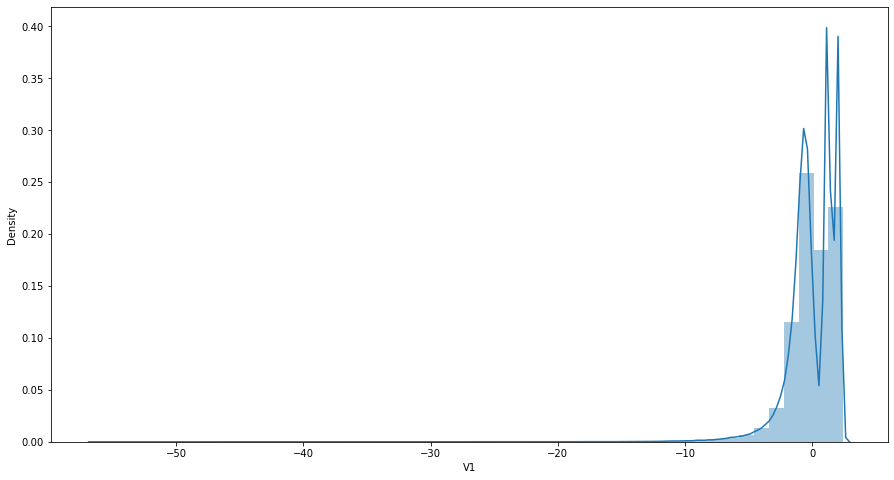

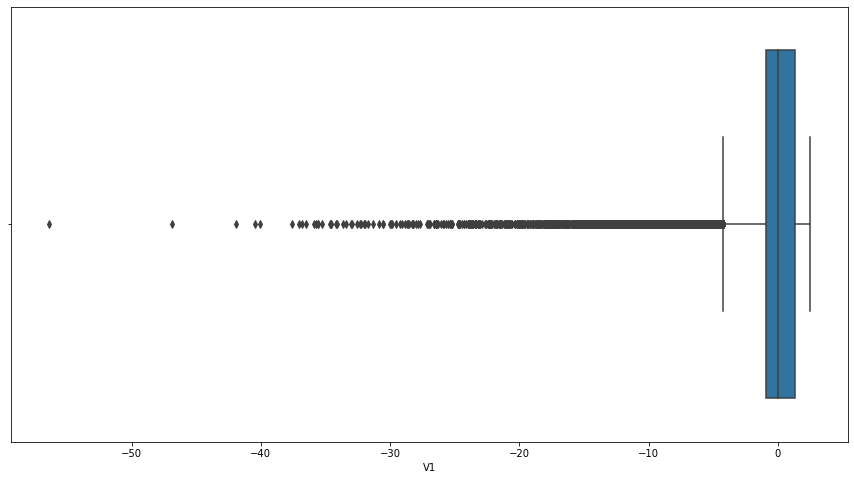

In [8]:
plt.figure(figsize = (15,8))
sns.distplot(df['V1'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V1'])
plt.show()

In [9]:
df['V1'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     3.918649e-15
std      1.958696e+00
min     -5.640751e+01
10%     -1.893272e+00
20%     -1.134663e+00
25%     -9.203734e-01
30%     -7.472943e-01
40%     -4.267559e-01
50%      1.810880e-02
60%      1.035107e+00
70%      1.224825e+00
75%      1.315642e+00
80%      1.694936e+00
90%      2.015409e+00
99%      2.237130e+00
max      2.454930e+00
Name: V1, dtype: float64

In [10]:
print('The skewness is feature V1 is {} and kurtosis is {}.'.format(df['V1'].skew(), df['V1'].kurt()))

The skewness is feature V1 is -3.2806673027560405 and kurtosis is 32.48667948607062.


In [11]:
# Inference:
# Dataset is left skewed.
# Median value of 1.81e-02 AND Mean value of 3.9e-15, the difference between is them is significant
# Skewness = -3.280667302 AND Kurtosis = 32.489979489 i.e heavely left skewed and very heavy kurtosis

-1.3953619635908503


C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


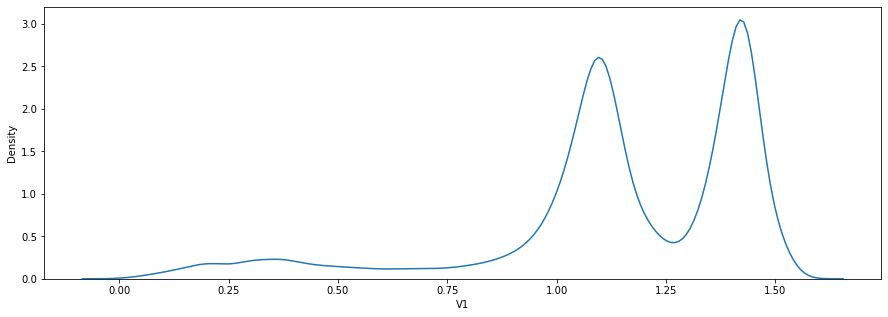

In [12]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V1']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V1']),hist=False)
plt.show()

-2.7719149899028666


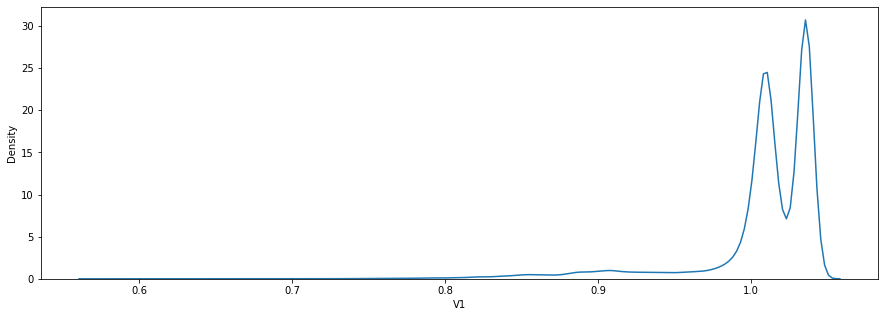

In [13]:
# USING ROOT of 10

print(np.sqrt(df['V1']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V1']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-3.0353172517483267


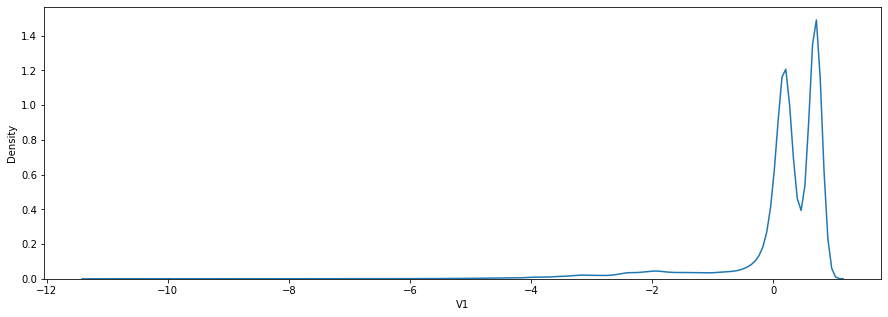

In [14]:
# USING LOG Transformation

print(np.log(df['V1']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V1']),hist=False)
plt.show()

In [15]:
## Inference: So initially we had skewness of -3.2, which decreased to -1.3 using square root transformation.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V1 variable as a square root

### V2 column

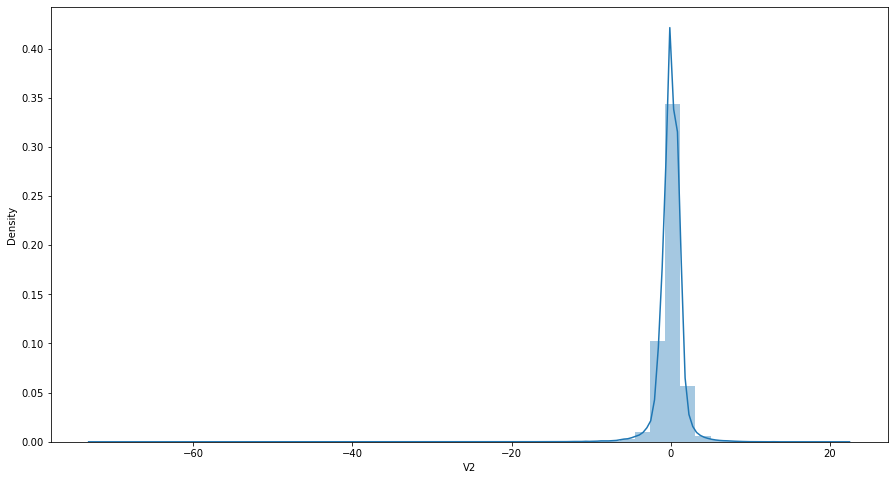

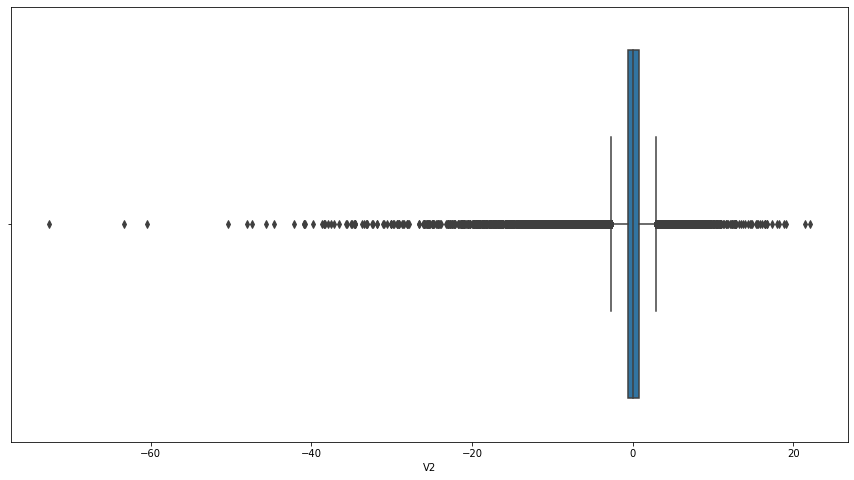

In [16]:
plt.figure(figsize = (15,8))
sns.distplot(df['V2'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V2'])
plt.show()

In [17]:
df['V2'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     5.682686e-16
std      1.651309e+00
min     -7.271573e+01
10%     -1.359862e+00
20%     -7.908142e-01
25%     -5.985499e-01
30%     -4.363931e-01
40%     -1.538049e-01
50%      6.548556e-02
60%      3.027378e-01
70%      6.368450e-01
75%      8.037239e-01
80%      9.573136e-01
90%      1.326635e+00
99%      3.801811e+00
max      2.205773e+01
Name: V2, dtype: float64

In [18]:
df['V2'].skew(), df['V2'].kurt()

(-4.624865573285336, 95.7731059638466)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.9443198063241797


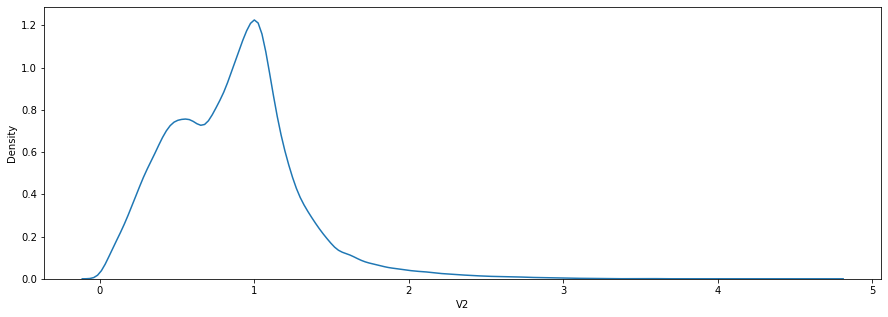

In [19]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V2']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V2']),hist=False)
plt.show()

-1.0265454918093404


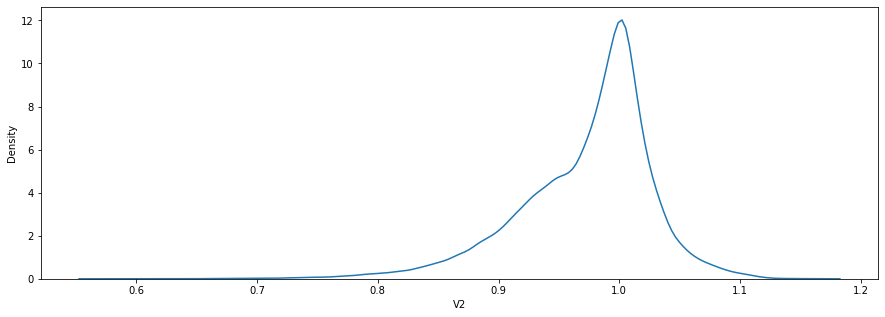

In [20]:
# USING ROOT of 10

print(np.sqrt(df['V2']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V2']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-1.31856554791428


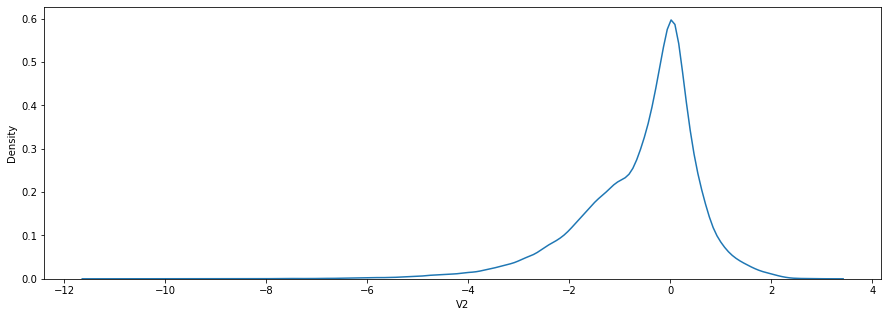

In [21]:
# USING LOG Transformation

print(np.log(df['V2']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V2']),hist=False)
plt.show()

In [22]:
## Inference: So initially we had skewness of -4.6, which decreased to 0.94 using square root transformation.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V2 variable as a square root

### V3 column

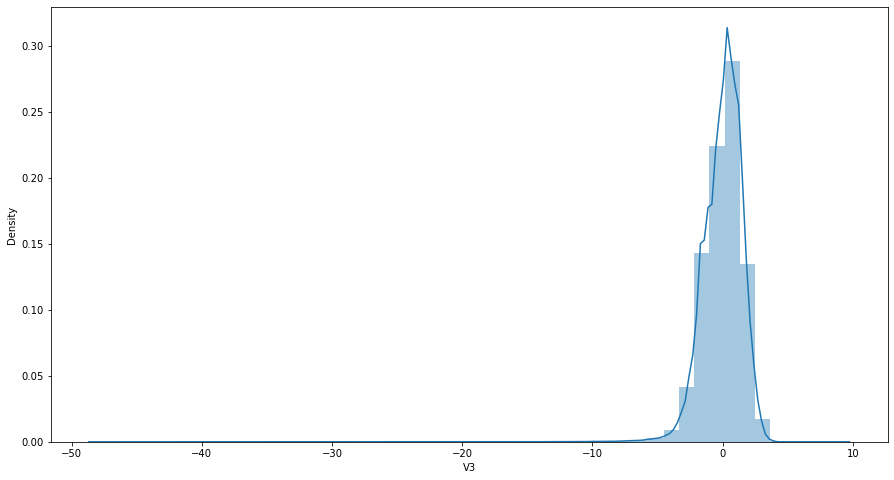

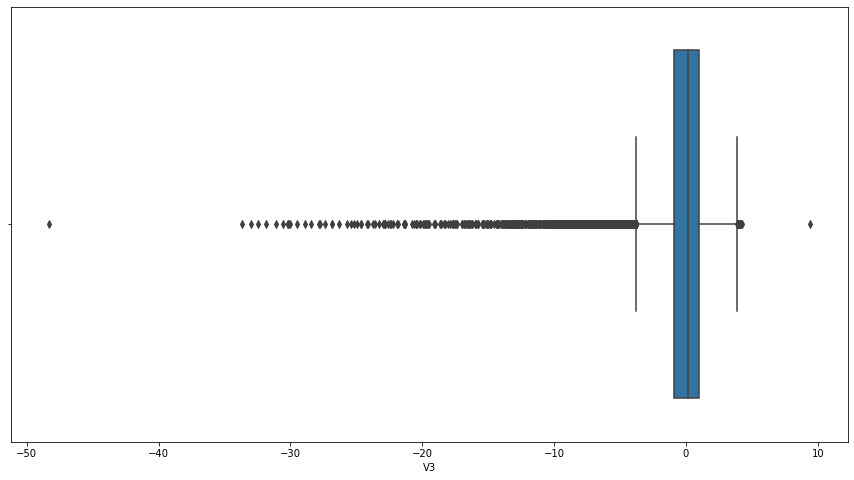

In [23]:
plt.figure(figsize = (15,8))
sns.distplot(df['V3'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V3'])
plt.show()

In [24]:
df['V3'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -8.761736e-15
std      1.516255e+00
min     -4.832559e+01
10%     -1.802587e+00
20%     -1.169050e+00
25%     -8.903648e-01
30%     -6.168060e-01
40%     -1.990610e-01
50%      1.798463e-01
60%      4.970396e-01
70%      8.435405e-01
75%      1.027196e+00
80%      1.215700e+00
90%      1.676173e+00
99%      2.728434e+00
max      9.382558e+00
Name: V3, dtype: float64

In [25]:
df['V3'].skew(), df['V3'].kurt()

(-2.2401554402404193, 26.619550806363996)

In [26]:
## Since is almost mild, and not heavy. We should go for square root transformation. Hence -

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.9443198063241797


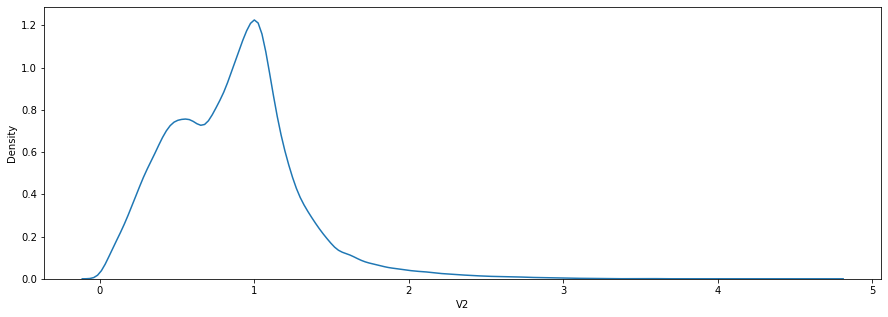

In [27]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V2']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V2']),hist=False)
plt.show()

In [28]:
## Inference: So initially we had skewness of -2.4, which decreased to 0.94 using square root transformation.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V3 variable as a square root

### V4 column

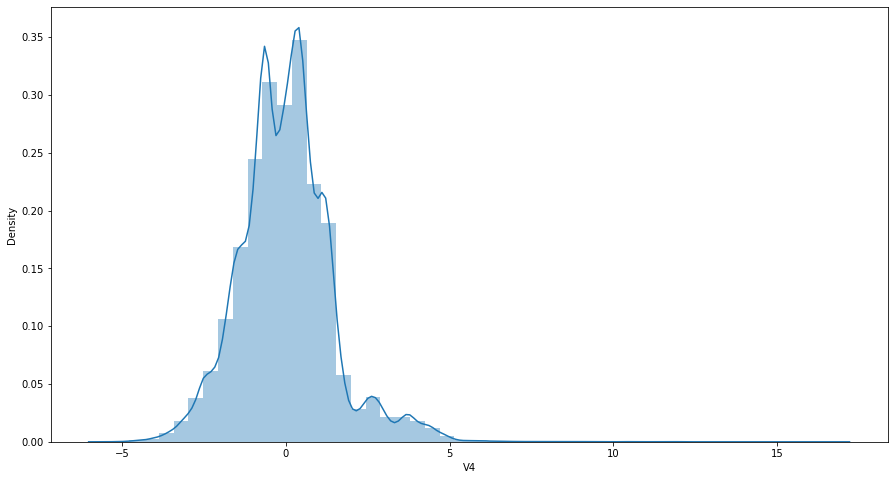

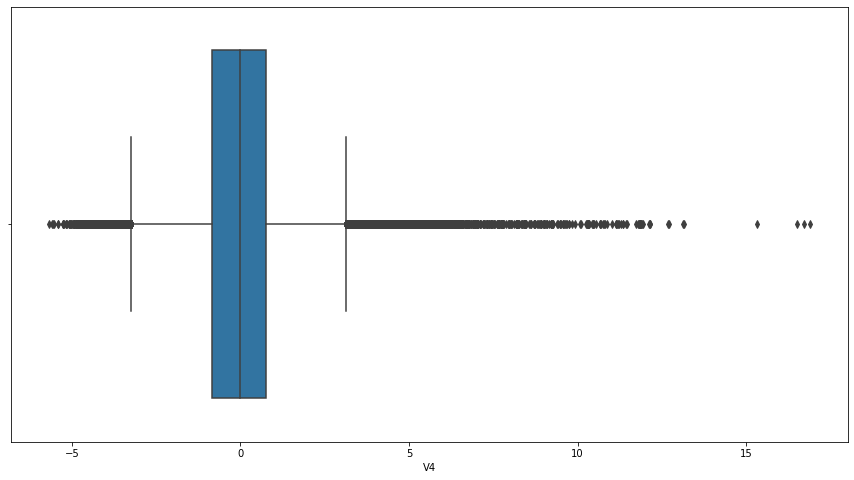

In [29]:
plt.figure(figsize = (15,8))
sns.distplot(df['V4'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V4'])
plt.show()

In [30]:
df['V4'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     2.811118e-15
std      1.415869e+00
min     -5.683171e+00
10%     -1.656329e+00
20%     -1.066085e+00
25%     -8.486401e-01
30%     -6.962262e-01
40%     -3.941610e-01
50%     -1.984653e-02
60%      2.848562e-01
70%      5.588663e-01
75%      7.433413e-01
80%      9.861875e-01
90%      1.482807e+00
99%      4.248032e+00
max      1.687534e+01
Name: V4, dtype: float64

In [31]:
df['V4'].skew(), df['V4'].kurt()

(0.676292097985747, 2.6354549146787125)

In [32]:
## V4 is moderately skewed and lepokurtic (mildly kurtosis)

### V5 column

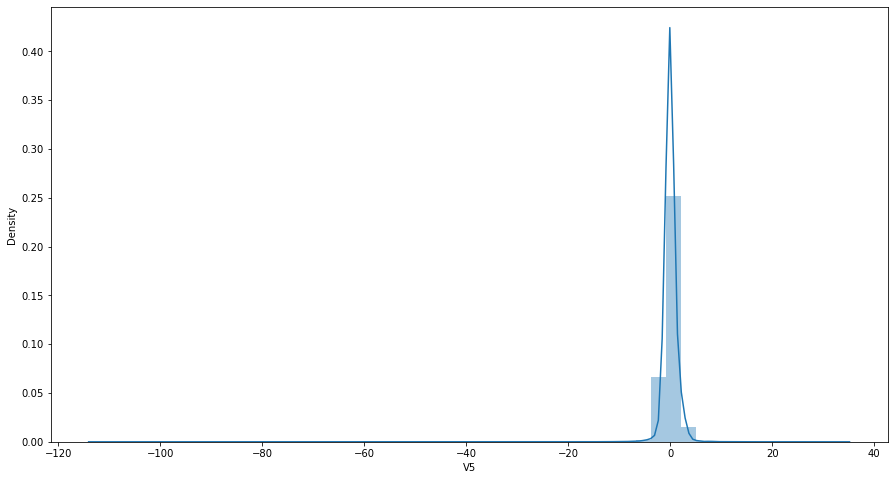

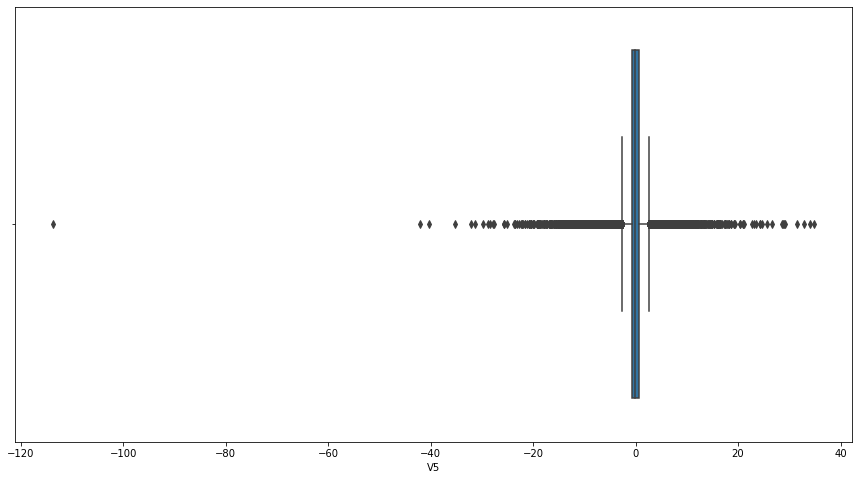

In [33]:
plt.figure(figsize = (15,8))
sns.distplot(df['V5'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V5'])
plt.show()

In [34]:
df['V5'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -1.552103e-15
std      1.380247e+00
min     -1.137433e+02
10%     -1.302171e+00
20%     -8.595815e-01
25%     -6.915971e-01
30%     -5.444552e-01
40%     -2.901118e-01
50%     -5.433583e-02
60%      1.866249e-01
70%      4.570287e-01
75%      6.119264e-01
80%      8.022349e-01
90%      1.407893e+00
99%      3.424903e+00
max      3.480167e+01
Name: V5, dtype: float64

In [35]:
df['V5'].skew(), df['V5'].kurt()

(-2.425901495952054, 206.90455995692022)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


1.0184703386266838


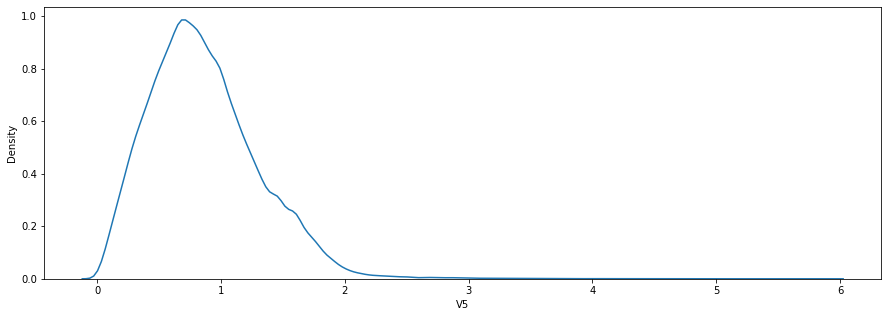

In [36]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V5']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V5']),hist=False)
plt.show()

-0.8498122523662106


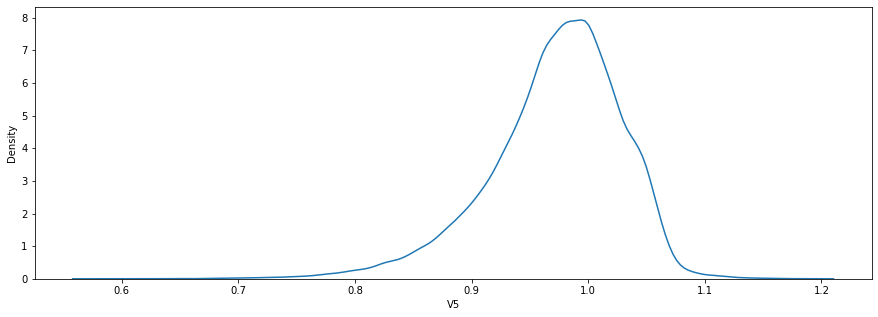

In [37]:
# USING ROOT of 10

print(np.sqrt(df['V5']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V5']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-1.1362972733271053


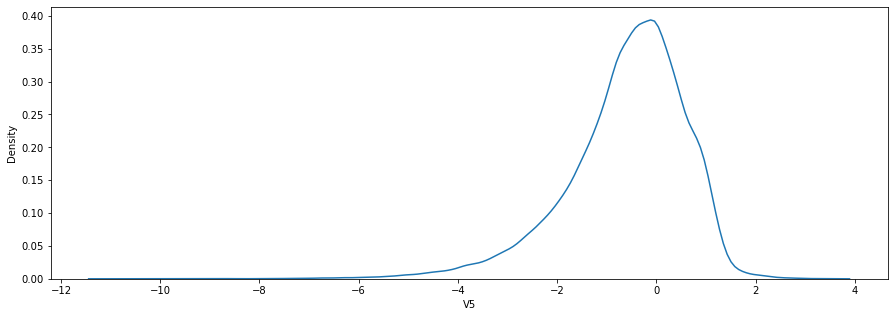

In [38]:
# USING LOG Transformation

print(np.log(df['V5']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V5']),hist=False)
plt.show()

In [39]:
## Inference: So initially we had skewness of -2.4 which is almost heavy skewed,
## which decreased to within mild skewness using all 3 transformation techniques
## Therefore, from a model performace improvement prespective, we can look at tranformation of V5 variable as any of the 3 techniques

### V6 column

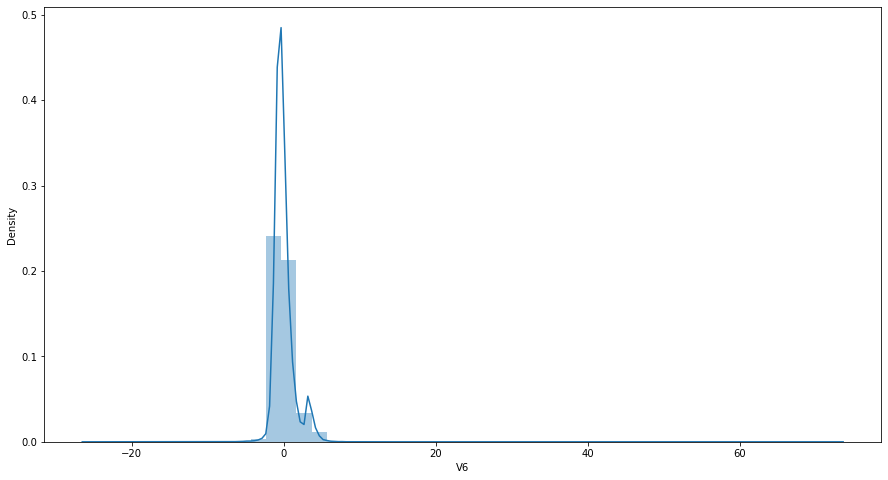

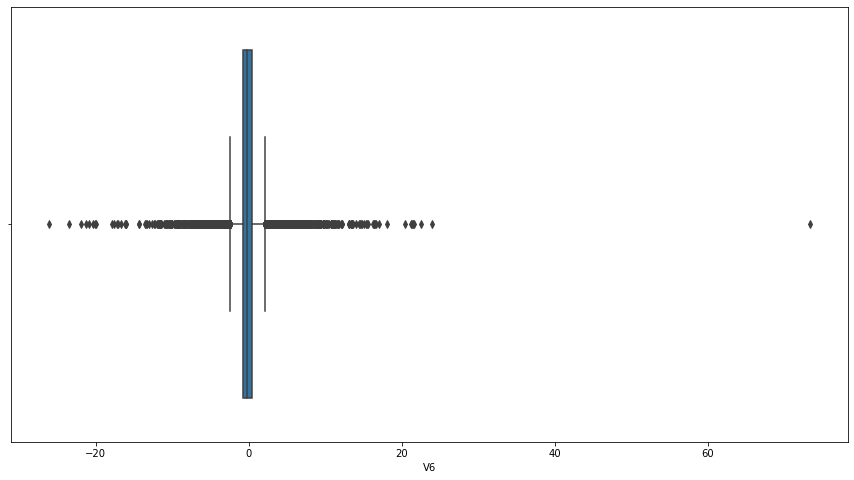

In [40]:
plt.figure(figsize = (15,8))
sns.distplot(df['V6'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V6'])
plt.show()

In [41]:
df['V6'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     2.040130e-15
std      1.332271e+00
min     -2.616051e+01
10%     -1.167450e+00
20%     -8.781527e-01
25%     -7.682956e-01
30%     -6.678449e-01
40%     -4.794725e-01
50%     -2.741871e-01
60%     -4.819964e-02
70%      2.232447e-01
75%      3.985649e-01
80%      6.289952e-01
90%      1.509365e+00
99%      4.200085e+00
max      7.330163e+01
Name: V6, dtype: float64

In [42]:
df['V6'].skew(), df['V6'].kurt()

(1.826580664998085, 42.64249396253933)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.7225268262518454


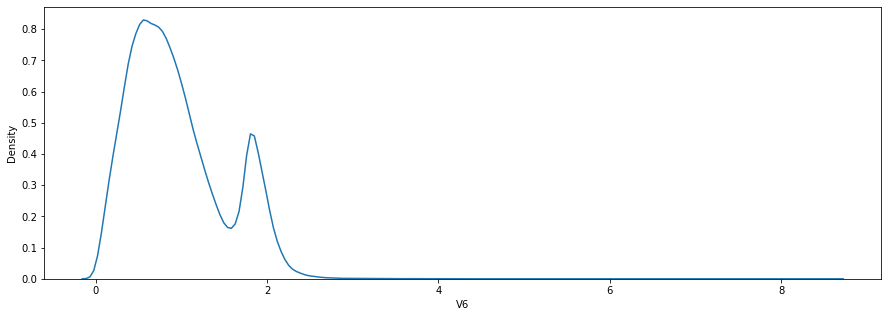

In [43]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V6']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V6']),hist=False)
plt.show()

In [44]:
## V6 was initially almost moderately skewed and after square root transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V6 variable as a square root

### V7 column

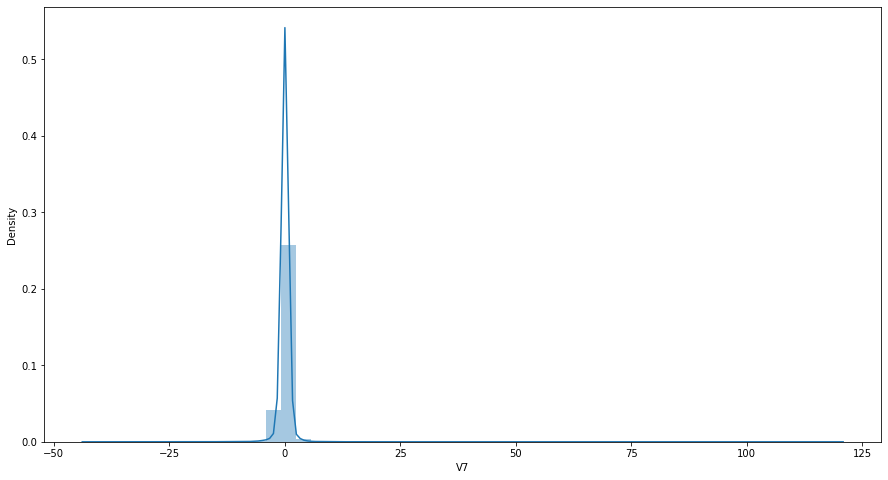

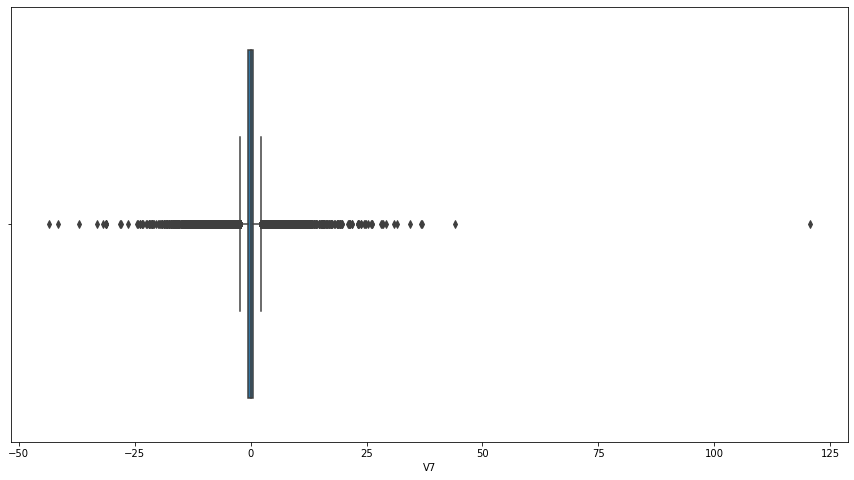

In [45]:
plt.figure(figsize = (15,8))
sns.distplot(df['V7'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V7'])
plt.show()

In [46]:
df['V7'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -1.698953e-15
std      1.237094e+00
min     -4.355724e+01
10%     -1.078148e+00
20%     -6.833164e-01
25%     -5.540759e-01
30%     -4.260203e-01
40%     -1.593408e-01
50%      4.010308e-02
60%      2.135123e-01
70%      4.461749e-01
75%      5.704361e-01
80%      6.983318e-01
90%      1.039387e+00
99%      2.696205e+00
max      1.205895e+02
Name: V7, dtype: float64

In [47]:
df['V7'].skew(), df['V7'].kurt()

(2.553907417429514, 405.6074170083754)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


1.6603644261521018


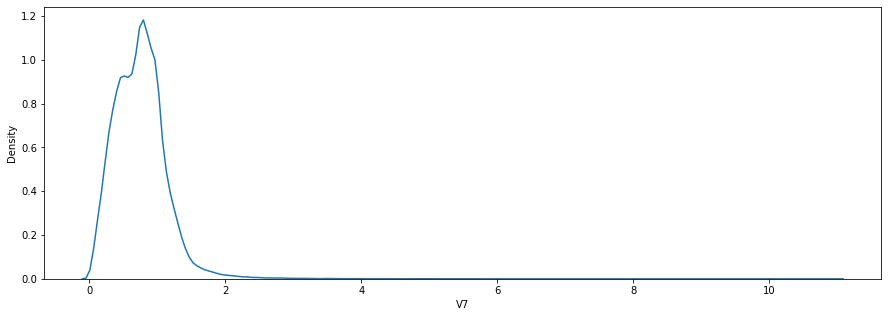

In [48]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V7']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V7']),hist=False)
plt.show()

-0.9178820523060548


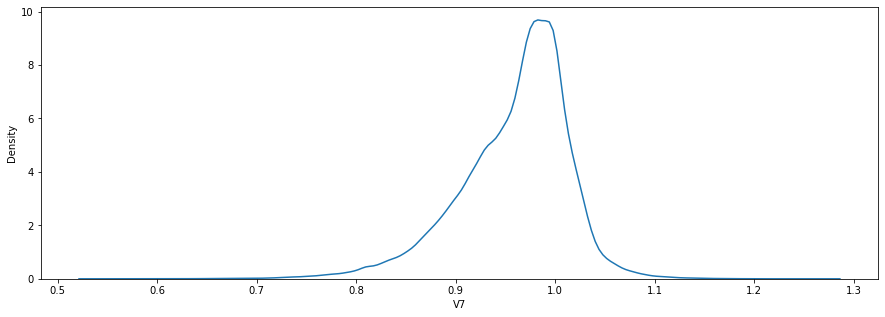

In [49]:
# USING ROOT of 10

print(np.sqrt(df['V7']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V7']**0.1),hist=False)
plt.show()

In [50]:
## V7 was initially almost moderately skewed and after root of 10 transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V7 variable as a root of 10

### V8 column

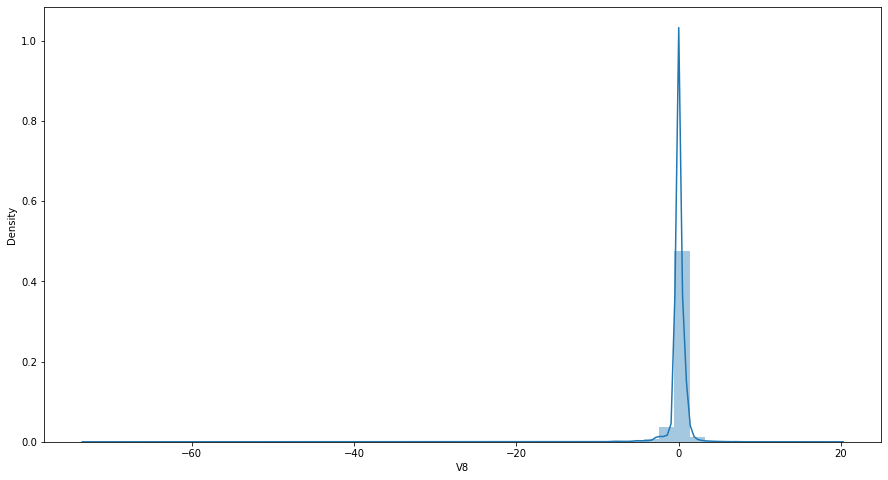

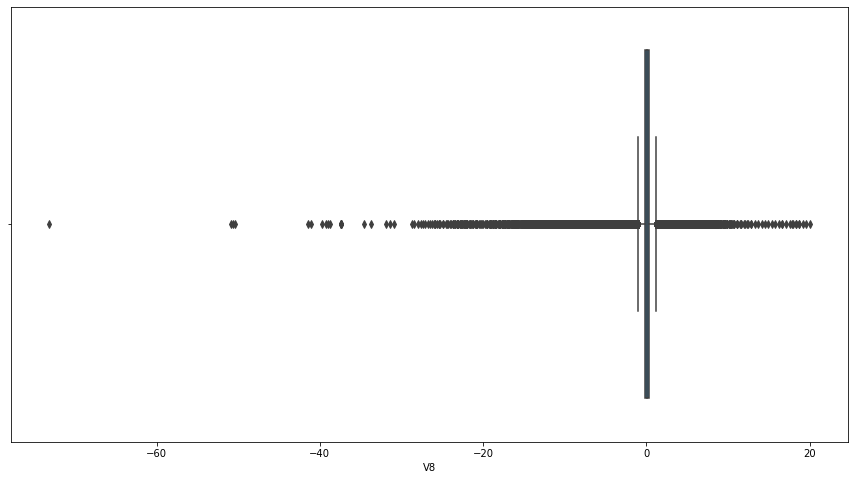

In [51]:
plt.figure(figsize = (15,8))
sns.distplot(df['V8'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V8'])
plt.show()

In [52]:
df['V8'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -1.893285e-16
std      1.194353e+00
min     -7.321672e+01
10%     -4.589454e-01
20%     -2.662999e-01
25%     -2.086297e-01
30%     -1.581584e-01
40%     -6.605715e-02
50%      2.235804e-02
60%      1.204889e-01
70%      2.434003e-01
75%      3.273459e-01
80%      4.355289e-01
90%      7.693811e-01
99%      2.075973e+00
max      2.000721e+01
Name: V8, dtype: float64

In [53]:
df['V8'].skew(), df['V8'].kurt()

(-8.521944194777976, 220.58697362515306)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


1.4758518125255493


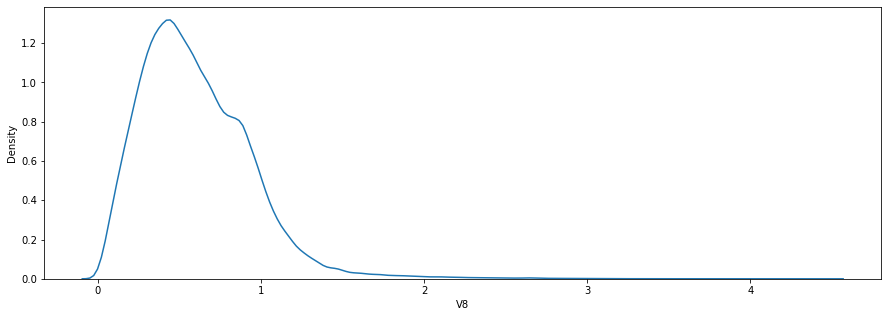

In [54]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V8']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V8']),hist=False)
plt.show()

-0.6995831156989136


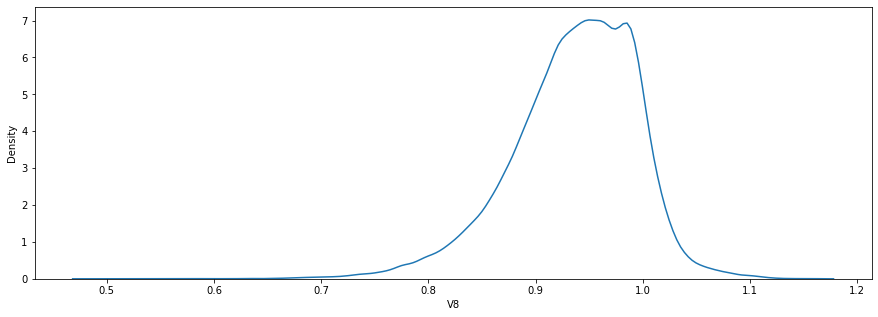

In [55]:
# USING ROOT of 10

print(np.sqrt(df['V8']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V8']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.9983671580083259


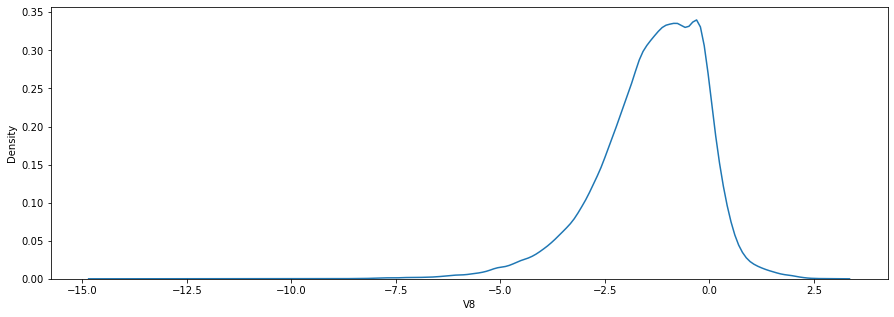

In [56]:
# USING LOG Transformation

print(np.log(df['V8']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V8']),hist=False)
plt.show()

In [57]:
## V8 was initially almost moderately skewed and after root of 10 transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V8 variable as a root of 10

### V9 column

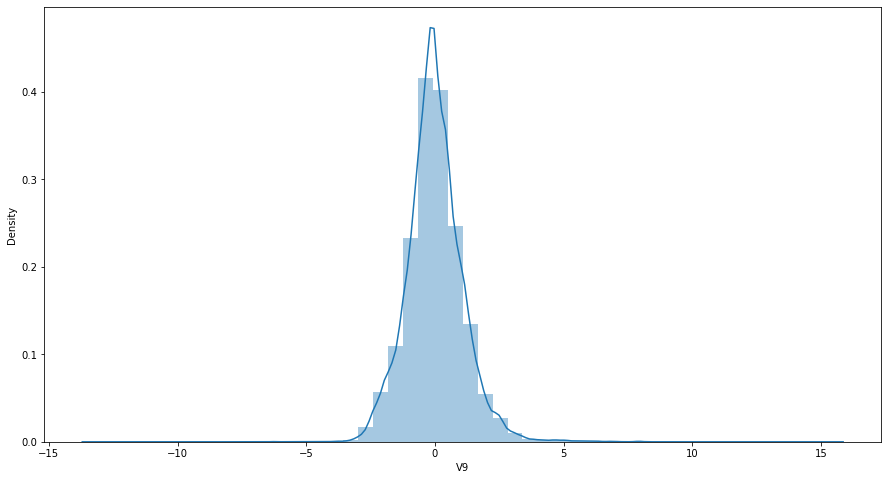

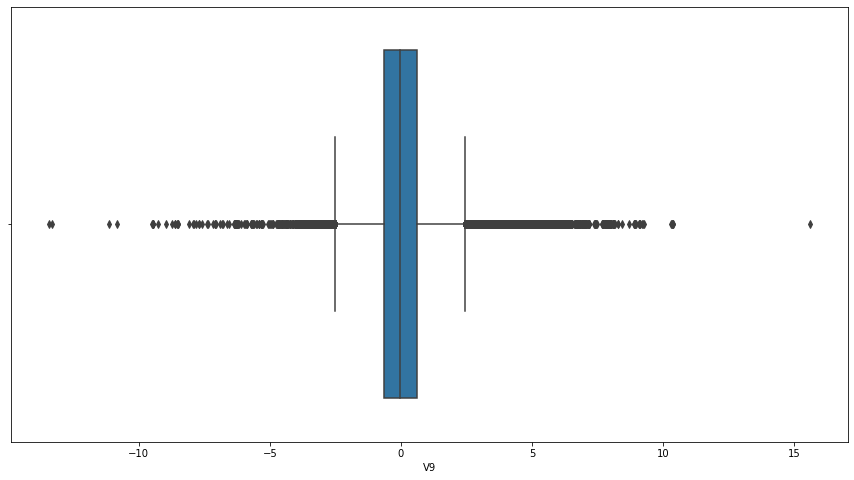

In [58]:
plt.figure(figsize = (15,8))
sns.distplot(df['V9'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V9'])
plt.show()

In [59]:
df['V9'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -3.147640e-15
std      1.098632e+00
min     -1.343407e+01
10%     -1.294047e+00
20%     -8.088755e-01
25%     -6.430976e-01
30%     -5.021651e-01
40%     -2.577302e-01
50%     -5.142873e-02
60%      1.761695e-01
70%      4.459420e-01
75%      5.971390e-01
80%      7.915832e-01
90%      1.301671e+00
99%      2.986773e+00
max      1.559499e+01
Name: V9, dtype: float64

In [60]:
df['V9'].skew(), df['V9'].kurt()

(0.5546797719063509, 3.7313106141412087)

In [61]:
## Since V9 is midly skewed, we won't be using any tranformation technique

### V10 column

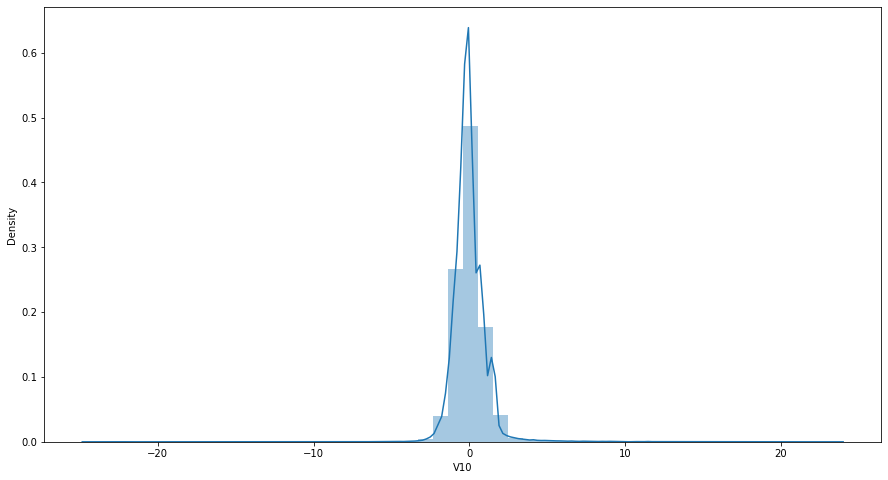

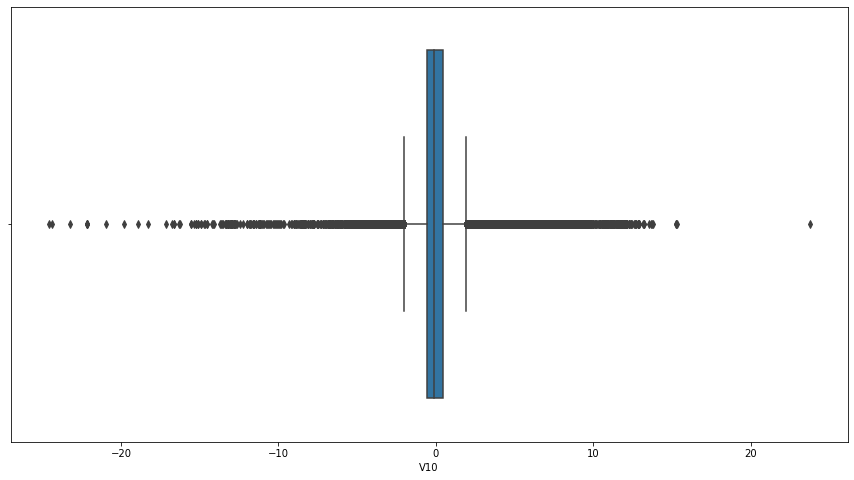

In [62]:
plt.figure(figsize = (15,8))
sns.distplot(df['V10'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V10'])
plt.show()

In [63]:
df['V10'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.772925e-15
std      1.088850e+00
min     -2.458826e+01
10%     -1.032158e+00
20%     -6.664809e-01
25%     -5.354257e-01
30%     -4.257577e-01
40%     -2.481867e-01
50%     -9.291738e-02
60%      5.950018e-02
70%      2.695355e-01
75%      4.539234e-01
80%      6.482390e-01
90%      1.119759e+00
99%      3.253618e+00
max      2.374514e+01
Name: V10, dtype: float64

In [64]:
df['V10'].skew(), df['V10'].kurt()

(1.1871405899625278, 31.98823877949119)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.9443198063241797


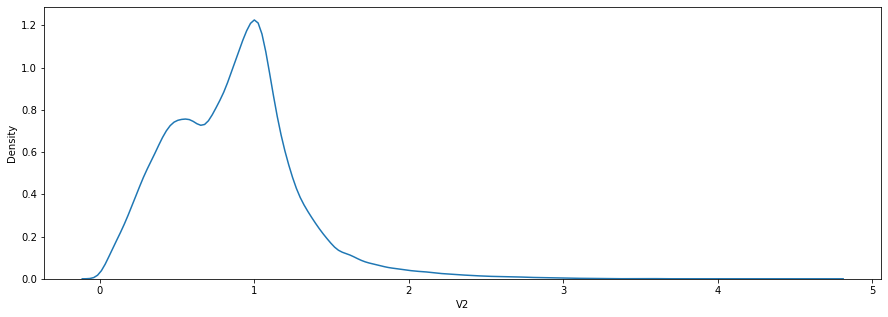

In [65]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V2']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V2']),hist=False)
plt.show()

In [66]:
## Since V10 is only almost moderately skewed, using square root tranformation brings it to midly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V10 variable as a square root

### V11 column

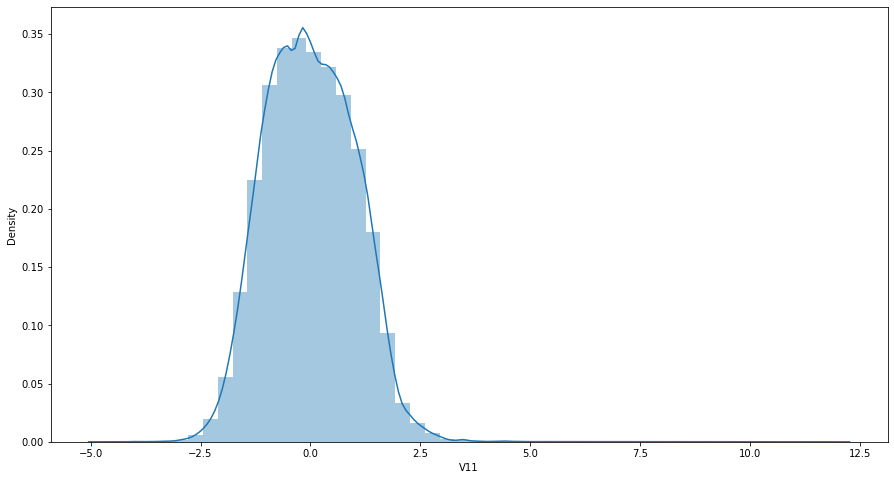

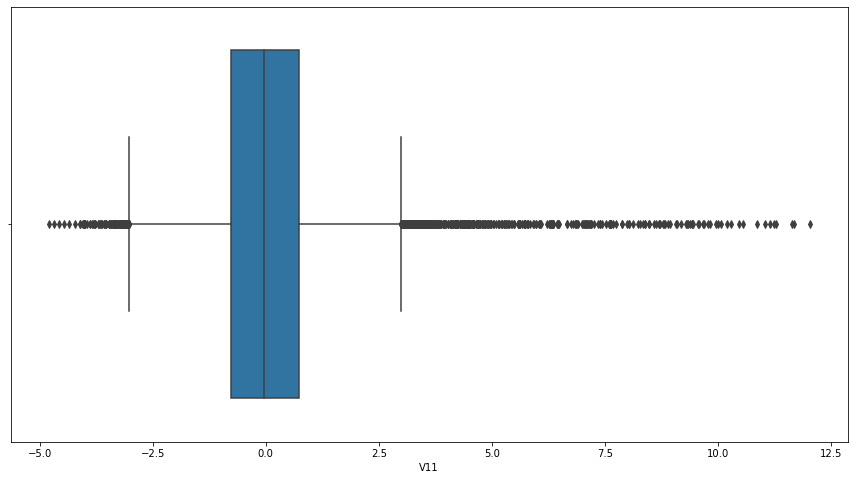

In [67]:
plt.figure(figsize = (15,8))
sns.distplot(df['V11'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V11'])
plt.show()

In [68]:
df['V11'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     9.289524e-16
std      1.020713e+00
min     -4.797473e+00
10%     -1.289015e+00
20%     -9.169940e-01
25%     -7.624942e-01
30%     -6.129743e-01
40%     -3.171382e-01
50%     -3.275735e-02
60%      2.678527e-01
70%      5.785726e-01
75%      7.395934e-01
80%      9.132205e-01
90%      1.318588e+00
99%      2.290583e+00
max      1.201891e+01
Name: V11, dtype: float64

In [69]:
df['V11'].skew(), df['V11'].kurt()

(0.35650585548882013, 1.6339212577978683)

In [70]:
## Since V11 is midly skewed, we won't be using any tranformation technique

### V12 column

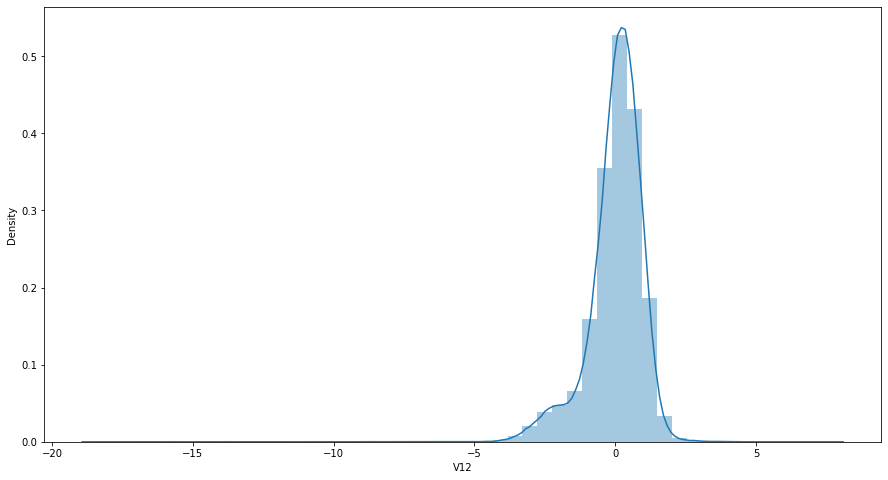

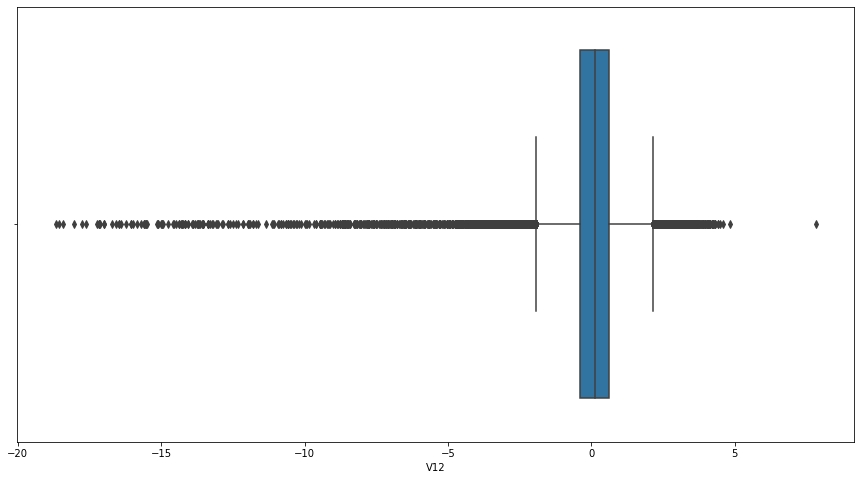

In [71]:
plt.figure(figsize = (15,8))
sns.distplot(df['V12'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V12'])
plt.show()

In [72]:
df['V12'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -1.803266e-15
std      9.992014e-01
min     -1.868371e+01
10%     -1.148031e+00
20%     -5.730710e-01
25%     -4.055715e-01
30%     -2.719676e-01
40%     -5.045118e-02
50%      1.400326e-01
60%      3.247704e-01
70%      5.164565e-01
75%      6.182380e-01
80%      7.306695e-01
90%      1.017274e+00
99%      1.698576e+00
max      7.848392e+00
Name: V12, dtype: float64

In [73]:
df['V12'].skew(), df['V12'].kurt()

(-2.278400935410618, 20.241869662225426)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.019402476541489966


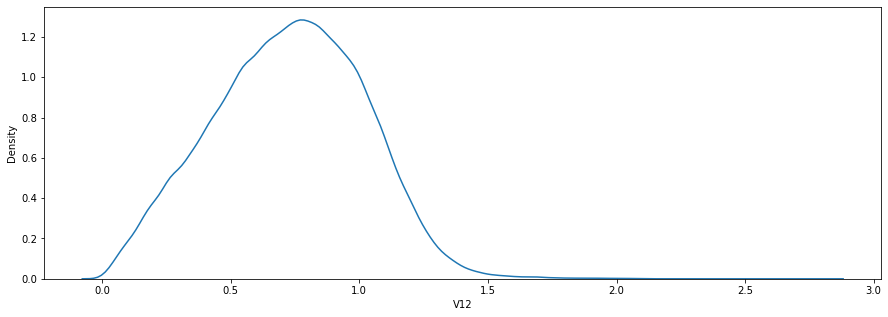

In [74]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V12']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V12']),hist=False)
plt.show()

In [75]:
## V12 was initially moderately skewed and after square root transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V12 variable as a square root

### V13 column

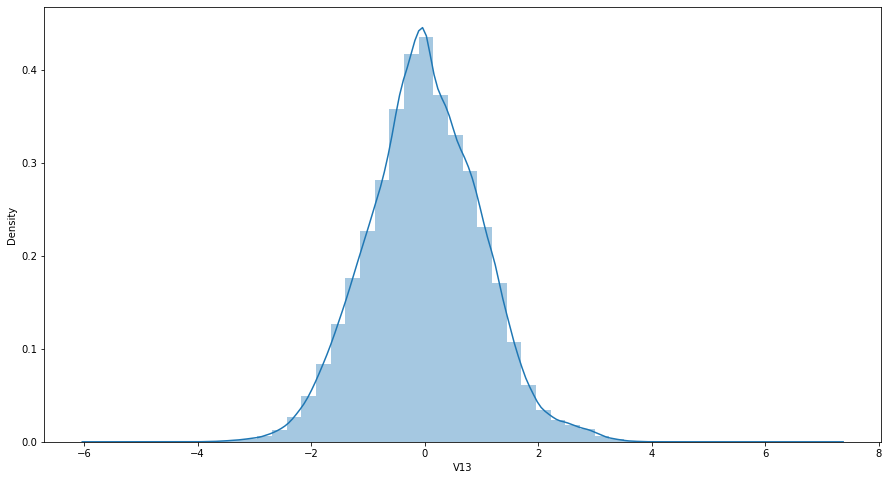

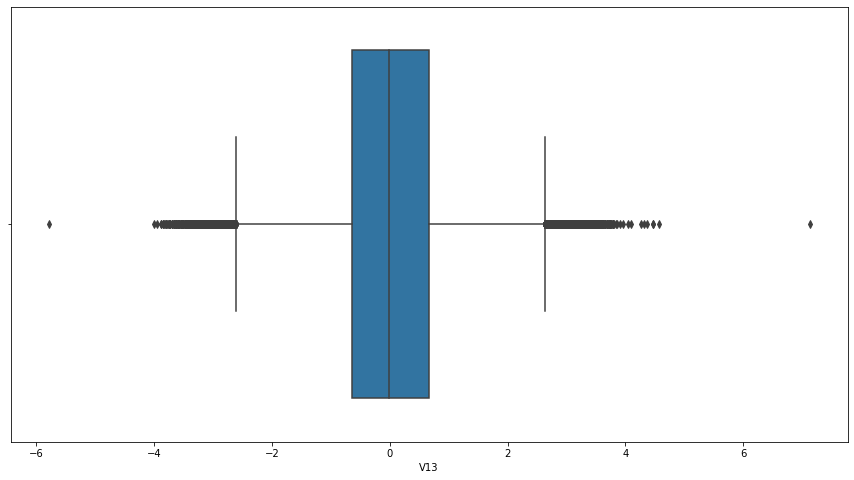

In [76]:
plt.figure(figsize = (15,8))
sns.distplot(df['V13'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V13'])
plt.show()

In [77]:
df['V13'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.674888e-15
std      9.952742e-01
min     -5.791881e+00
10%     -1.280012e+00
20%     -8.247022e-01
25%     -6.485393e-01
30%     -4.971726e-01
40%     -2.395771e-01
50%     -1.356806e-02
60%      2.287273e-01
70%      5.050463e-01
75%      6.625050e-01
80%      8.290889e-01
90%      1.251841e+00
99%      2.513962e+00
max      7.126883e+00
Name: V13, dtype: float64

In [78]:
df['V13'].skew(), df['V13'].kurt()

(0.06523345790658323, 0.19529978783246627)

In [79]:
## Since V13 is midly skewed, we won't be using any tranformation technique

### V14 column

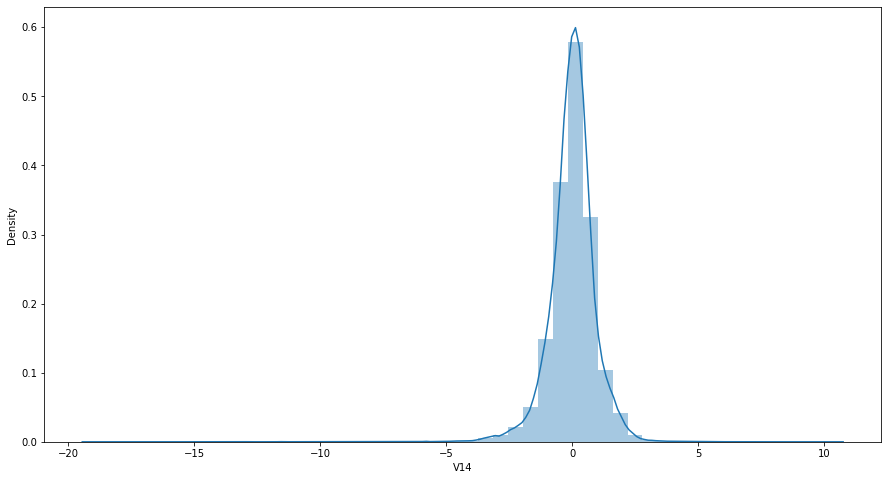

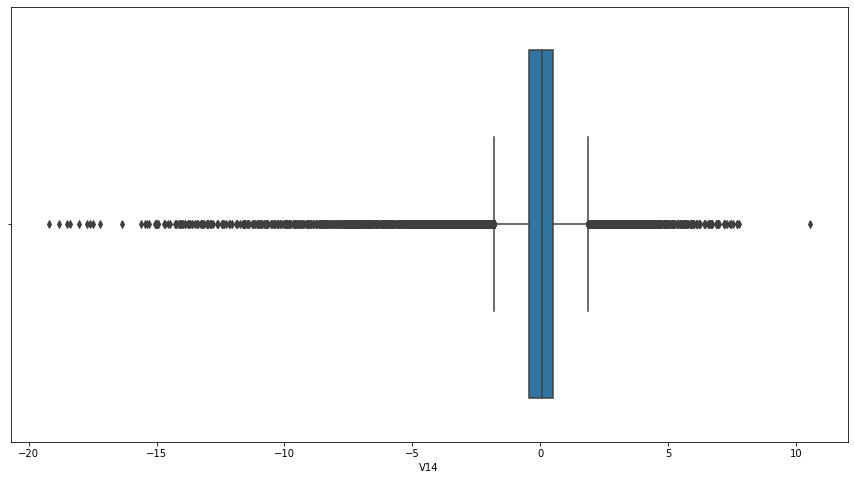

In [80]:
plt.figure(figsize = (15,8))
sns.distplot(df['V14'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V14'])
plt.show()

In [81]:
df['V14'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.475621e-15
std      9.585956e-01
min     -1.921433e+01
10%     -1.003676e+00
20%     -5.673035e-01
25%     -4.255740e-01
30%     -3.124565e-01
40%     -1.196655e-01
50%      5.060132e-02
60%      2.163083e-01
70%      3.938939e-01
75%      4.931498e-01
80%      6.087367e-01
90%      9.814085e-01
99%      2.150300e+00
max      1.052677e+01
Name: V14, dtype: float64

In [82]:
df['V14'].skew(), df['V14'].kurt()

(-1.9951758402683304, 23.879461844938454)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.587120788611908


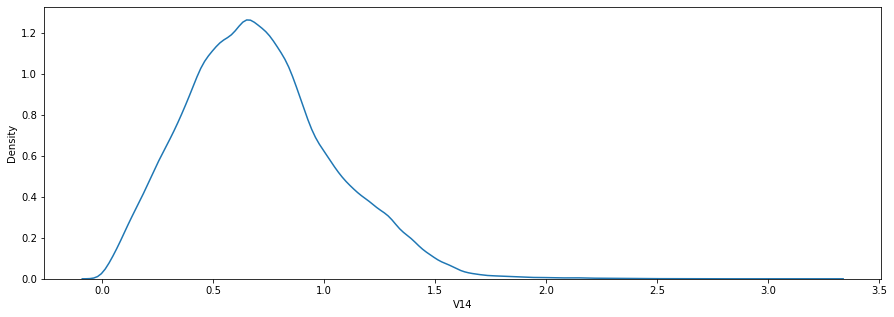

In [83]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V14']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V14']),hist=False)
plt.show()

In [84]:
## V14 was initially almost moderately skewed and after square root transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V14 variable as a square root

### V15 column

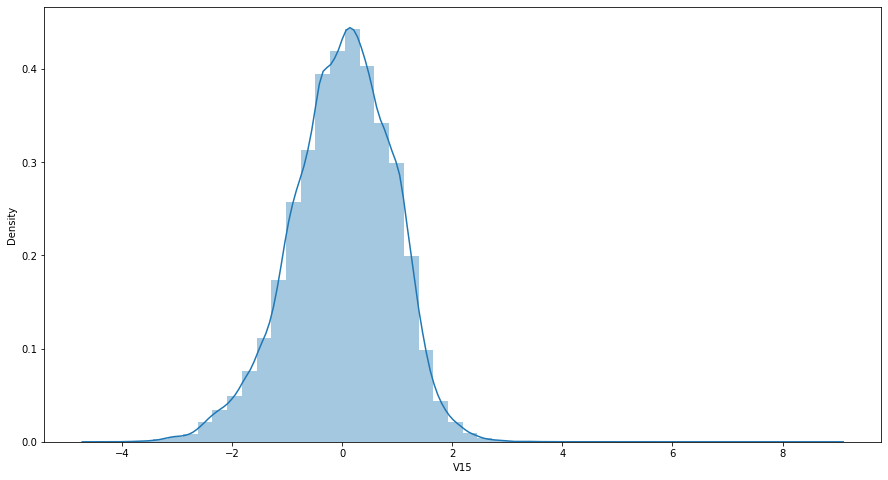

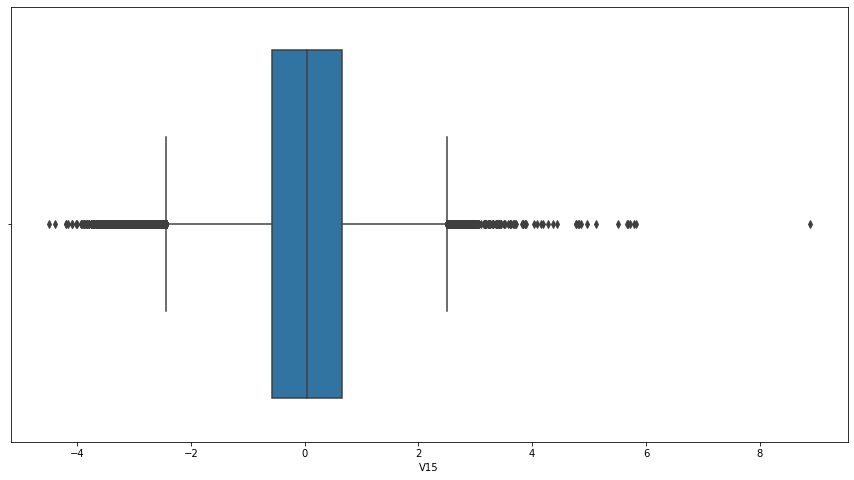

In [85]:
plt.figure(figsize = (15,8))
sns.distplot(df['V15'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V15'])
plt.show()

In [86]:
df['V15'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     3.501098e-15
std      9.153160e-01
min     -4.498945e+00
10%     -1.173945e+00
20%     -7.487495e-01
25%     -5.828843e-01
30%     -4.385696e-01
40%     -1.887507e-01
50%      4.807155e-02
60%      2.719566e-01
70%      5.137259e-01
75%      6.488208e-01
80%      7.950543e-01
90%      1.124211e+00
99%      1.925527e+00
max      8.877742e+00
Name: V15, dtype: float64

In [87]:
df['V15'].skew(), df['V15'].kurt()

(-0.3084229821359239, 0.28476908376068133)

In [88]:
## Since V15 is midly skewed, we won't be using any tranformation technique

### V16 column

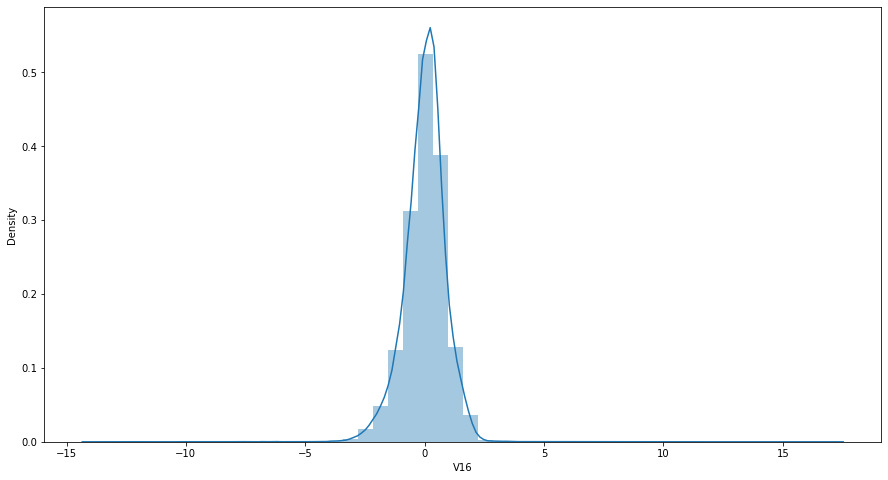

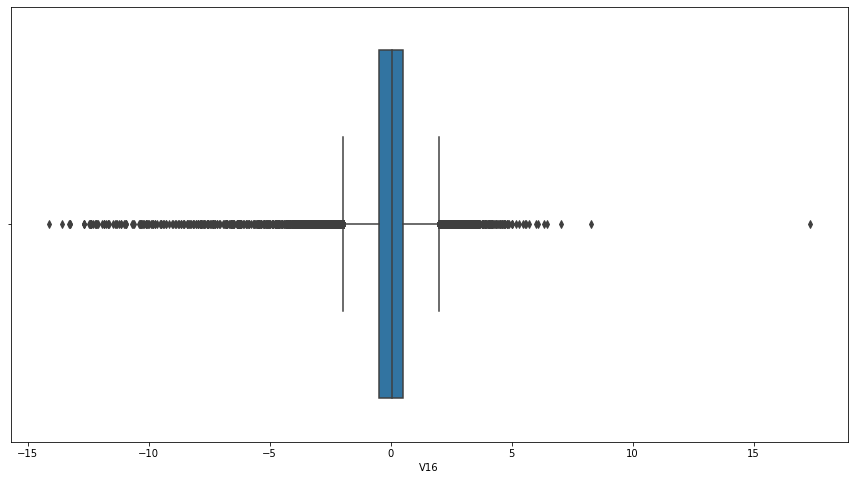

In [89]:
plt.figure(figsize = (15,8))
sns.distplot(df['V16'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V16'])
plt.show()

In [90]:
df['V16'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.392460e-15
std      8.762529e-01
min     -1.412985e+01
10%     -1.059361e+00
20%     -6.164855e-01
25%     -4.680368e-01
30%     -3.429957e-01
40%     -1.252125e-01
50%      6.641332e-02
60%      2.415156e-01
70%      4.264627e-01
75%      5.232963e-01
80%      6.414430e-01
90%      9.908792e-01
99%      1.874820e+00
max      1.731511e+01
Name: V16, dtype: float64

In [91]:
df['V16'].skew(), df['V16'].kurt()

(-1.100966276051066, 10.419131320644887)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.2876401235331205


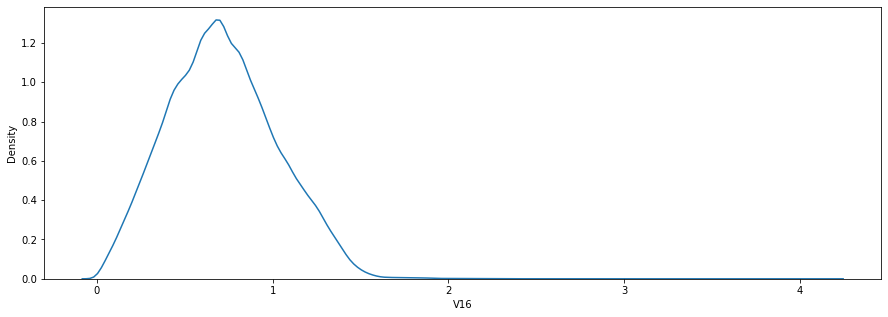

In [92]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V16']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V16']),hist=False)
plt.show()

In [93]:
## V16 was initially almost moderately skewed and after square root transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V16 variable as a square root

### V17 column

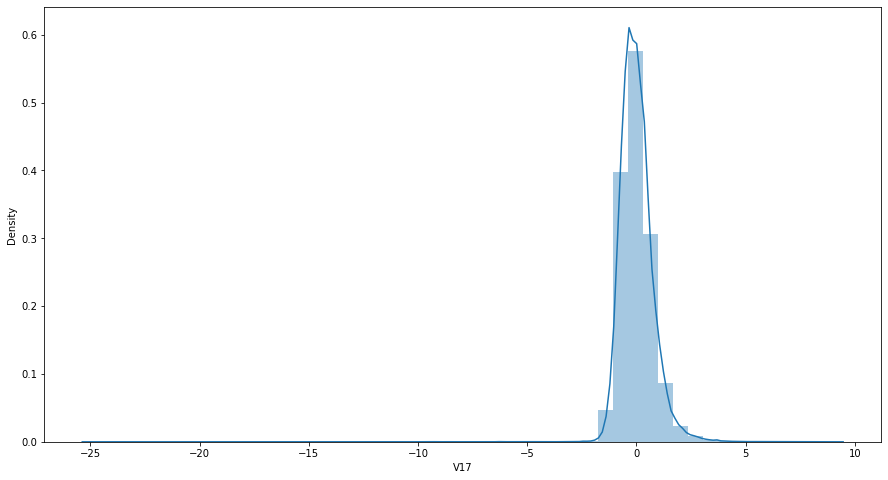

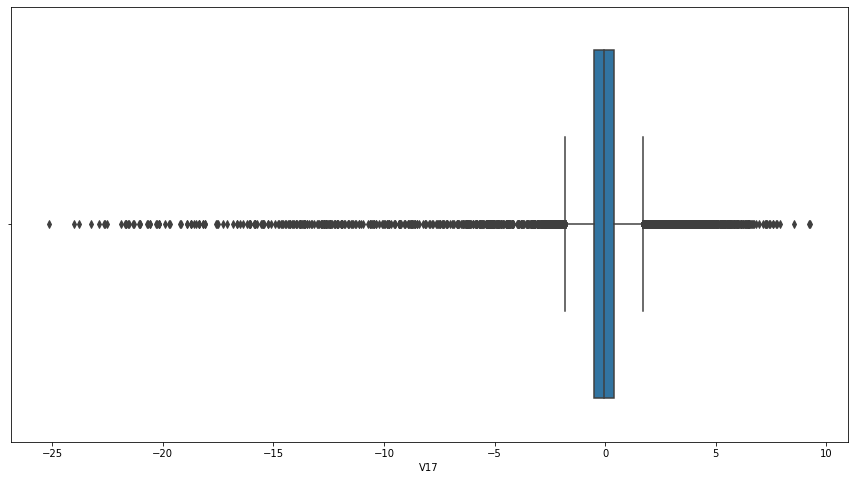

In [94]:
plt.figure(figsize = (15,8))
sns.distplot(df['V17'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V17'])
plt.show()

In [95]:
df['V17'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -7.466538e-16
std      8.493371e-01
min     -2.516280e+01
10%     -8.042644e-01
20%     -5.757627e-01
25%     -4.837483e-01
30%     -3.969463e-01
40%     -2.355630e-01
50%     -6.567575e-02
60%      1.048739e-01
70%      2.967888e-01
75%      3.996750e-01
80%      5.189160e-01
90%      9.086165e-01
99%      2.289928e+00
max      9.253526e+00
Name: V17, dtype: float64

In [96]:
df['V17'].skew(), df['V17'].kurt()

(-3.8449144738706202, 94.7997191039743)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


0.7181063329647037


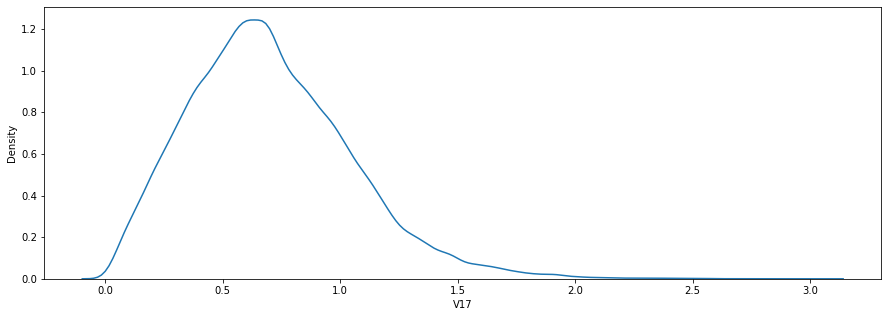

In [97]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V17']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V17']),hist=False)
plt.show()

-0.9617674518752696


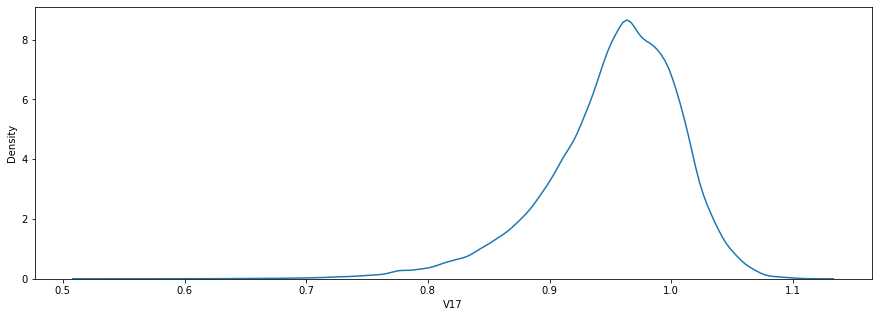

In [98]:
# USING ROOT of 10

print(np.sqrt(df['V17']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V17']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-1.2518393015708953


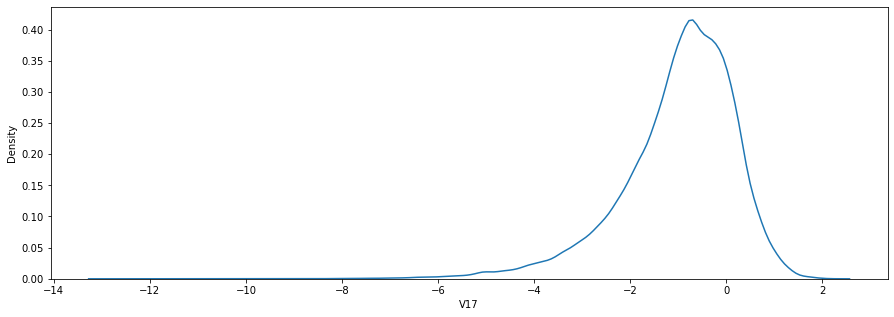

In [99]:
# USING LOG Transformation

print(np.log(df['V17']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V17']),hist=False)
plt.show()

### V18 column

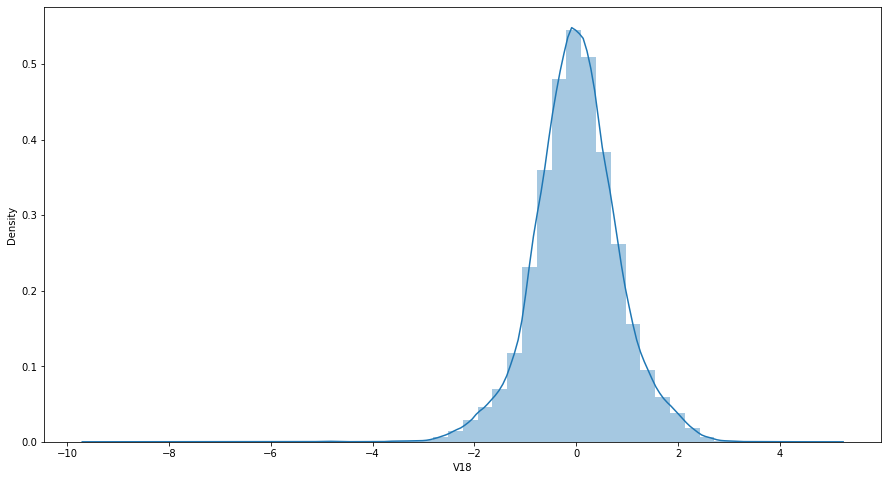

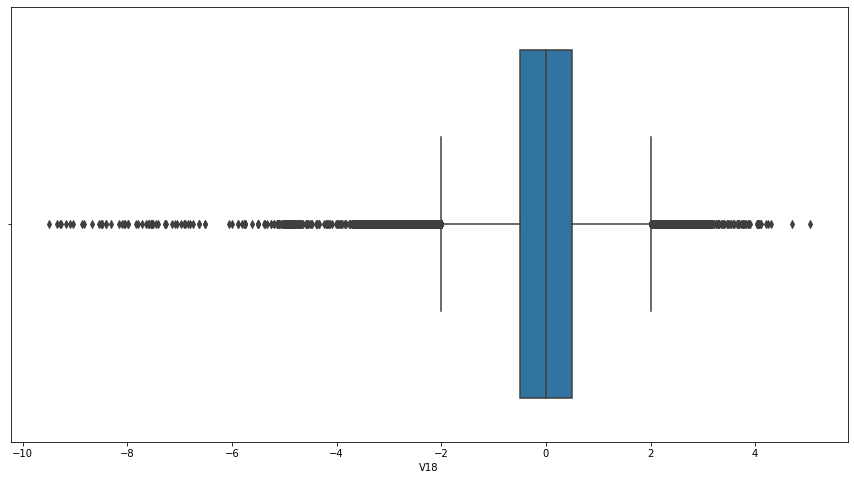

In [100]:
plt.figure(figsize = (15,8))
sns.distplot(df['V18'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V18'])
plt.show()

In [101]:
df['V18'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     4.258754e-16
std      8.381762e-01
min     -9.498746e+00
10%     -9.769348e-01
20%     -6.267061e-01
25%     -4.988498e-01
30%     -3.856909e-01
40%     -1.855848e-01
50%     -3.636312e-03
60%      1.820904e-01
70%      3.830896e-01
75%      5.008067e-01
80%      6.374684e-01
90%      1.020455e+00
99%      2.068689e+00
max      5.041069e+00
Name: V18, dtype: float64

In [102]:
df['V18'].skew(), df['V18'].kurt()

(-0.25988026809430603, 2.5783408337335967)

In [103]:
## Since V18 is midly skewed, we won't be using any tranformation technique

### V19 column

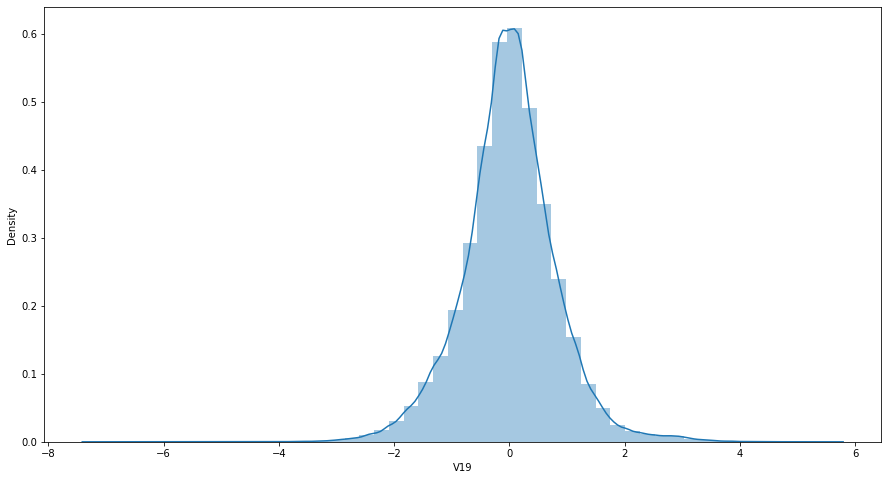

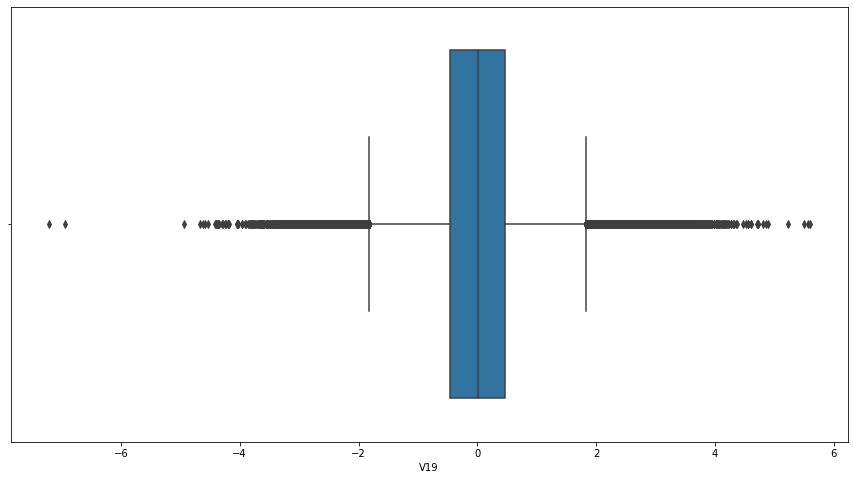

In [104]:
plt.figure(figsize = (15,8))
sns.distplot(df['V19'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V19'])
plt.show()

In [105]:
df['V19'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     9.019919e-16
std      8.140405e-01
min     -7.213527e+00
10%     -9.856163e-01
20%     -5.828234e-01
25%     -4.562989e-01
30%     -3.451006e-01
40%     -1.620252e-01
50%      3.734823e-03
60%      1.679275e-01
70%      3.482341e-01
75%      4.589494e-01
80%      5.856940e-01
90%      9.538328e-01
99%      2.262924e+00
max      5.591971e+00
Name: V19, dtype: float64

In [106]:
df['V19'].skew(), df['V19'].kurt()

(0.10919175998147104, 1.72496978122751)

In [107]:
## Since V19 is midly skewed, we won't be using any tranformation technique

### V20 column

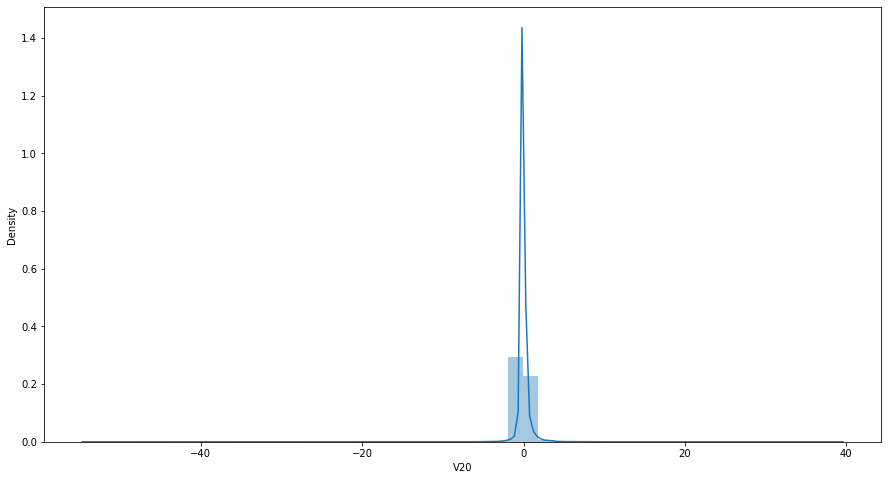

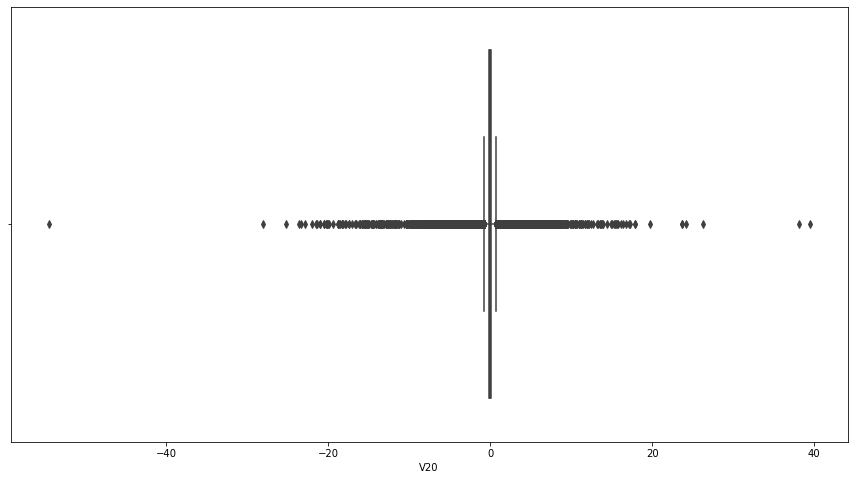

In [108]:
plt.figure(figsize = (15,8))
sns.distplot(df['V20'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V20'])
plt.show()

In [109]:
df['V20'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     5.126845e-16
std      7.709250e-01
min     -5.449772e+01
10%     -3.896021e-01
20%     -2.512018e-01
25%     -2.117214e-01
30%     -1.787040e-01
40%     -1.208067e-01
50%     -6.248109e-02
60%      4.307150e-03
70%      8.338735e-02
75%      1.330408e-01
80%      1.957871e-01
90%      4.445929e-01
99%      2.412190e+00
max      3.942090e+01
Name: V20, dtype: float64

In [110]:
df['V20'].skew(), df['V20'].kurt()

(-2.037155299081399, 271.01611295041545)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


2.0765098973505336


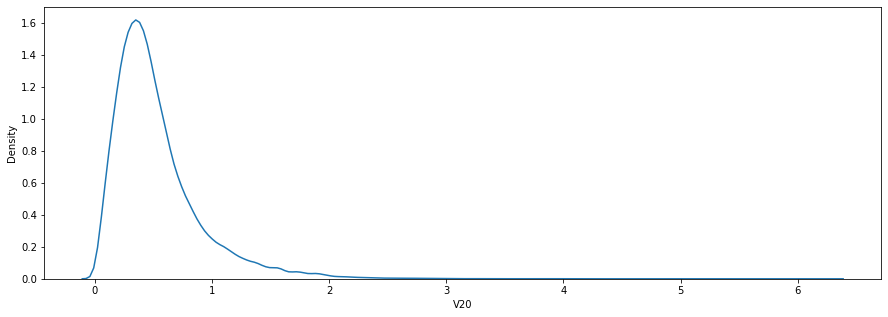

In [111]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V20']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V20']),hist=False)
plt.show()

-0.28941632551852814


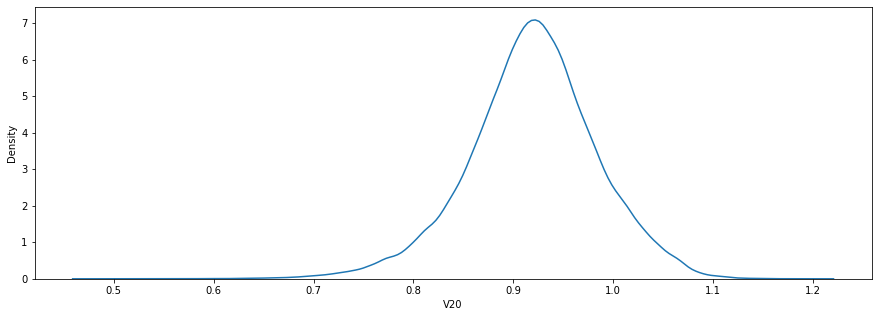

In [112]:
# USING ROOT of 10

print(np.sqrt(df['V20']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V20']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.6055488812799833


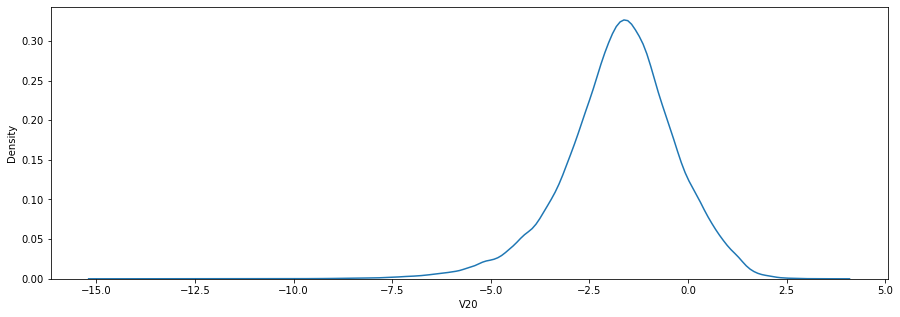

In [113]:
# USING LOG Transformation

print(np.log(df['V20']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V20']),hist=False)
plt.show()

In [114]:
## V20 was initially moderately skewed and after under root 10 transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V20 variable as a under root 10 tranformation

### V21 column

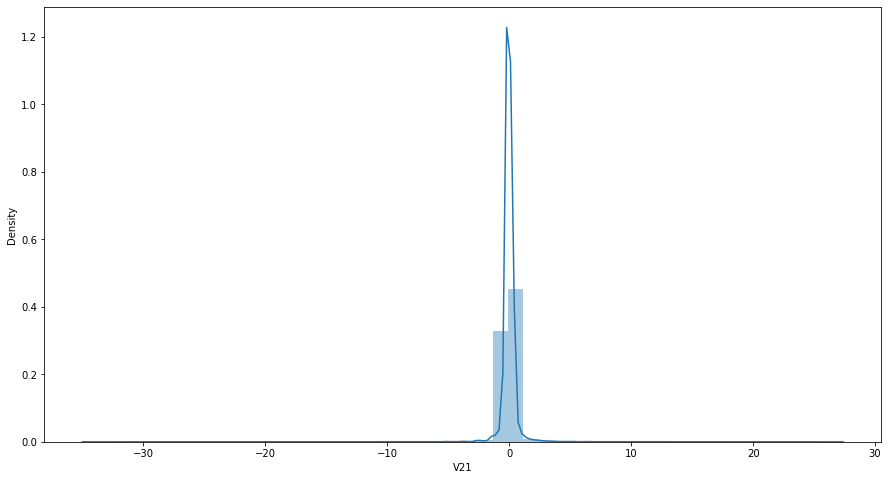

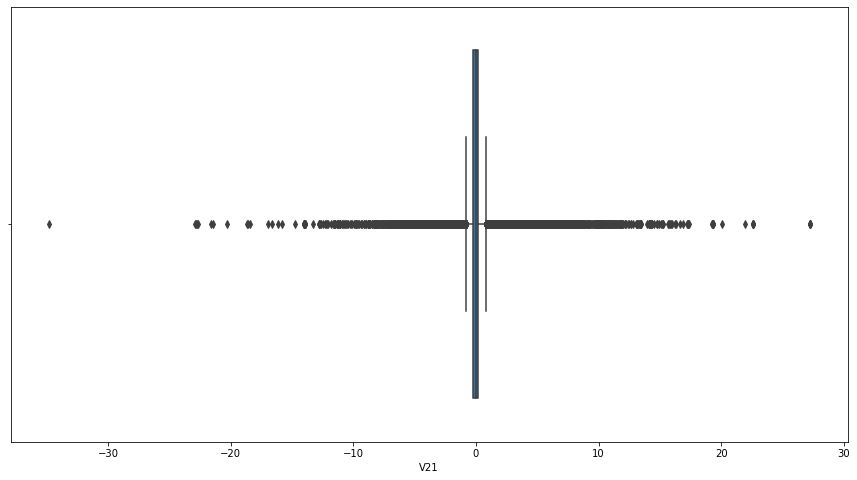

In [115]:
plt.figure(figsize = (15,8))
sns.distplot(df['V21'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V21'])
plt.show()

In [116]:
df['V21'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.473120e-16
std      7.345240e-01
min     -3.483038e+01
10%     -3.674467e-01
20%     -2.663929e-01
25%     -2.283949e-01
30%     -1.878180e-01
40%     -1.064266e-01
50%     -2.945017e-02
60%      5.038722e-02
70%      1.379046e-01
75%      1.863772e-01
80%      2.354311e-01
90%      3.761555e-01
99%      1.931852e+00
max      2.720284e+01
Name: V21, dtype: float64

In [117]:
df['V21'].skew(), df['V21'].kurt()

(3.5929911930778453, 207.28704035333402)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


3.4853385382308444


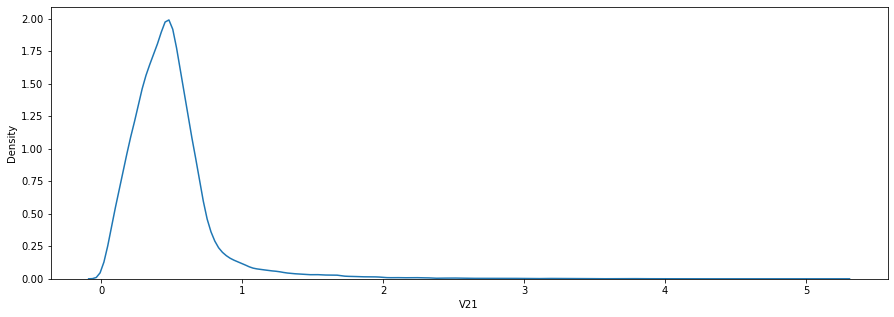

In [118]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V21']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V21']),hist=False)
plt.show()

-0.4249972273556298


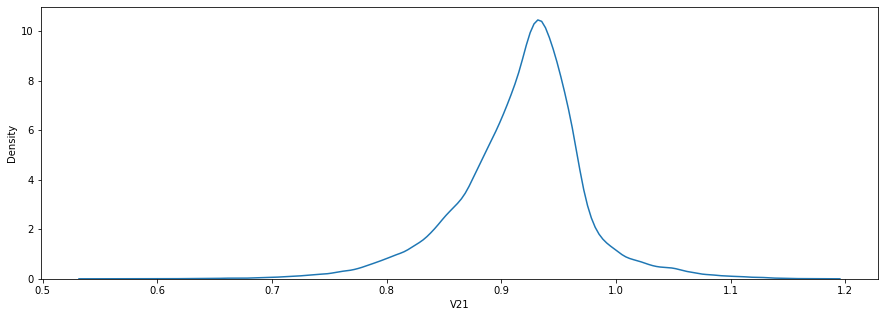

In [119]:
# USING ROOT of 10

print(np.sqrt(df['V21']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V21']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.8111329082550041


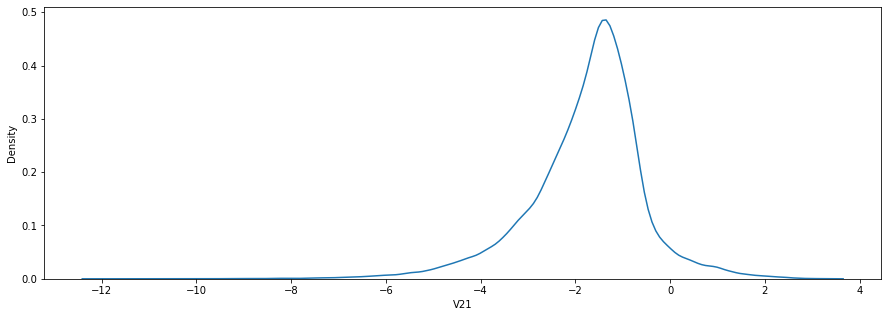

In [120]:
# USING LOG Transformation

print(np.log(df['V21']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V21']),hist=False)
plt.show()

In [121]:
## V21 was initially heaviily skewed and after using log transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V21 variable as a using log tranformation

### V22 column

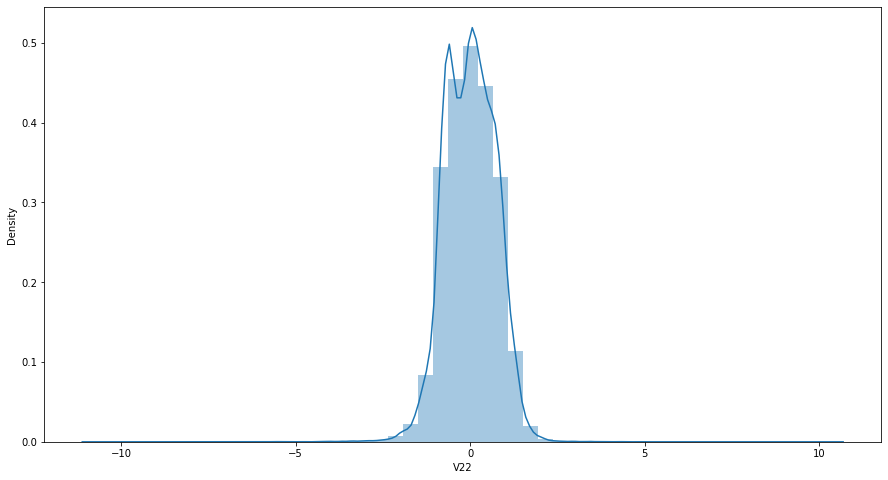

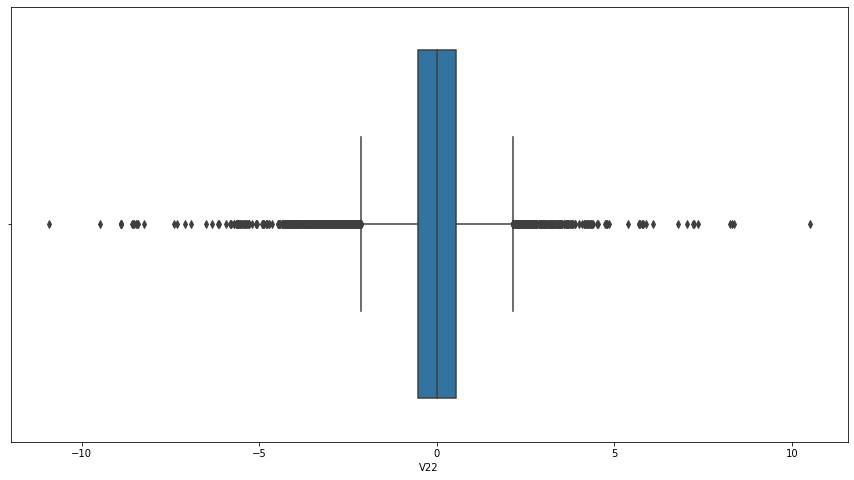

In [122]:
plt.figure(figsize = (15,8))
sns.distplot(df['V22'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V22'])
plt.show()

In [123]:
df['V22'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     8.042109e-16
std      7.257016e-01
min     -1.093314e+01
10%     -8.674884e-01
20%     -6.416046e-01
25%     -5.423504e-01
30%     -4.344265e-01
40%     -2.018541e-01
50%      6.781943e-03
60%      2.005957e-01
70%      4.127470e-01
75%      5.285536e-01
80%      6.485158e-01
90%      9.148826e-01
99%      1.530152e+00
max      1.050309e+01
Name: V22, dtype: float64

In [124]:
df['V22'].skew(), df['V22'].kurt()

(-0.21325762284328822, 2.8329665163717817)

In [125]:
## Since V22 is midly skewed, we won't be using any tranformation technique

### V23 column

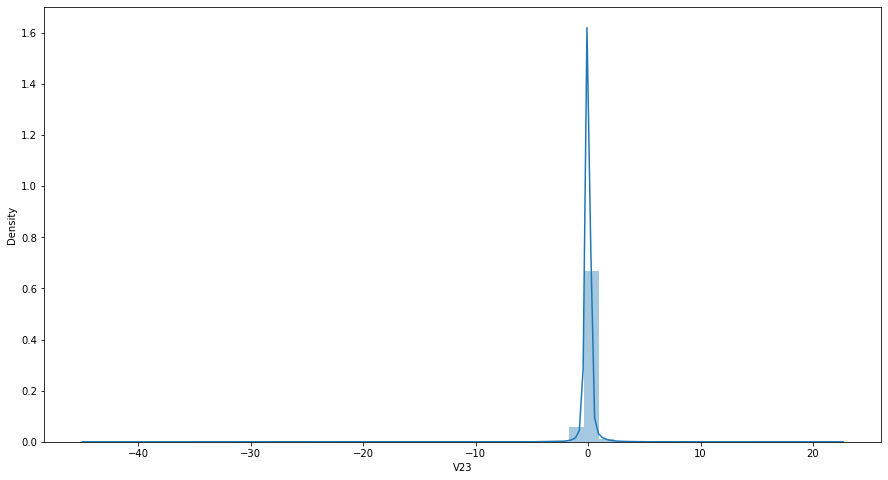

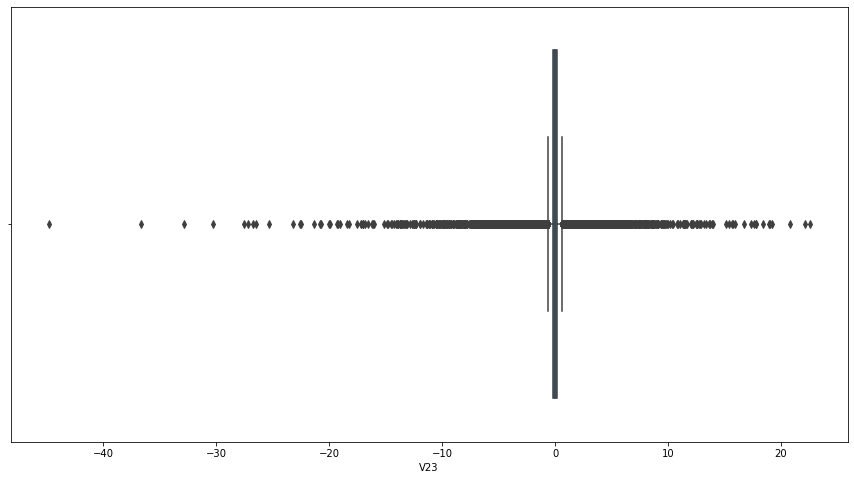

In [126]:
plt.figure(figsize = (15,8))
sns.distplot(df['V23'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V23'])
plt.show()

In [127]:
df['V23'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     5.282512e-16
std      6.244603e-01
min     -4.480774e+01
10%     -3.286342e-01
20%     -2.037425e-01
25%     -1.618463e-01
30%     -1.261571e-01
40%     -6.512670e-02
50%     -1.119293e-02
60%      4.484023e-02
70%      1.092714e-01
75%      1.476421e-01
80%      1.942589e-01
90%      3.392860e-01
99%      1.508703e+00
max      2.252841e+01
Name: V23, dtype: float64

In [128]:
df['V23'].skew(), df['V23'].kurt()

(-5.875140340106818, 440.08865867495405)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


2.752428320010352


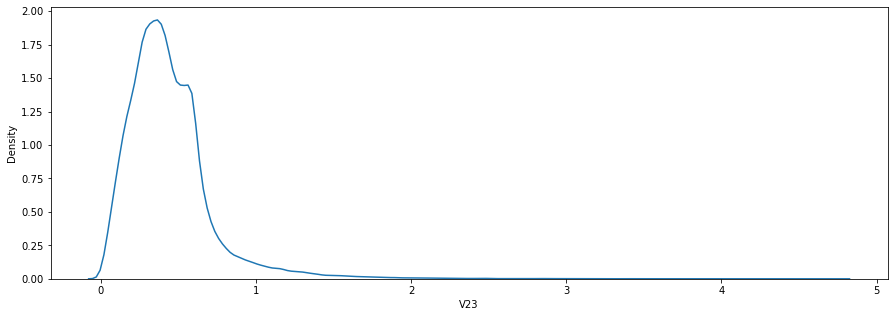

In [129]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V23']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V23']),hist=False)
plt.show()

-0.483476236583958


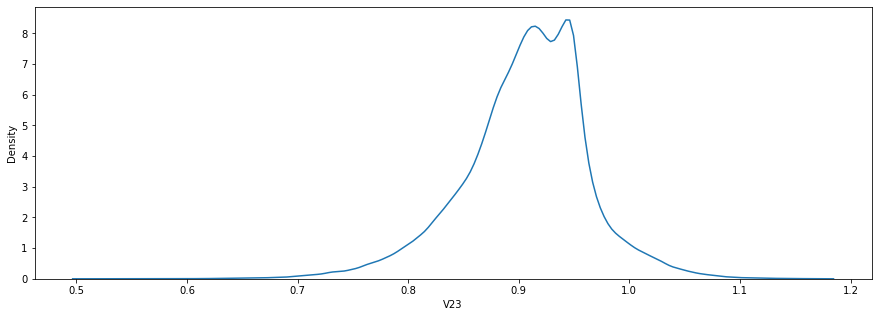

In [130]:
# USING ROOT of 10

print(np.sqrt(df['V23']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V23']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.8243127922642008


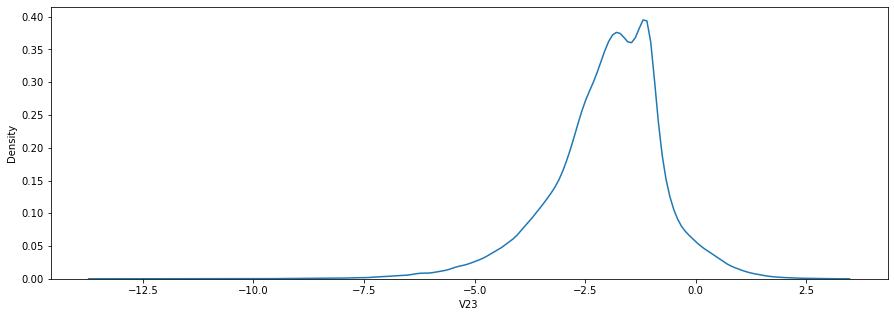

In [131]:
# USING LOG Transformation

print(np.log(df['V23']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V23']),hist=False)
plt.show()

In [132]:
## V23 was initially heavily skewed and we see it change after square root transfomation and using log transformation.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V23 variable as a log tranformation

### V24 column

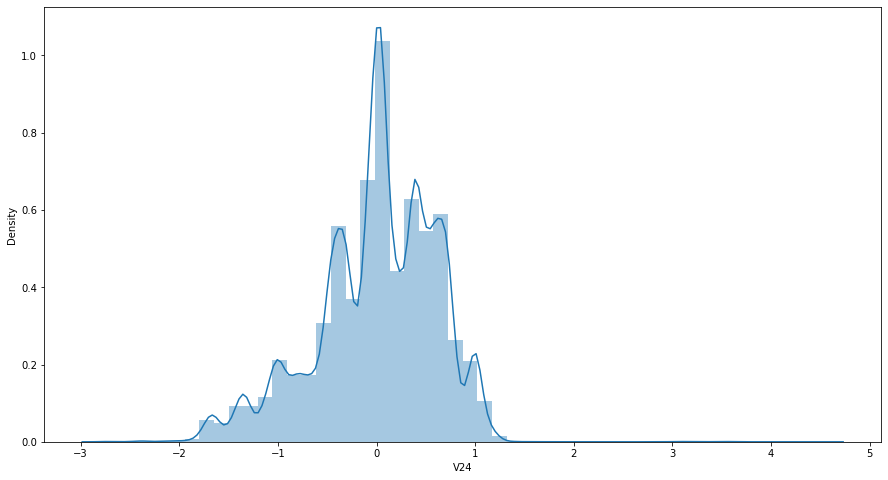

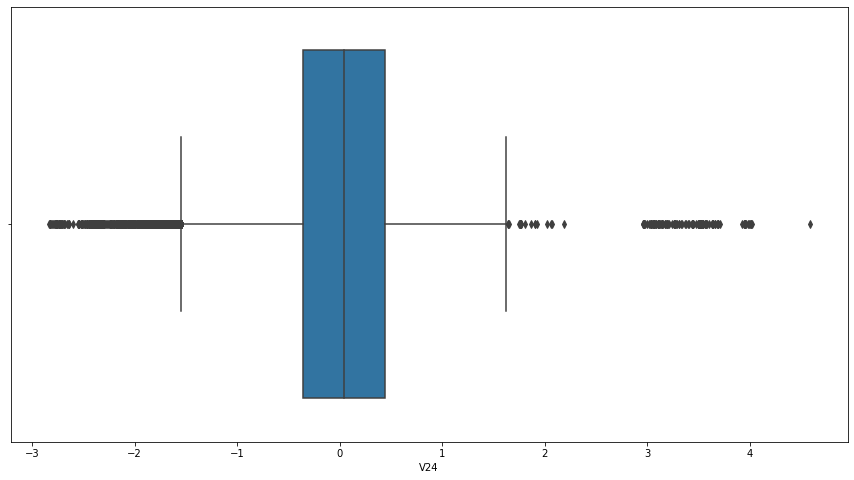

In [133]:
plt.figure(figsize = (15,8))
sns.distplot(df['V24'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V24'])
plt.show()

In [134]:
df['V24'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     4.456271e-15
std      6.056471e-01
min     -2.836627e+00
10%     -8.703584e-01
20%     -4.442769e-01
25%     -3.545861e-01
30%     -2.635025e-01
40%     -4.580667e-02
50%      4.097606e-02
60%      1.664115e-01
70%      3.742132e-01
75%      4.395266e-01
80%      5.323465e-01
90%      7.054036e-01
99%      1.063748e+00
max      4.584549e+00
Name: V24, dtype: float64

In [135]:
df['V24'].skew(), df['V24'].kurt()

(-0.5524993011673045, 0.6188707999933452)

In [136]:
## Since V24 is midly skewed, we won't be using any tranformation technique

### V25 column

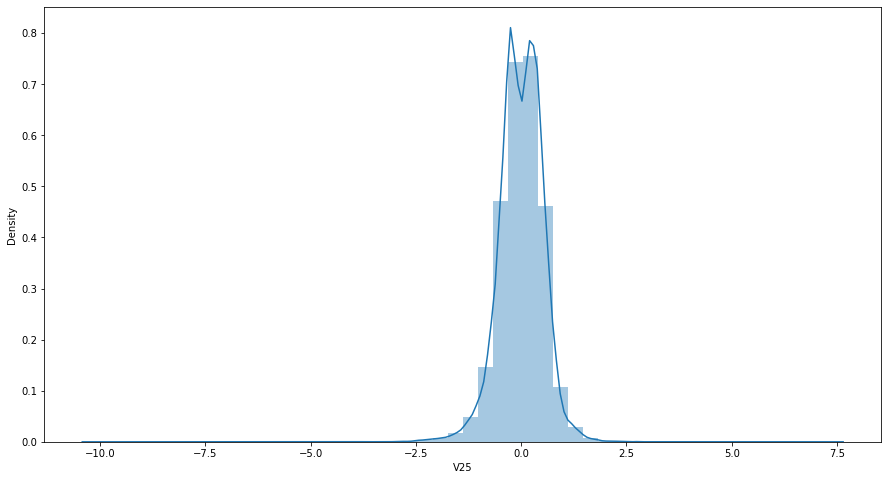

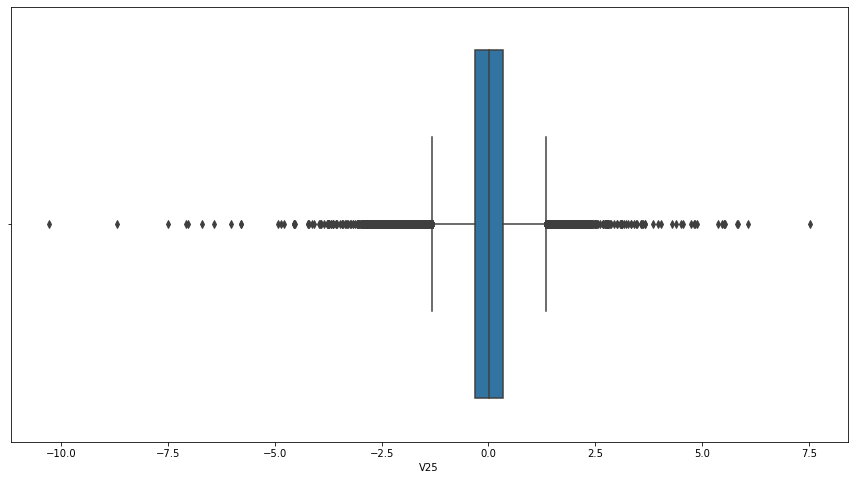

In [137]:
plt.figure(figsize = (15,8))
sns.distplot(df['V25'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V25'])
plt.show()

In [138]:
df['V25'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.426896e-15
std      5.212781e-01
min     -1.029540e+01
10%     -6.061010e-01
20%     -3.917190e-01
25%     -3.171451e-01
30%     -2.583651e-01
40%     -1.288661e-01
50%      1.659350e-02
60%      1.586211e-01
70%      2.849178e-01
75%      3.507156e-01
80%      4.175428e-01
90%      6.009027e-01
99%      1.203955e+00
max      7.519589e+00
Name: V25, dtype: float64

In [139]:
df['V25'].skew(), df['V25'].kurt()

(-0.4157925903156351, 4.290412283119673)

In [140]:
## Since V25 is midly skewed, we won't be using any tranformation technique

### V26 column

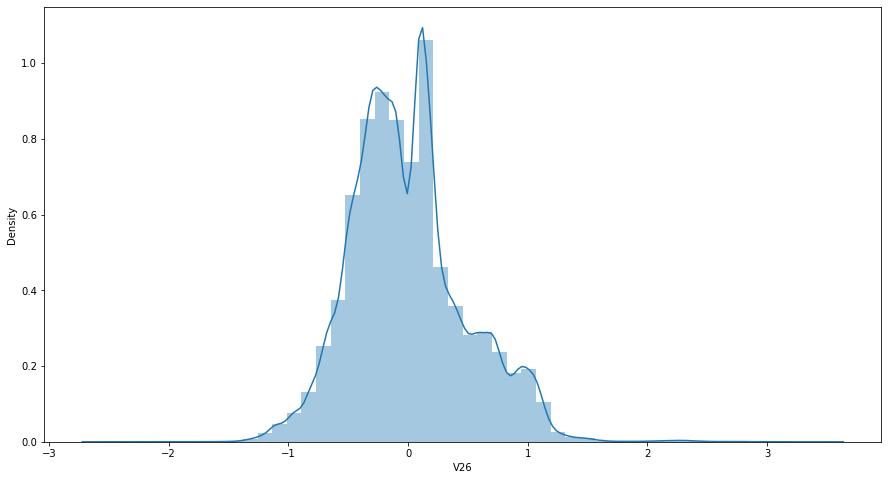

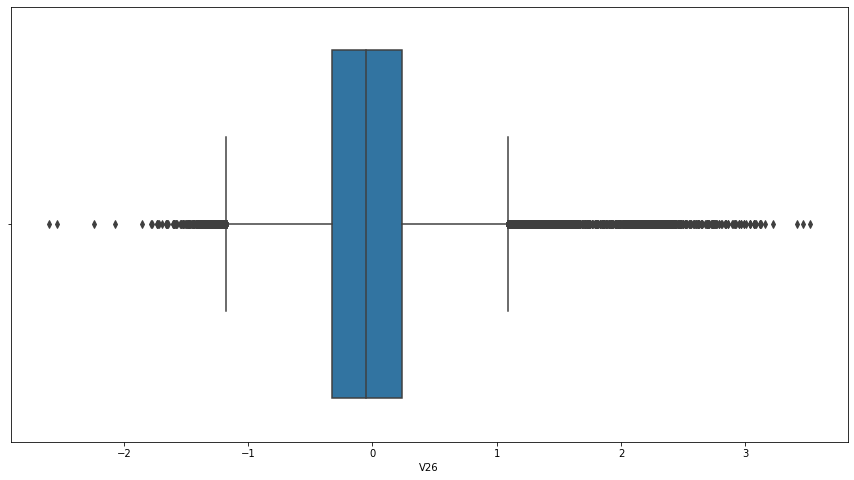

In [141]:
plt.figure(figsize = (15,8))
sns.distplot(df['V26'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V26'])
plt.show()

In [142]:
df['V26'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean     1.701640e-15
std      4.822270e-01
min     -2.604551e+00
10%     -5.480343e-01
20%     -3.895481e-01
25%     -3.269839e-01
30%     -2.744373e-01
40%     -1.663338e-01
50%     -5.213911e-02
60%      8.611185e-02
70%      1.751137e-01
75%      2.409522e-01
80%      3.602736e-01
90%      6.889469e-01
99%      1.158698e+00
max      3.517346e+00
Name: V26, dtype: float64

In [143]:
df['V26'].skew(), df['V26'].kurt()

(0.5766926172084218, 0.919005770879612)

In [144]:
## Since V26 is midly skewed, we won't be using any tranformation technique

### V27 column

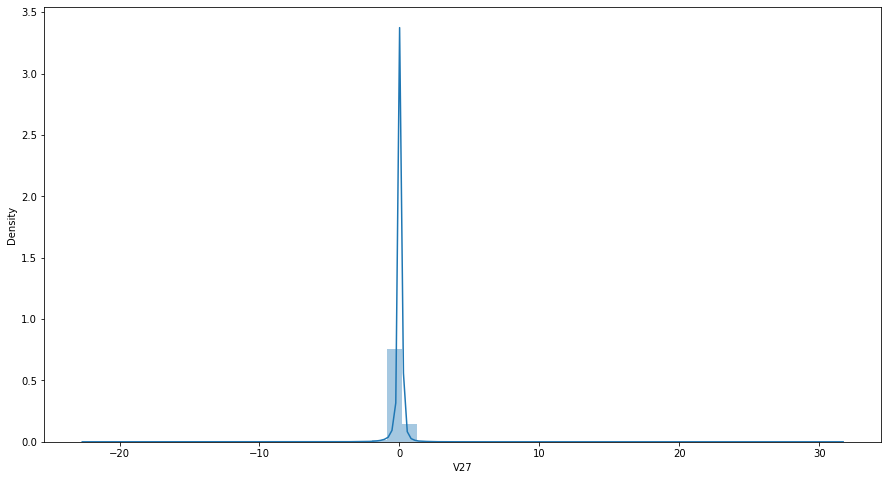

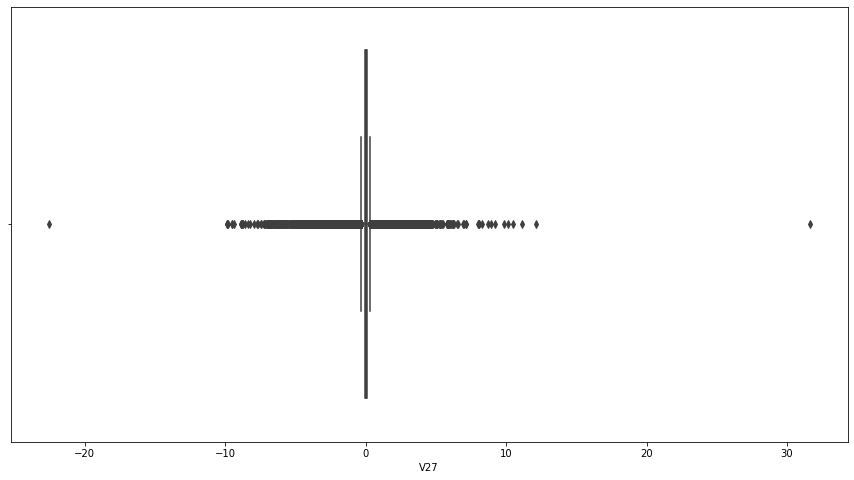

In [145]:
plt.figure(figsize = (15,8))
sns.distplot(df['V27'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V27'])
plt.show()

In [146]:
df['V27'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -3.662252e-16
std      4.036325e-01
min     -2.256568e+01
10%     -2.114656e-01
20%     -9.111428e-02
25%     -7.083953e-02
30%     -5.423468e-02
40%     -2.436683e-02
50%      1.342146e-03
60%      2.922621e-02
70%      6.315093e-02
75%      9.104512e-02
80%      1.352785e-01
90%      2.653679e-01
99%      9.313604e-01
max      3.161220e+01
Name: V27, dtype: float64

In [147]:
df['V27'].skew(), df['V27'].kurt()

(-1.1702089424327133, 244.98924056630815)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


1.950617455650618


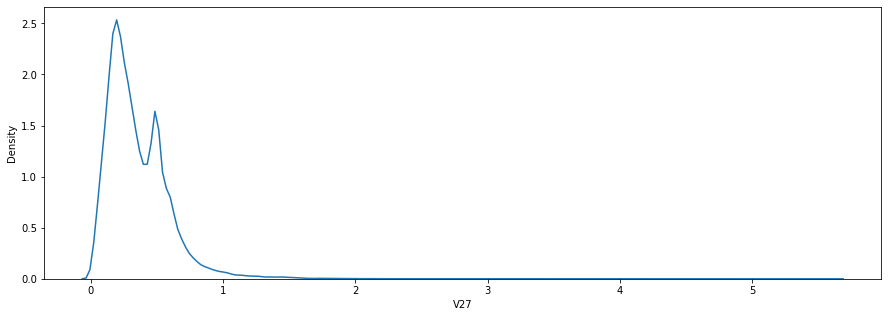

In [148]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V27']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V27']),hist=False)
plt.show()

-0.4262487250971915


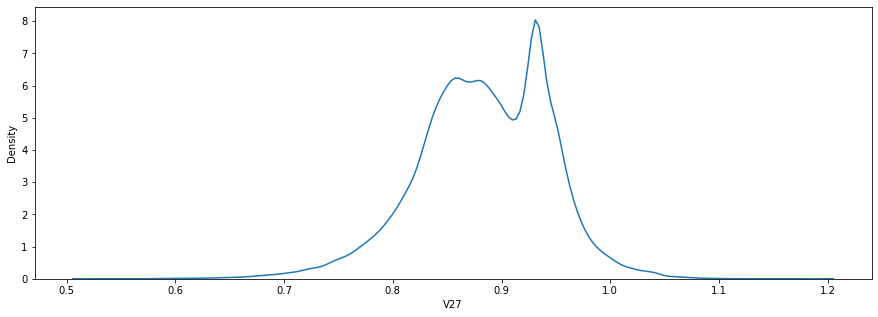

In [149]:
# USING ROOT of 10

print(np.sqrt(df['V27']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V27']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.7120960607435274


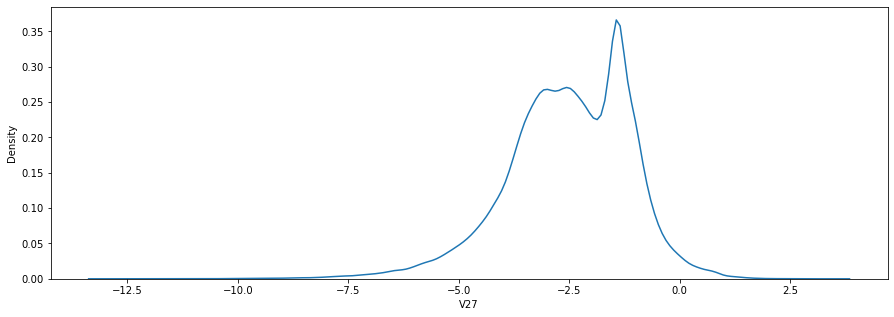

In [150]:
# USING LOG Transformation

print(np.log(df['V27']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V27']),hist=False)
plt.show()

In [151]:
## V27 was initially moderately skewed and after under root 10 and log transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V27 variable as a under root 10 or log tranformation

### V28 column

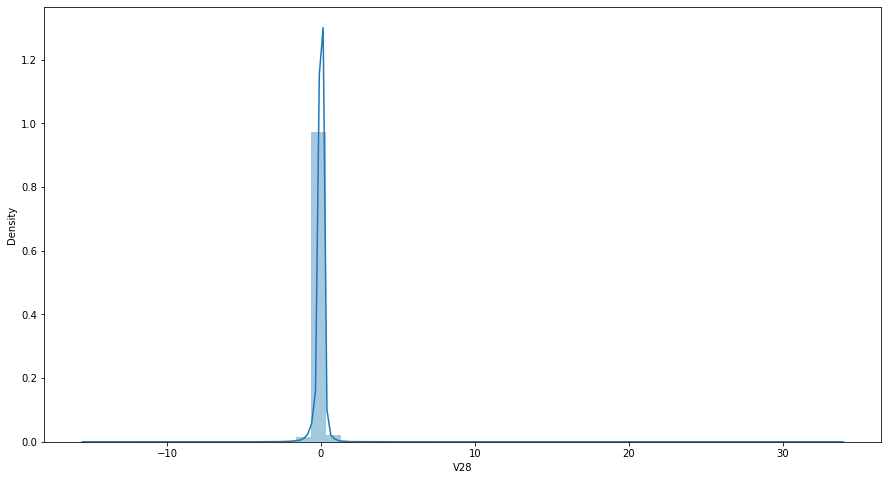

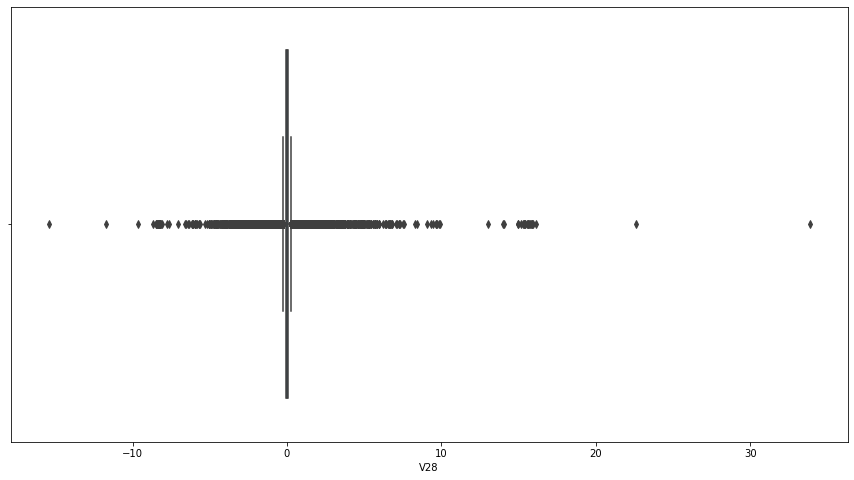

In [152]:
plt.figure(figsize = (15,8))
sns.distplot(df['V28'])
plt.figure(figsize = (15,8))
sns.boxplot(df['V28'])
plt.show()

In [153]:
df['V28'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    2.848070e+05
mean    -1.217809e-16
std      3.300833e-01
min     -1.543008e+01
10%     -1.556155e-01
20%     -6.544115e-02
25%     -5.295979e-02
30%     -4.026708e-02
40%     -1.195983e-02
50%      1.124383e-02
60%      2.692801e-02
70%      5.350104e-02
75%      7.827995e-02
80%      1.013742e-01
90%      1.799362e-01
99%      5.411264e-01
max      3.384781e+01
Name: V28, dtype: float64

In [154]:
df['V28'].skew(), df['V28'].kurt()

(11.19209119221281, 933.3975020960183)

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


3.526752385719213


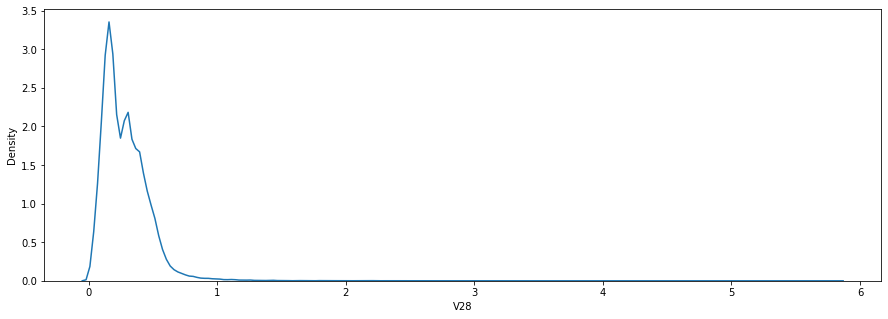

In [155]:
# SQUARE ROOT Transformation

print(np.sqrt(df['V28']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V28']),hist=False)
plt.show()

-0.363297717766338


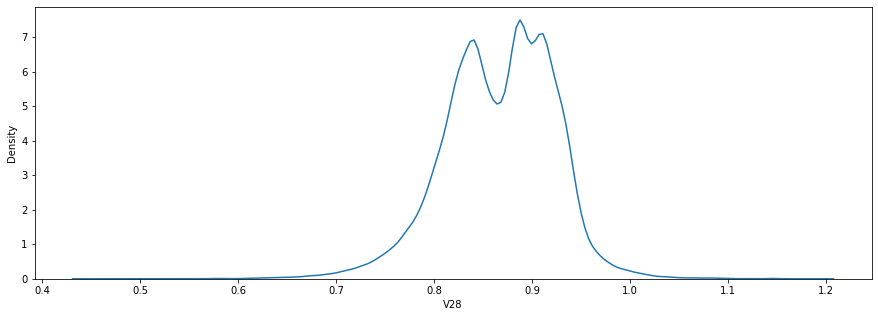

In [156]:
# USING ROOT of 10

print(np.sqrt(df['V28']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['V28']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


-0.6503808713770457


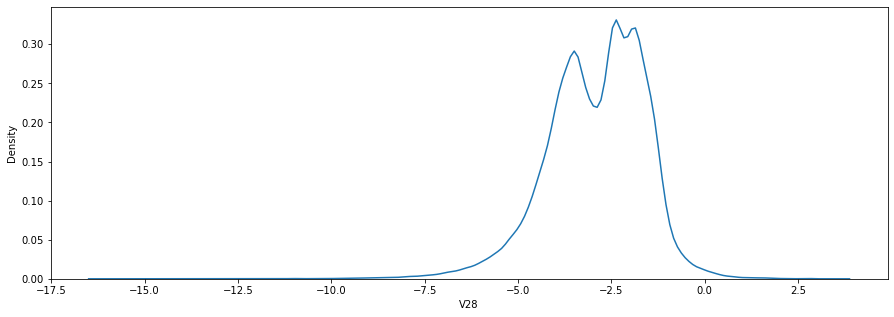

In [157]:
# USING LOG Transformation

print(np.log(df['V28']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['V28']),hist=False)
plt.show()

In [158]:
## V28 was initially heavily skewed, which after under root 10 or log transformation it is heavily  after under root 10 transformation it is mildly skewed.
## Therefore, from a model performace improvement prespective, we can look at tranformation of V20 variable as a under root 10 tranformation

### AMOUNT column

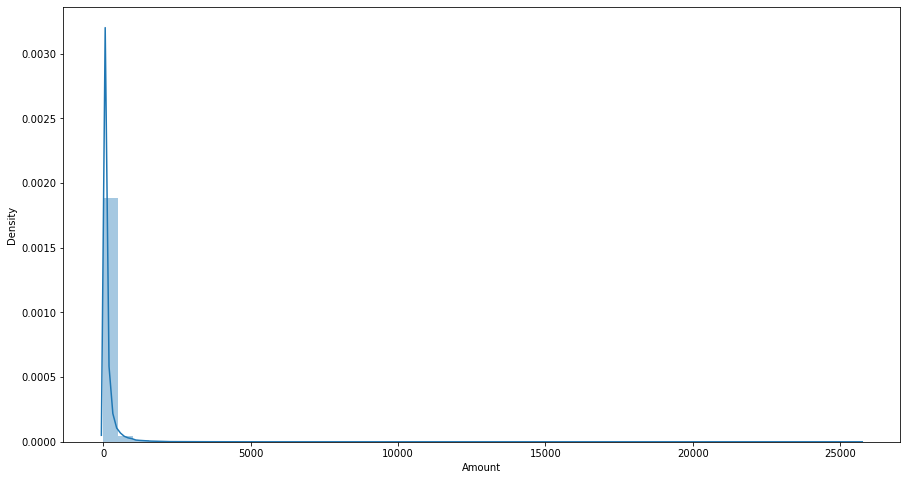

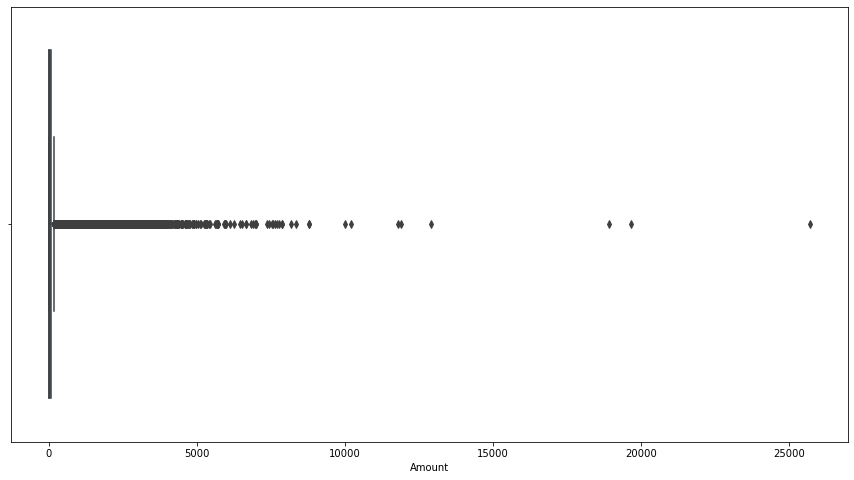

In [159]:
plt.figure(figsize = (15,8))
sns.distplot(df['Amount'])
plt.figure(figsize = (15,8))
sns.boxplot(df['Amount'])
plt.show()

In [160]:
df['Amount'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    284807.000000
mean         88.349619
std         250.120109
min           0.000000
10%           1.000000
20%           3.570000
25%           5.600000
30%           8.910000
40%          13.000000
50%          22.000000
60%          37.000000
70%          59.800000
75%          77.165000
80%         100.000000
90%         203.000000
99%        1017.970000
max       25691.160000
Name: Amount, dtype: float64

In [161]:
df['Amount'].skew(), df['Amount'].kurt()

(16.977724453761024, 845.0926455465277)

2.8222631528102635


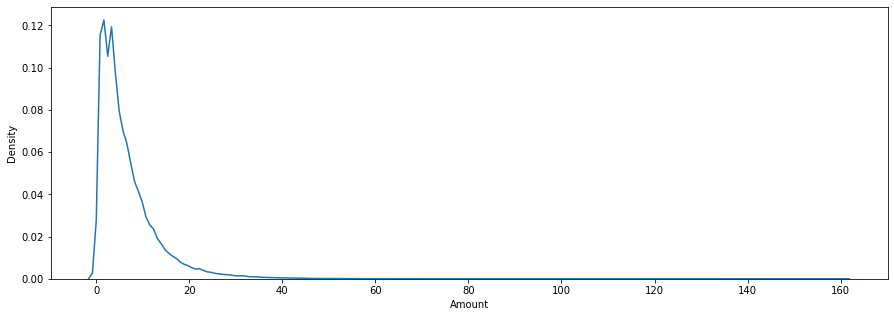

In [162]:
# SQUARE ROOT Transformation

print(np.sqrt(df['Amount']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['Amount']),hist=False)
plt.show()

-3.3552632310584465


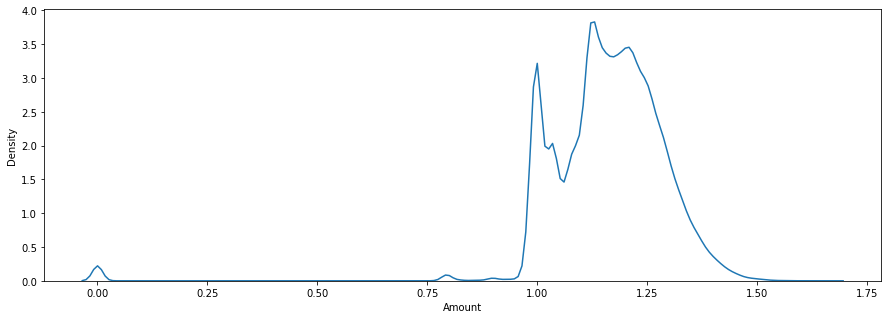

In [163]:
# USING ROOT of 10

print(np.sqrt(df['Amount']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['Amount']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


nan


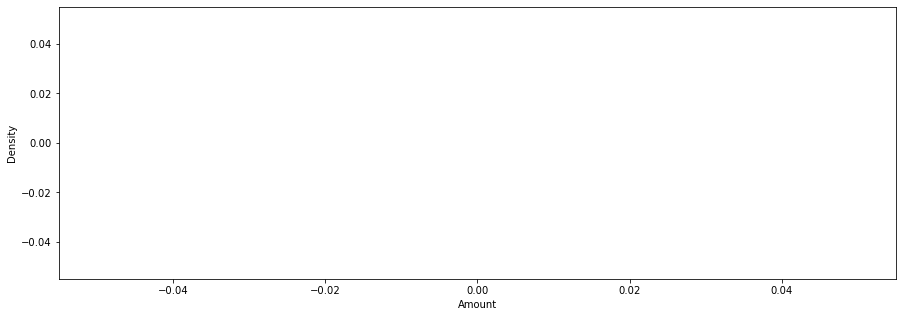

In [164]:
# USING LOG Transformation

print(np.log(df['Amount']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['Amount']),hist=False)
plt.show()

In [165]:
## 'Amount' was initially heavy skewed and after square root transformation it is mildly skewed
## Therefore, from a model performace improvement prespective, we can look at tranformation of 'Amount' variable as a square root tranformation

### CLASS column

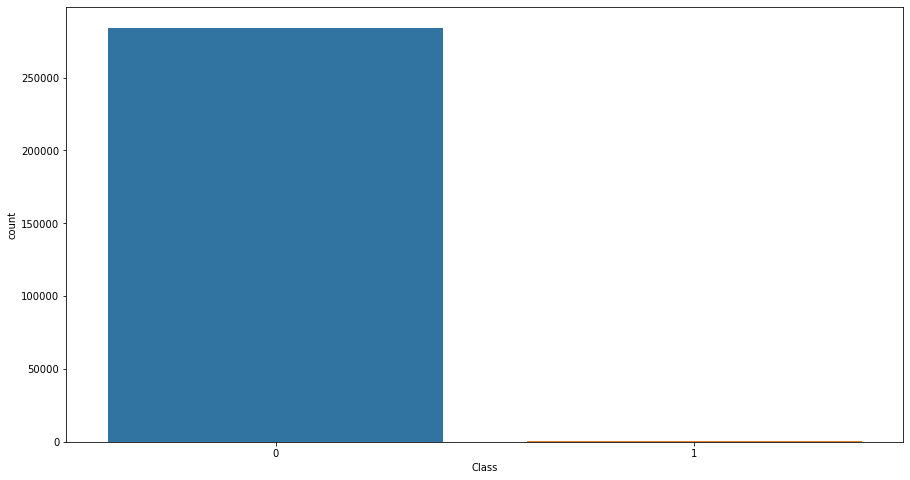

In [166]:
plt.figure(figsize = (15,8))
sns.countplot(data=df,x='Class')
plt.show()

In [167]:
df['Class'].describe(percentiles=[0.1,0.2,0.25,0.3,0.4,0.5,0.6,0.7,0.75,0.8,0.9,0.99])

count    284807.000000
mean          0.001727
std           0.041527
min           0.000000
10%           0.000000
20%           0.000000
25%           0.000000
30%           0.000000
40%           0.000000
50%           0.000000
60%           0.000000
70%           0.000000
75%           0.000000
80%           0.000000
90%           0.000000
99%           0.000000
max           1.000000
Name: Class, dtype: float64

In [168]:
df['Class'].skew(), df['Class'].kurt()

(23.99757931064749, 573.887842782971)

23.99757931064749


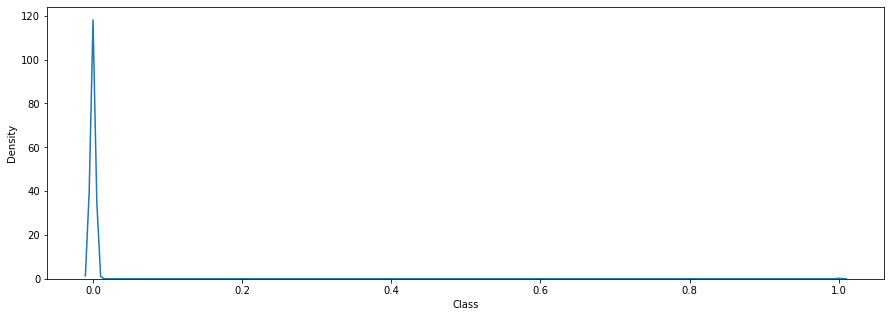

In [169]:
# SQUARE ROOT Transformation

print(np.sqrt(df['Class']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['Class']),hist=False)
plt.show()

23.99757931064749


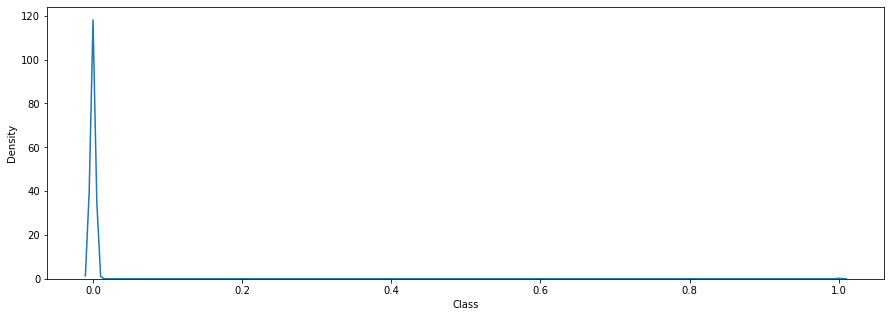

In [170]:
# USING ROOT of 10

print(np.sqrt(df['Class']**0.1).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.sqrt(df['Class']**0.1),hist=False)
plt.show()

C:\Users\admin\anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


nan


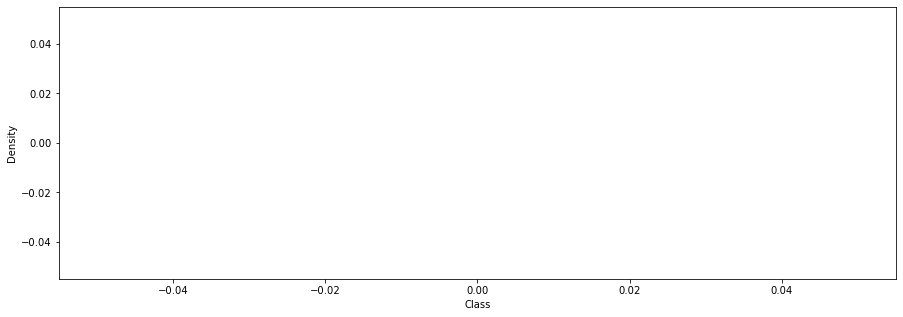

In [171]:
# USING LOG Transformation

print(np.log(df['Class']).skew())
plt.figure(figsize=(15,5))
sns.distplot(np.log(df['Class']),hist=False)
plt.show()

There isn't any change in the skewness after performing square root trnasformation and under root 10 transformation because here in this column we have 2 fixed type of outcome, that is- 0 and 1.

### BIVARIATE analysis of with class

In [172]:
df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

<AxesSubplot:xlabel='V1', ylabel='Class'>

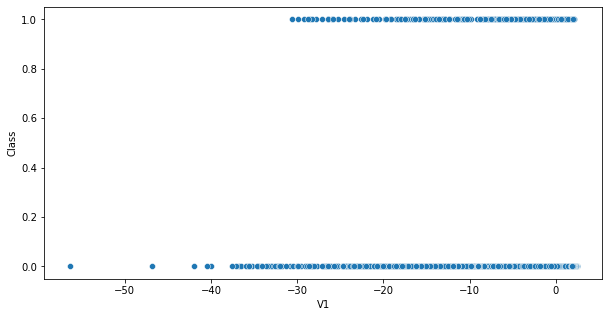

In [173]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["Class"])

<AxesSubplot:xlabel='V2', ylabel='Class'>

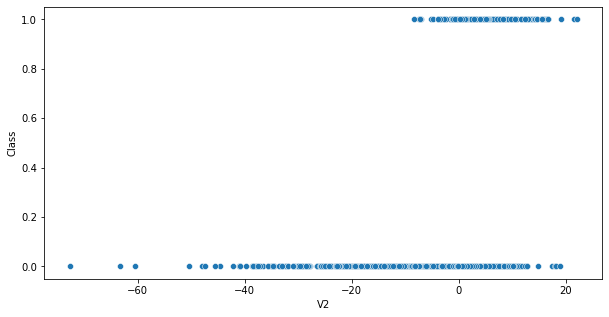

In [174]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["Class"])

<AxesSubplot:xlabel='V3', ylabel='Class'>

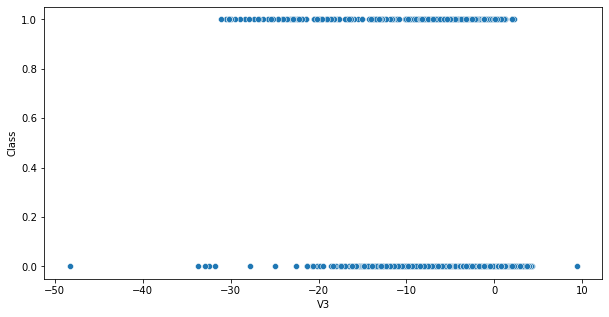

In [175]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["Class"])

<AxesSubplot:xlabel='V4', ylabel='Class'>

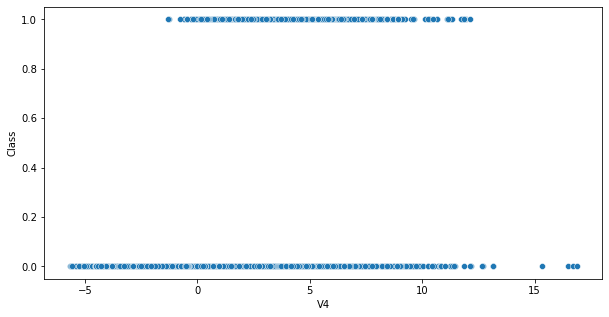

In [176]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["Class"])

<AxesSubplot:xlabel='V5', ylabel='Class'>

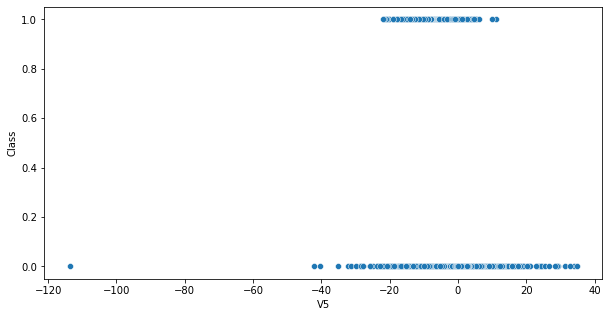

In [177]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["Class"])

<AxesSubplot:xlabel='V6', ylabel='Class'>

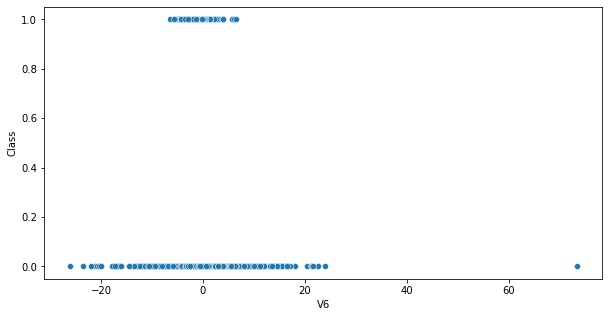

In [178]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["Class"])

<AxesSubplot:xlabel='V7', ylabel='Class'>

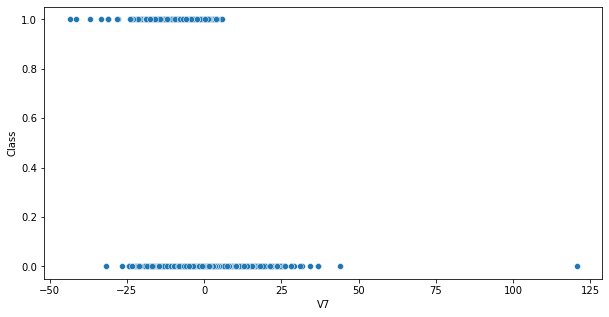

In [179]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["Class"])

<AxesSubplot:xlabel='V8', ylabel='Class'>

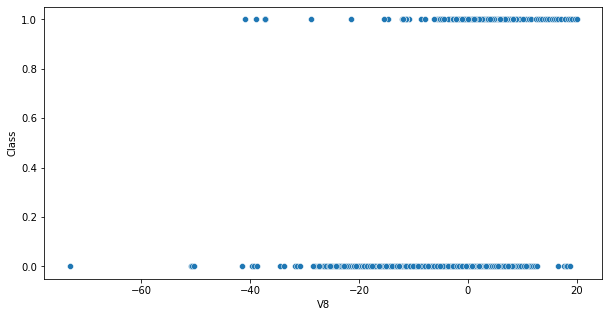

In [180]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["Class"])

<AxesSubplot:xlabel='V9', ylabel='Class'>

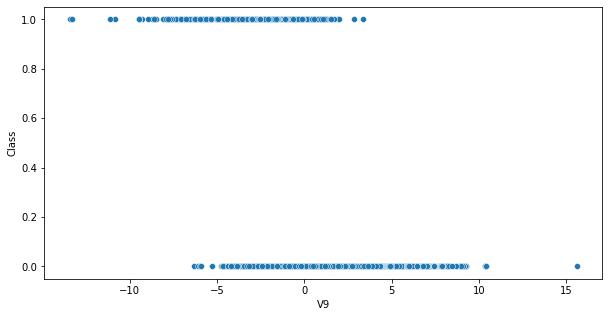

In [181]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["Class"])

<AxesSubplot:xlabel='V10', ylabel='Class'>

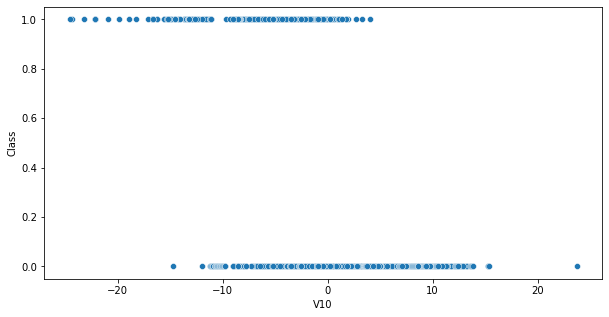

In [182]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["Class"])

<AxesSubplot:xlabel='V11', ylabel='Class'>

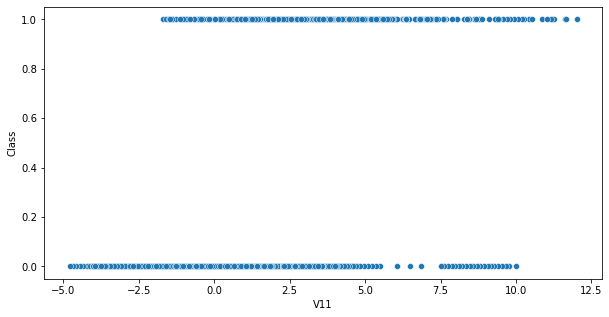

In [183]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["Class"])

<AxesSubplot:xlabel='V12', ylabel='Class'>

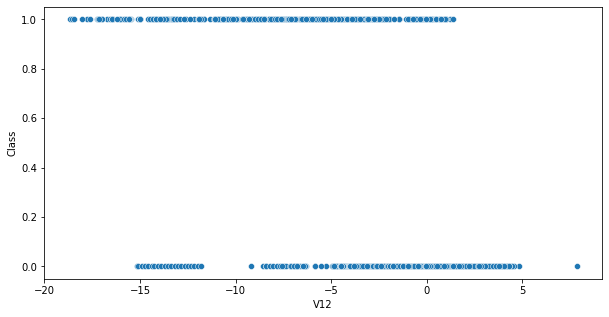

In [184]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["Class"])

<AxesSubplot:xlabel='V13', ylabel='Class'>

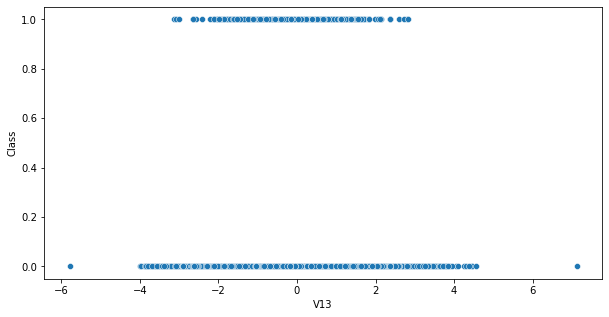

In [185]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["Class"])

<AxesSubplot:xlabel='V14', ylabel='Class'>

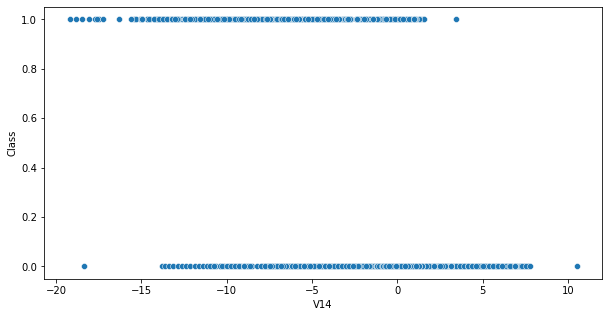

In [186]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["Class"])

<AxesSubplot:xlabel='V15', ylabel='Class'>

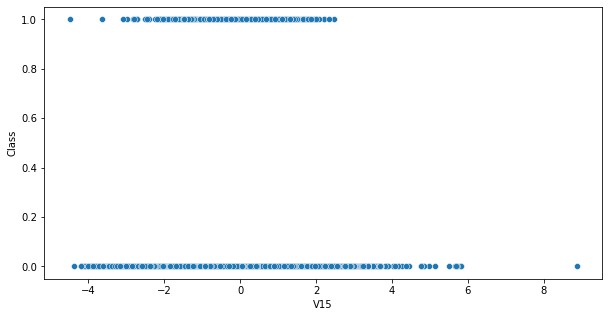

In [187]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["Class"])

<AxesSubplot:xlabel='V16', ylabel='Class'>

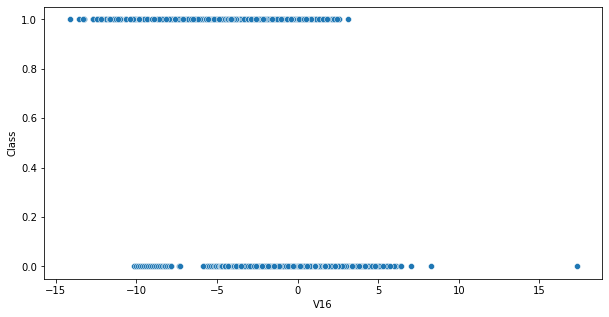

In [188]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["Class"])

<AxesSubplot:xlabel='V17', ylabel='Class'>

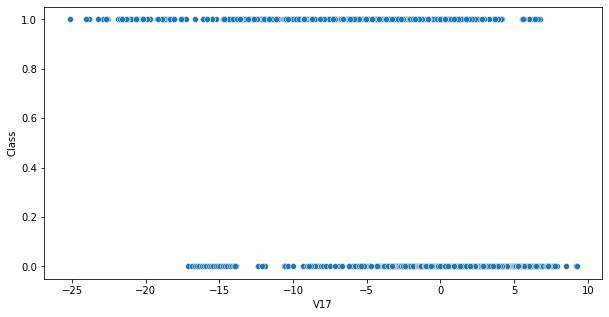

In [189]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["Class"])

<AxesSubplot:xlabel='V18', ylabel='Class'>

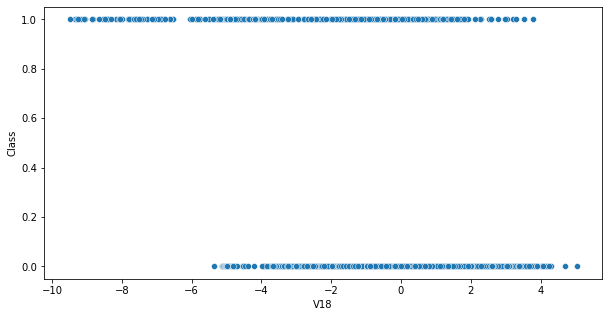

In [190]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["Class"])

<AxesSubplot:xlabel='V19', ylabel='Class'>

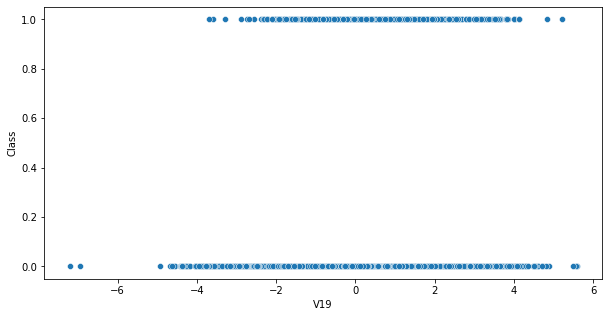

In [191]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["Class"])

<AxesSubplot:xlabel='V20', ylabel='Class'>

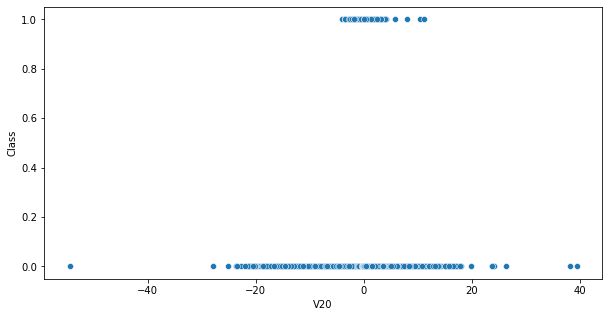

In [192]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["Class"])

<AxesSubplot:xlabel='V21', ylabel='Class'>

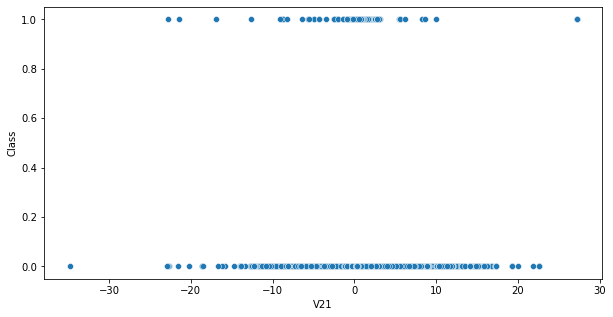

In [193]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["Class"])

<AxesSubplot:xlabel='V22', ylabel='Class'>

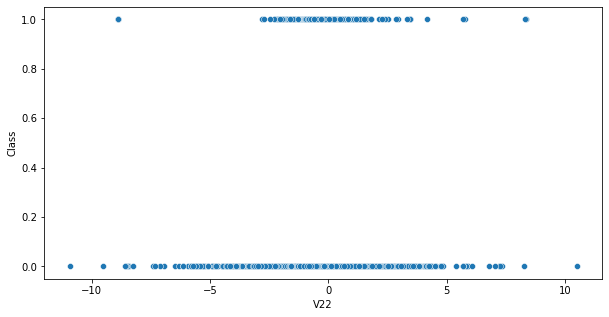

In [194]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["Class"])

<AxesSubplot:xlabel='V23', ylabel='Class'>

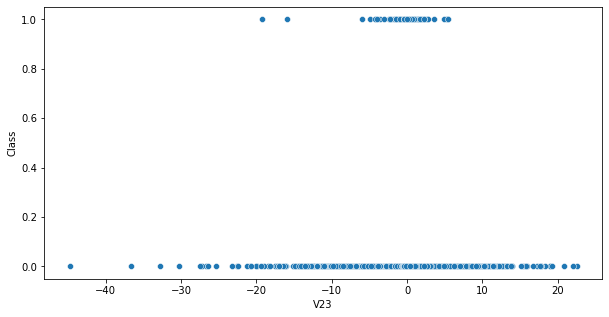

In [195]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["Class"])

<AxesSubplot:xlabel='V24', ylabel='Class'>

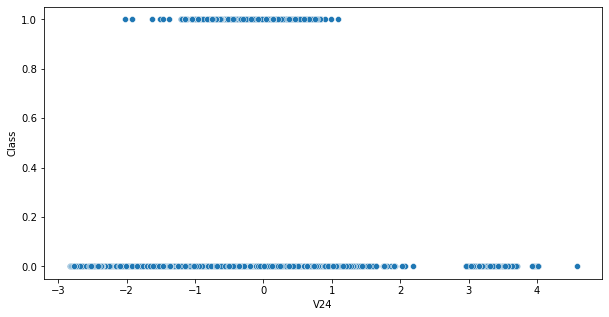

In [196]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["Class"])

<AxesSubplot:xlabel='V25', ylabel='Class'>

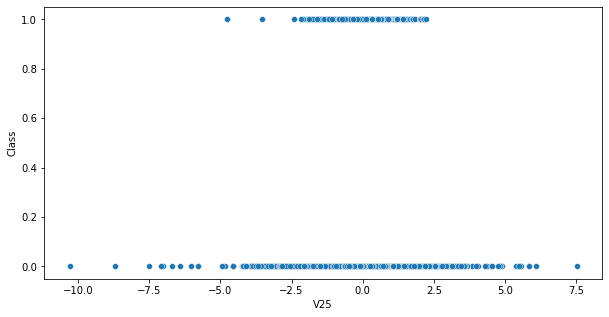

In [197]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V25"],df["Class"])

<AxesSubplot:xlabel='V26', ylabel='Class'>

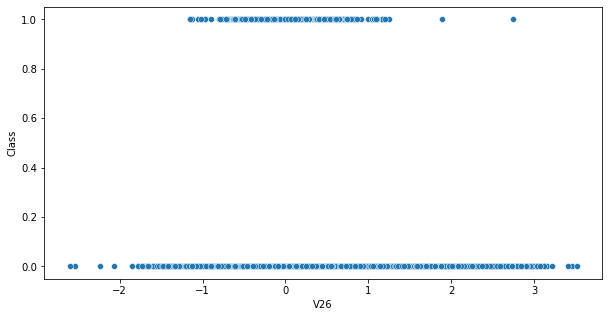

In [198]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V26"],df["Class"])

<AxesSubplot:xlabel='V27', ylabel='Class'>

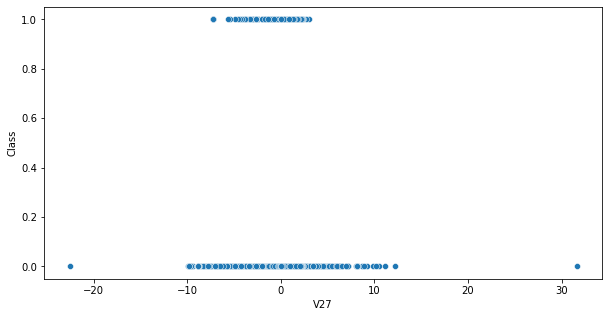

In [199]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V27"],df["Class"])

<AxesSubplot:xlabel='V28', ylabel='Class'>

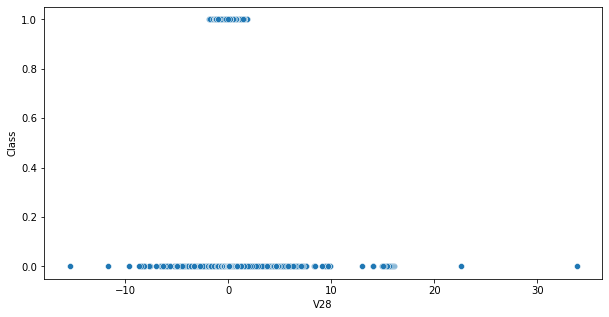

In [200]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V28"],df["Class"])

<AxesSubplot:xlabel='Amount', ylabel='Class'>

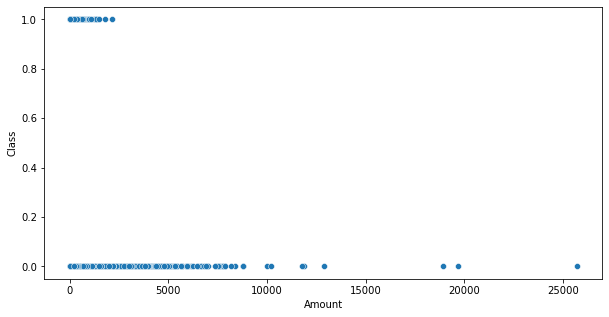

In [201]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["Amount"],df["Class"])

<AxesSubplot:xlabel='V1', ylabel='Amount'>

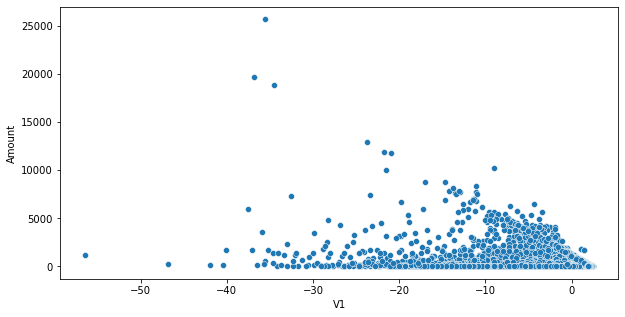

In [202]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["Amount"])

<AxesSubplot:xlabel='V2', ylabel='Amount'>

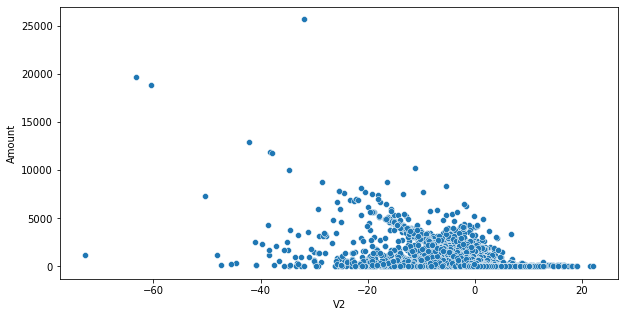

In [203]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["Amount"])

<AxesSubplot:xlabel='V3', ylabel='Amount'>

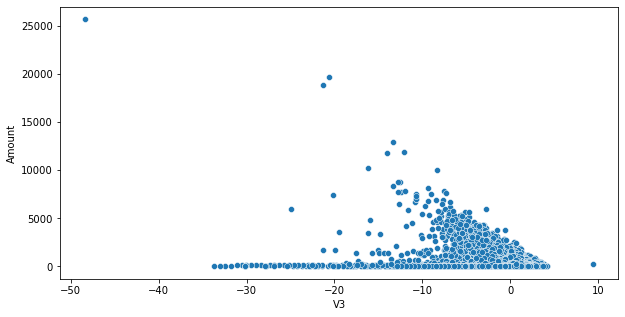

In [204]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["Amount"])

<AxesSubplot:xlabel='V4', ylabel='Amount'>

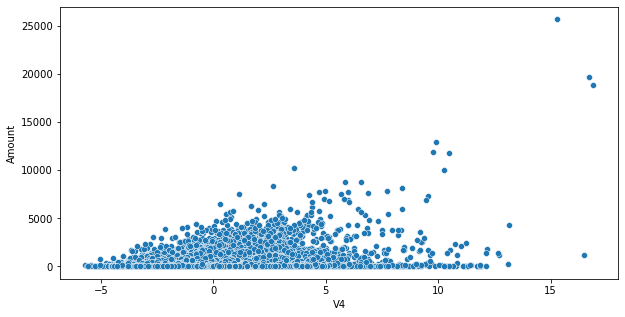

In [205]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["Amount"])

<AxesSubplot:xlabel='V5', ylabel='Amount'>

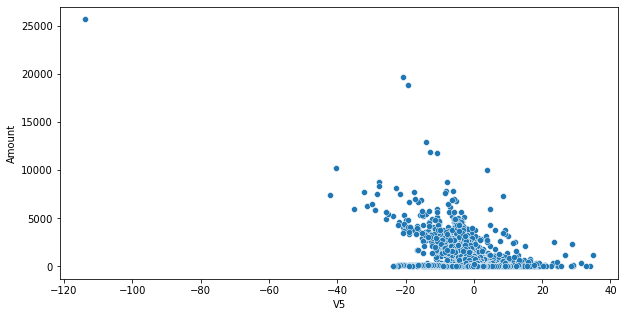

In [206]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["Amount"])

<AxesSubplot:xlabel='V6', ylabel='Amount'>

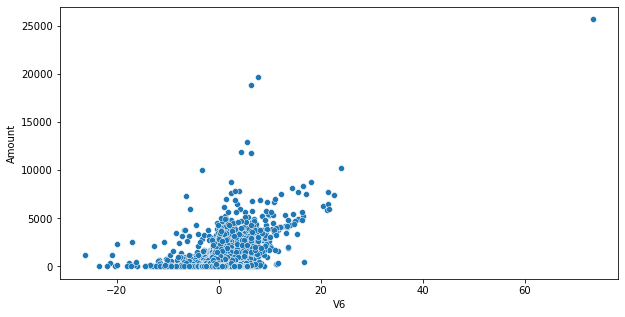

In [207]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["Amount"])

<AxesSubplot:xlabel='V7', ylabel='Amount'>

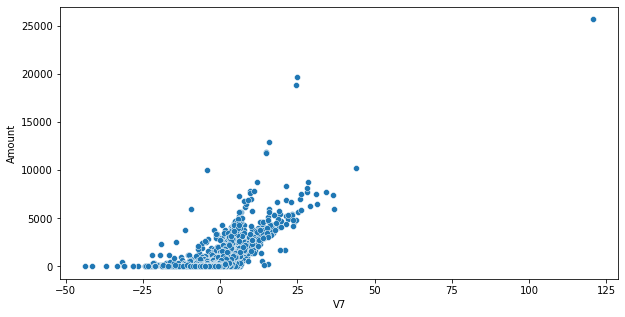

In [208]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["Amount"])

<AxesSubplot:xlabel='V8', ylabel='Amount'>

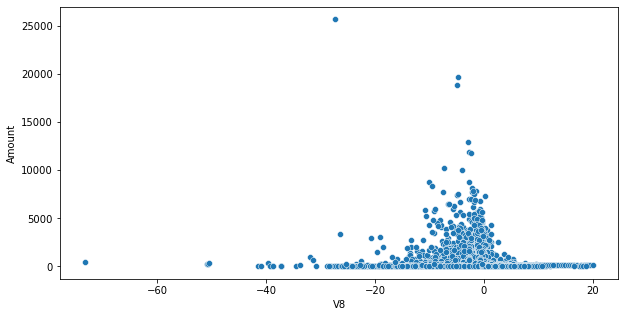

In [209]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["Amount"])

<AxesSubplot:xlabel='V9', ylabel='Amount'>

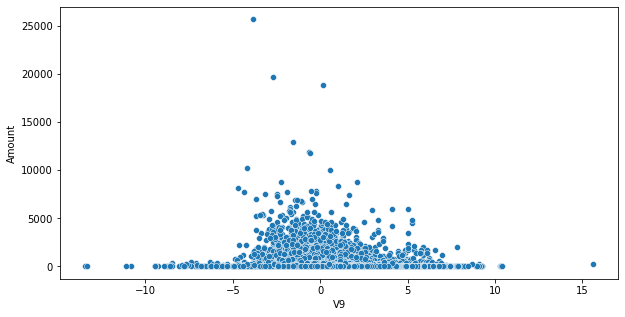

In [210]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["Amount"])

<AxesSubplot:xlabel='V10', ylabel='Amount'>

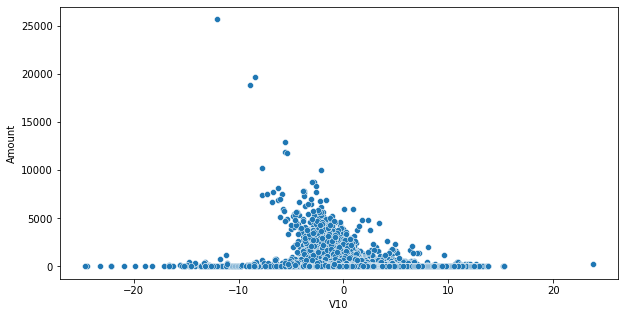

In [211]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["Amount"])

<AxesSubplot:xlabel='V11', ylabel='Amount'>

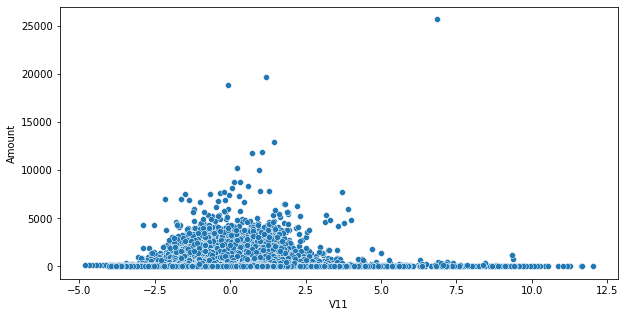

In [212]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["Amount"])

<AxesSubplot:xlabel='V12', ylabel='Amount'>

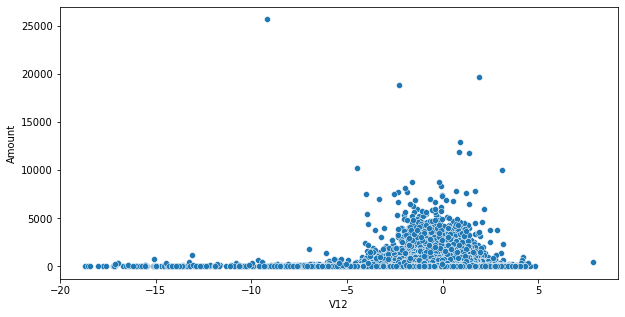

In [213]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["Amount"])

<AxesSubplot:xlabel='V13', ylabel='Amount'>

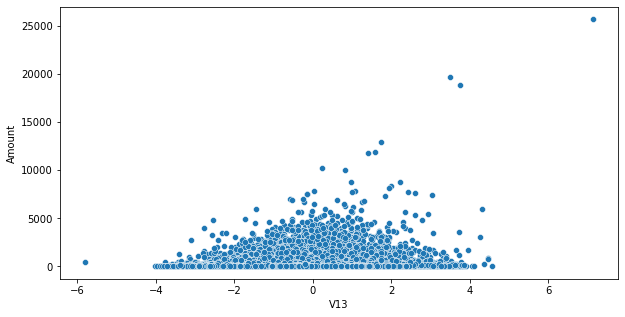

In [214]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["Amount"])

<AxesSubplot:xlabel='V14', ylabel='Amount'>

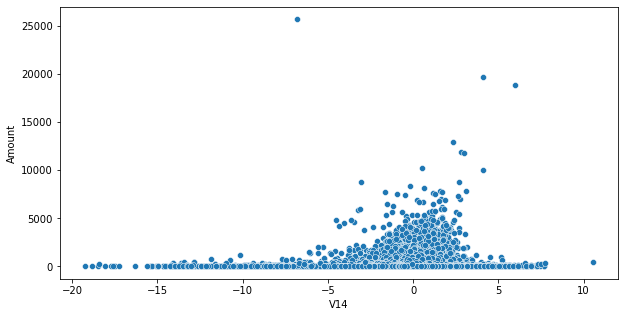

In [215]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["Amount"])

<AxesSubplot:xlabel='V15', ylabel='Amount'>

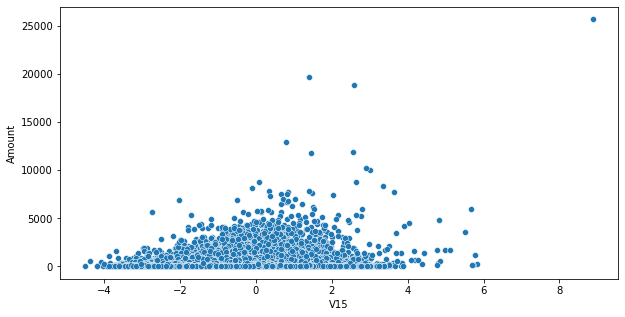

In [216]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["Amount"])

<AxesSubplot:xlabel='V16', ylabel='Amount'>

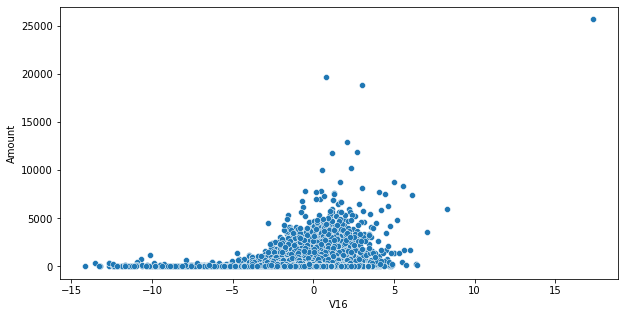

In [217]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["Amount"])

<AxesSubplot:xlabel='V17', ylabel='Amount'>

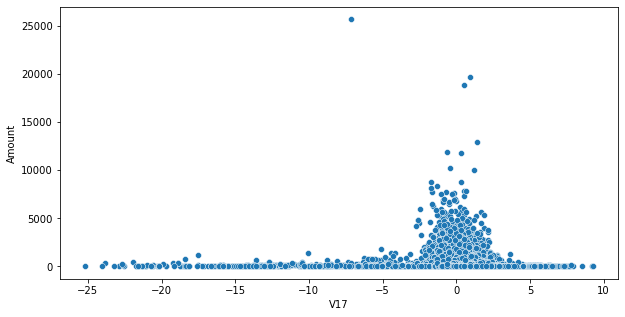

In [218]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["Amount"])

<AxesSubplot:xlabel='V18', ylabel='Amount'>

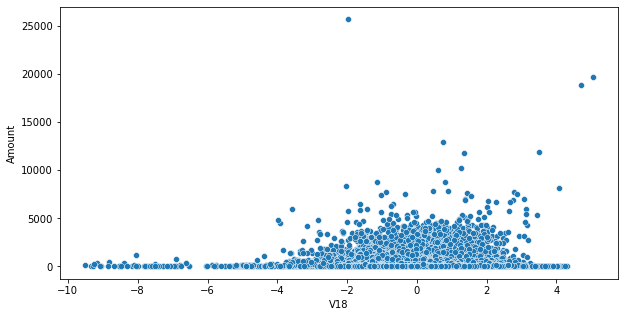

In [219]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["Amount"])

<AxesSubplot:xlabel='V19', ylabel='Amount'>

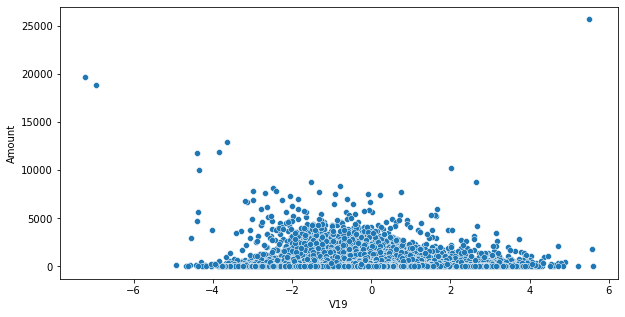

In [220]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["Amount"])

<AxesSubplot:xlabel='V20', ylabel='Amount'>

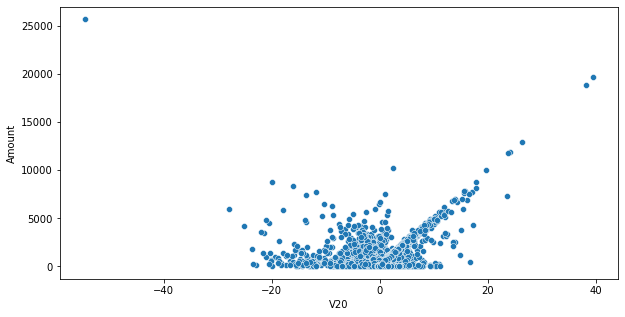

In [221]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["Amount"])

<AxesSubplot:xlabel='V21', ylabel='Amount'>

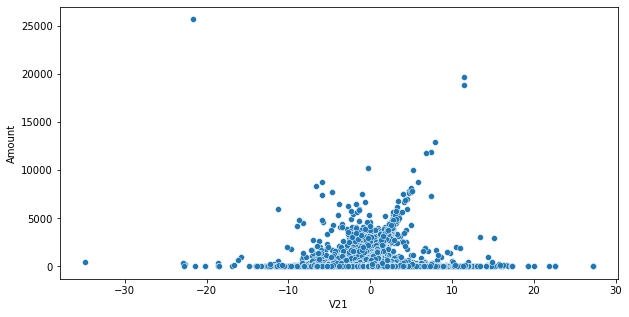

In [222]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["Amount"])

<AxesSubplot:xlabel='V22', ylabel='Amount'>

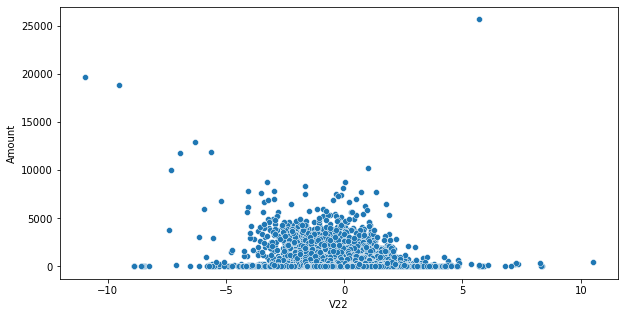

In [223]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["Amount"])

<AxesSubplot:xlabel='V23', ylabel='Amount'>

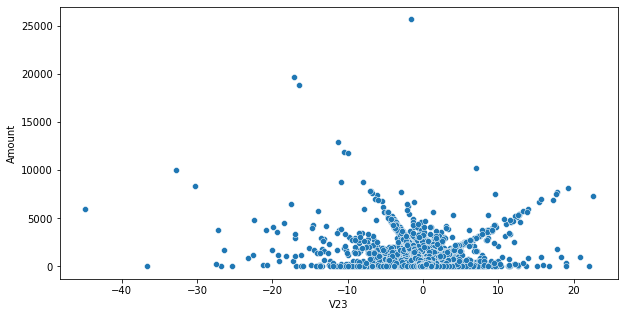

In [224]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["Amount"])

<AxesSubplot:xlabel='V24', ylabel='Amount'>

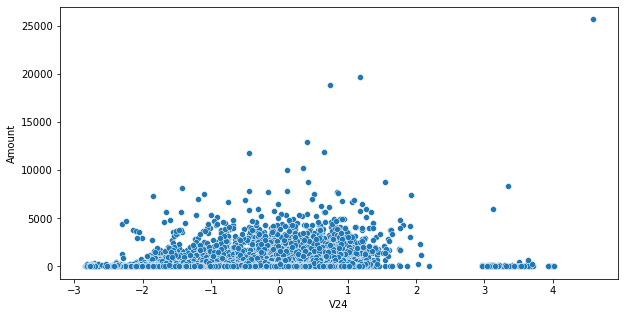

In [225]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["Amount"])

<AxesSubplot:xlabel='V25', ylabel='Amount'>

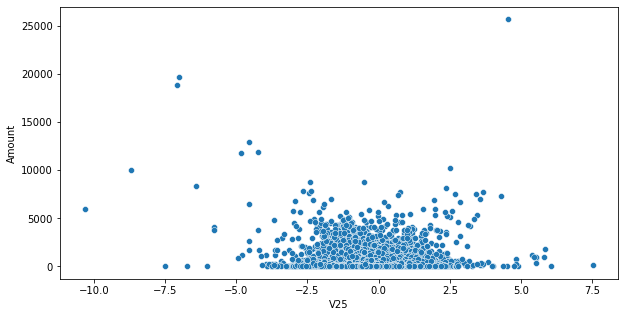

In [226]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V25"],df["Amount"])

<AxesSubplot:xlabel='V26', ylabel='Amount'>

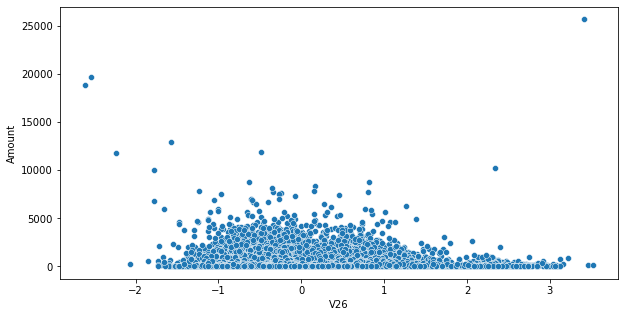

In [227]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V26"],df["Amount"])

<AxesSubplot:xlabel='V27', ylabel='Amount'>

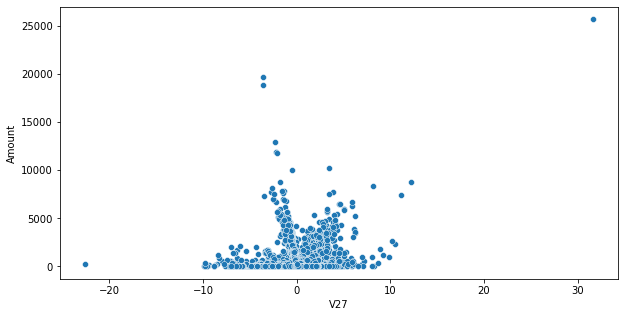

In [228]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V27"],df["Amount"])

<AxesSubplot:xlabel='V28', ylabel='Amount'>

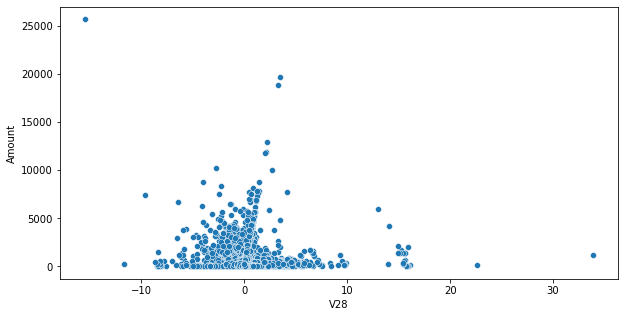

In [229]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V28"],df["Amount"])

<AxesSubplot:xlabel='V1', ylabel='V28'>

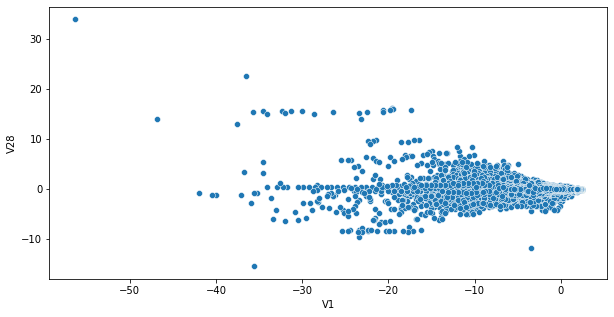

In [230]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V28"])

<AxesSubplot:xlabel='V2', ylabel='V28'>

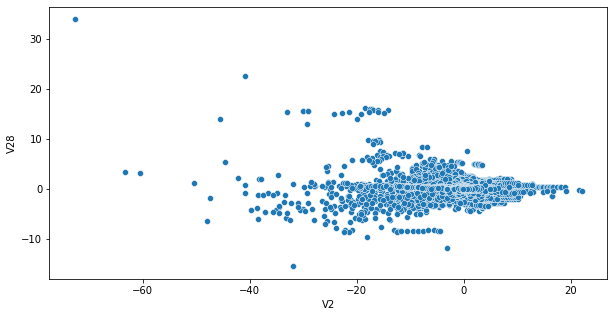

In [231]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V28"])

<AxesSubplot:xlabel='V3', ylabel='V28'>

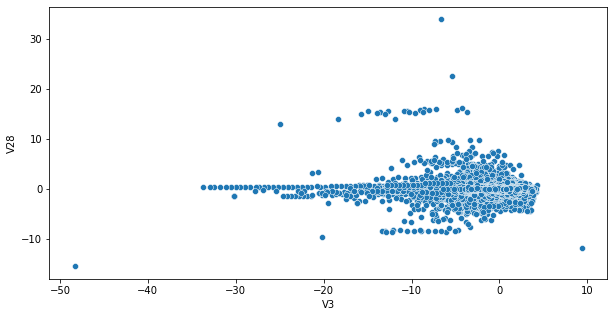

In [232]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V28"])

<AxesSubplot:xlabel='V4', ylabel='V28'>

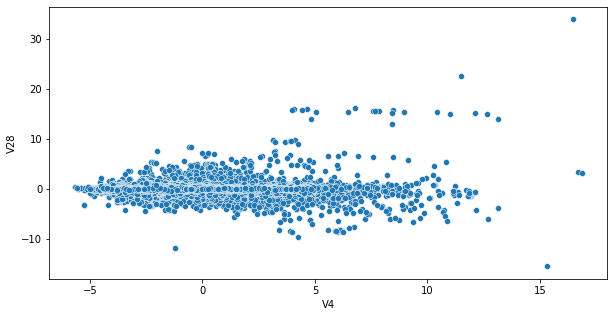

In [233]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V28"])

<AxesSubplot:xlabel='V5', ylabel='V28'>

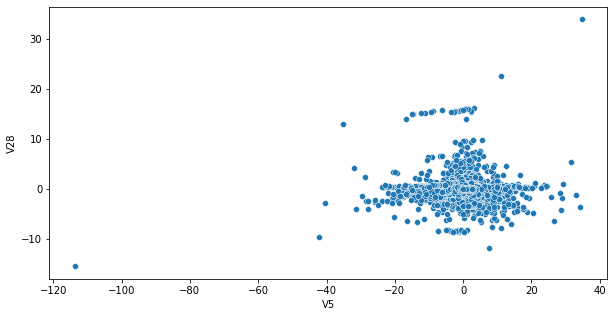

In [234]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V28"])

<AxesSubplot:xlabel='V6', ylabel='V28'>

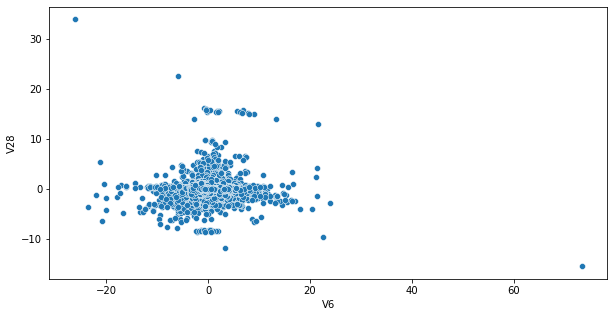

In [235]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V28"])

<AxesSubplot:xlabel='V7', ylabel='V28'>

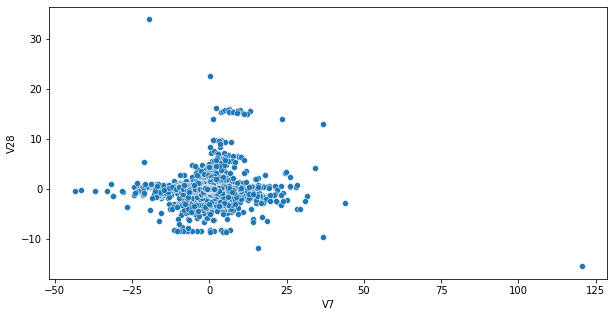

In [236]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V28"])

<AxesSubplot:xlabel='V8', ylabel='V28'>

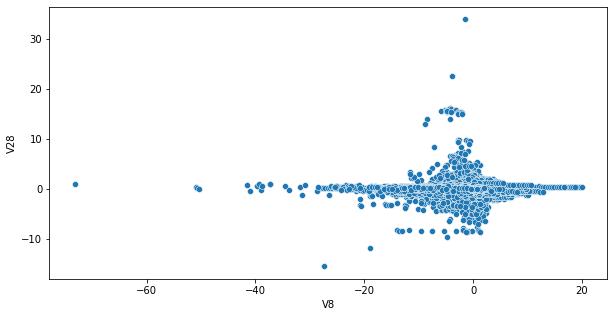

In [237]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V28"])

<AxesSubplot:xlabel='V9', ylabel='V28'>

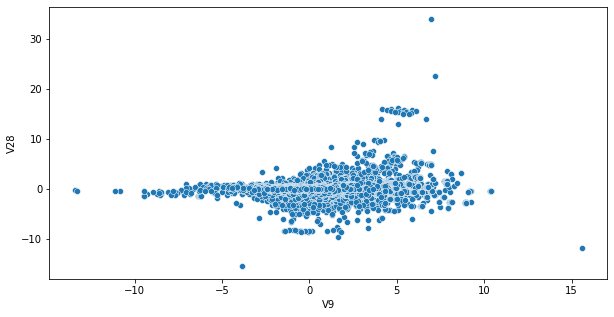

In [238]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V28"])

<AxesSubplot:xlabel='V10', ylabel='V28'>

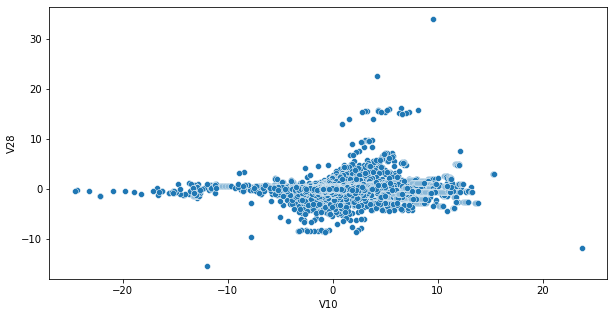

In [239]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V28"])

<AxesSubplot:xlabel='V11', ylabel='V28'>

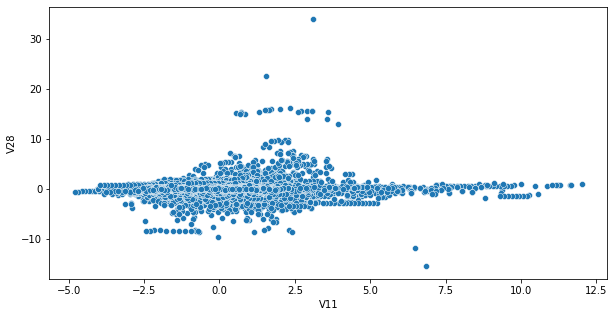

In [240]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V28"])

<AxesSubplot:xlabel='V12', ylabel='V28'>

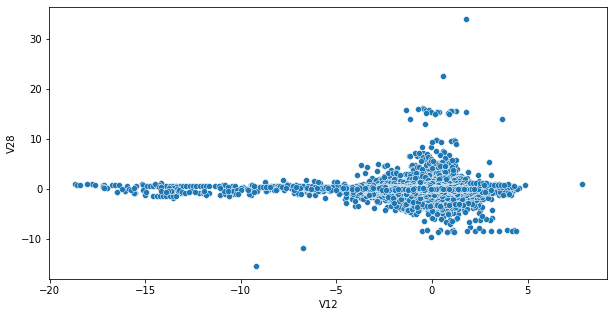

In [241]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V28"])

<AxesSubplot:xlabel='V13', ylabel='V28'>

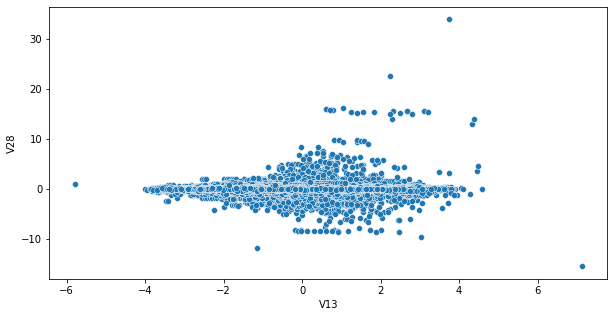

In [242]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V28"])

<AxesSubplot:xlabel='V14', ylabel='V28'>

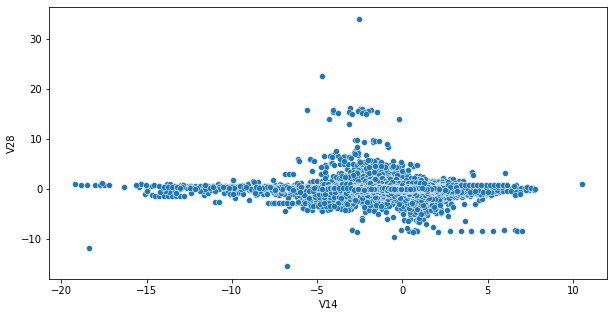

In [243]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V28"])

<AxesSubplot:xlabel='V15', ylabel='V28'>

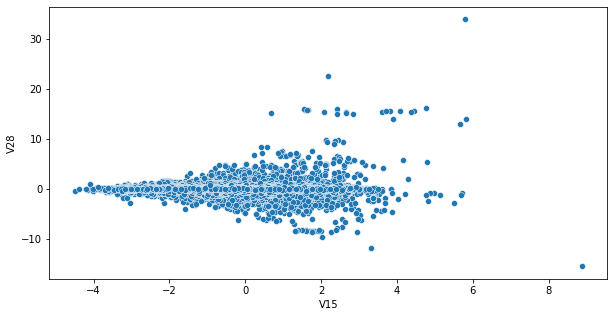

In [244]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V28"])

<AxesSubplot:xlabel='V16', ylabel='V28'>

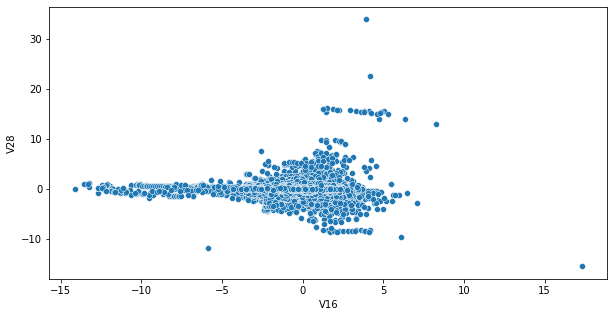

In [245]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V28"])

<AxesSubplot:xlabel='V17', ylabel='V28'>

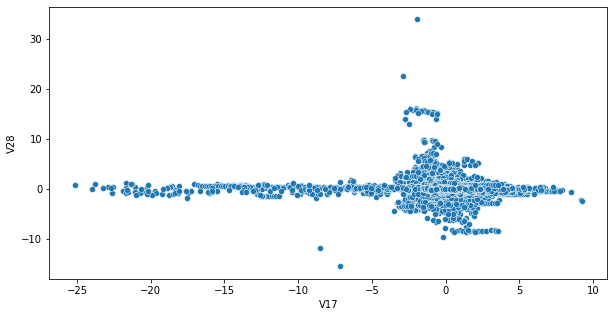

In [246]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V28"])

<AxesSubplot:xlabel='V18', ylabel='V28'>

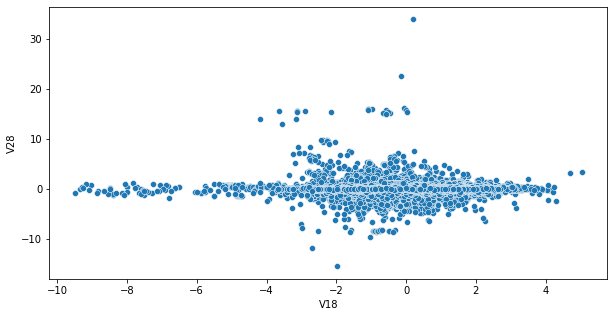

In [247]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V28"])

<AxesSubplot:xlabel='V19', ylabel='V28'>

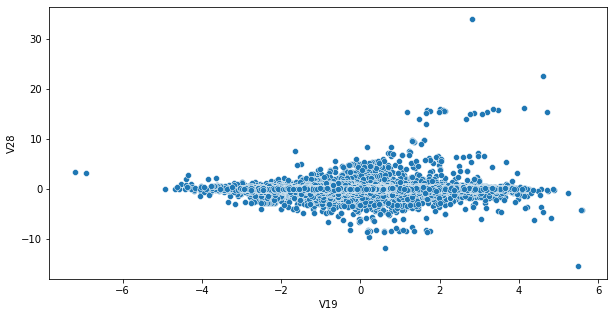

In [248]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V28"])

<AxesSubplot:xlabel='V20', ylabel='V28'>

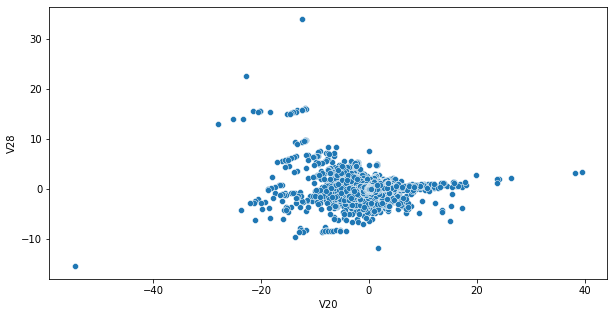

In [249]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V28"])

<AxesSubplot:xlabel='V21', ylabel='V28'>

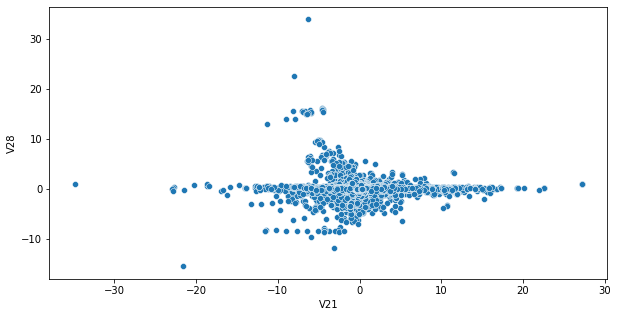

In [250]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V28"])

<AxesSubplot:xlabel='V22', ylabel='V28'>

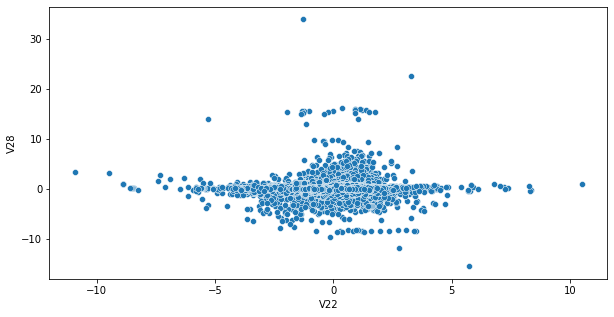

In [251]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["V28"])

<AxesSubplot:xlabel='V23', ylabel='V28'>

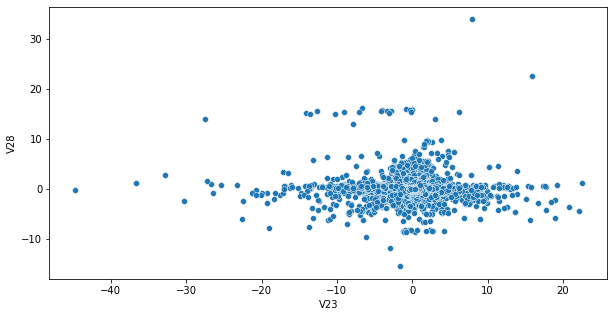

In [252]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["V28"])

<AxesSubplot:xlabel='V24', ylabel='V28'>

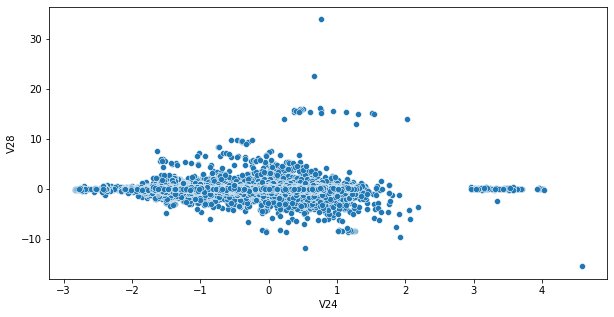

In [253]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["V28"])

<AxesSubplot:xlabel='V25', ylabel='V28'>

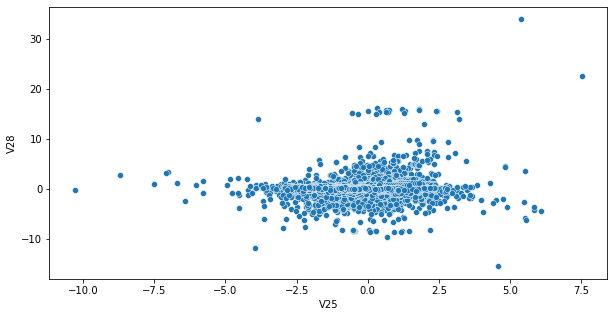

In [254]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V25"],df["V28"])

<AxesSubplot:xlabel='V26', ylabel='V28'>

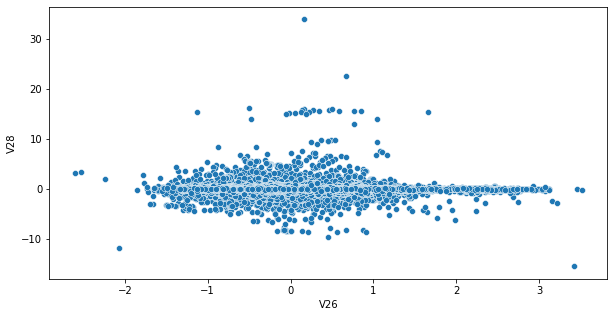

In [255]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V26"],df["V28"])

<AxesSubplot:xlabel='V27', ylabel='V28'>

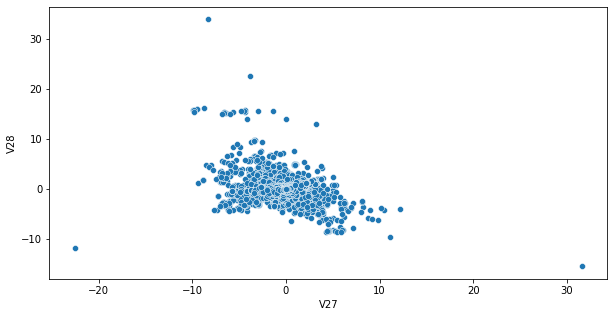

In [256]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V27"],df["V28"])

<AxesSubplot:xlabel='V1', ylabel='V27'>

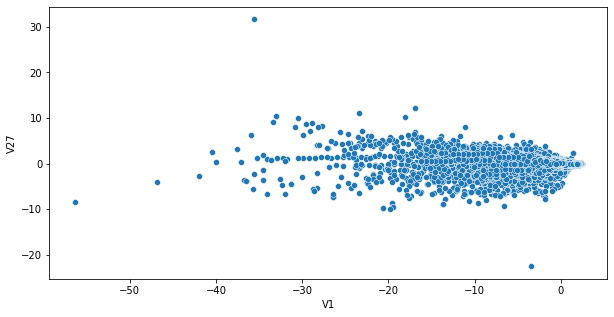

In [257]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V27"])

<AxesSubplot:xlabel='V2', ylabel='V27'>

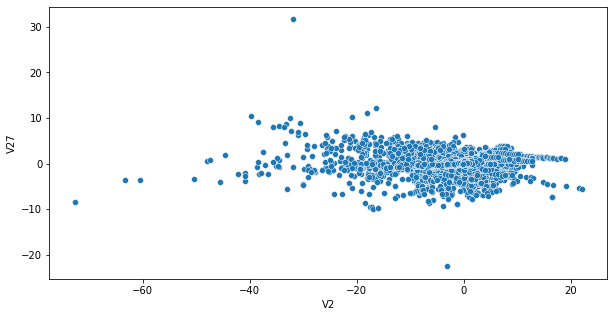

In [258]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V27"])

<AxesSubplot:xlabel='V3', ylabel='V27'>

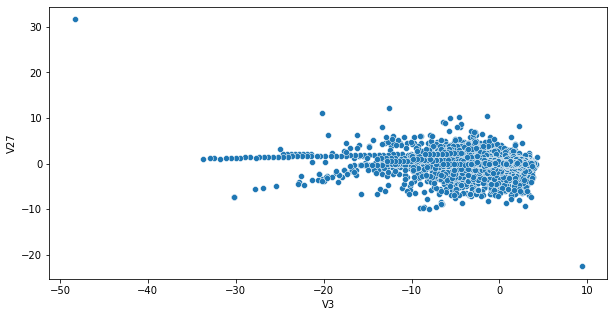

In [259]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V27"])

<AxesSubplot:xlabel='V4', ylabel='V27'>

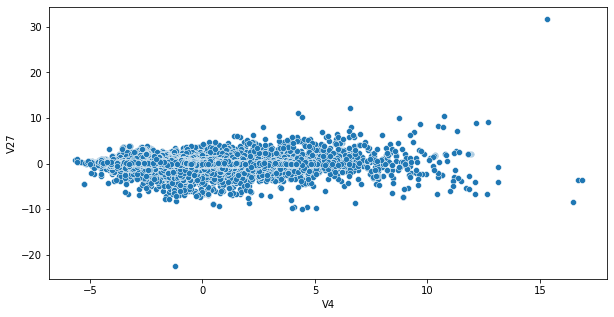

In [260]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V27"])

<AxesSubplot:xlabel='V5', ylabel='V27'>

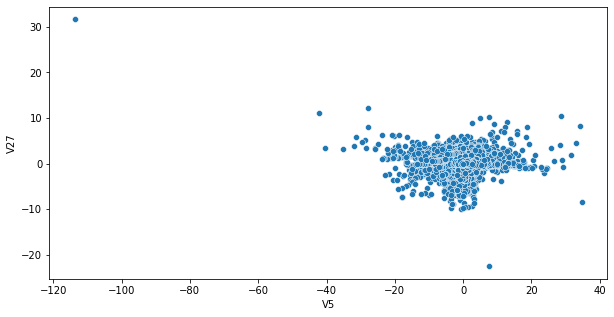

In [261]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V27"])

<AxesSubplot:xlabel='V6', ylabel='V27'>

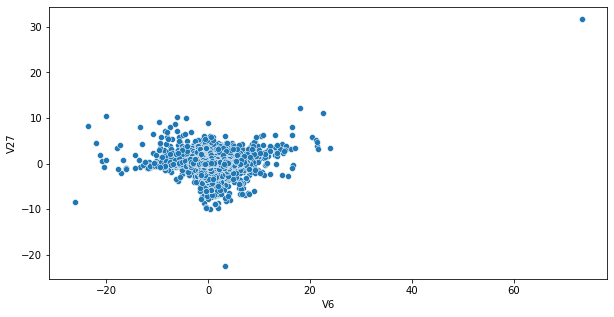

In [262]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V27"])

<AxesSubplot:xlabel='V7', ylabel='V27'>

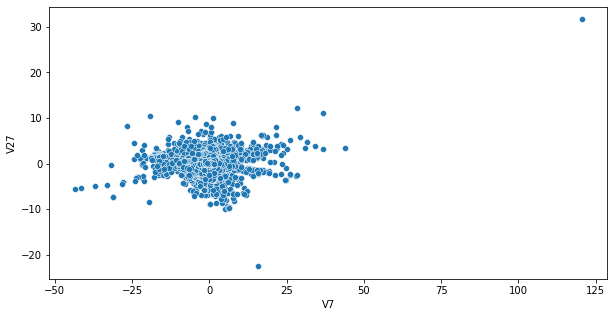

In [263]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V27"])

<AxesSubplot:xlabel='V8', ylabel='V27'>

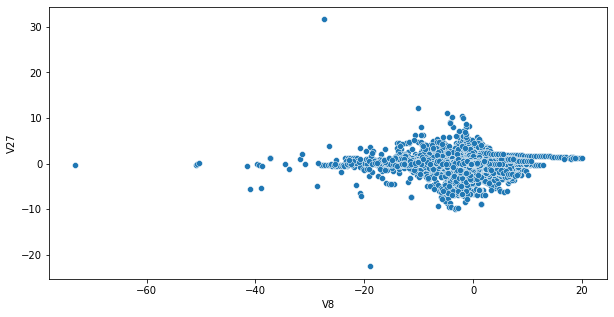

In [264]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V27"])

<AxesSubplot:xlabel='V9', ylabel='V27'>

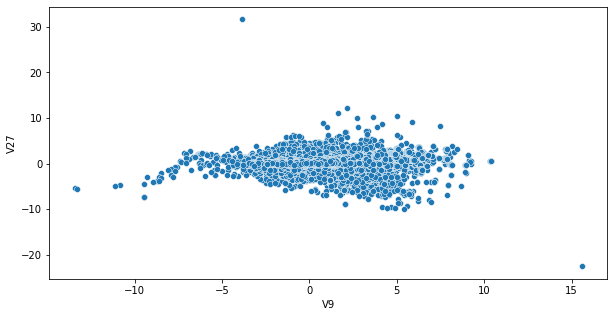

In [265]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V27"])

<AxesSubplot:xlabel='V10', ylabel='V27'>

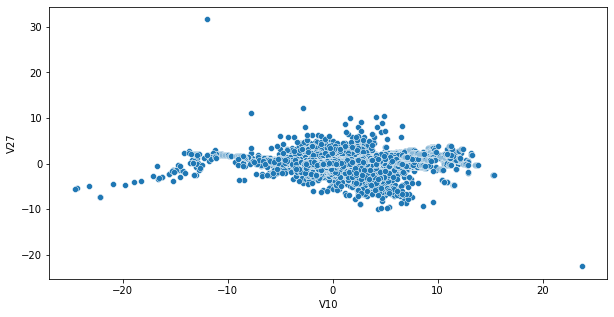

In [266]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V27"])

<AxesSubplot:xlabel='V11', ylabel='V27'>

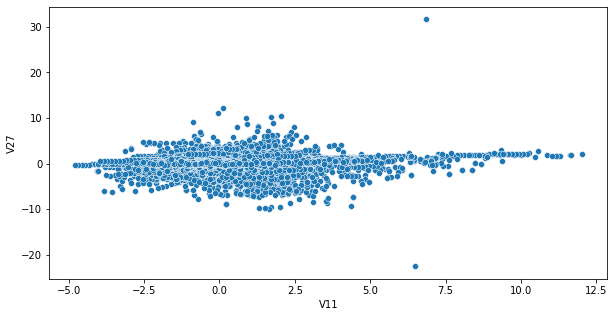

In [267]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V27"])

<AxesSubplot:xlabel='V12', ylabel='V27'>

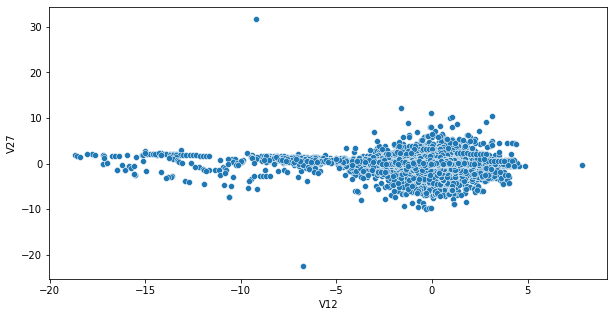

In [268]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V27"])

<AxesSubplot:xlabel='V13', ylabel='V27'>

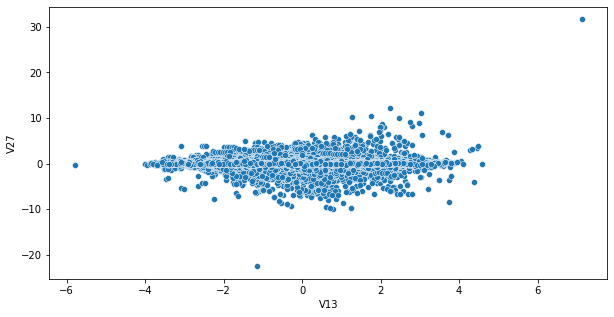

In [269]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V27"])

<AxesSubplot:xlabel='V14', ylabel='V27'>

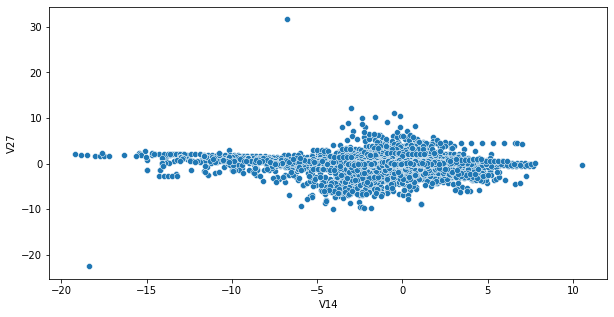

In [270]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V27"])

<AxesSubplot:xlabel='V15', ylabel='V27'>

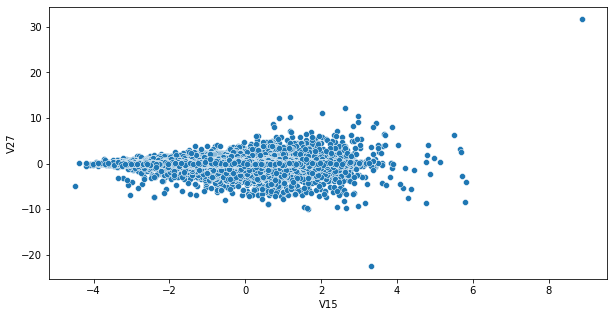

In [271]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V27"])

<AxesSubplot:xlabel='V16', ylabel='V27'>

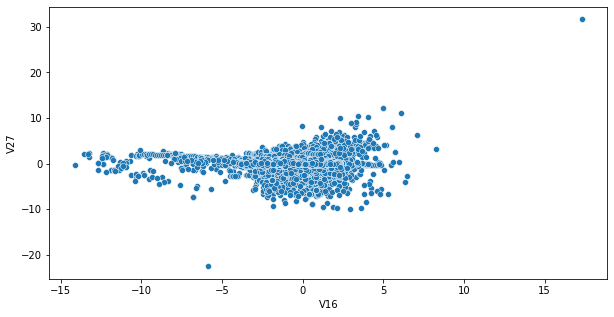

In [272]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V27"])

<AxesSubplot:xlabel='V17', ylabel='V27'>

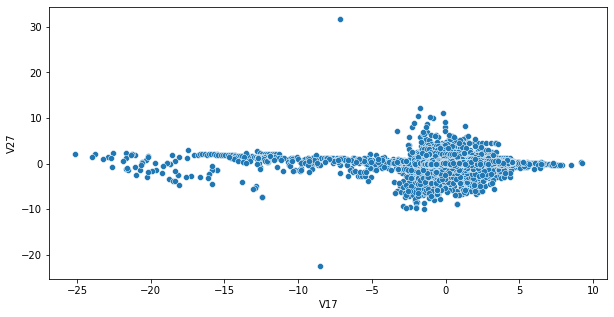

In [273]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V27"])

<AxesSubplot:xlabel='V18', ylabel='V27'>

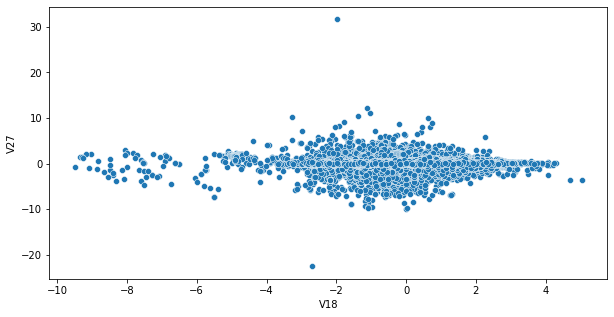

In [274]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V27"])

<AxesSubplot:xlabel='V19', ylabel='V27'>

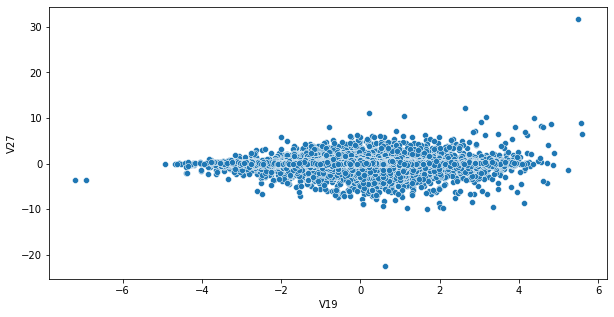

In [275]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V27"])

<AxesSubplot:xlabel='V20', ylabel='V27'>

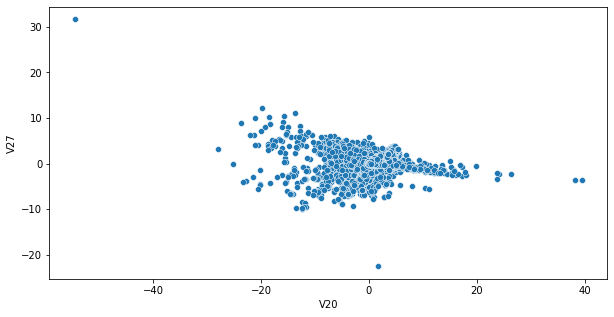

In [276]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V27"])

<AxesSubplot:xlabel='V21', ylabel='V27'>

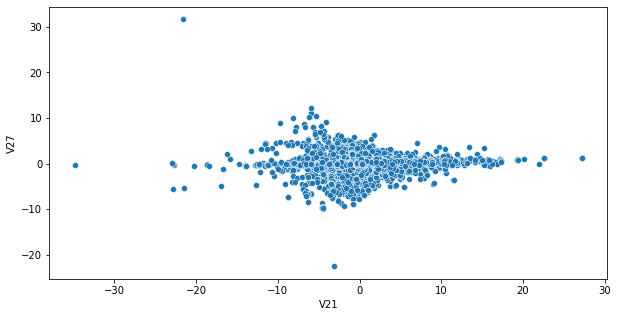

In [277]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V27"])

<AxesSubplot:xlabel='V22', ylabel='V27'>

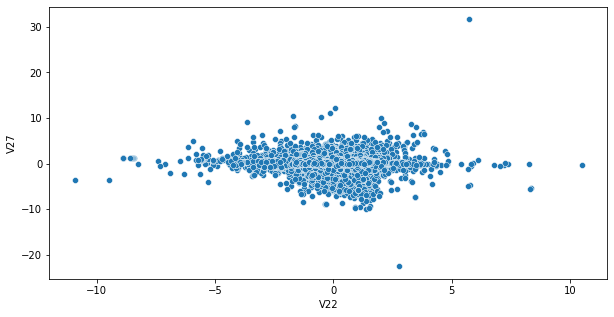

In [278]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["V27"])

<AxesSubplot:xlabel='V23', ylabel='V27'>

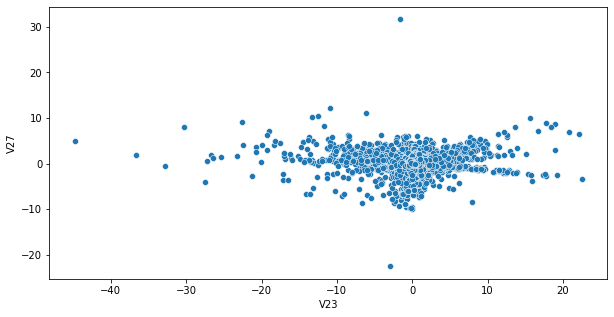

In [279]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["V27"])

<AxesSubplot:xlabel='V24', ylabel='V27'>

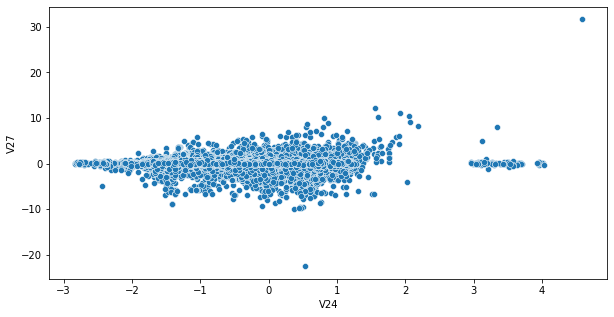

In [280]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["V27"])

<AxesSubplot:xlabel='V25', ylabel='V27'>

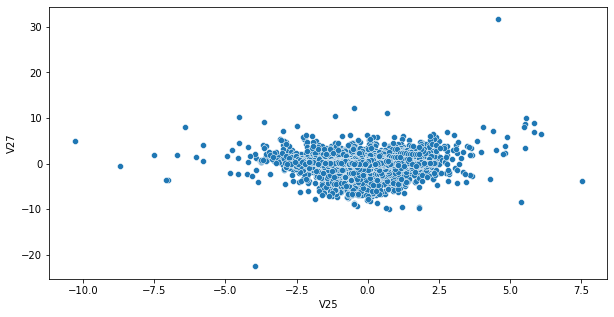

In [281]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V25"],df["V27"])

<AxesSubplot:xlabel='V26', ylabel='V27'>

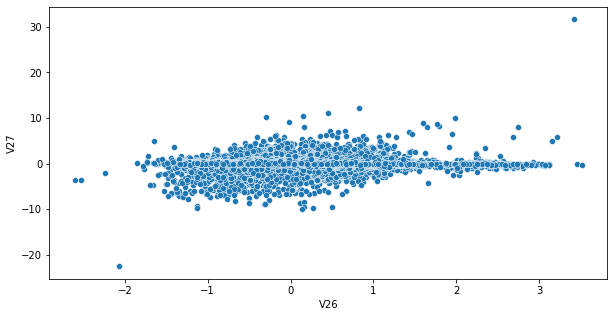

In [282]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V26"],df["V27"])

<AxesSubplot:xlabel='V1', ylabel='V26'>

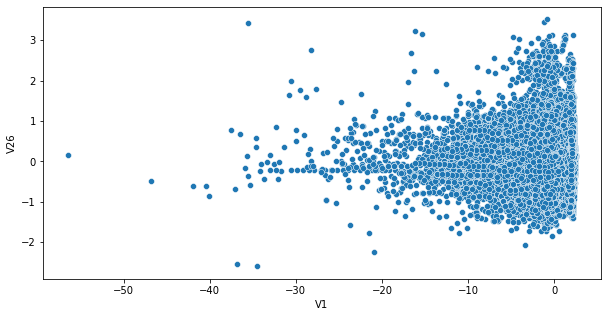

In [283]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V26"])

<AxesSubplot:xlabel='V2', ylabel='V26'>

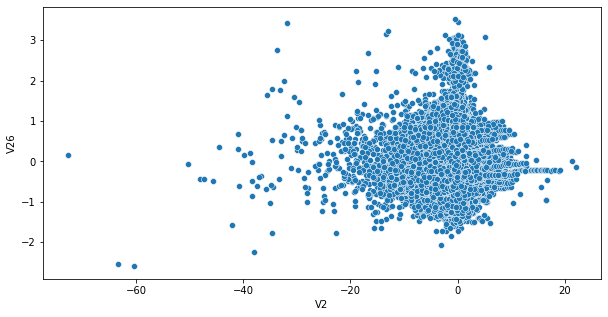

In [284]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V26"])

<AxesSubplot:xlabel='V3', ylabel='V26'>

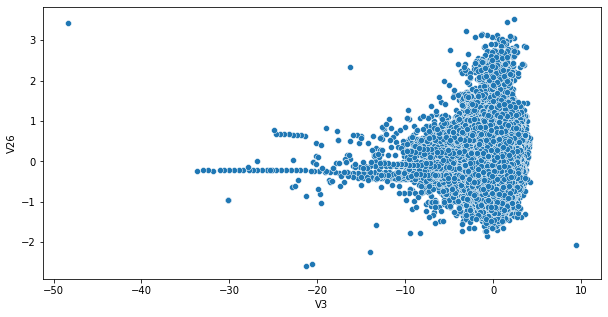

In [285]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V26"])

<AxesSubplot:xlabel='V4', ylabel='V26'>

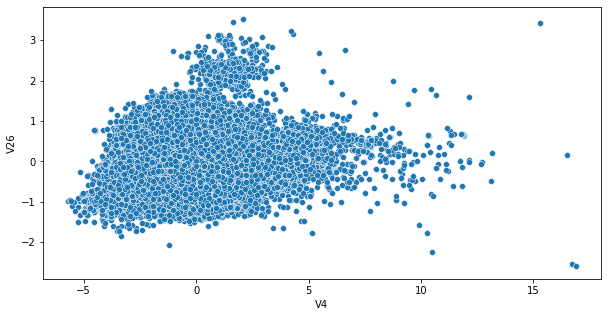

In [286]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V26"])

<AxesSubplot:xlabel='V5', ylabel='V26'>

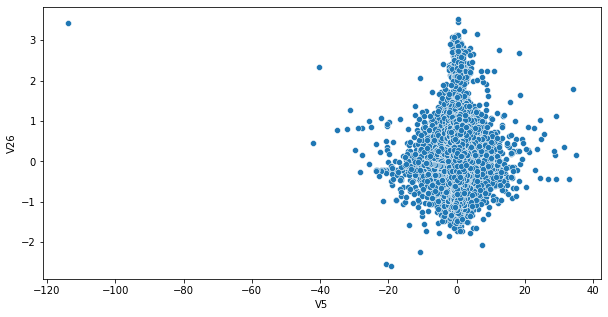

In [287]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V26"])

<AxesSubplot:xlabel='V6', ylabel='V26'>

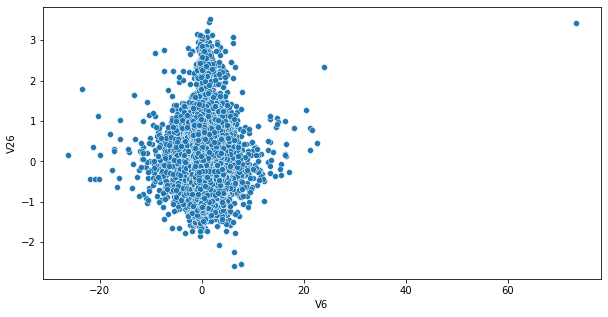

In [288]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V26"])

<AxesSubplot:xlabel='V7', ylabel='V26'>

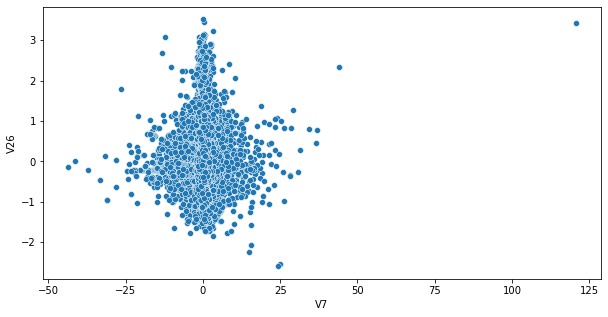

In [289]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V26"])

<AxesSubplot:xlabel='V8', ylabel='V26'>

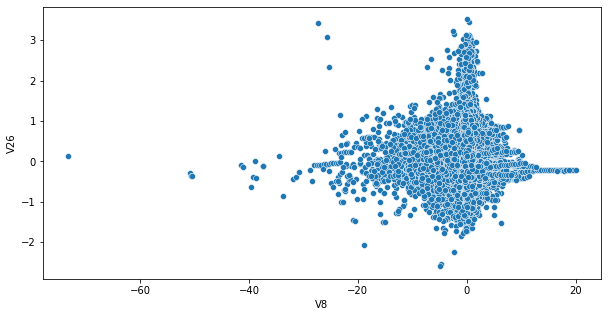

In [290]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V26"])

<AxesSubplot:xlabel='V9', ylabel='V26'>

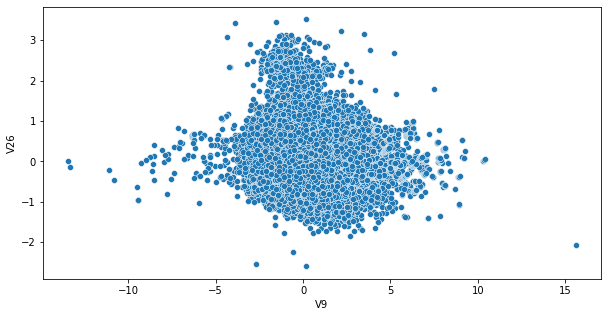

In [291]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V26"])

<AxesSubplot:xlabel='V10', ylabel='V26'>

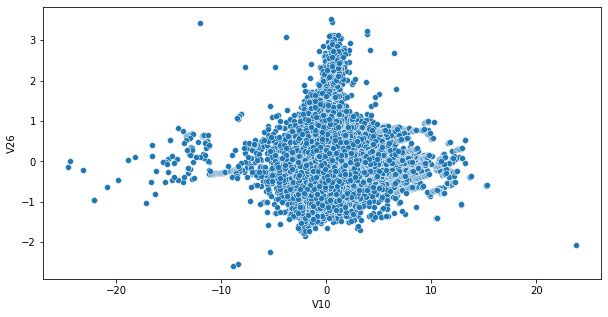

In [292]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V26"])

<AxesSubplot:xlabel='V11', ylabel='V26'>

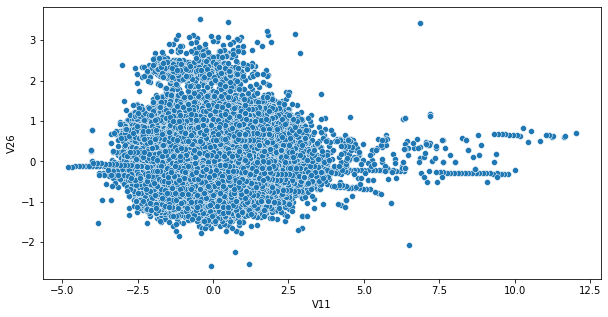

In [293]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V26"])

<AxesSubplot:xlabel='V12', ylabel='V26'>

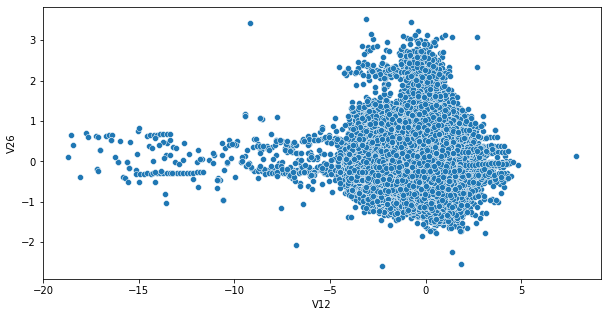

In [294]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V26"])

<AxesSubplot:xlabel='V13', ylabel='V26'>

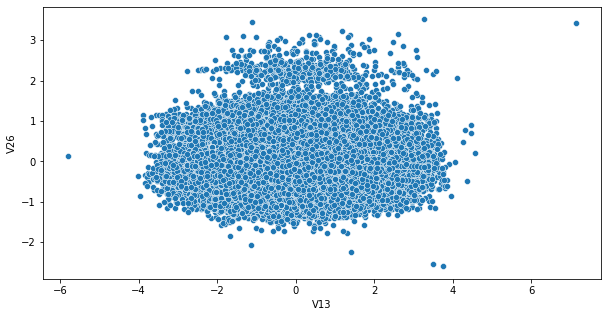

In [295]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V26"])

<AxesSubplot:xlabel='V14', ylabel='V26'>

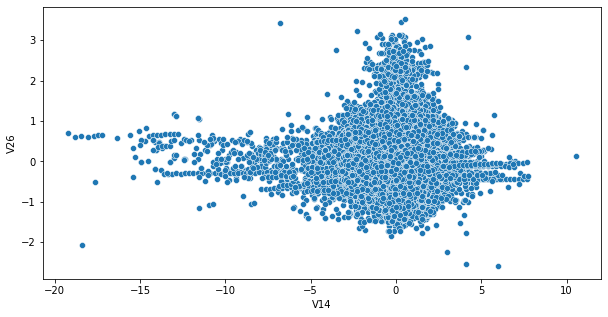

In [296]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V26"])

<AxesSubplot:xlabel='V15', ylabel='V26'>

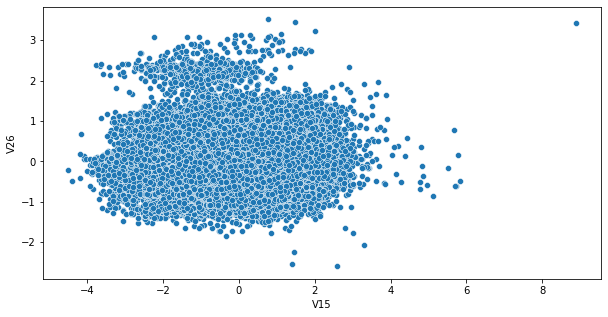

In [297]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V26"])

<AxesSubplot:xlabel='V16', ylabel='V26'>

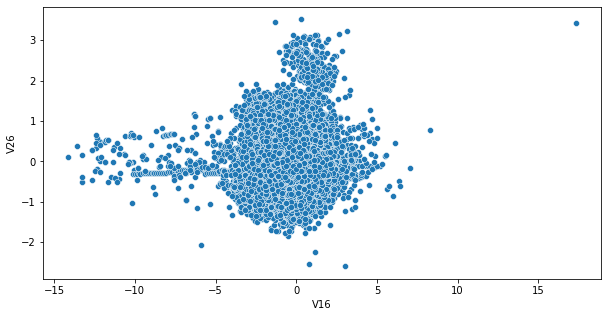

In [298]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V26"])

<AxesSubplot:xlabel='V17', ylabel='V26'>

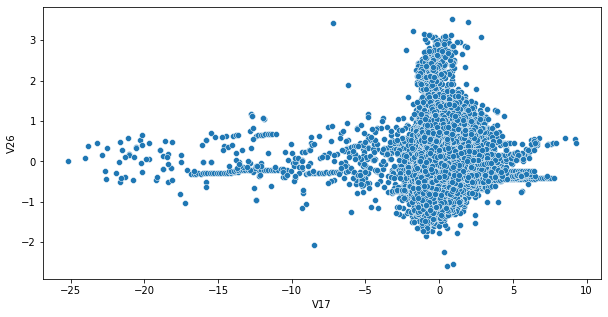

In [299]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V26"])

<AxesSubplot:xlabel='V18', ylabel='V26'>

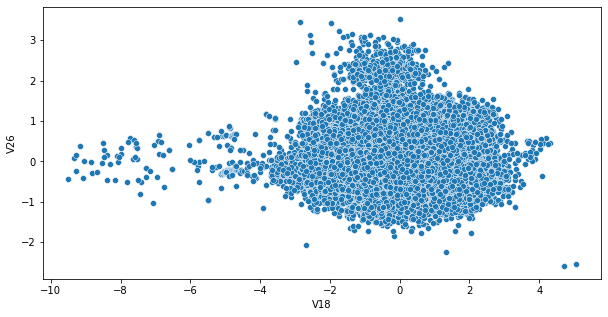

In [300]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V26"])

<AxesSubplot:xlabel='V19', ylabel='V26'>

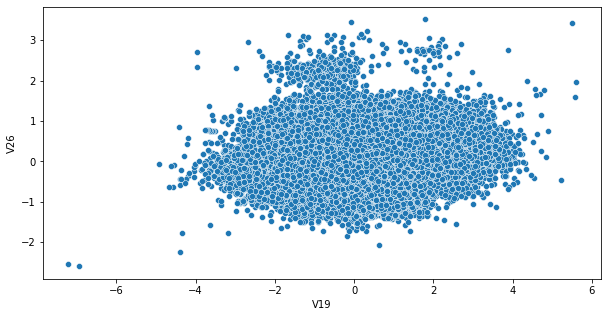

In [301]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V26"])

<AxesSubplot:xlabel='V20', ylabel='V26'>

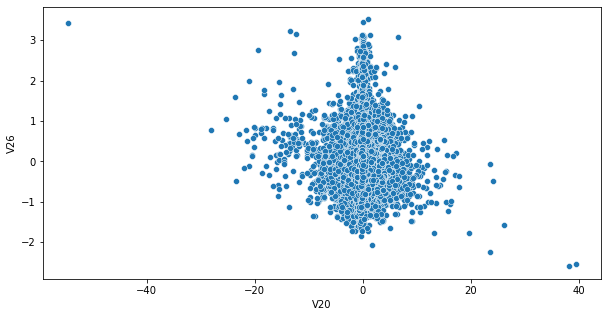

In [302]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V26"])

<AxesSubplot:xlabel='V21', ylabel='V26'>

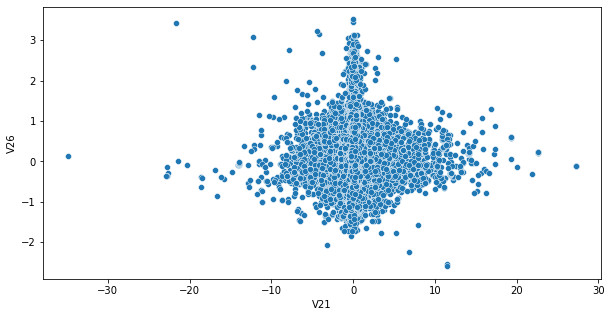

In [303]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V26"])

<AxesSubplot:xlabel='V22', ylabel='V26'>

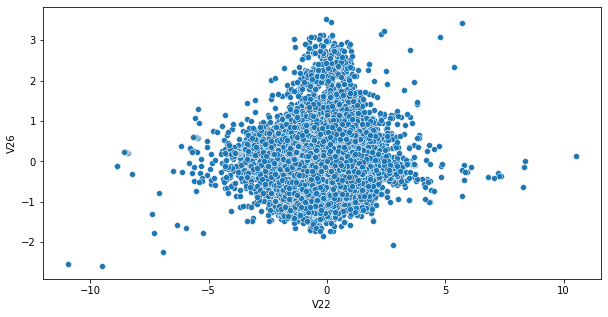

In [304]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["V26"])

<AxesSubplot:xlabel='V23', ylabel='V26'>

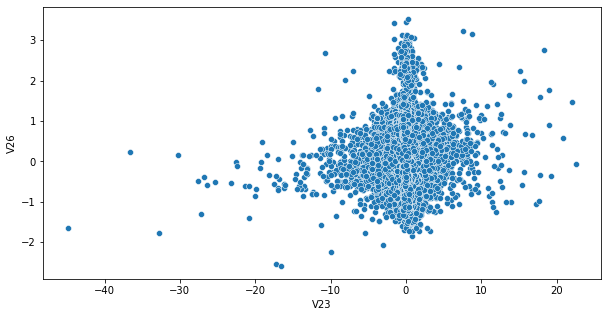

In [305]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["V26"])

<AxesSubplot:xlabel='V24', ylabel='V26'>

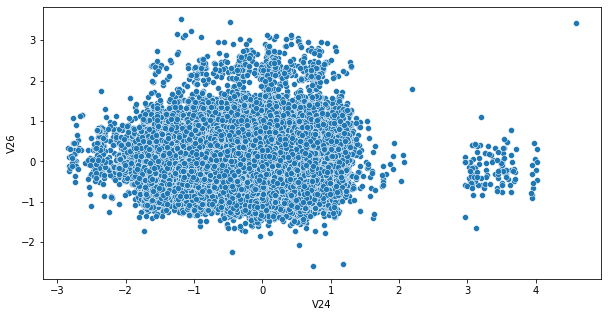

In [306]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["V26"])

<AxesSubplot:xlabel='V25', ylabel='V26'>

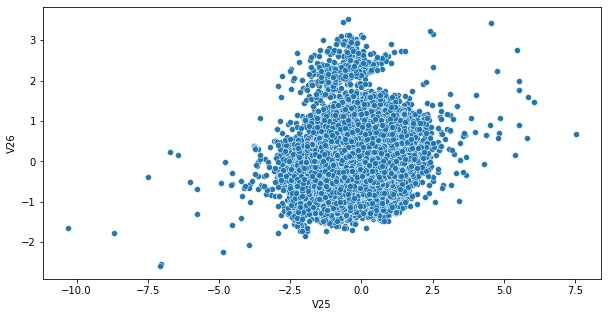

In [307]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V25"],df["V26"])

<AxesSubplot:xlabel='V1', ylabel='V25'>

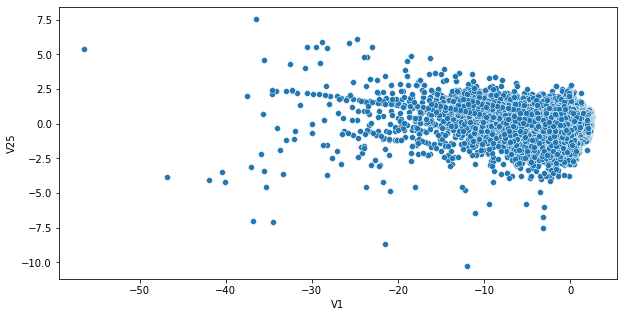

In [308]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V25"])

<AxesSubplot:xlabel='V2', ylabel='V25'>

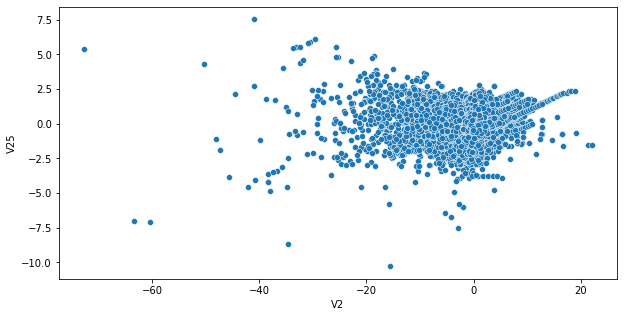

In [309]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V25"])

<AxesSubplot:xlabel='V3', ylabel='V25'>

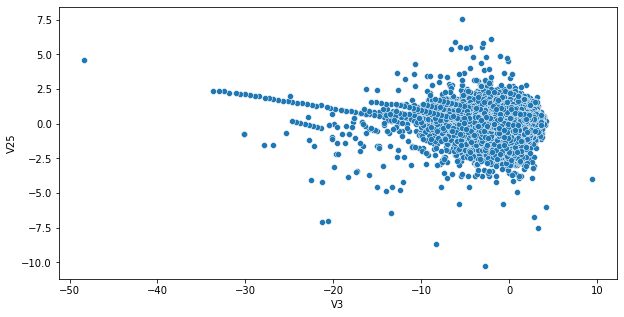

In [310]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V25"])

<AxesSubplot:xlabel='V4', ylabel='V25'>

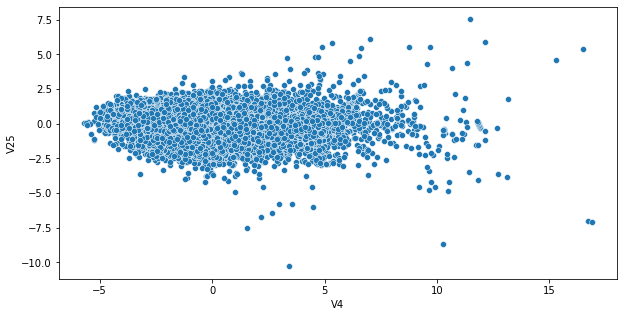

In [311]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V25"])

<AxesSubplot:xlabel='V5', ylabel='V25'>

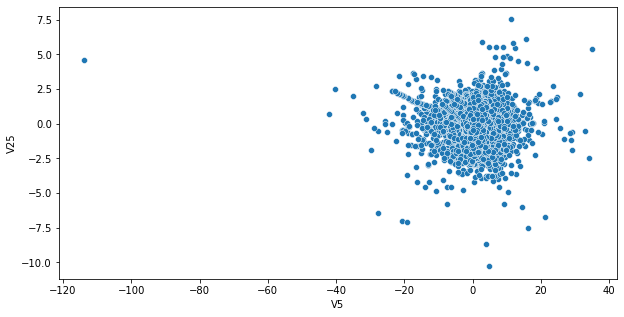

In [312]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V25"])

<AxesSubplot:xlabel='V6', ylabel='V25'>

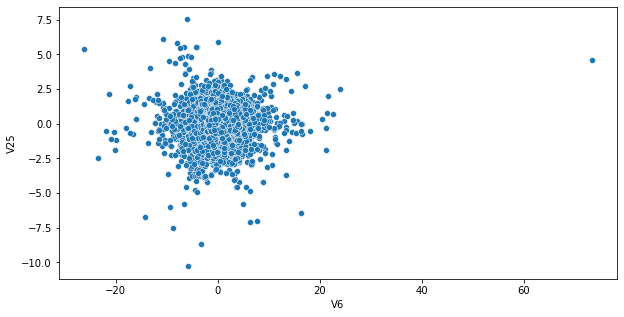

In [313]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V25"])

<AxesSubplot:xlabel='V7', ylabel='V25'>

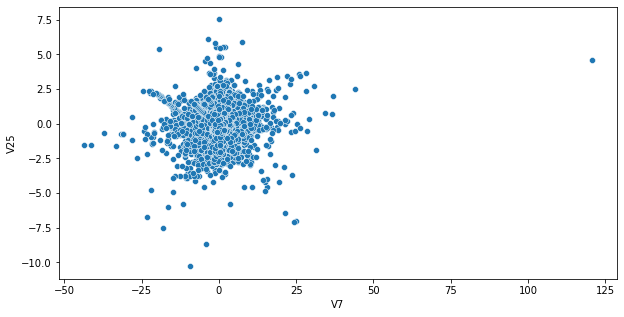

In [314]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V25"])

<AxesSubplot:xlabel='V8', ylabel='V25'>

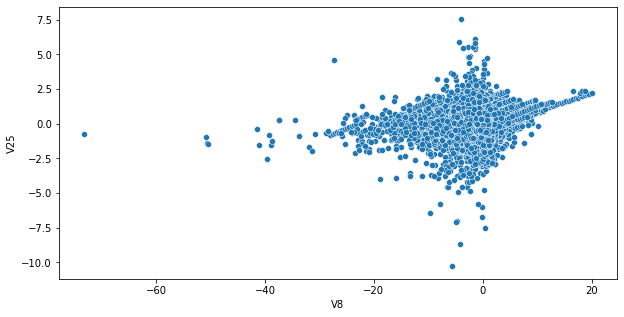

In [315]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V25"])

<AxesSubplot:xlabel='V9', ylabel='V25'>

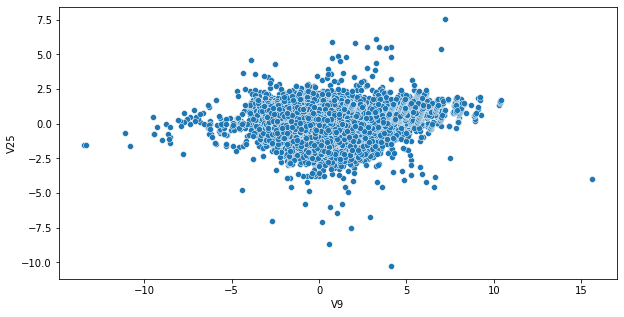

In [316]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V25"])

<AxesSubplot:xlabel='V10', ylabel='V25'>

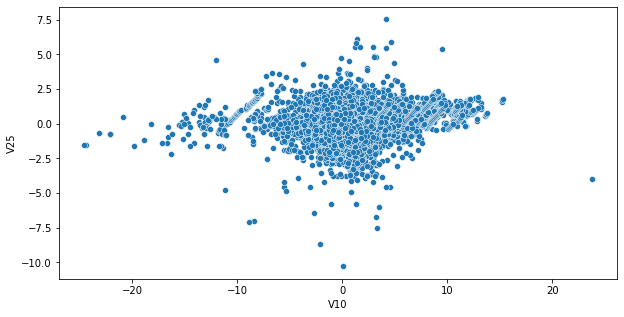

In [317]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V25"])

<AxesSubplot:xlabel='V11', ylabel='V25'>

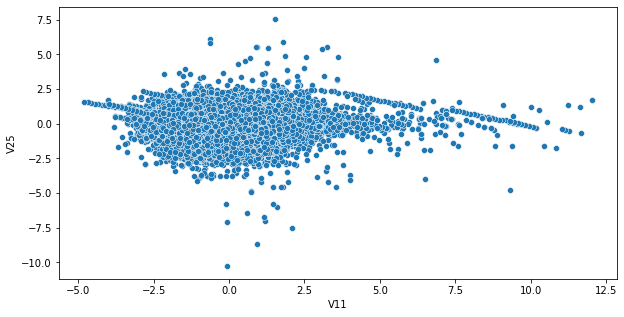

In [318]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V25"])

<AxesSubplot:xlabel='V12', ylabel='V25'>

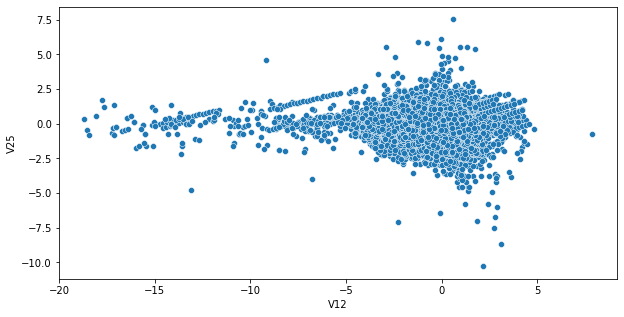

In [319]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V25"])

<AxesSubplot:xlabel='V13', ylabel='V25'>

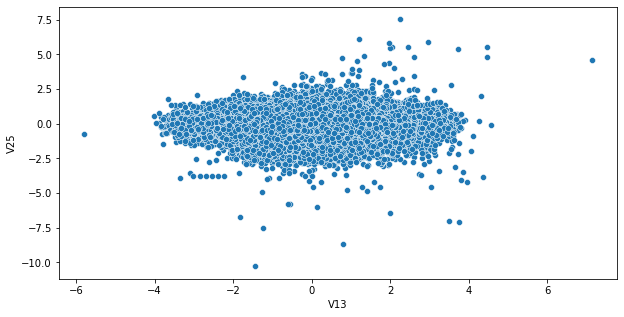

In [320]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V25"])

<AxesSubplot:xlabel='V14', ylabel='V25'>

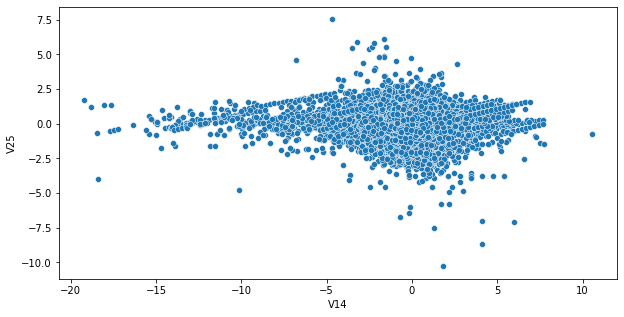

In [321]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V25"])

<AxesSubplot:xlabel='V15', ylabel='V25'>

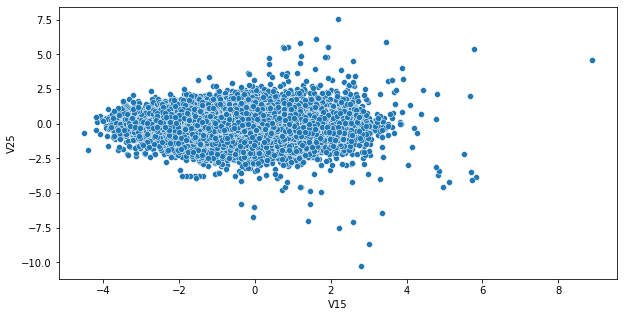

In [322]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V25"])

<AxesSubplot:xlabel='V16', ylabel='V25'>

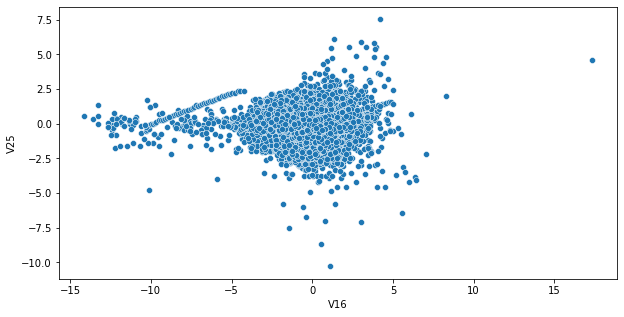

In [323]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V25"])

<AxesSubplot:xlabel='V17', ylabel='V25'>

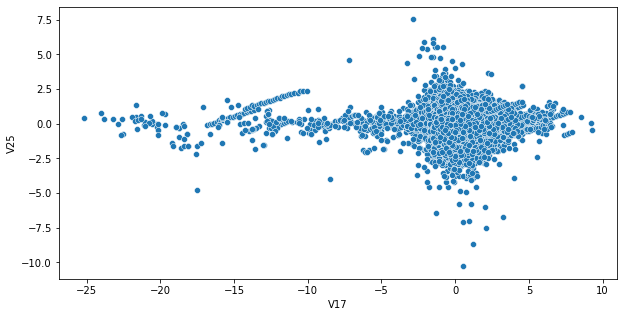

In [324]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V25"])

<AxesSubplot:xlabel='V18', ylabel='V25'>

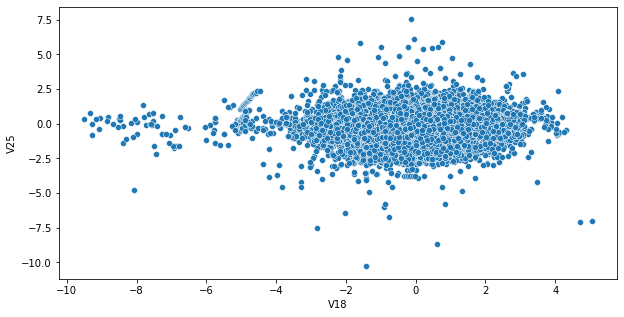

In [325]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V25"])

<AxesSubplot:xlabel='V19', ylabel='V25'>

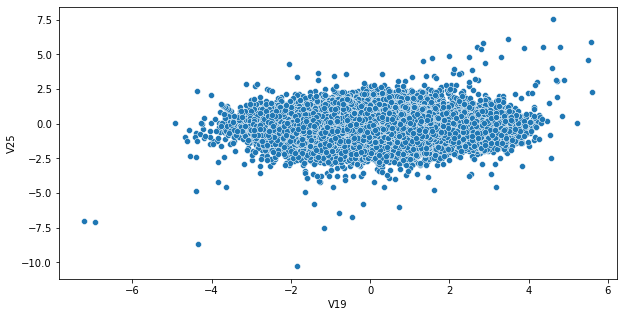

In [326]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V25"])

<AxesSubplot:xlabel='V20', ylabel='V25'>

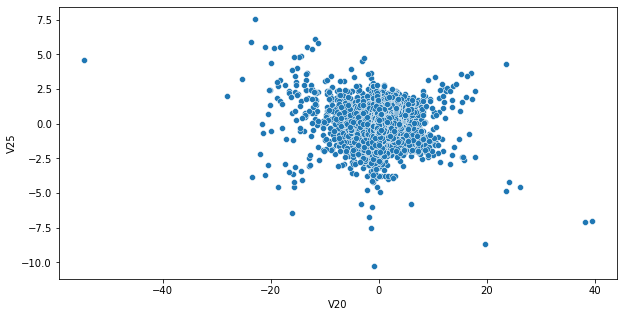

In [327]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V25"])

<AxesSubplot:xlabel='V21', ylabel='V25'>

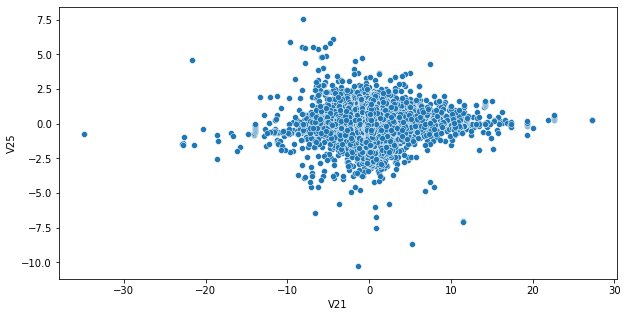

In [328]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V25"])

<AxesSubplot:xlabel='V22', ylabel='V25'>

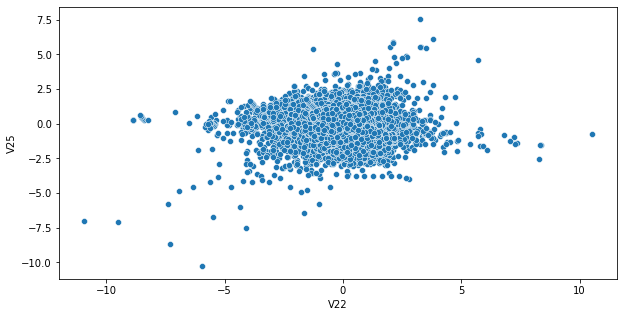

In [329]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["V25"])

<AxesSubplot:xlabel='V23', ylabel='V25'>

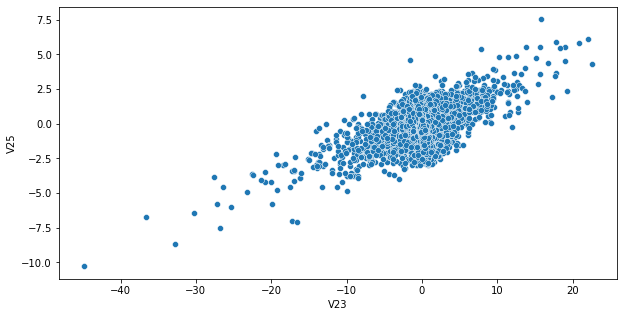

In [330]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["V25"])

<AxesSubplot:xlabel='V24', ylabel='V25'>

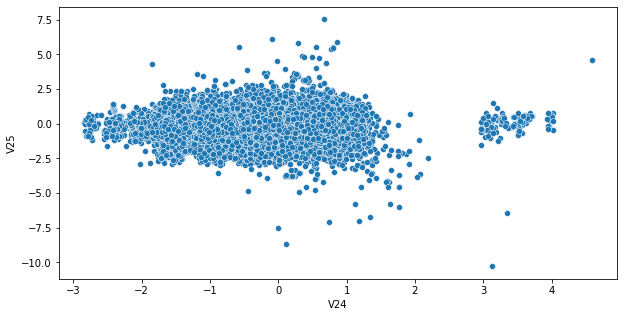

In [331]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V24"],df["V25"])

<AxesSubplot:xlabel='V1', ylabel='V24'>

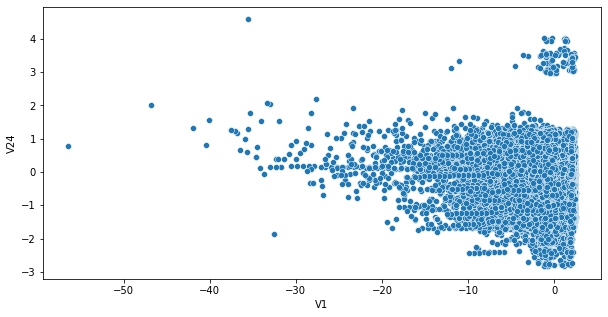

In [332]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V24"])

<AxesSubplot:xlabel='V2', ylabel='V24'>

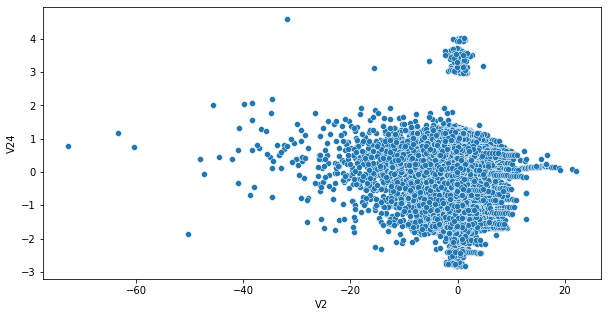

In [333]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V24"])

<AxesSubplot:xlabel='V3', ylabel='V24'>

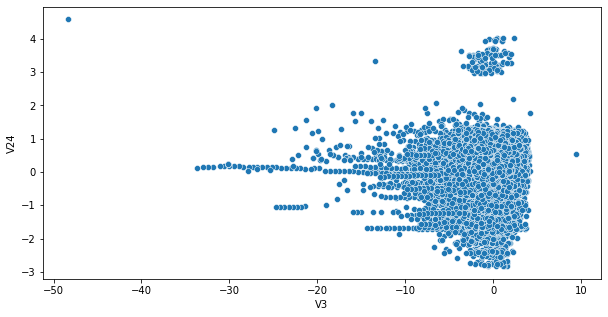

In [334]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V24"])

<AxesSubplot:xlabel='V4', ylabel='V24'>

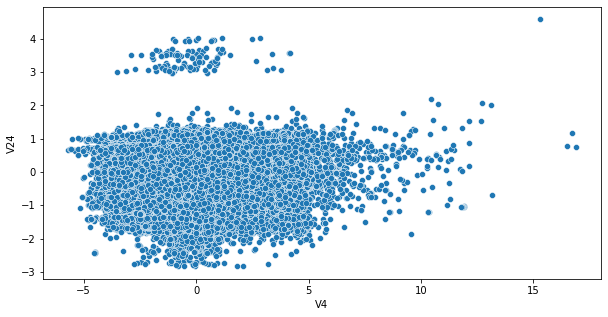

In [335]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V24"])

<AxesSubplot:xlabel='V5', ylabel='V24'>

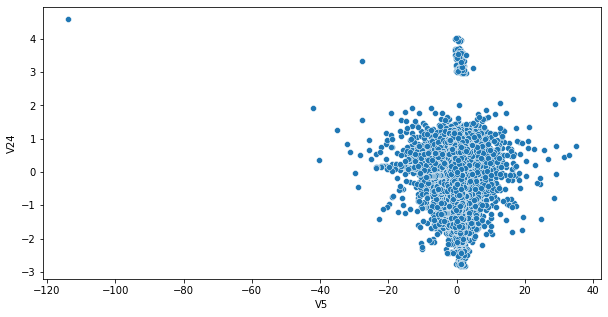

In [336]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V24"])

<AxesSubplot:xlabel='V6', ylabel='V24'>

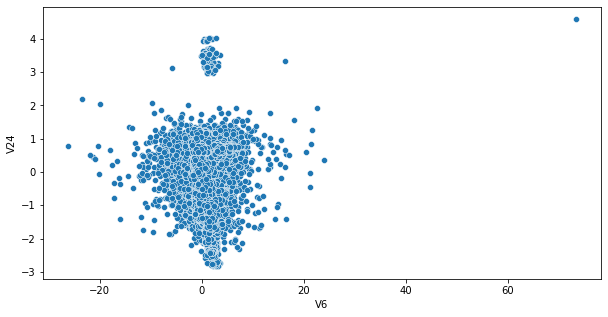

In [337]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V24"])

<AxesSubplot:xlabel='V7', ylabel='V24'>

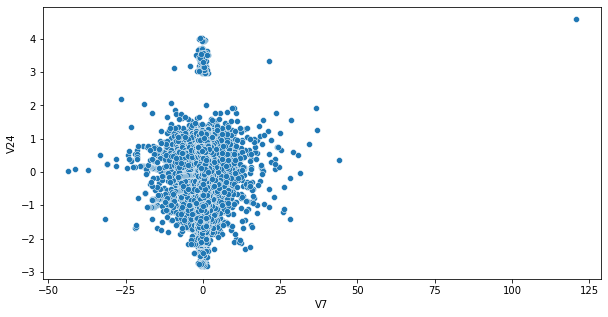

In [338]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V24"])

<AxesSubplot:xlabel='V8', ylabel='V24'>

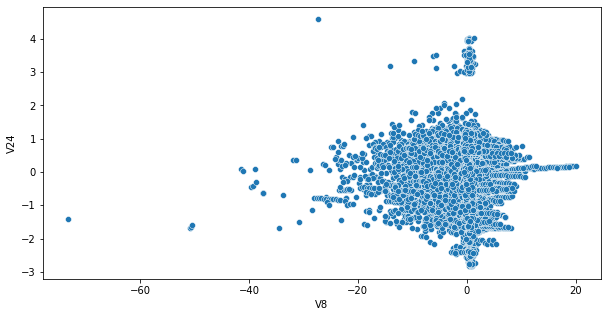

In [339]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V24"])

<AxesSubplot:xlabel='V9', ylabel='V24'>

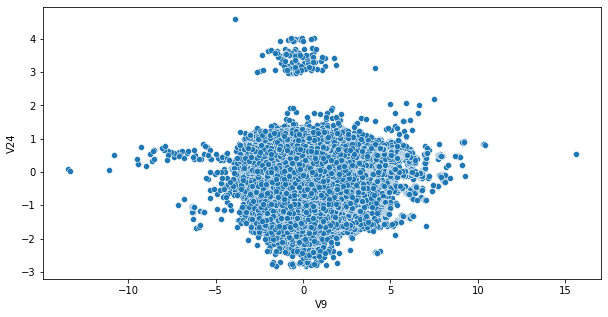

In [340]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V24"])

<AxesSubplot:xlabel='V10', ylabel='V24'>

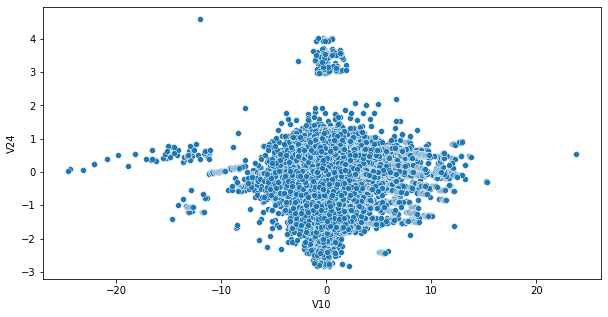

In [341]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V24"])

<AxesSubplot:xlabel='V11', ylabel='V24'>

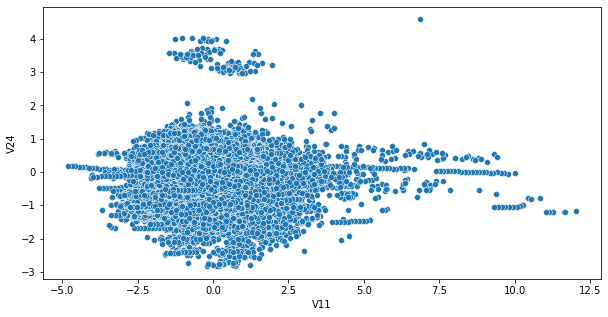

In [342]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V24"])

<AxesSubplot:xlabel='V12', ylabel='V24'>

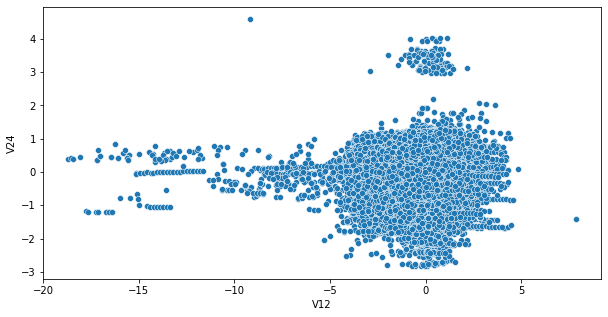

In [343]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V24"])

<AxesSubplot:xlabel='V13', ylabel='V24'>

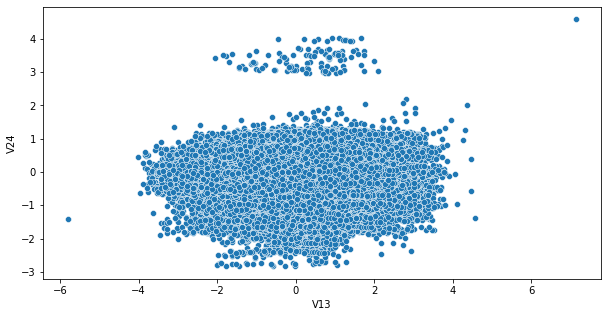

In [344]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V24"])

<AxesSubplot:xlabel='V14', ylabel='V24'>

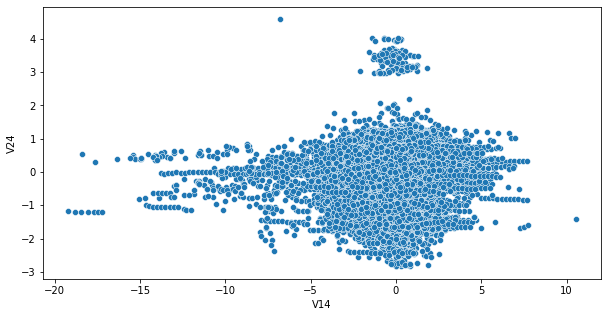

In [345]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V24"])

<AxesSubplot:xlabel='V15', ylabel='V24'>

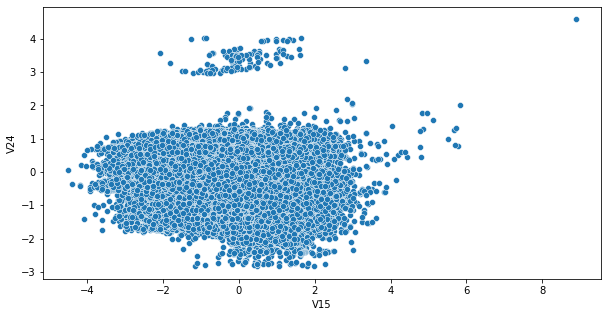

In [346]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V24"])

<AxesSubplot:xlabel='V16', ylabel='V24'>

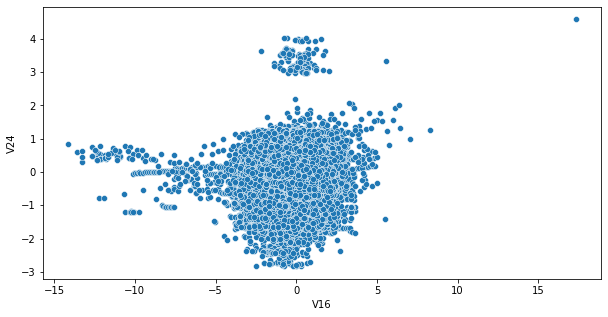

In [347]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V24"])

<AxesSubplot:xlabel='V17', ylabel='V24'>

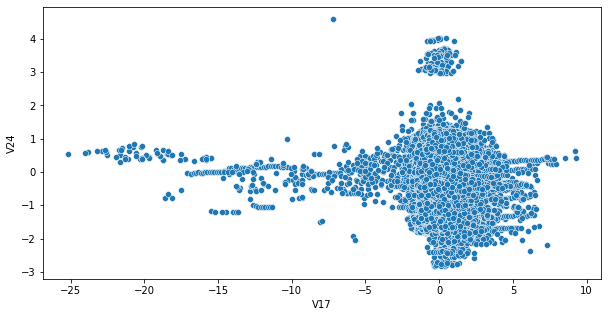

In [348]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V24"])

<AxesSubplot:xlabel='V18', ylabel='V24'>

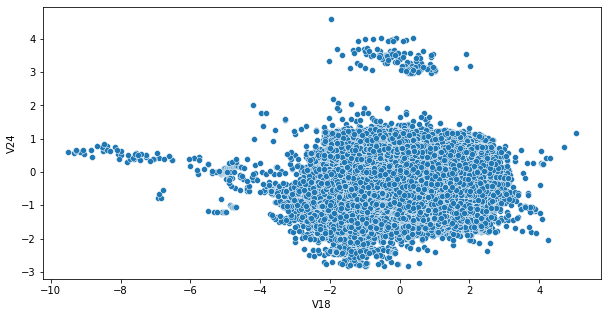

In [349]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V24"])

<AxesSubplot:xlabel='V19', ylabel='V24'>

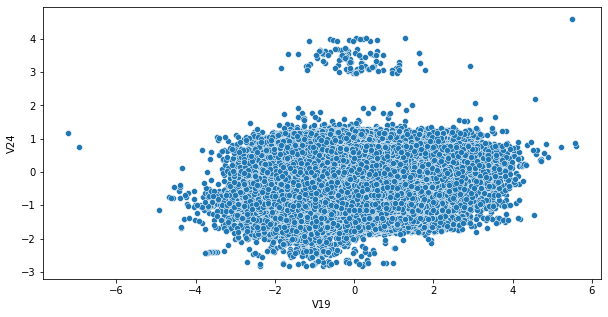

In [350]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V24"])

<AxesSubplot:xlabel='V20', ylabel='V24'>

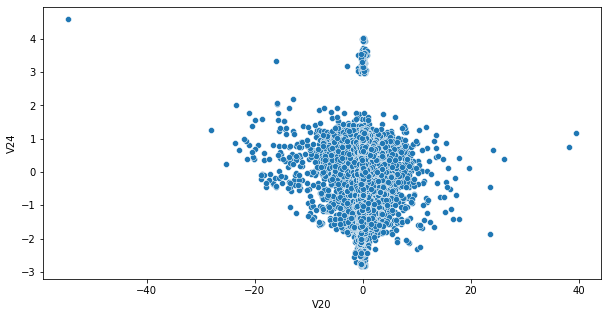

In [351]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V24"])

<AxesSubplot:xlabel='V21', ylabel='V24'>

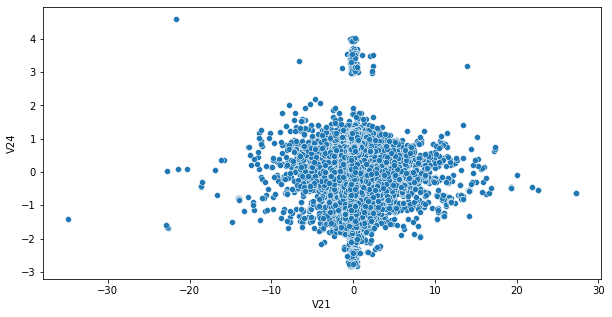

In [352]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V24"])

<AxesSubplot:xlabel='V22', ylabel='V24'>

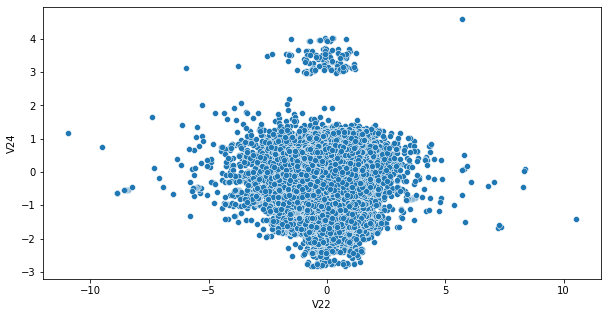

In [353]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V22"],df["V24"])

<AxesSubplot:xlabel='V23', ylabel='V24'>

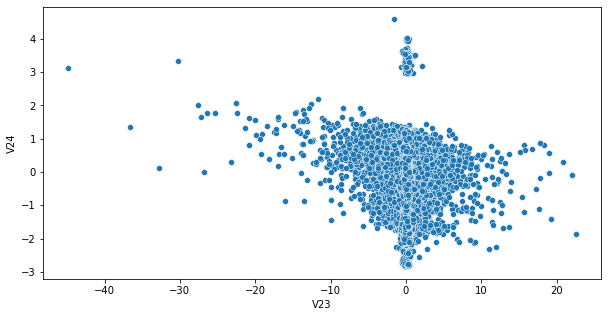

In [354]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V23"],df["V24"])

<AxesSubplot:xlabel='V1', ylabel='V23'>

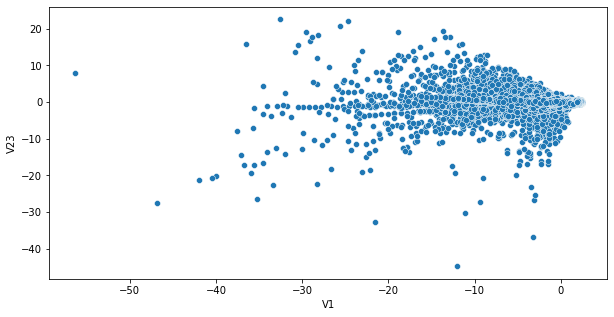

In [355]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V23"])

<AxesSubplot:xlabel='V2', ylabel='V23'>

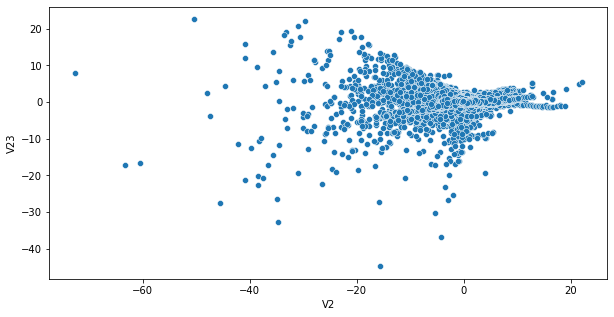

In [356]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V23"])

<AxesSubplot:xlabel='V3', ylabel='V23'>

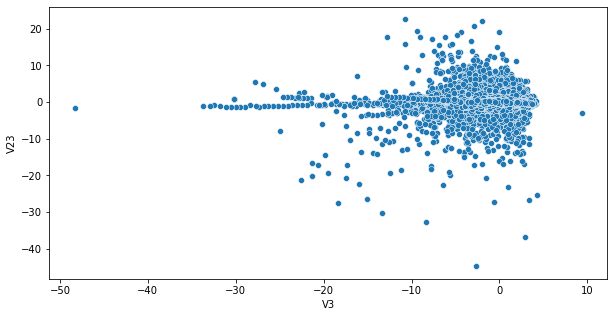

In [357]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V23"])

<AxesSubplot:xlabel='V4', ylabel='V23'>

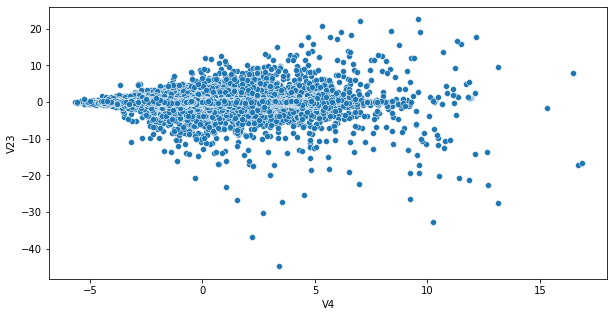

In [358]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V23"])

<AxesSubplot:xlabel='V4', ylabel='V23'>

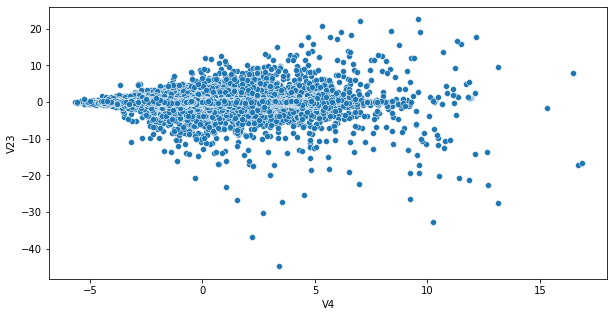

In [359]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V23"])

<AxesSubplot:xlabel='V5', ylabel='V23'>

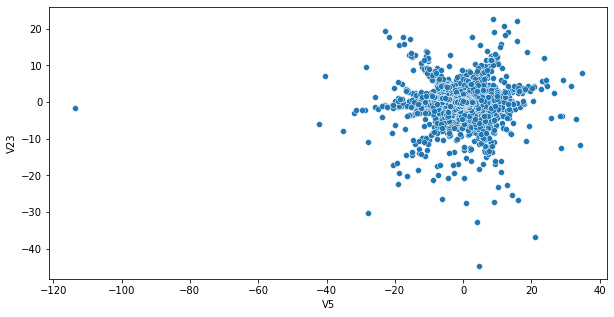

In [360]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V23"])

<AxesSubplot:xlabel='V6', ylabel='V23'>

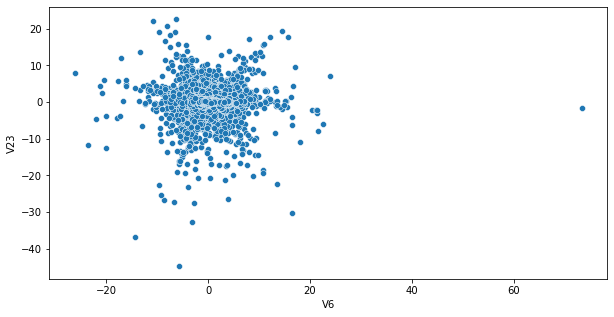

In [361]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V23"])

<AxesSubplot:xlabel='V7', ylabel='V23'>

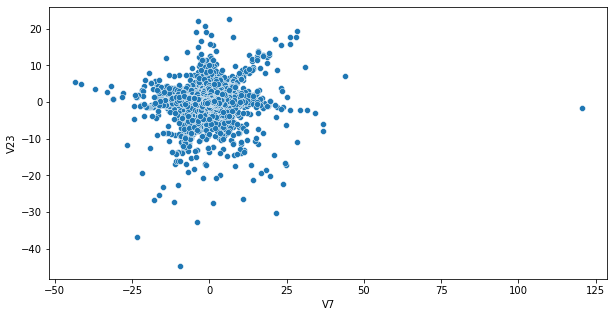

In [362]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V23"])

<AxesSubplot:xlabel='V8', ylabel='V23'>

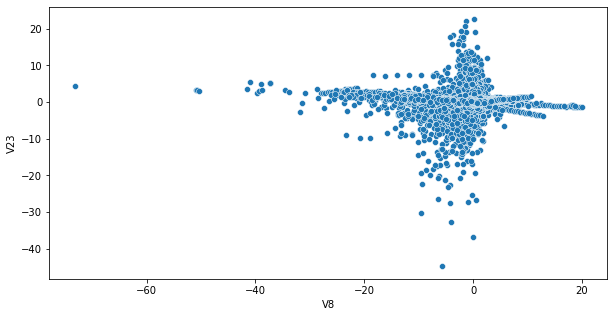

In [363]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V23"])

<AxesSubplot:xlabel='V9', ylabel='V23'>

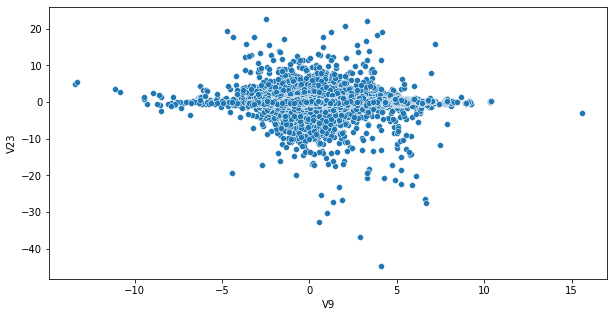

In [364]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V23"])

<AxesSubplot:xlabel='V10', ylabel='V23'>

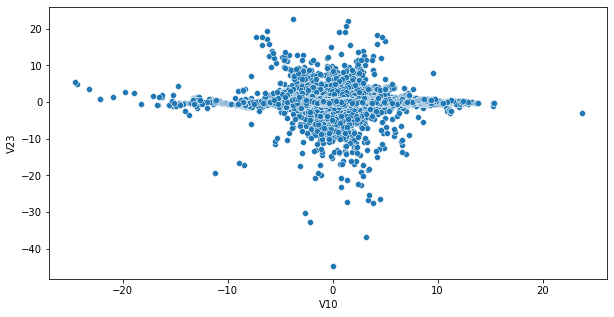

In [365]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V23"])

<AxesSubplot:xlabel='V11', ylabel='V23'>

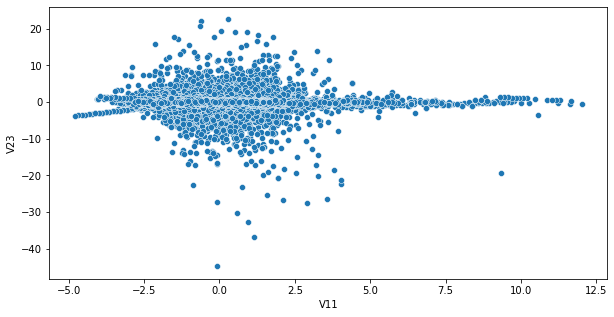

In [366]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V23"])

<AxesSubplot:xlabel='V12', ylabel='V23'>

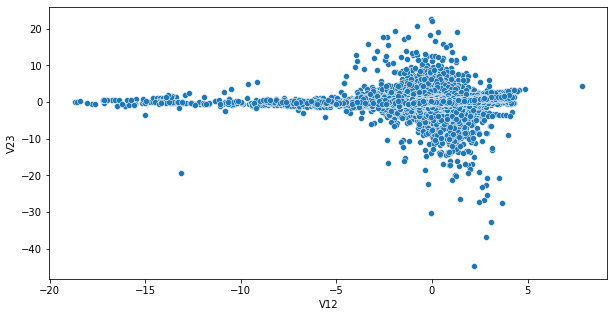

In [367]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V23"])

<AxesSubplot:xlabel='V13', ylabel='V23'>

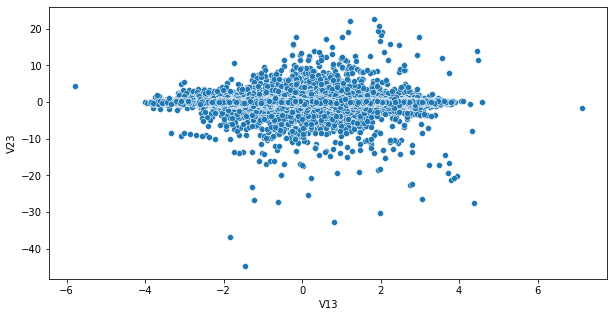

In [368]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V23"])

<AxesSubplot:xlabel='V14', ylabel='V23'>

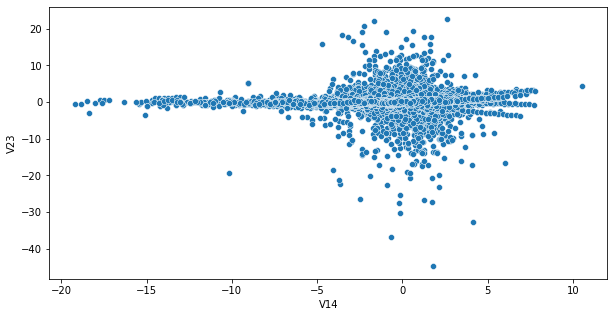

In [369]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V23"])

<AxesSubplot:xlabel='V15', ylabel='V23'>

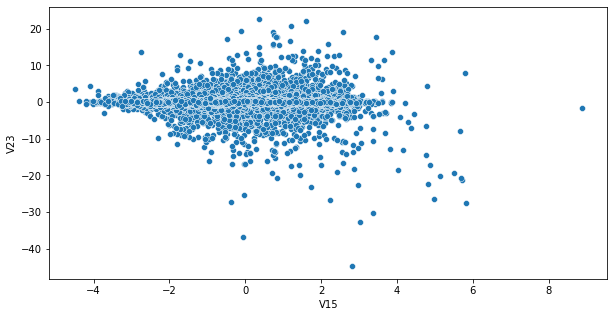

In [370]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V23"])

<AxesSubplot:xlabel='V16', ylabel='V23'>

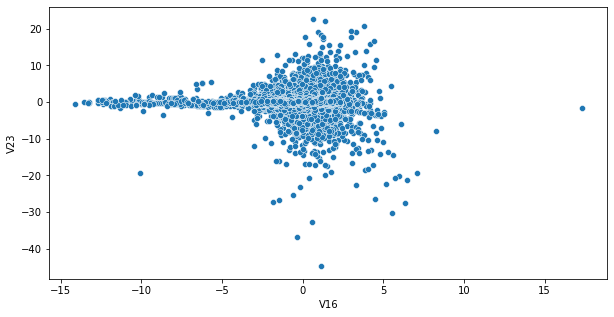

In [371]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V23"])

<AxesSubplot:xlabel='V17', ylabel='V23'>

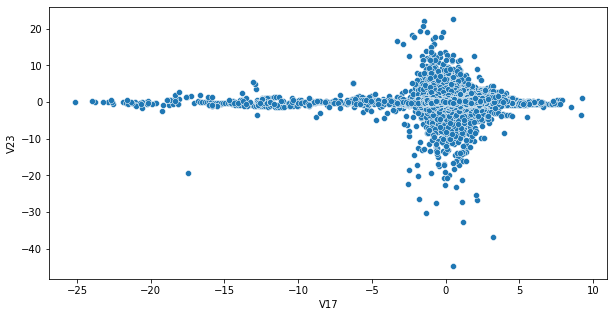

In [372]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V23"])

<AxesSubplot:xlabel='V18', ylabel='V23'>

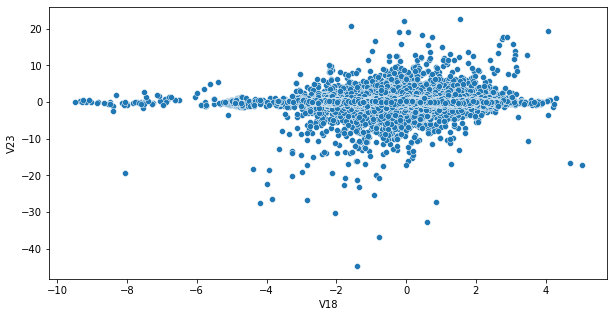

In [373]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V23"])

<AxesSubplot:xlabel='V19', ylabel='V23'>

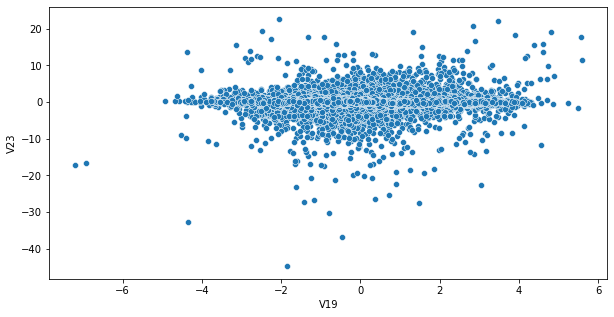

In [374]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V23"])

<AxesSubplot:xlabel='V20', ylabel='V23'>

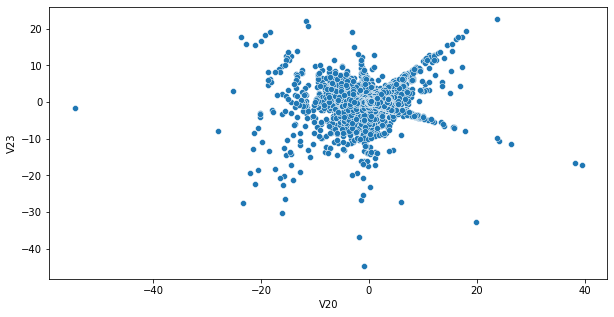

In [375]:
plt.figure(figsize=(10,5))
sns.scatterplot(df['V20'],df["V23"])

<AxesSubplot:xlabel='V21', ylabel='V23'>

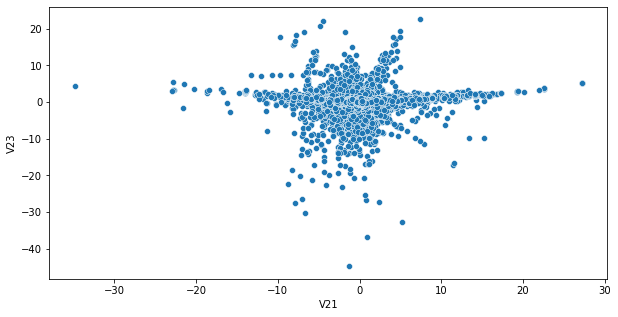

In [376]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V23"])

<AxesSubplot:xlabel='V22', ylabel='V23'>

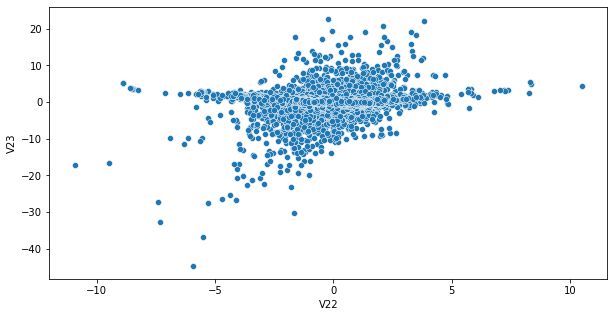

In [377]:
plt.figure(figsize=(10,5))
sns.scatterplot(df['V22'],df["V23"])

<AxesSubplot:xlabel='V1', ylabel='V22'>

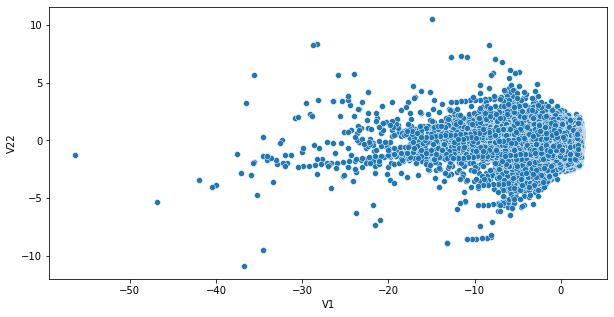

In [378]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V22"])

<AxesSubplot:xlabel='V2', ylabel='V22'>

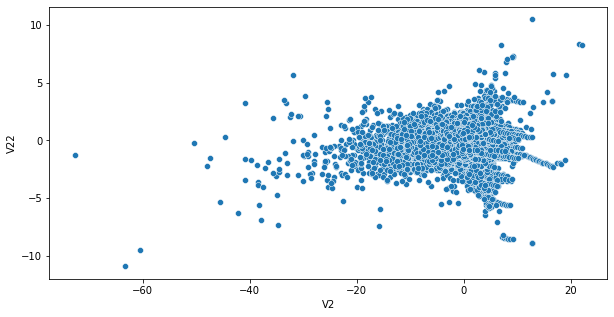

In [379]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V22"])

<AxesSubplot:xlabel='V3', ylabel='V22'>

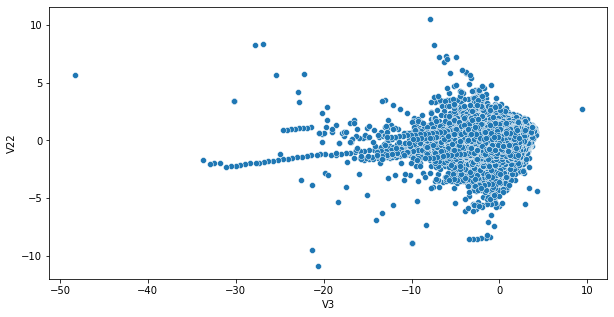

In [380]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V22"])

<AxesSubplot:xlabel='V4', ylabel='V22'>

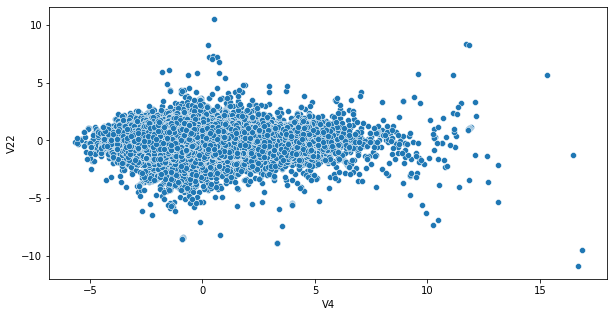

In [381]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V22"])

<AxesSubplot:xlabel='V5', ylabel='V22'>

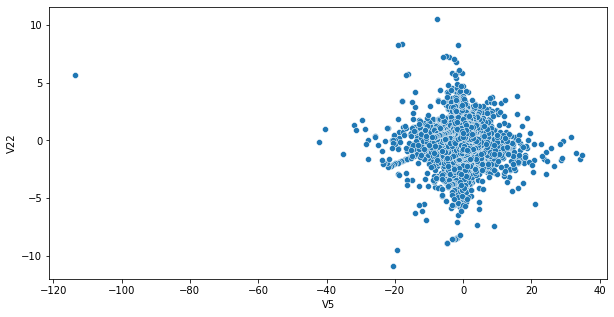

In [382]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V22"])

<AxesSubplot:xlabel='V6', ylabel='V22'>

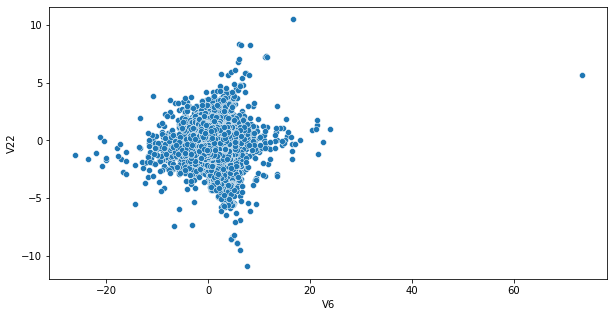

In [383]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V22"])

<AxesSubplot:xlabel='V7', ylabel='V22'>

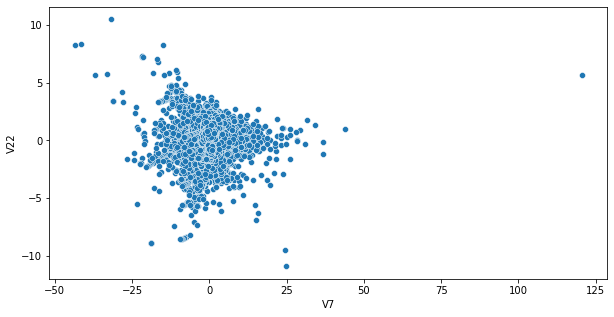

In [384]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V22"])

<AxesSubplot:xlabel='V8', ylabel='V22'>

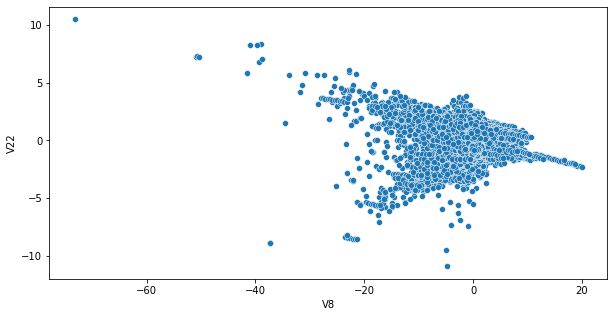

In [385]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V22"])

<AxesSubplot:xlabel='V9', ylabel='V22'>

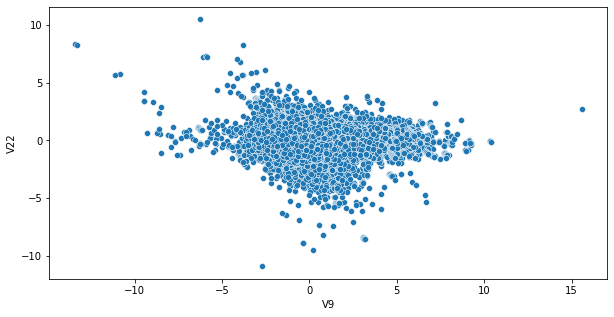

In [386]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V22"])

<AxesSubplot:xlabel='V10', ylabel='V22'>

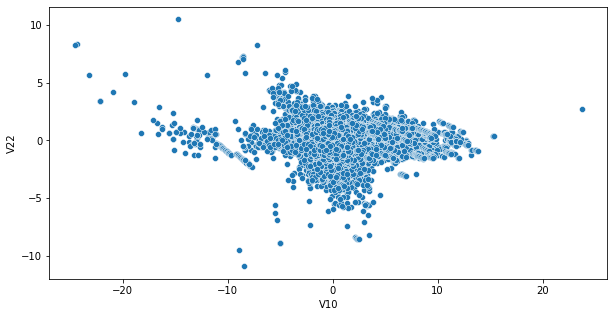

In [387]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V22"])

<AxesSubplot:xlabel='V11', ylabel='V22'>

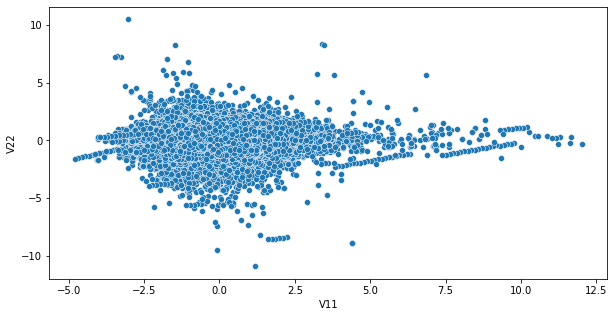

In [388]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V22"])

<AxesSubplot:xlabel='V12', ylabel='V22'>

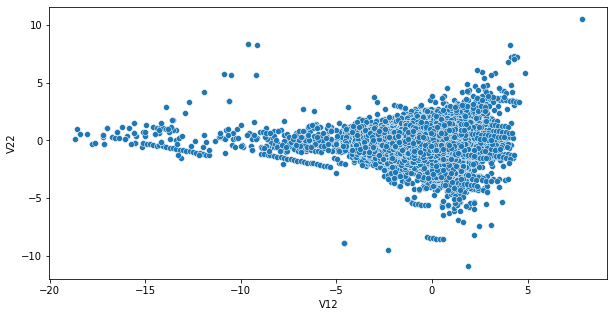

In [389]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V22"])

<AxesSubplot:xlabel='V13', ylabel='V22'>

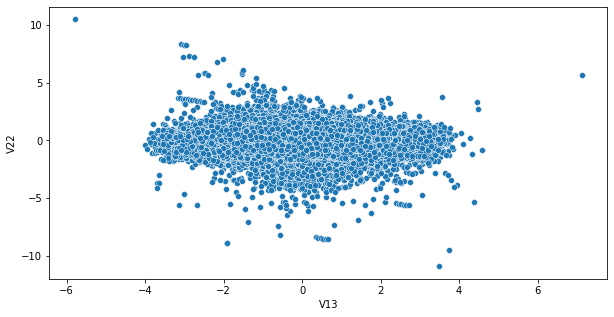

In [390]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V22"])

<AxesSubplot:xlabel='V14', ylabel='V22'>

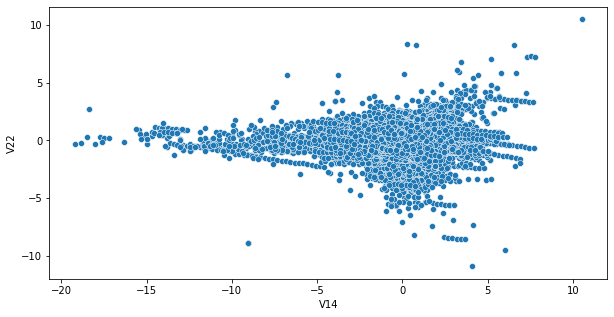

In [391]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V22"])

<AxesSubplot:xlabel='V15', ylabel='V22'>

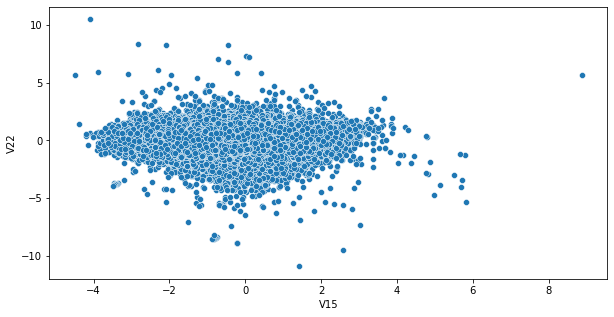

In [392]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V22"])

<AxesSubplot:xlabel='V16', ylabel='V22'>

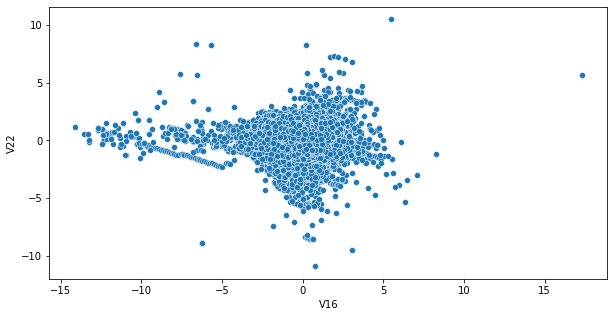

In [393]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V22"])

<AxesSubplot:xlabel='V17', ylabel='V22'>

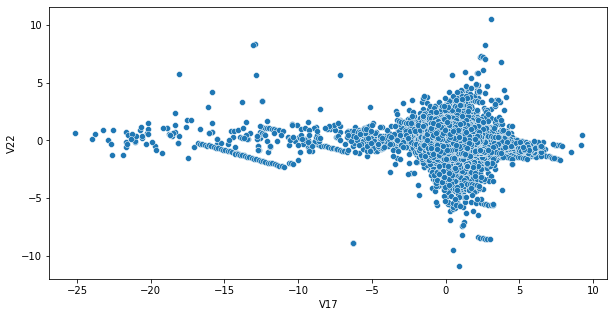

In [394]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V22"])

<AxesSubplot:xlabel='V18', ylabel='V22'>

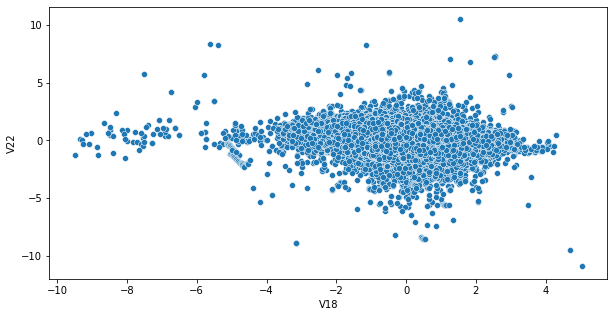

In [395]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V22"])

<AxesSubplot:xlabel='V19', ylabel='V22'>

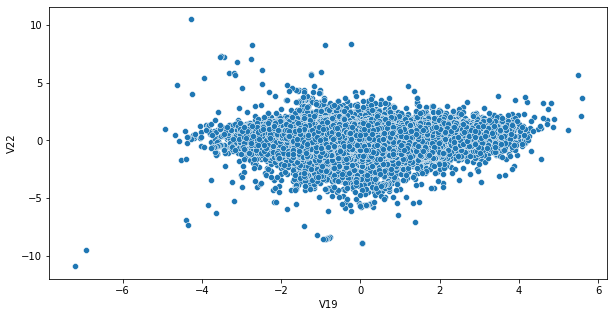

In [396]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V22"])

<AxesSubplot:xlabel='V20', ylabel='V22'>

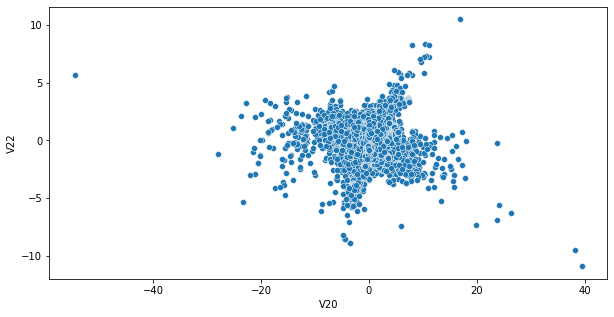

In [397]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V22"])

<AxesSubplot:xlabel='V21', ylabel='V22'>

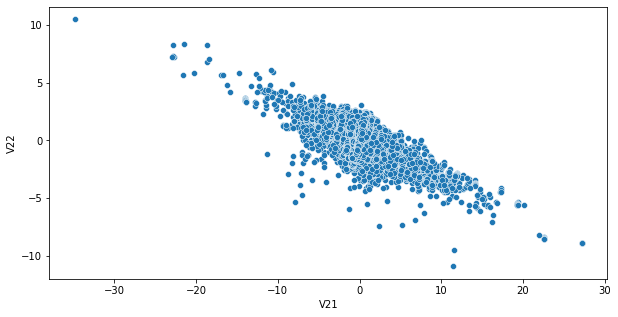

In [398]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V21"],df["V22"])

<AxesSubplot:xlabel='V1', ylabel='V21'>

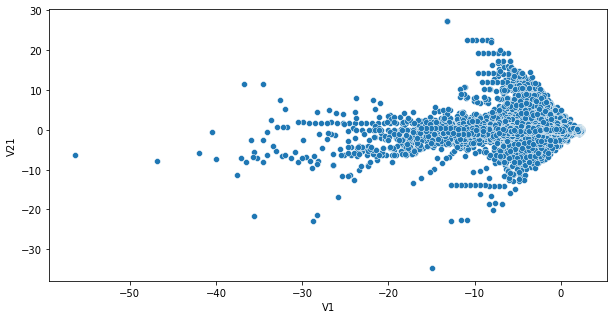

In [399]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V21"])

<AxesSubplot:xlabel='V2', ylabel='V21'>

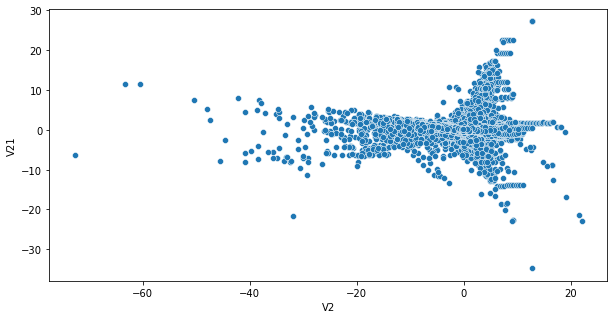

In [400]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V21"])

<AxesSubplot:xlabel='V3', ylabel='V21'>

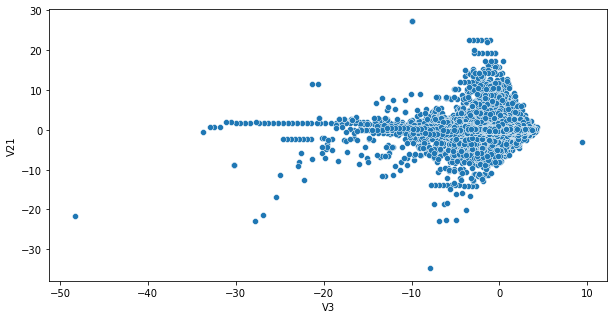

In [401]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V21"])

<AxesSubplot:xlabel='V4', ylabel='V21'>

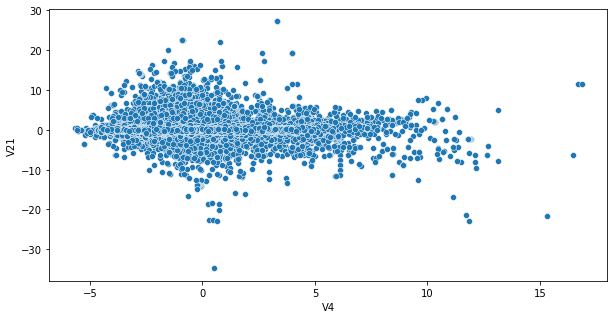

In [402]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V21"])

<AxesSubplot:xlabel='V5', ylabel='V21'>

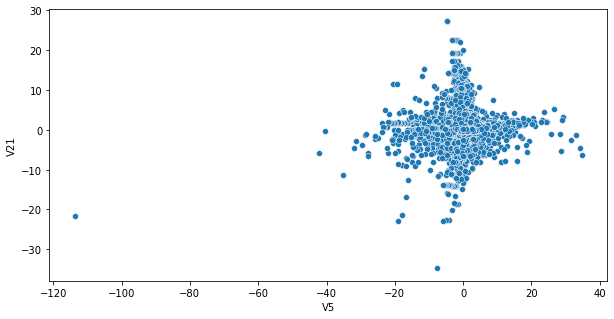

In [403]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V21"])

<AxesSubplot:xlabel='V6', ylabel='V21'>

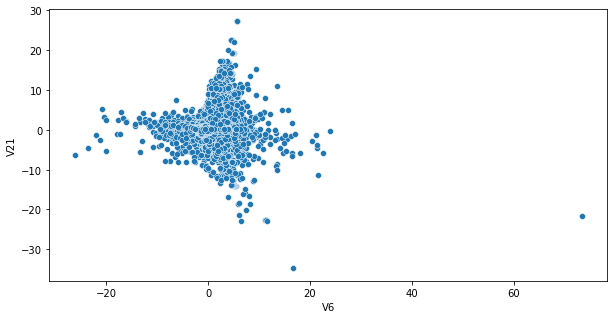

In [404]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V21"])

<AxesSubplot:xlabel='V7', ylabel='V21'>

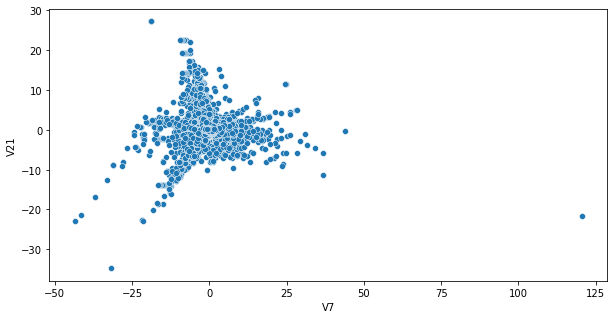

In [405]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V21"])

<AxesSubplot:xlabel='V8', ylabel='V21'>

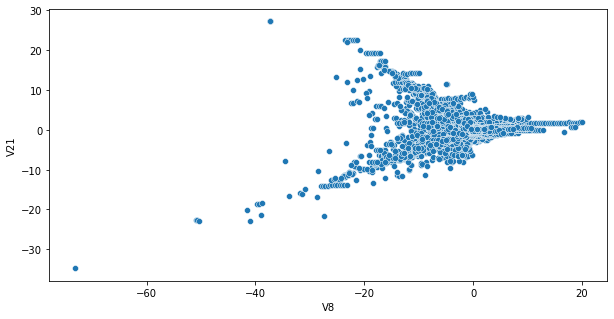

In [406]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V21"])

<AxesSubplot:xlabel='V9', ylabel='V21'>

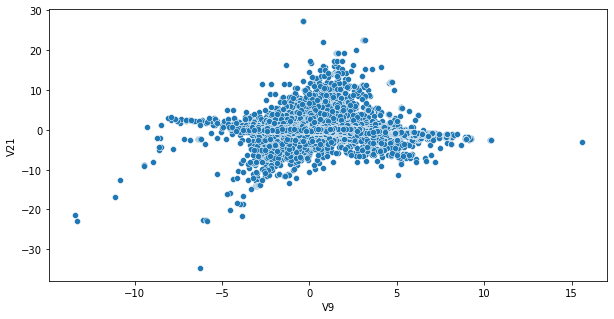

In [407]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V21"])

<AxesSubplot:xlabel='V10', ylabel='V21'>

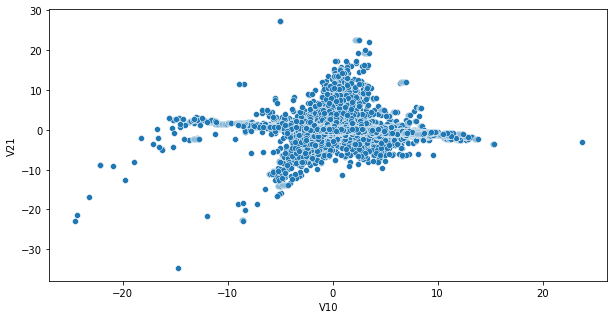

In [408]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V21"])

<AxesSubplot:xlabel='V11', ylabel='V21'>

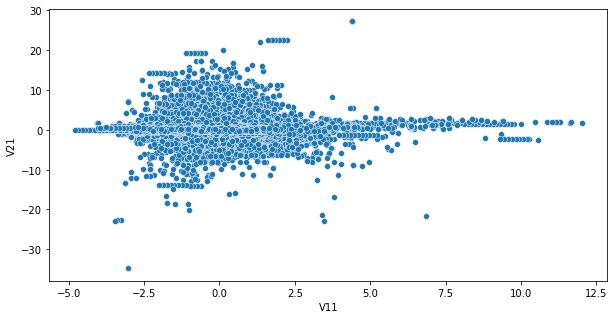

In [409]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V21"])

<AxesSubplot:xlabel='V12', ylabel='V21'>

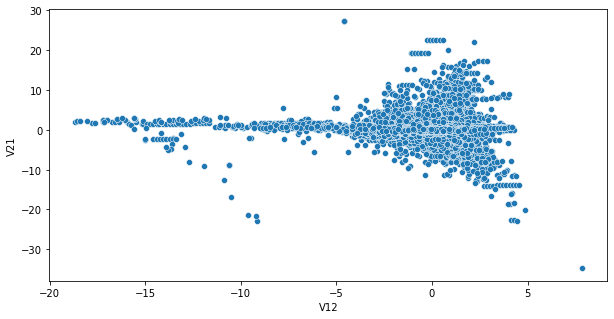

In [410]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V21"])

<AxesSubplot:xlabel='V13', ylabel='V21'>

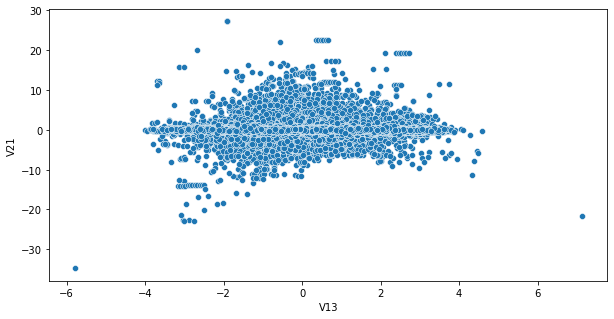

In [411]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V21"])

<AxesSubplot:xlabel='V14', ylabel='V21'>

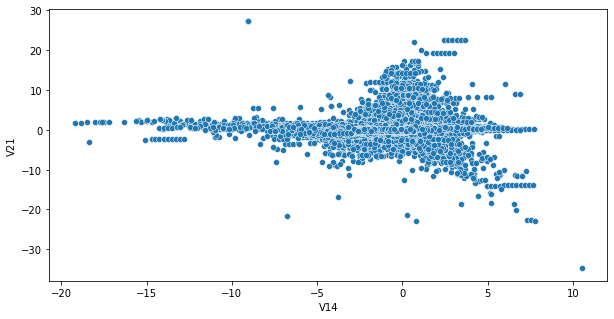

In [412]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V21"])

<AxesSubplot:xlabel='V15', ylabel='V21'>

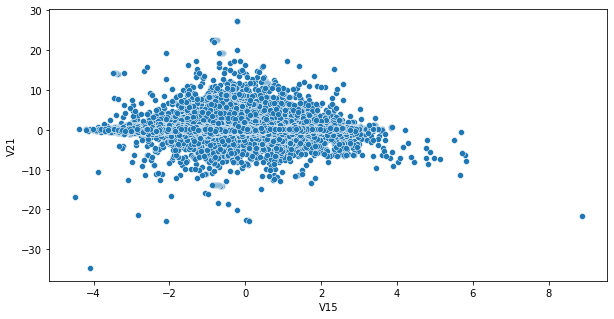

In [413]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V21"])

<AxesSubplot:xlabel='V16', ylabel='V21'>

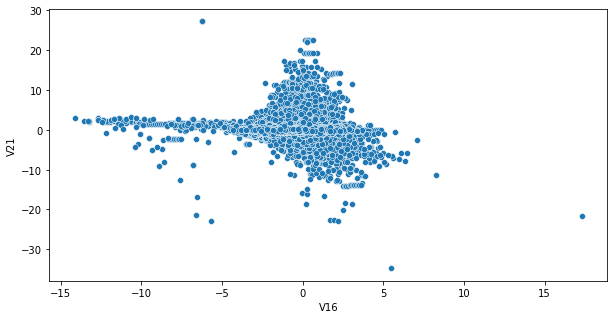

In [414]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V21"])

<AxesSubplot:xlabel='V17', ylabel='V21'>

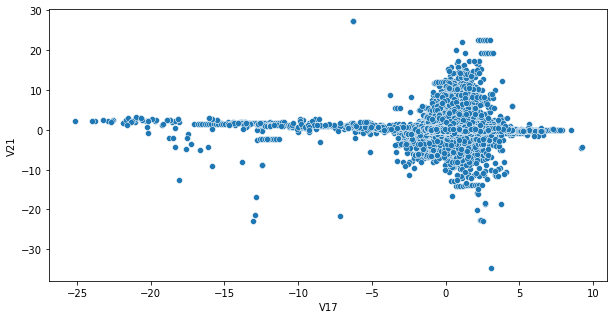

In [415]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V21"])

<AxesSubplot:xlabel='V18', ylabel='V21'>

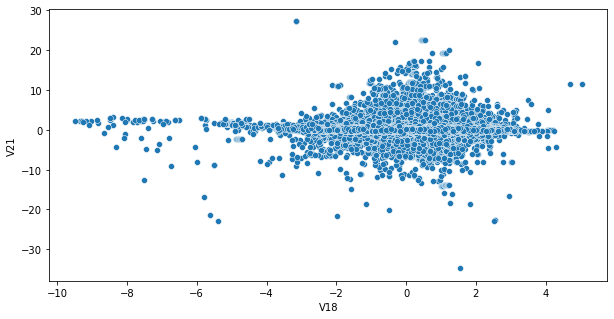

In [416]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V21"])

<AxesSubplot:xlabel='V19', ylabel='V21'>

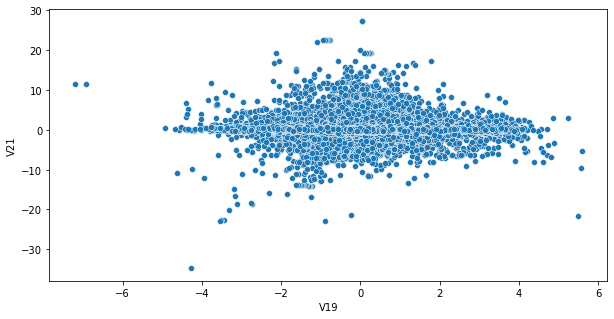

In [417]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V21"])

<AxesSubplot:xlabel='V20', ylabel='V21'>

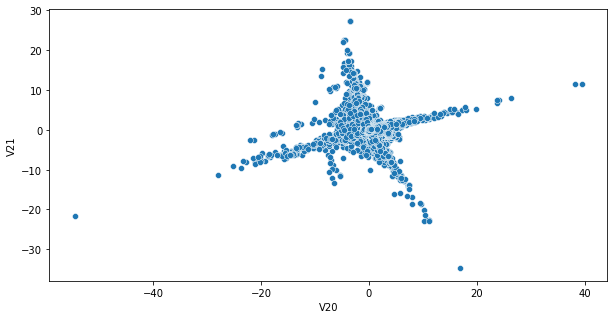

In [418]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V20"],df["V21"])

<AxesSubplot:xlabel='V1', ylabel='V20'>

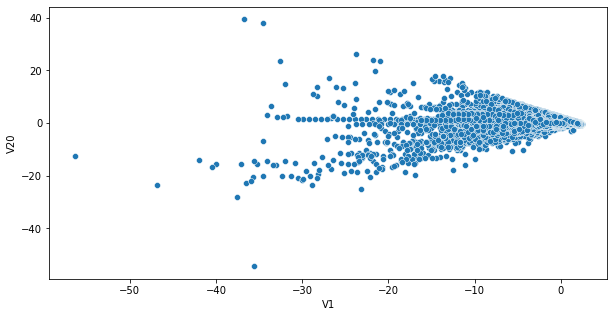

In [419]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V20"])

<AxesSubplot:xlabel='V2', ylabel='V20'>

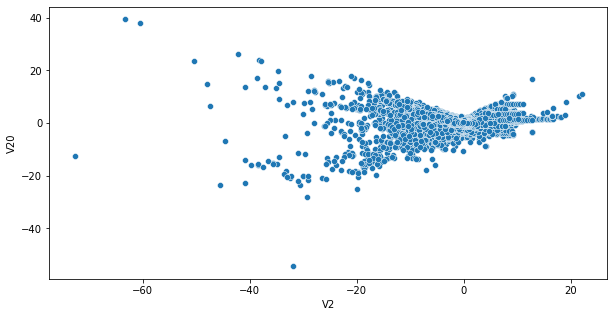

In [420]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V20"])

<AxesSubplot:xlabel='V3', ylabel='V20'>

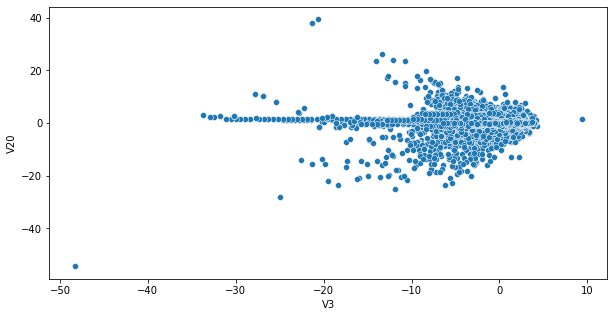

In [421]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V20"])

<AxesSubplot:xlabel='V4', ylabel='V20'>

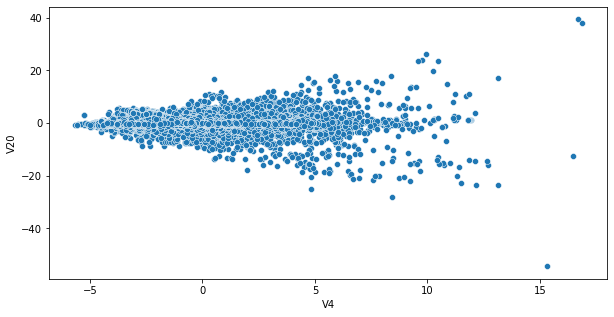

In [422]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V20"])

<AxesSubplot:xlabel='V5', ylabel='V20'>

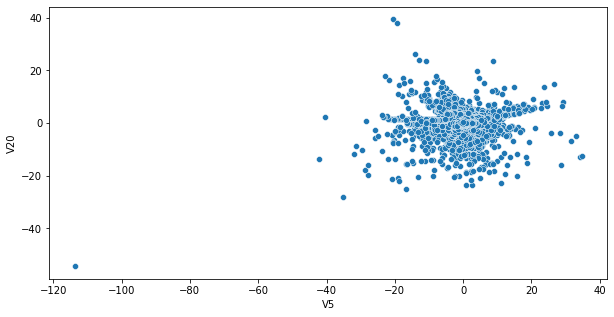

In [423]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V20"])

<AxesSubplot:xlabel='V6', ylabel='V20'>

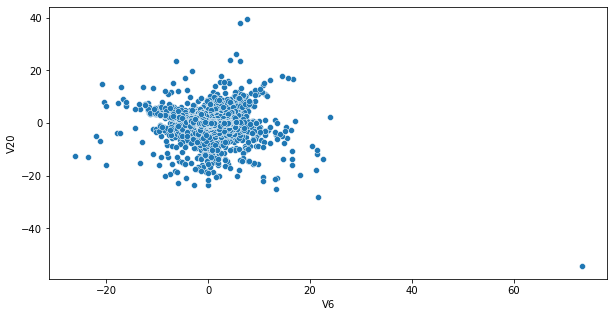

In [424]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V20"])

<AxesSubplot:xlabel='V7', ylabel='V20'>

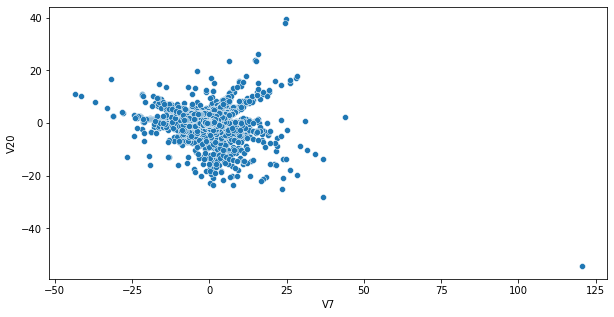

In [425]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V20"])

<AxesSubplot:xlabel='V8', ylabel='V20'>

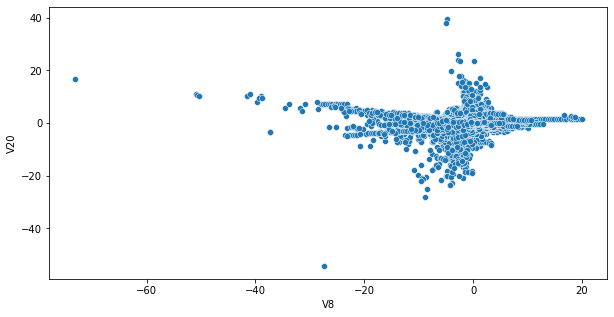

In [426]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V20"])

<AxesSubplot:xlabel='V9', ylabel='V20'>

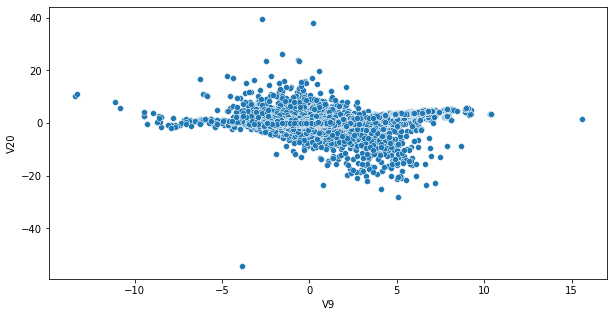

In [427]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V20"])

<AxesSubplot:xlabel='V10', ylabel='V20'>

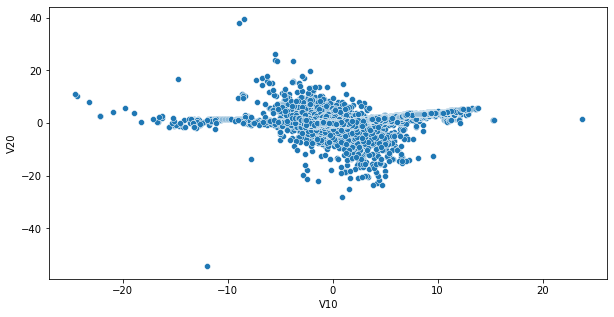

In [428]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V20"])

<AxesSubplot:xlabel='V11', ylabel='V20'>

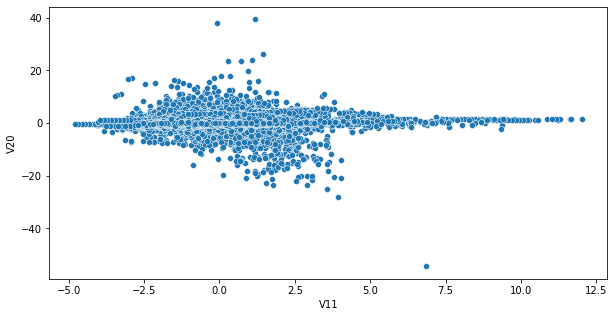

In [429]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V20"])

<AxesSubplot:xlabel='V12', ylabel='V20'>

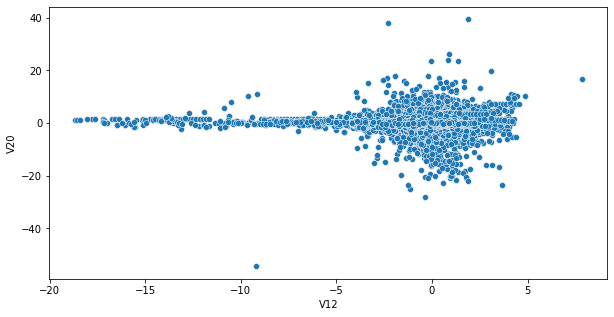

In [430]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V20"])

<AxesSubplot:xlabel='V13', ylabel='V20'>

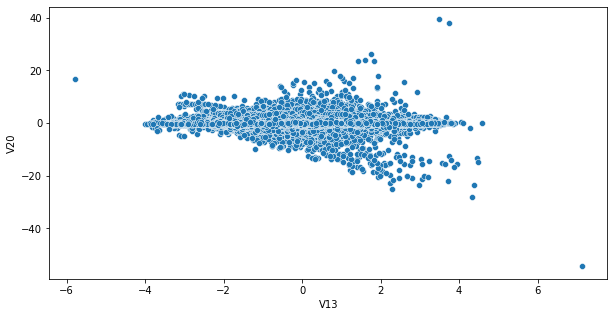

In [431]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V20"])

<AxesSubplot:xlabel='V14', ylabel='V20'>

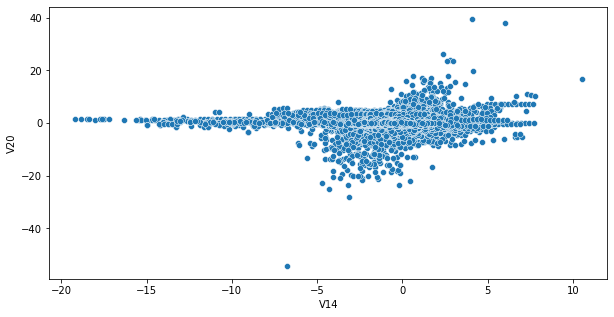

In [432]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V20"])

<AxesSubplot:xlabel='V15', ylabel='V20'>

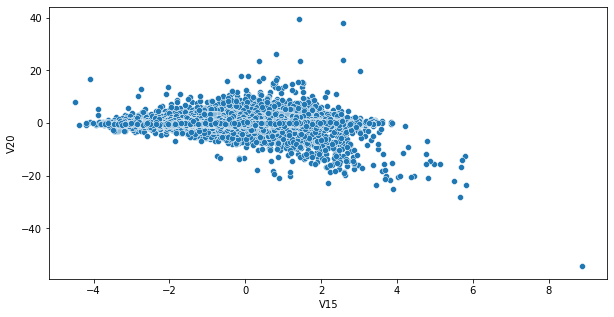

In [433]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V20"])

<AxesSubplot:xlabel='V16', ylabel='V20'>

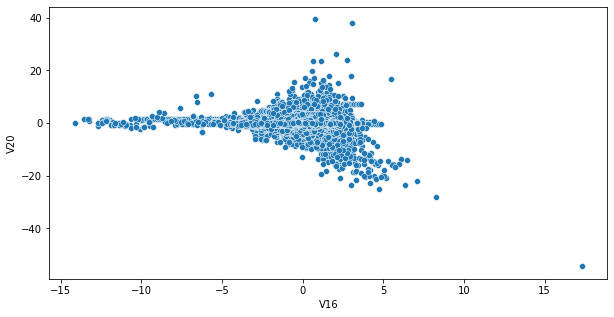

In [434]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V20"])

<AxesSubplot:xlabel='V17', ylabel='V20'>

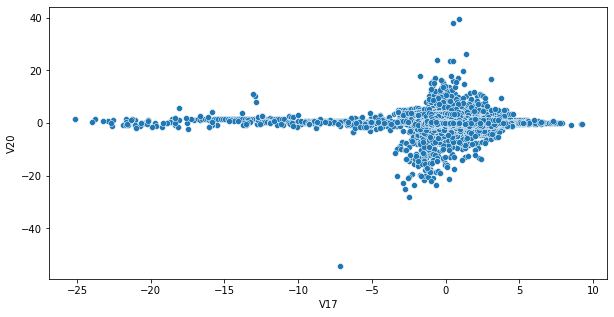

In [435]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V20"])

<AxesSubplot:xlabel='V18', ylabel='V20'>

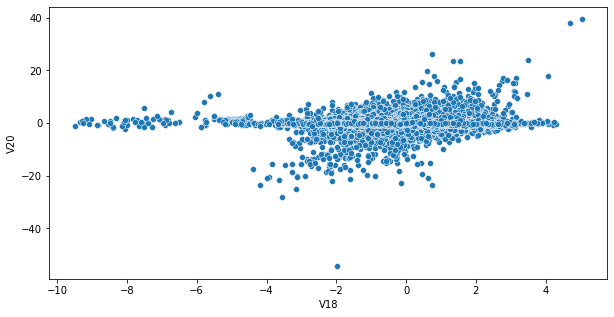

In [436]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V20"])

<AxesSubplot:xlabel='V19', ylabel='V20'>

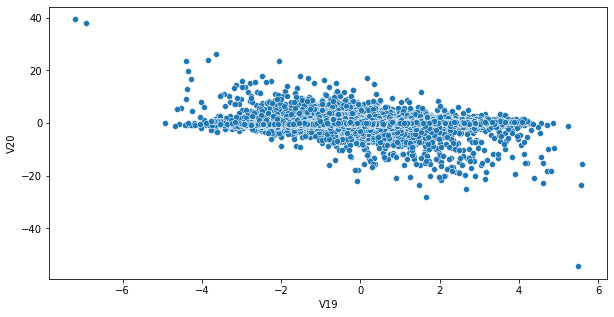

In [437]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V19"],df["V20"])

<AxesSubplot:xlabel='V1', ylabel='V19'>

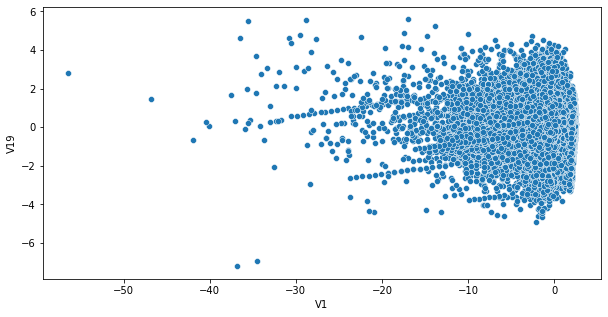

In [438]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V19"])

<AxesSubplot:xlabel='V2', ylabel='V19'>

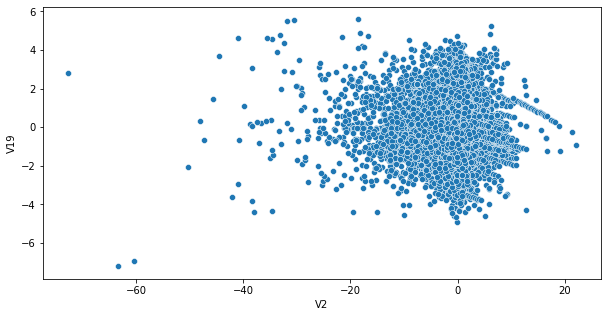

In [439]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V19"])

<AxesSubplot:xlabel='V3', ylabel='V19'>

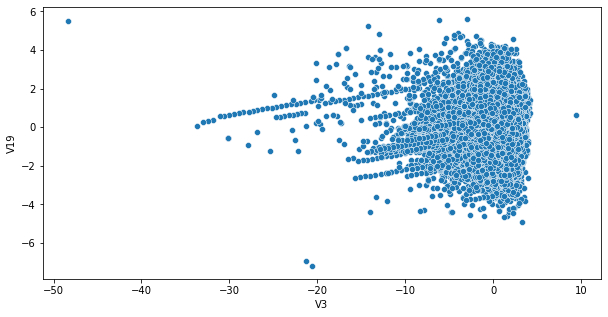

In [440]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V19"])

<AxesSubplot:xlabel='V4', ylabel='V19'>

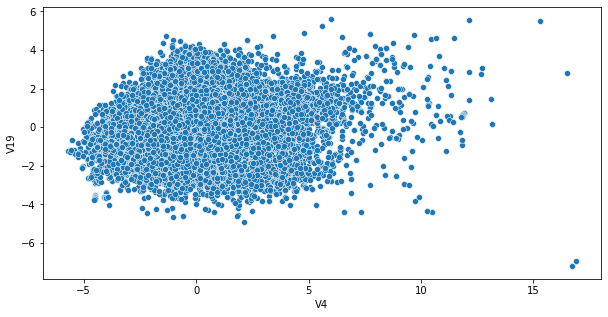

In [441]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V19"])

<AxesSubplot:xlabel='V5', ylabel='V19'>

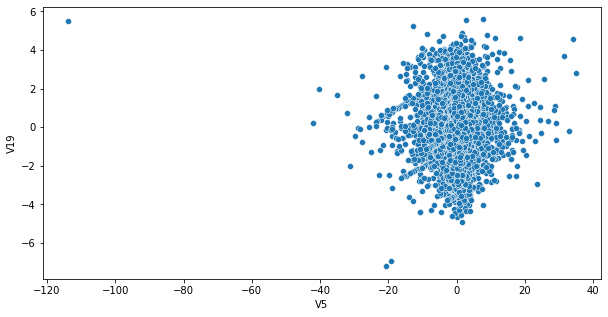

In [442]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V19"])

<AxesSubplot:xlabel='V6', ylabel='V19'>

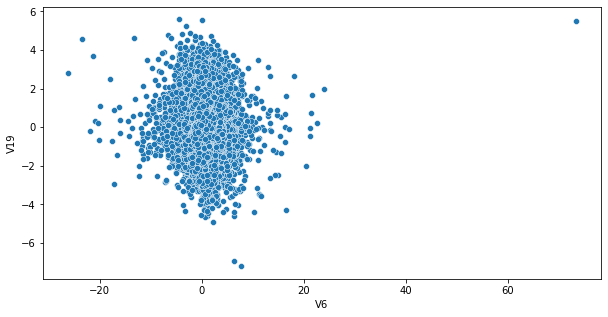

In [443]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V19"])

<AxesSubplot:xlabel='V7', ylabel='V19'>

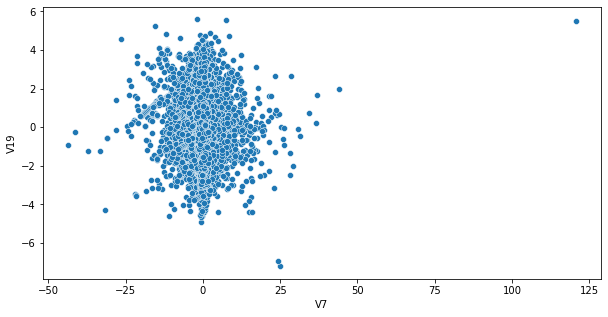

In [444]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V19"])

<AxesSubplot:xlabel='V8', ylabel='V19'>

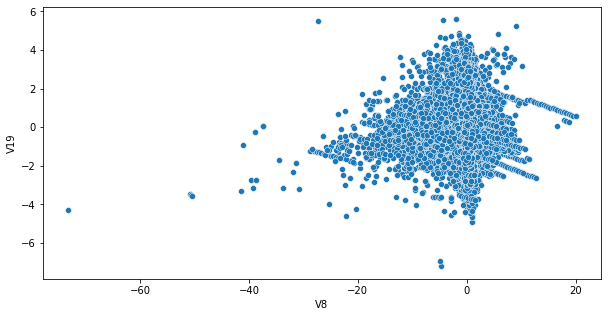

In [445]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V19"])

<AxesSubplot:xlabel='V9', ylabel='V19'>

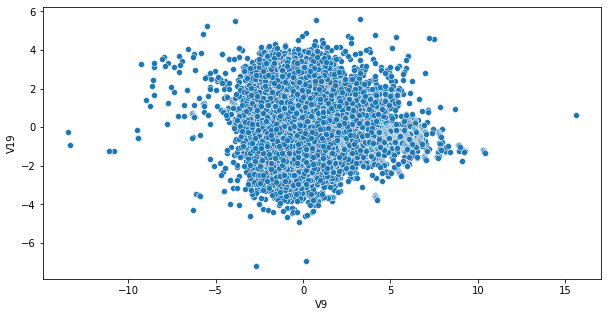

In [446]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V19"])

<AxesSubplot:xlabel='V10', ylabel='V19'>

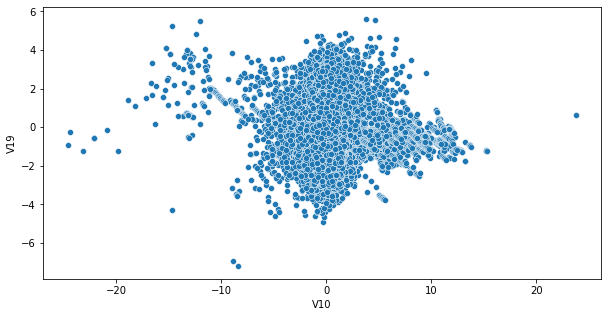

In [447]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V19"])

<AxesSubplot:xlabel='V11', ylabel='V19'>

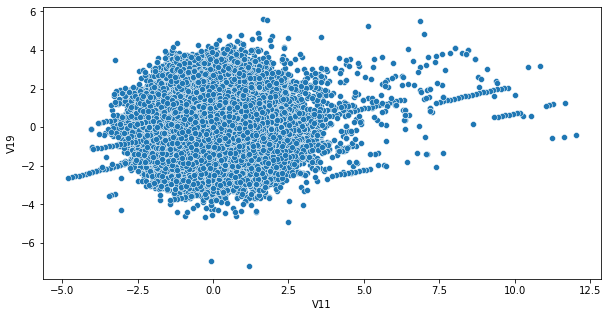

In [448]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V19"])

<AxesSubplot:xlabel='V12', ylabel='V19'>

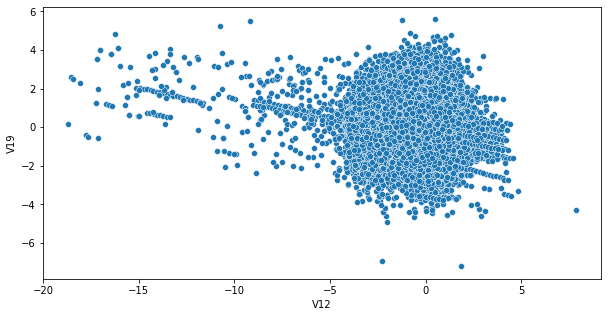

In [449]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V19"])

<AxesSubplot:xlabel='V13', ylabel='V19'>

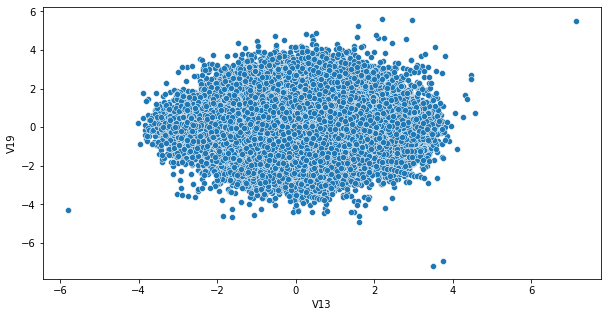

In [450]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V19"])

<AxesSubplot:xlabel='V14', ylabel='V19'>

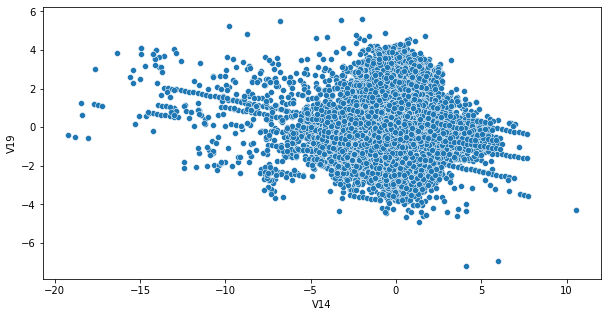

In [451]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V19"])

<AxesSubplot:xlabel='V15', ylabel='V19'>

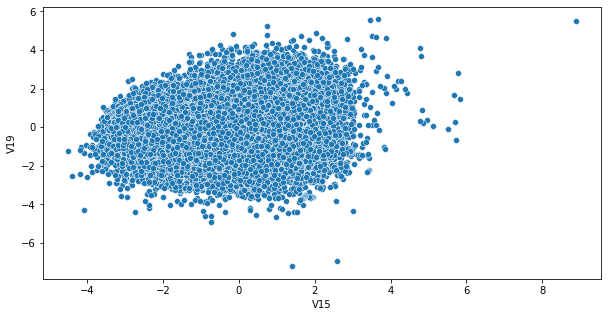

In [452]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V19"])

<AxesSubplot:xlabel='V16', ylabel='V19'>

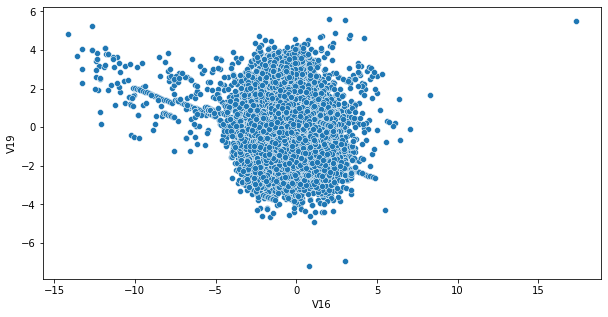

In [453]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V19"])

<AxesSubplot:xlabel='V17', ylabel='V19'>

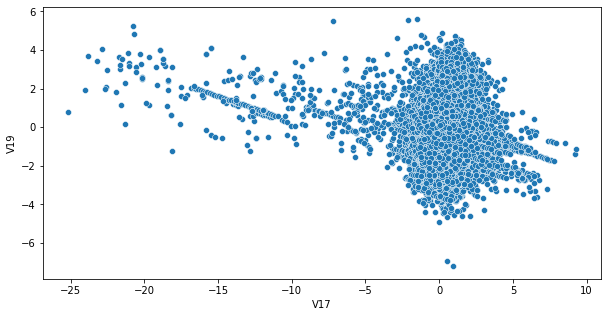

In [454]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V19"])

<AxesSubplot:xlabel='V18', ylabel='V19'>

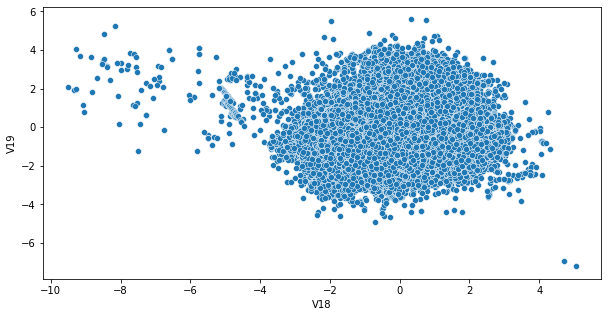

In [455]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V18"],df["V19"])

<AxesSubplot:xlabel='V1', ylabel='V18'>

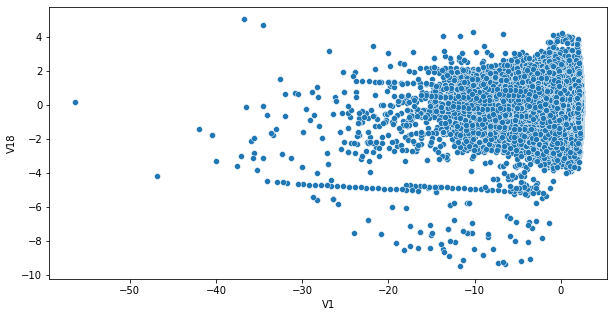

In [456]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V18"])

<AxesSubplot:xlabel='V2', ylabel='V18'>

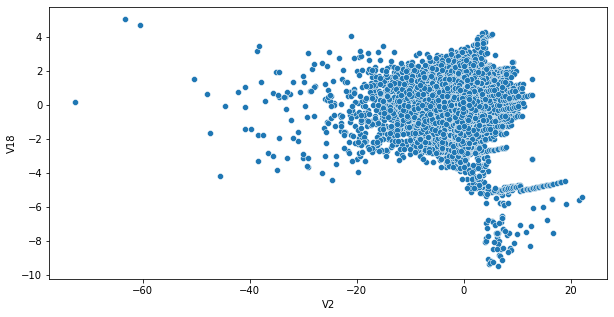

In [457]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V18"])

<AxesSubplot:xlabel='V3', ylabel='V18'>

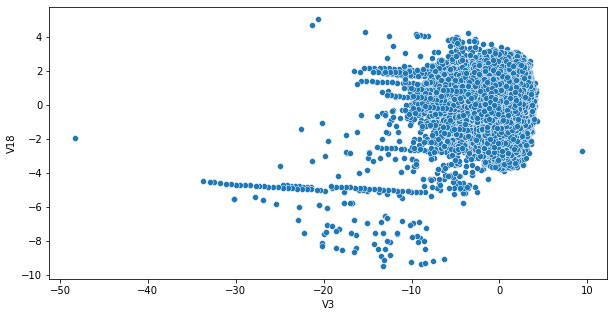

In [458]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V18"])

<AxesSubplot:xlabel='V4', ylabel='V18'>

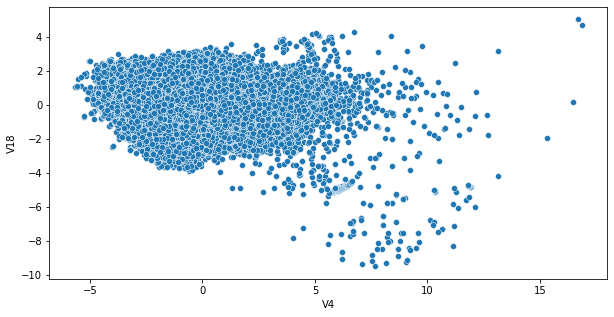

In [459]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V18"])

<AxesSubplot:xlabel='V5', ylabel='V18'>

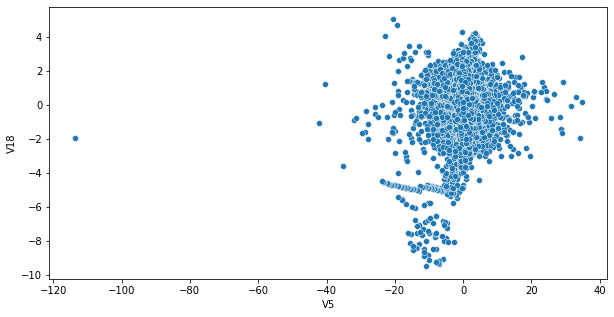

In [460]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V18"])

<AxesSubplot:xlabel='V6', ylabel='V18'>

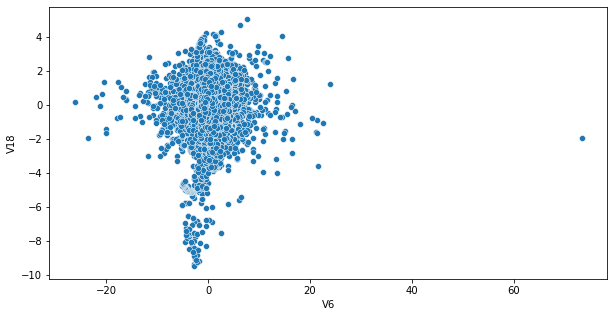

In [461]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V18"])

<AxesSubplot:xlabel='V7', ylabel='V18'>

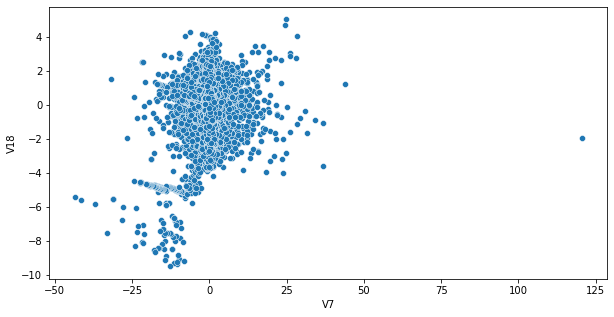

In [462]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V18"])

<AxesSubplot:xlabel='V8', ylabel='V18'>

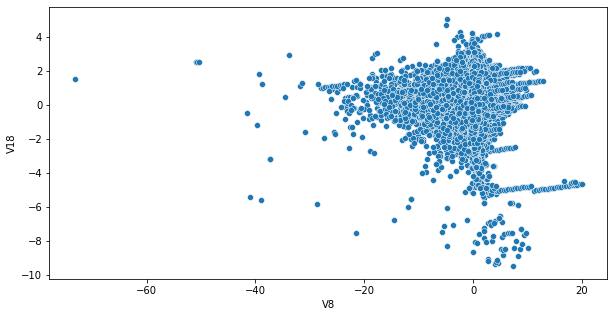

In [463]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V18"])

<AxesSubplot:xlabel='V9', ylabel='V18'>

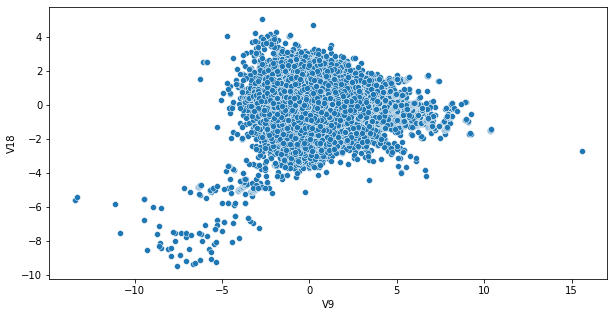

In [464]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V18"])

<AxesSubplot:xlabel='V10', ylabel='V18'>

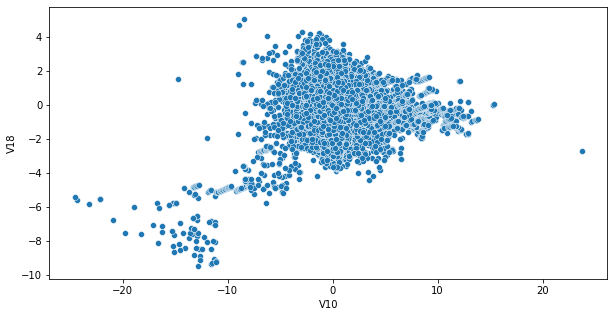

In [465]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V18"])

<AxesSubplot:xlabel='V11', ylabel='V18'>

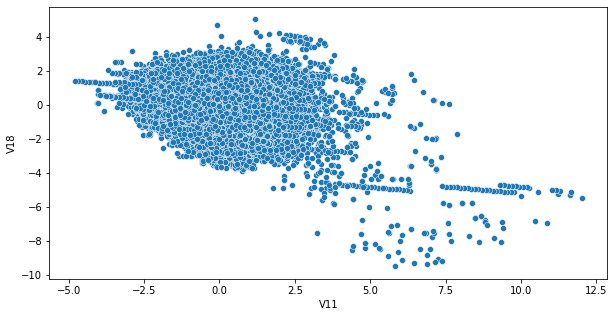

In [466]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V18"])

<AxesSubplot:xlabel='V12', ylabel='V18'>

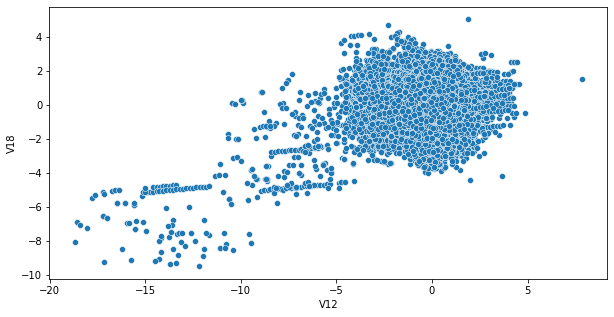

In [467]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V18"])

<AxesSubplot:xlabel='V13', ylabel='V18'>

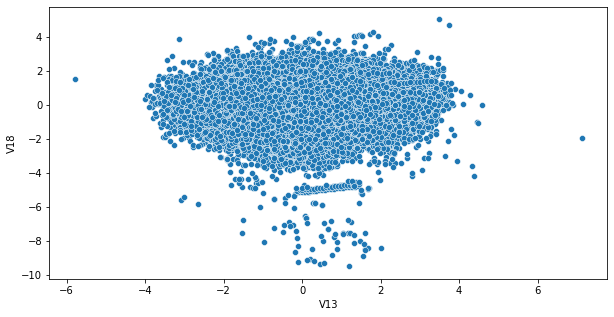

In [468]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V18"])

<AxesSubplot:xlabel='V14', ylabel='V18'>

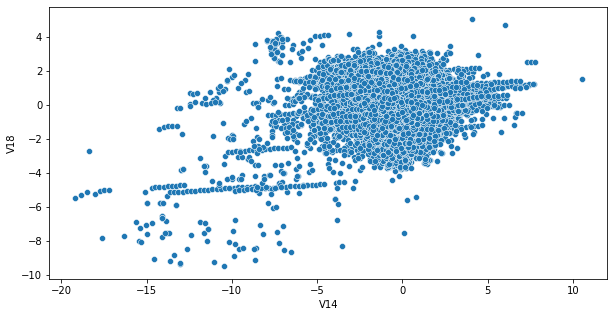

In [469]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V18"])

<AxesSubplot:xlabel='V15', ylabel='V18'>

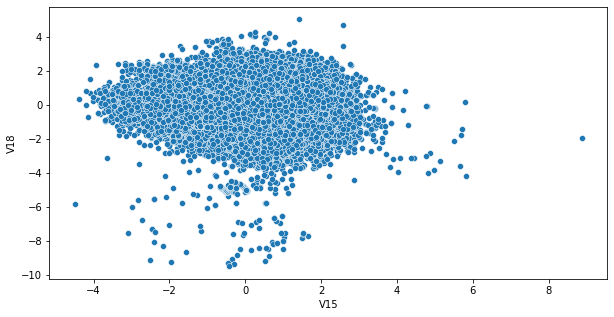

In [470]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V18"])

<AxesSubplot:xlabel='V16', ylabel='V18'>

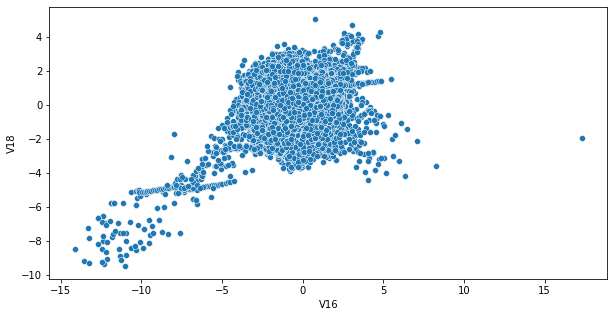

In [471]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V18"])

<AxesSubplot:xlabel='V17', ylabel='V18'>

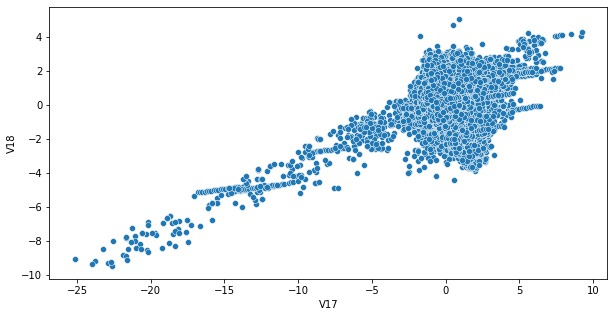

In [472]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V17"],df["V18"])

<AxesSubplot:xlabel='V1', ylabel='V17'>

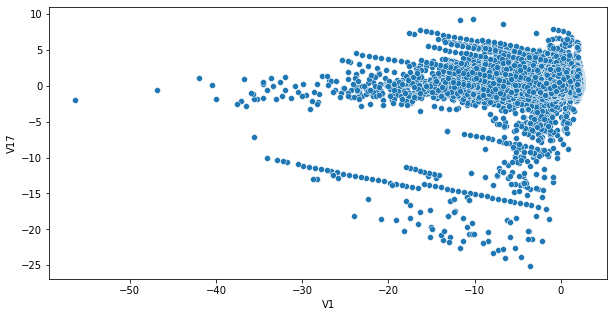

In [473]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V17"])

<AxesSubplot:xlabel='V2', ylabel='V17'>

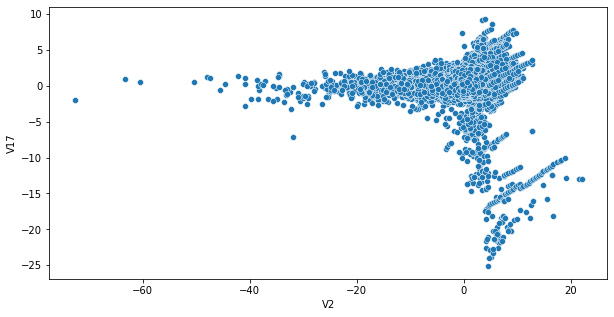

In [474]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V17"])

<AxesSubplot:xlabel='V3', ylabel='V17'>

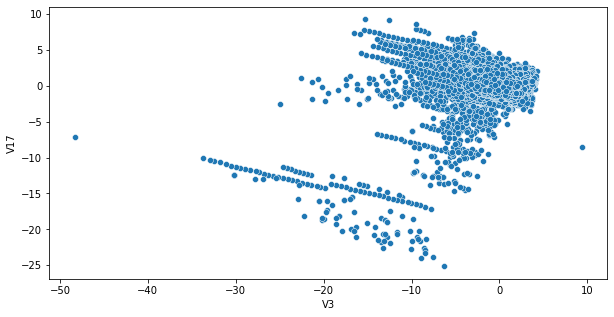

In [475]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V17"])

<AxesSubplot:xlabel='V4', ylabel='V17'>

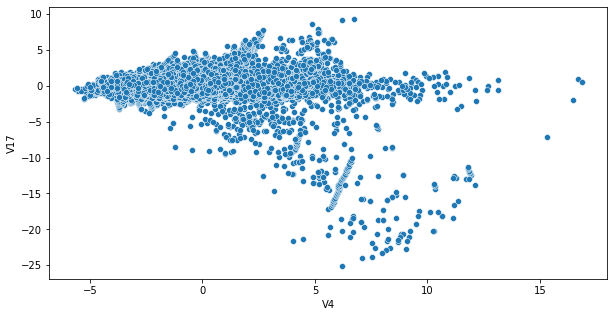

In [476]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V17"])

<AxesSubplot:xlabel='V5', ylabel='V17'>

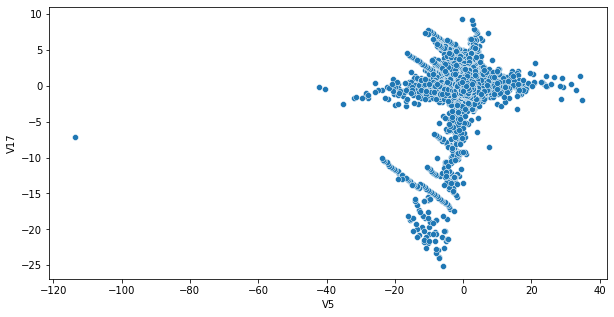

In [477]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V17"])

<AxesSubplot:xlabel='V6', ylabel='V17'>

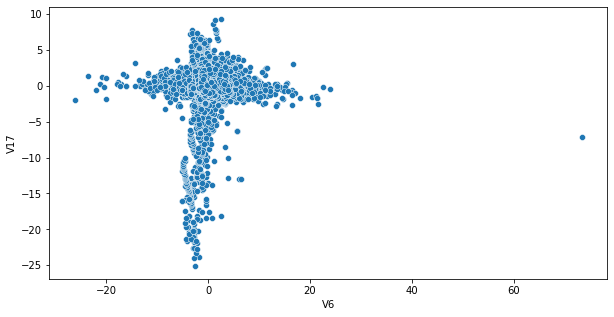

In [478]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V17"])

<AxesSubplot:xlabel='V7', ylabel='V17'>

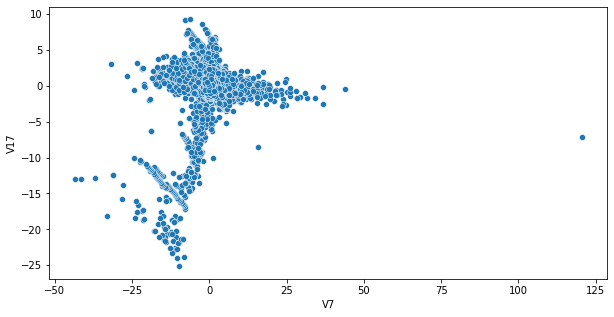

In [479]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V17"])

<AxesSubplot:xlabel='V8', ylabel='V17'>

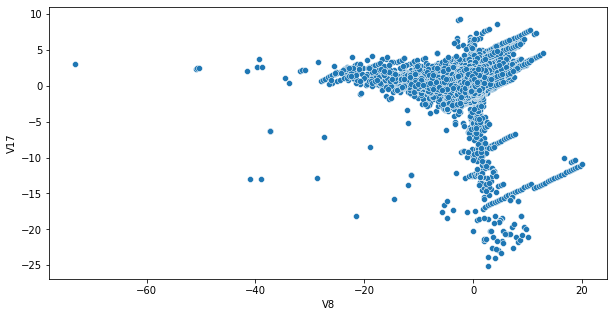

In [480]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V17"])

<AxesSubplot:xlabel='V9', ylabel='V17'>

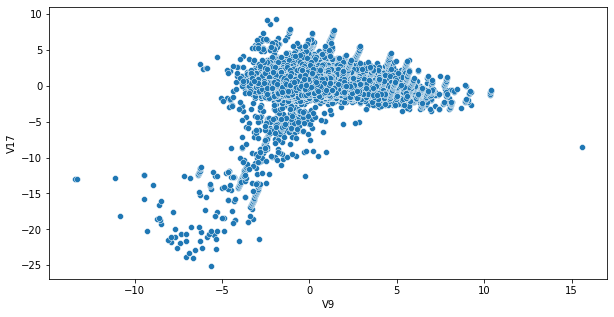

In [481]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V17"])

<AxesSubplot:xlabel='V10', ylabel='V17'>

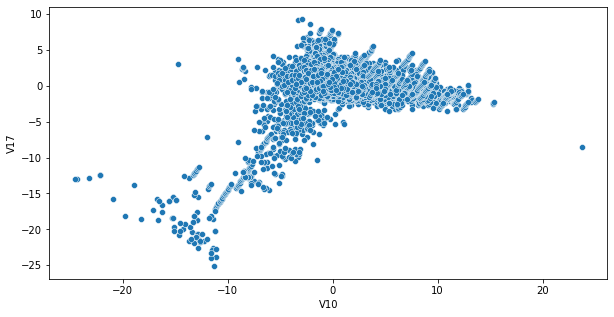

In [482]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V17"])

<AxesSubplot:xlabel='V11', ylabel='V17'>

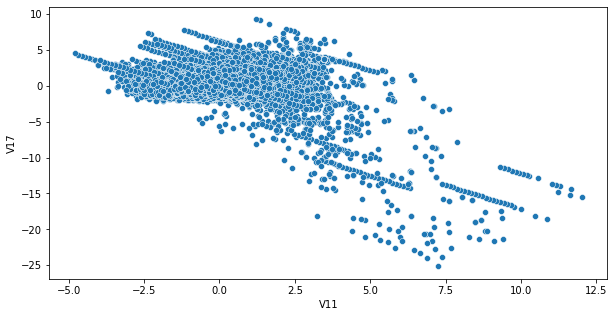

In [483]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V17"])

<AxesSubplot:xlabel='V12', ylabel='V17'>

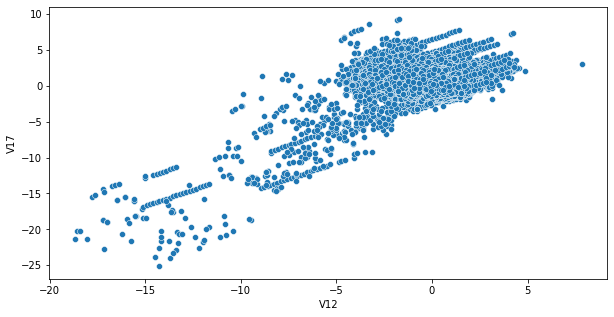

In [484]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V17"])

<AxesSubplot:xlabel='V13', ylabel='V17'>

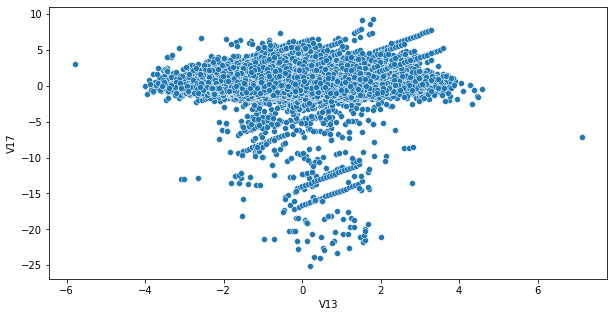

In [485]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V17"])

<AxesSubplot:xlabel='V14', ylabel='V17'>

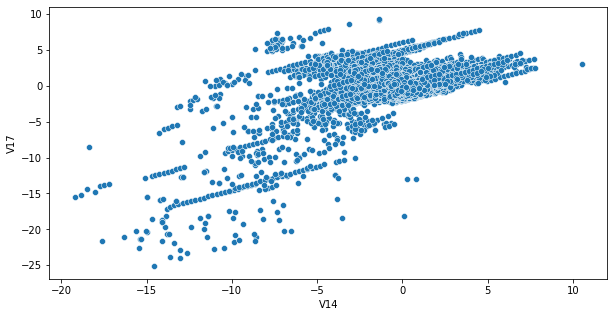

In [486]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V17"])

<AxesSubplot:xlabel='V15', ylabel='V17'>

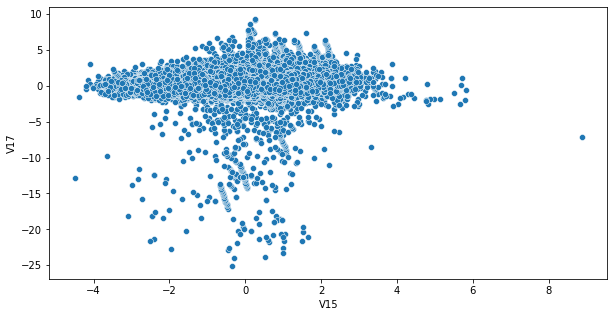

In [487]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V17"])

<AxesSubplot:xlabel='V16', ylabel='V17'>

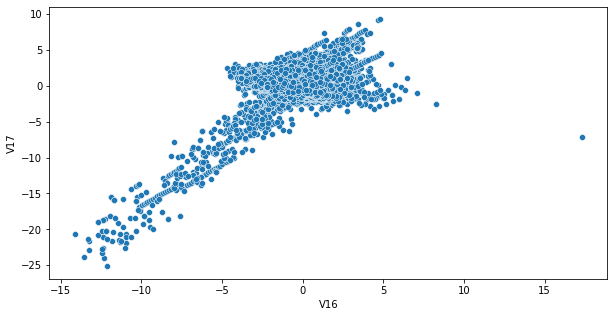

In [488]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V16"],df["V17"])

<AxesSubplot:xlabel='V1', ylabel='V16'>

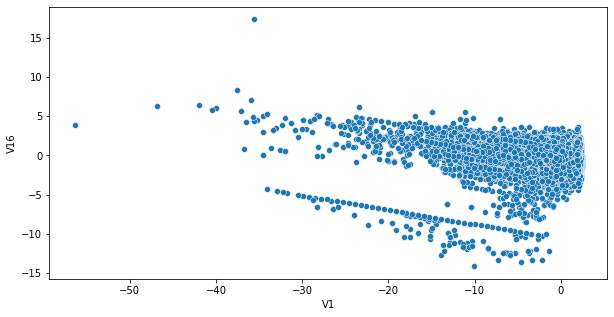

In [489]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V16"])

<AxesSubplot:xlabel='V2', ylabel='V16'>

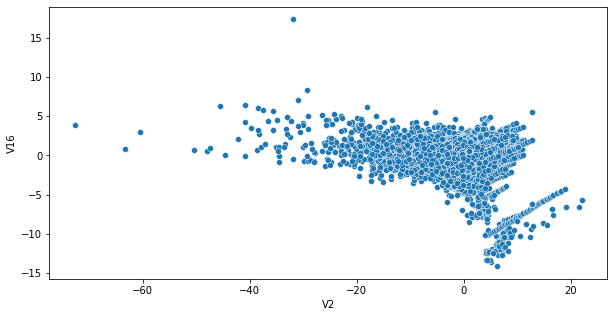

In [490]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V16"])

<AxesSubplot:xlabel='V3', ylabel='V16'>

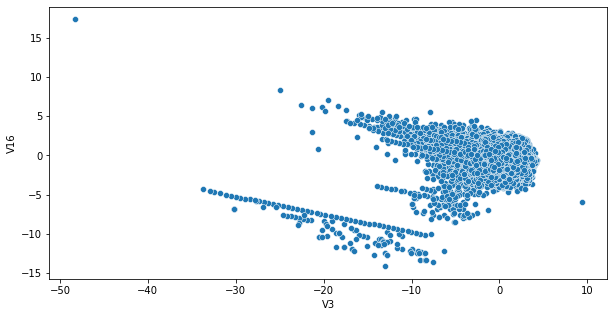

In [491]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V16"])

<AxesSubplot:xlabel='V4', ylabel='V16'>

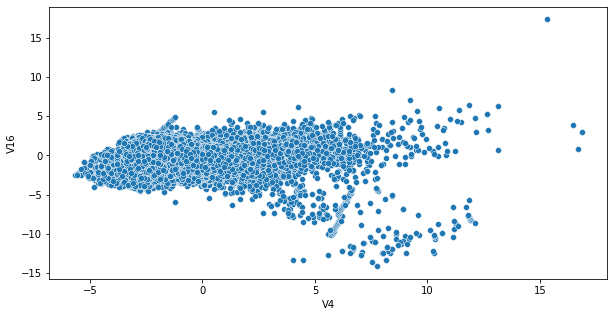

In [492]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V16"])

<AxesSubplot:xlabel='V5', ylabel='V16'>

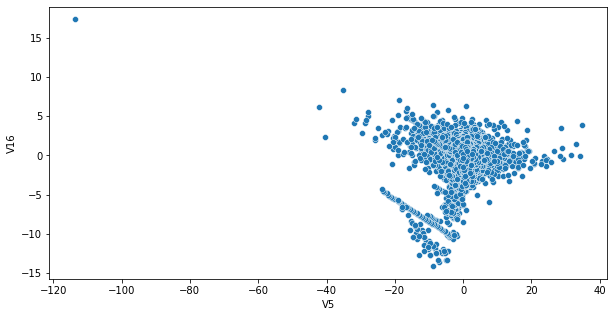

In [493]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V16"])

<AxesSubplot:xlabel='V6', ylabel='V16'>

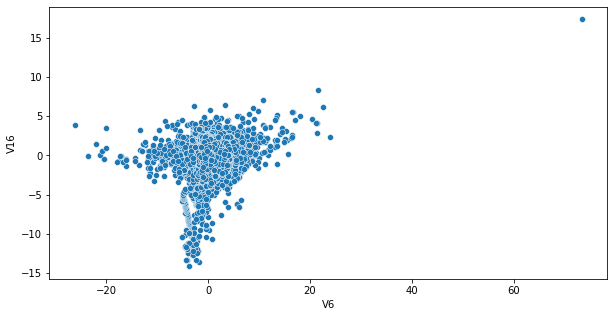

In [494]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V16"])

<AxesSubplot:xlabel='V7', ylabel='V16'>

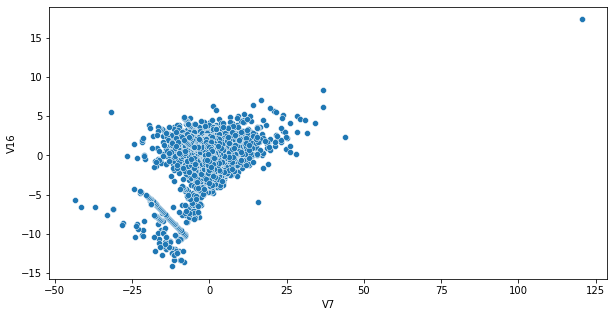

In [495]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V16"])

<AxesSubplot:xlabel='V8', ylabel='V16'>

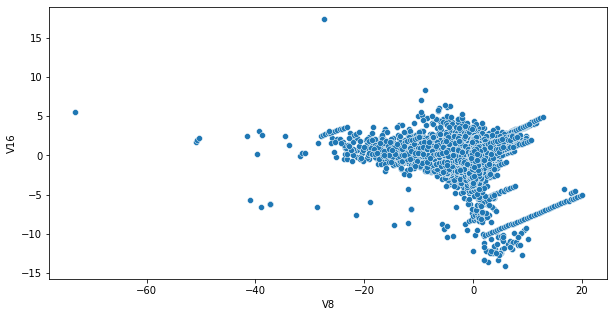

In [496]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V16"])

<AxesSubplot:xlabel='V9', ylabel='V16'>

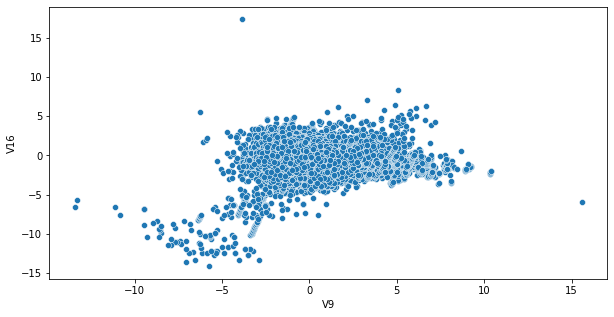

In [497]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V16"])

<AxesSubplot:xlabel='V10', ylabel='V16'>

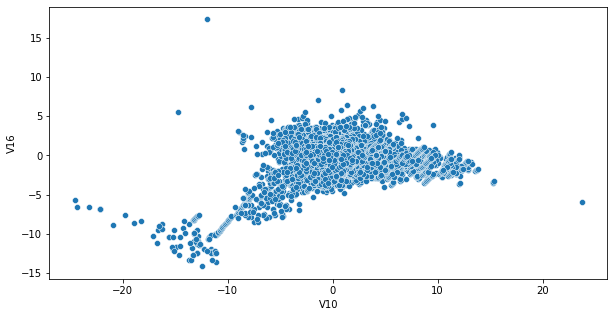

In [498]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V16"])

<AxesSubplot:xlabel='V11', ylabel='V16'>

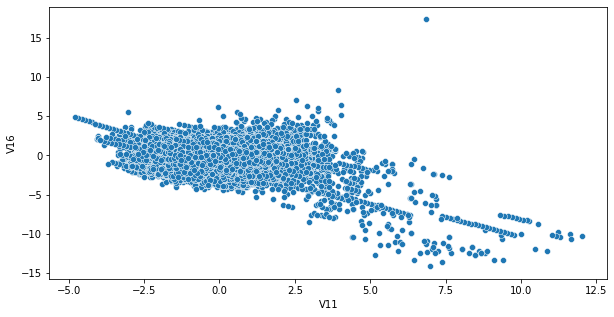

In [499]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V16"])

<AxesSubplot:xlabel='V12', ylabel='V16'>

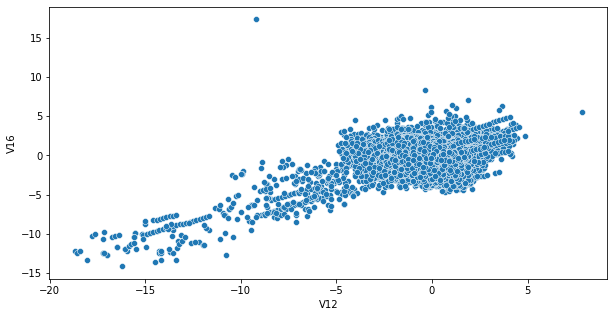

In [500]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V16"])

<AxesSubplot:xlabel='V13', ylabel='V16'>

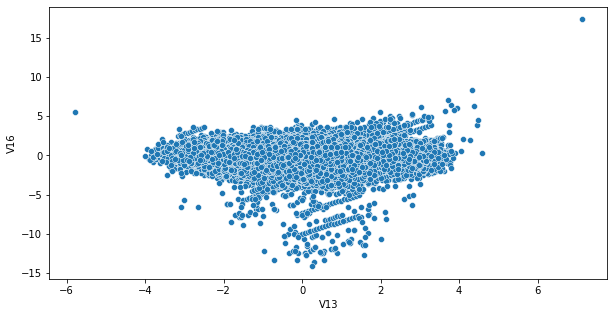

In [501]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V16"])

<AxesSubplot:xlabel='V14', ylabel='V16'>

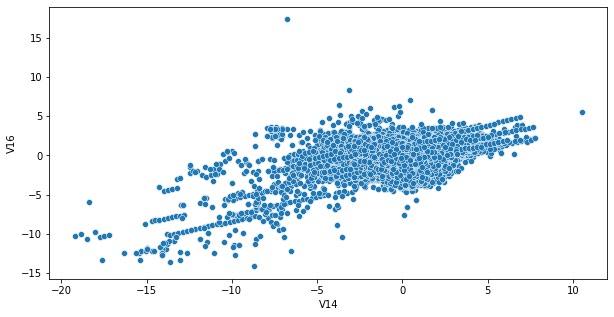

In [502]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V16"])

<AxesSubplot:xlabel='V15', ylabel='V16'>

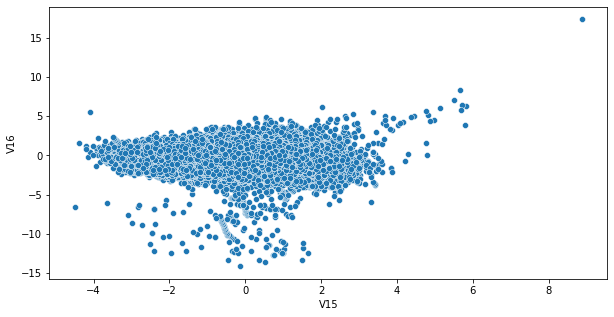

In [503]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V15"],df["V16"])

<AxesSubplot:xlabel='V1', ylabel='V15'>

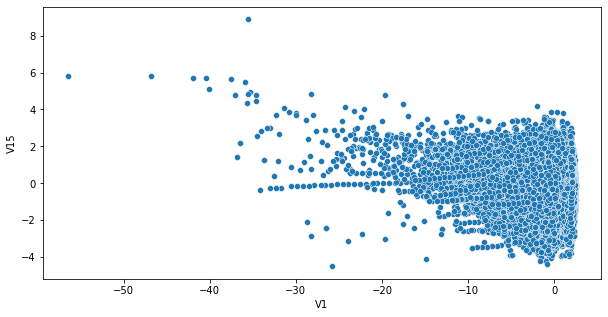

In [504]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V15"])

<AxesSubplot:xlabel='V2', ylabel='V15'>

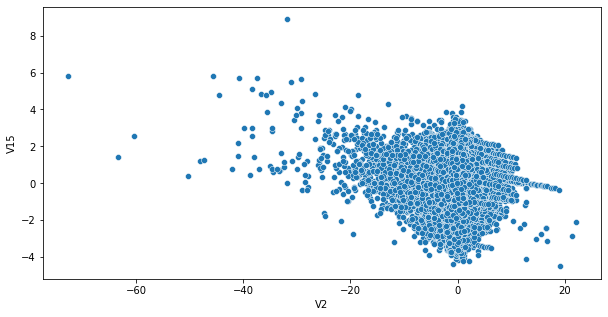

In [505]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V15"])

<AxesSubplot:xlabel='V3', ylabel='V15'>

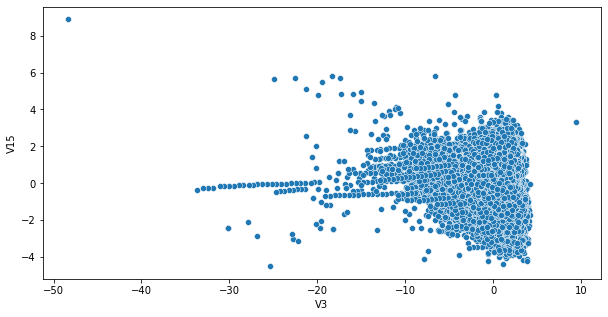

In [506]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V15"])

<AxesSubplot:xlabel='V4', ylabel='V15'>

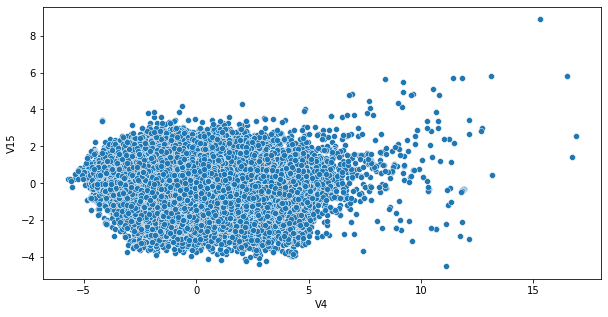

In [507]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V15"])

<AxesSubplot:xlabel='V5', ylabel='V15'>

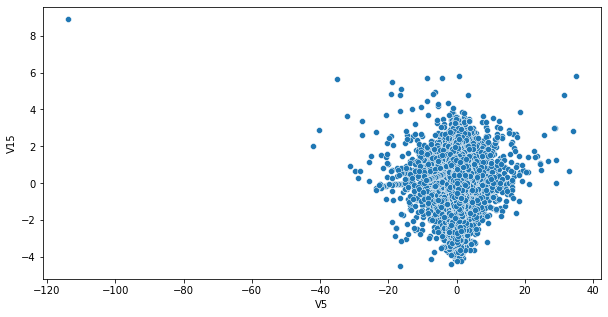

In [508]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V15"])

<AxesSubplot:xlabel='V6', ylabel='V15'>

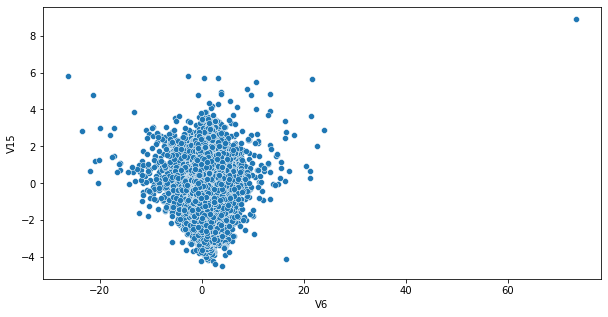

In [509]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V15"])

<AxesSubplot:xlabel='V7', ylabel='V15'>

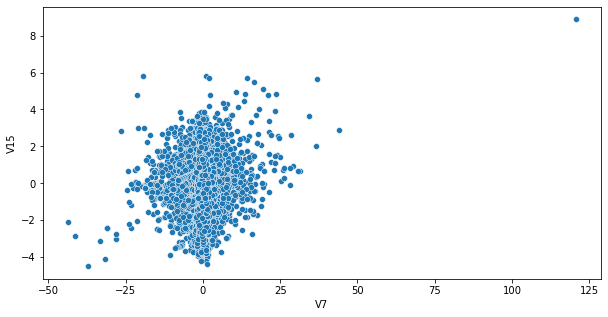

In [510]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V15"])

<AxesSubplot:xlabel='V8', ylabel='V15'>

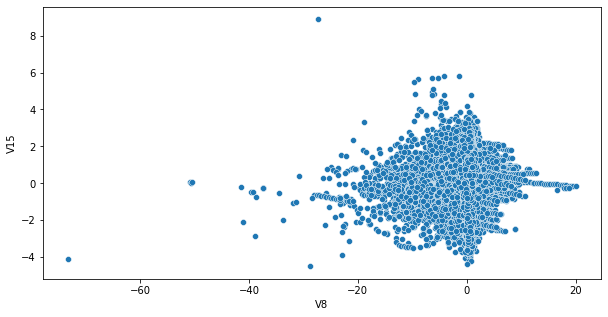

In [511]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V15"])

<AxesSubplot:xlabel='V9', ylabel='V15'>

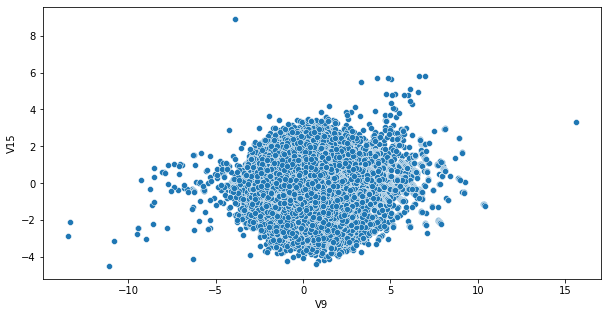

In [512]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V15"])

<AxesSubplot:xlabel='V10', ylabel='V15'>

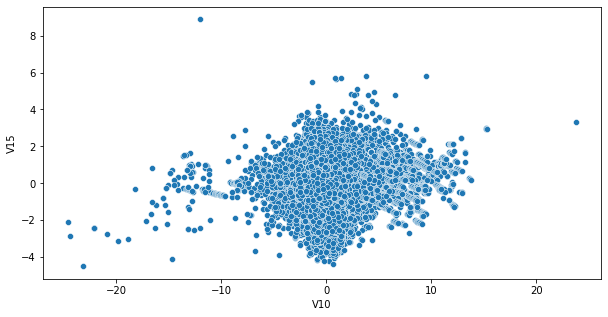

In [513]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V15"])

<AxesSubplot:xlabel='V11', ylabel='V15'>

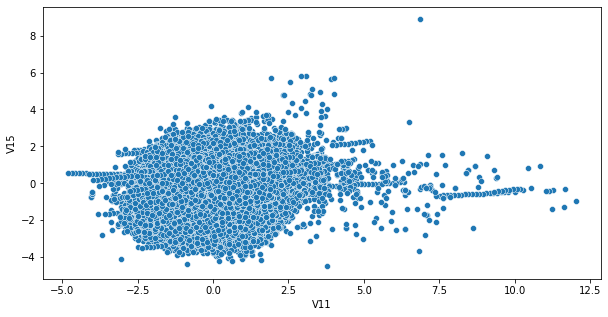

In [514]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V15"])

<AxesSubplot:xlabel='V12', ylabel='V15'>

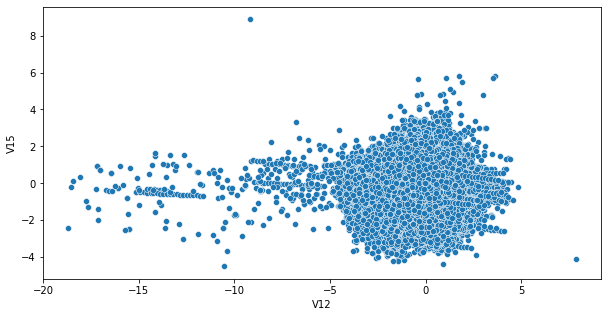

In [515]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V15"])

<AxesSubplot:xlabel='V13', ylabel='V15'>

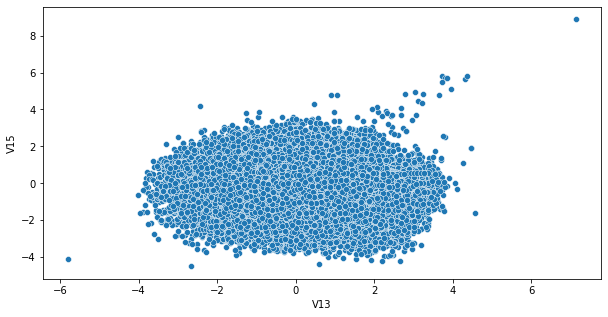

In [516]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V15"])

<AxesSubplot:xlabel='V14', ylabel='V15'>

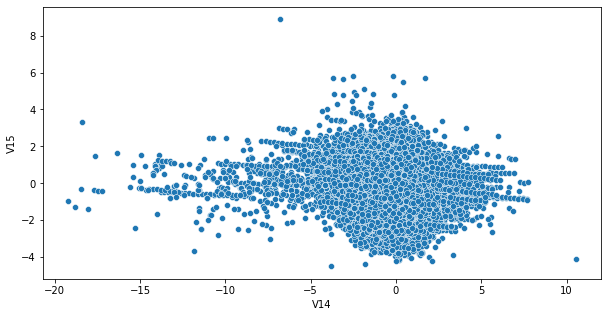

In [517]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V14"],df["V15"])

<AxesSubplot:xlabel='V1', ylabel='V14'>

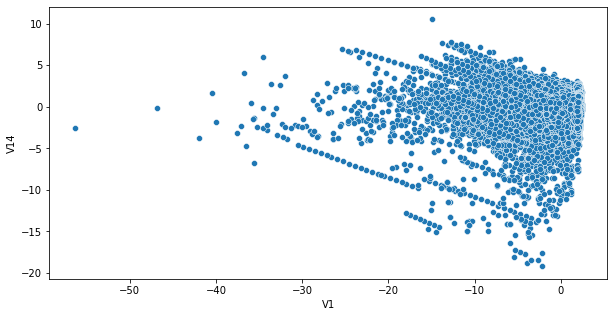

In [518]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V14"])

<AxesSubplot:xlabel='V2', ylabel='V14'>

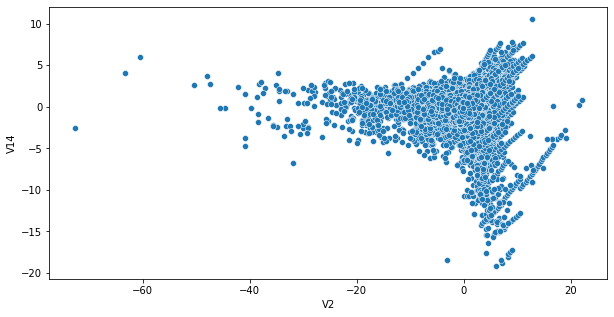

In [519]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V14"])

<AxesSubplot:xlabel='V3', ylabel='V14'>

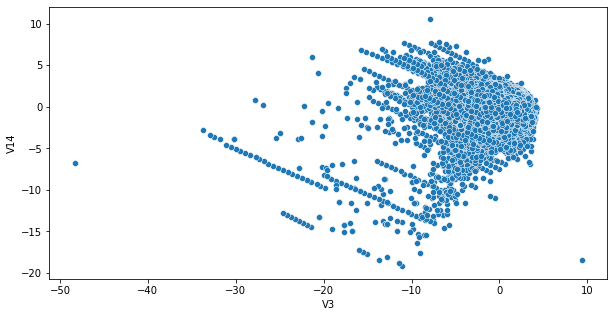

In [520]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V14"])

<AxesSubplot:xlabel='V4', ylabel='V14'>

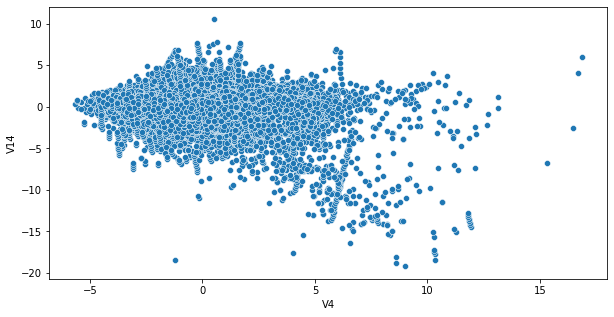

In [521]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V14"])

<AxesSubplot:xlabel='V5', ylabel='V14'>

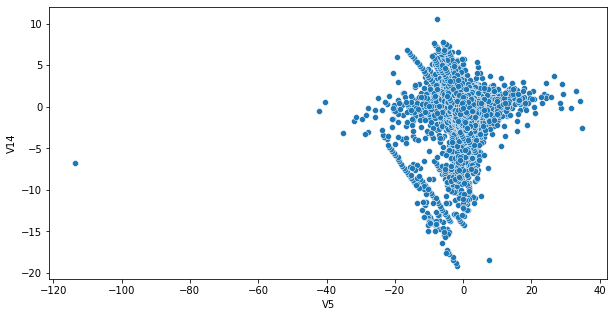

In [522]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V14"])

<AxesSubplot:xlabel='V6', ylabel='V14'>

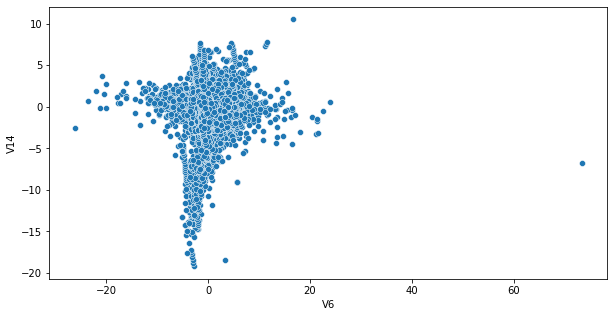

In [523]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V14"])

<AxesSubplot:xlabel='V7', ylabel='V14'>

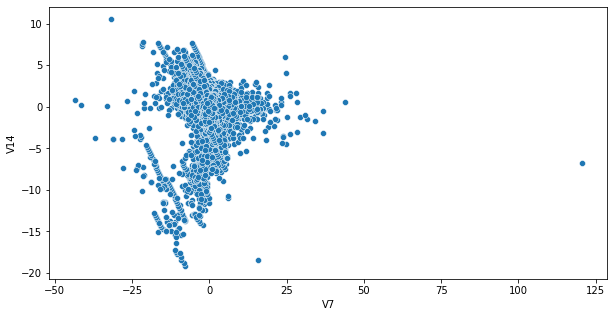

In [524]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V14"])

<AxesSubplot:xlabel='V8', ylabel='V14'>

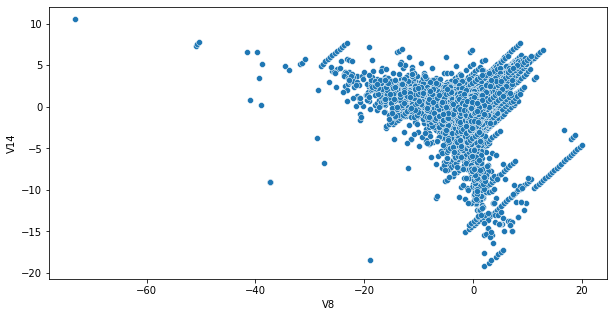

In [525]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V14"])

<AxesSubplot:xlabel='V9', ylabel='V14'>

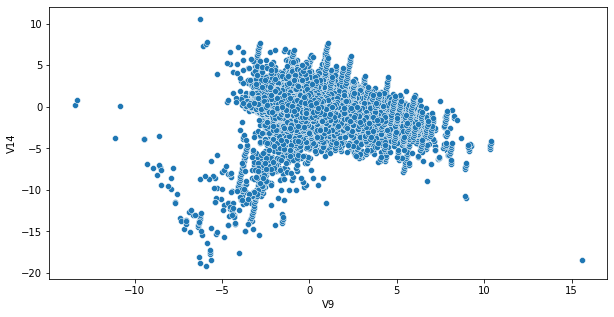

In [526]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V14"])

<AxesSubplot:xlabel='V10', ylabel='V14'>

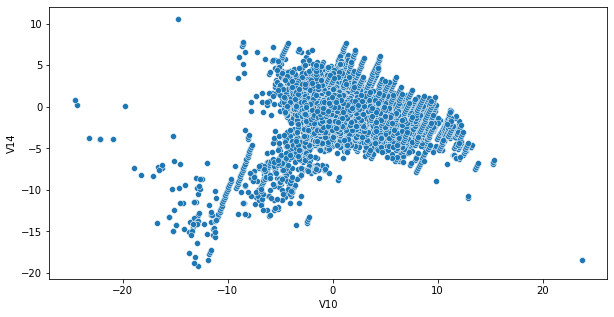

In [527]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V14"])

<AxesSubplot:xlabel='V11', ylabel='V14'>

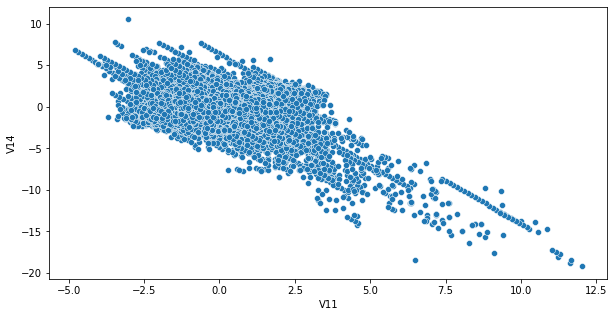

In [528]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V14"])

<AxesSubplot:xlabel='V12', ylabel='V14'>

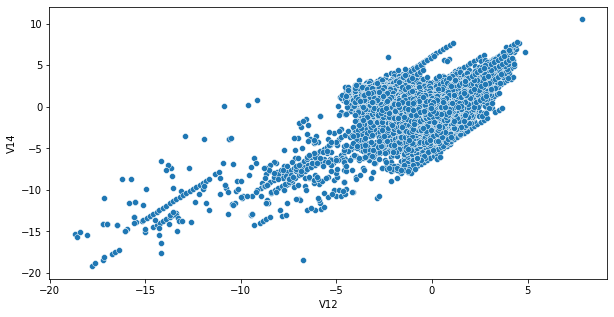

In [529]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V14"])

<AxesSubplot:xlabel='V13', ylabel='V14'>

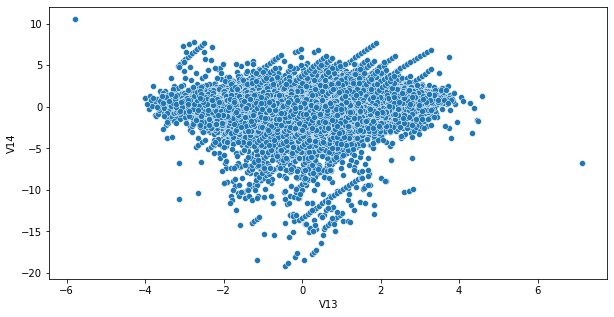

In [530]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V13"],df["V14"])

<AxesSubplot:xlabel='V1', ylabel='V13'>

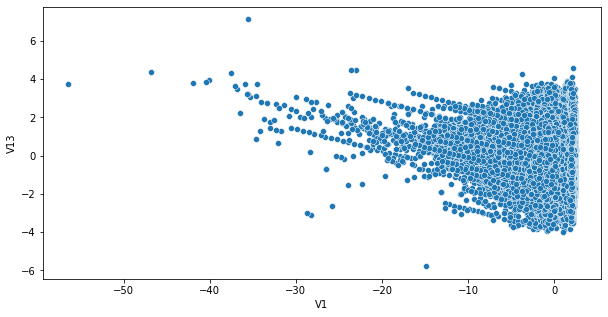

In [531]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V13"])

<AxesSubplot:xlabel='V2', ylabel='V13'>

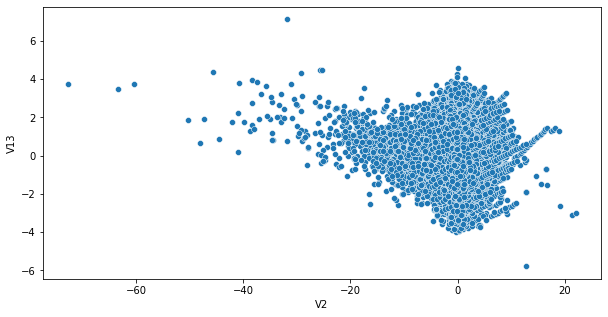

In [532]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V13"])

<AxesSubplot:xlabel='V3', ylabel='V13'>

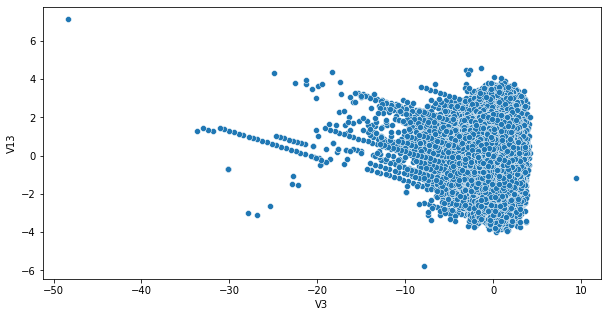

In [533]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V13"])

<AxesSubplot:xlabel='V4', ylabel='V13'>

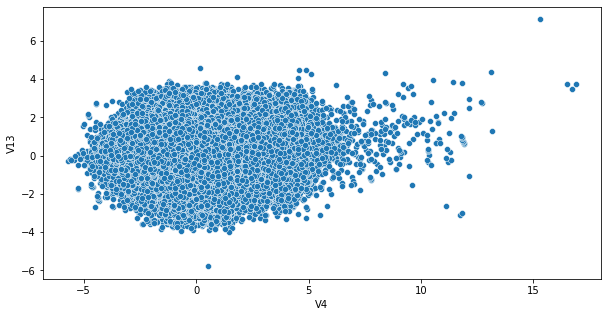

In [534]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V13"])

<AxesSubplot:xlabel='V5', ylabel='V13'>

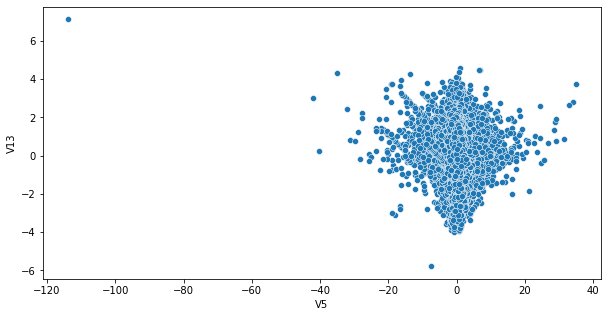

In [535]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V13"])

<AxesSubplot:xlabel='V6', ylabel='V13'>

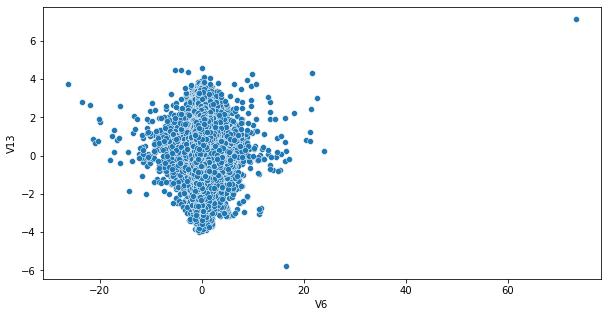

In [536]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V13"])

<AxesSubplot:xlabel='V7', ylabel='V13'>

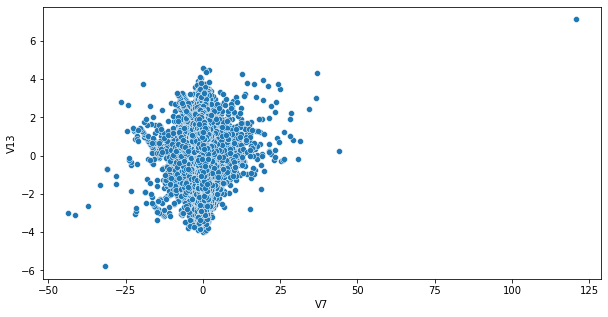

In [537]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V13"])

<AxesSubplot:xlabel='V8', ylabel='V13'>

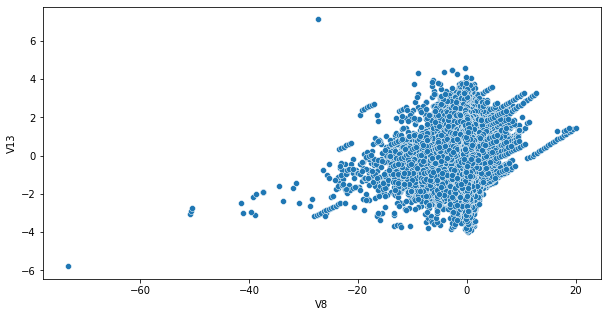

In [538]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V13"])

<AxesSubplot:xlabel='V9', ylabel='V13'>

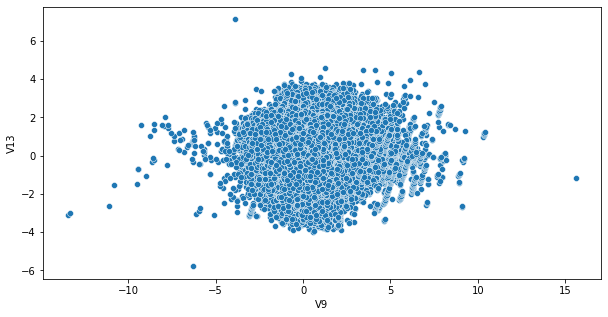

In [539]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V13"])

<AxesSubplot:xlabel='V10', ylabel='V13'>

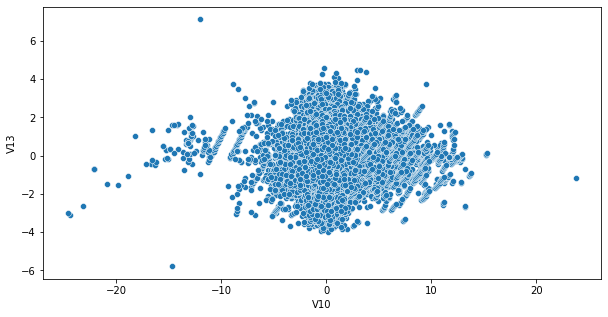

In [540]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V13"])

<AxesSubplot:xlabel='V11', ylabel='V13'>

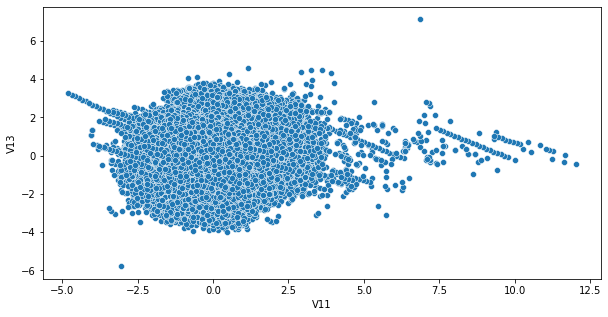

In [541]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V13"])

<AxesSubplot:xlabel='V12', ylabel='V13'>

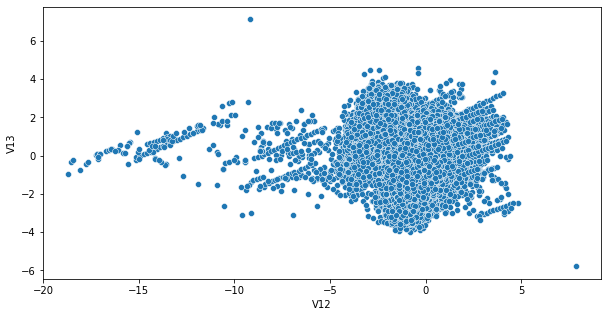

In [542]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V12"],df["V13"])

<AxesSubplot:xlabel='V1', ylabel='V12'>

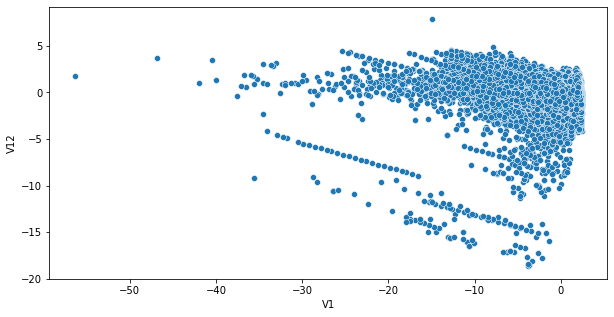

In [543]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V12"])

<AxesSubplot:xlabel='V2', ylabel='V12'>

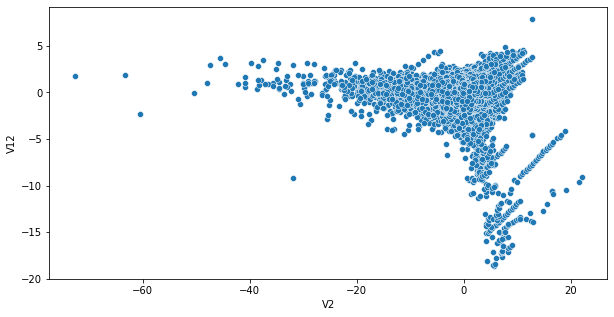

In [544]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V12"])

<AxesSubplot:xlabel='V3', ylabel='V12'>

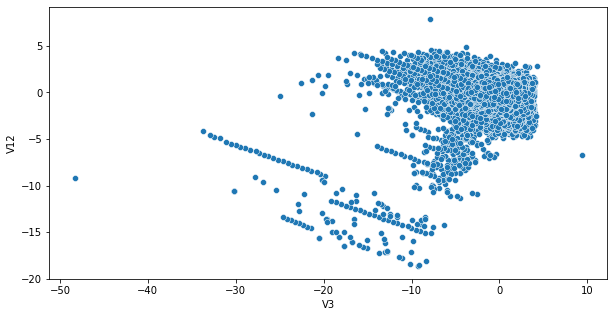

In [545]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V12"])

<AxesSubplot:xlabel='V4', ylabel='V12'>

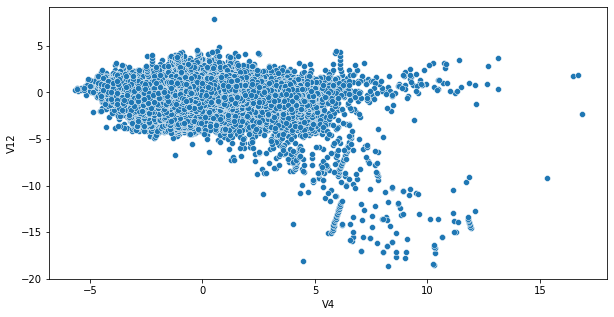

In [546]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V12"])

<AxesSubplot:xlabel='V5', ylabel='V12'>

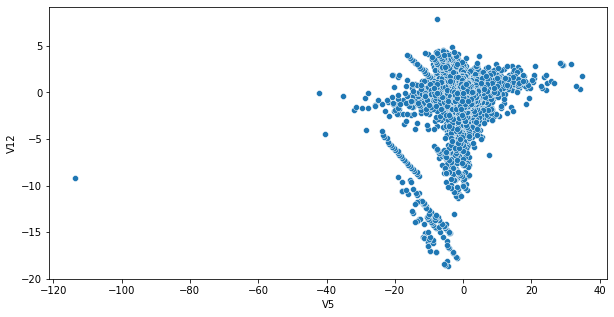

In [547]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V12"])

<AxesSubplot:xlabel='V6', ylabel='V12'>

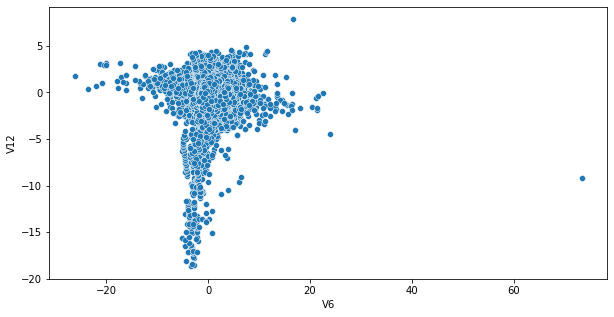

In [548]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V12"])

<AxesSubplot:xlabel='V7', ylabel='V12'>

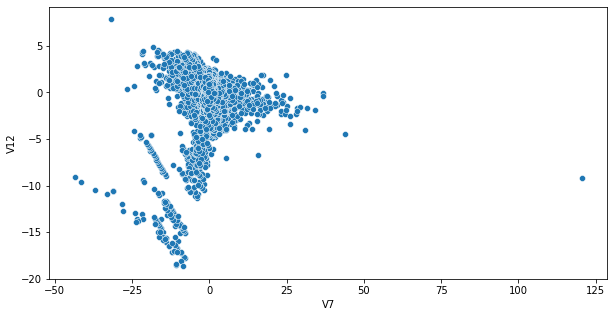

In [549]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V12"])

<AxesSubplot:xlabel='V8', ylabel='V12'>

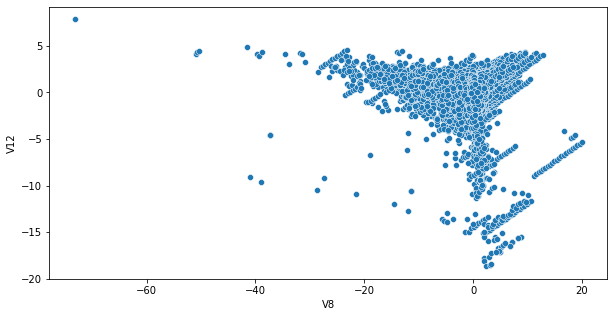

In [550]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V12"])

<AxesSubplot:xlabel='V9', ylabel='V12'>

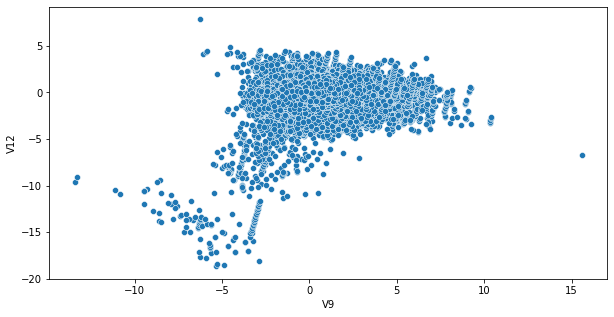

In [551]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V12"])

<AxesSubplot:xlabel='V10', ylabel='V12'>

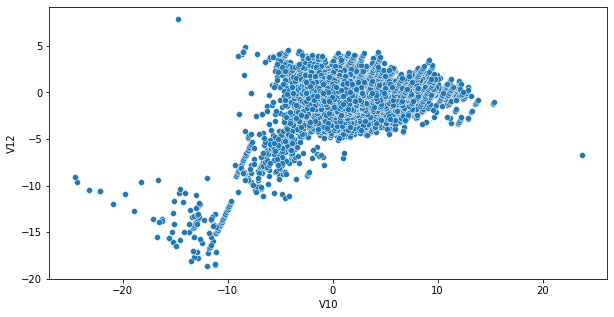

In [552]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V12"])

<AxesSubplot:xlabel='V11', ylabel='V12'>

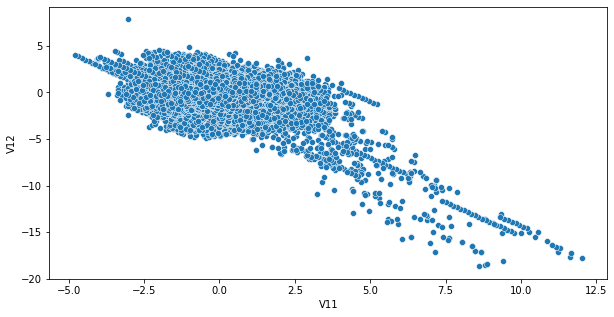

In [553]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V11"],df["V12"])

<AxesSubplot:xlabel='V1', ylabel='V11'>

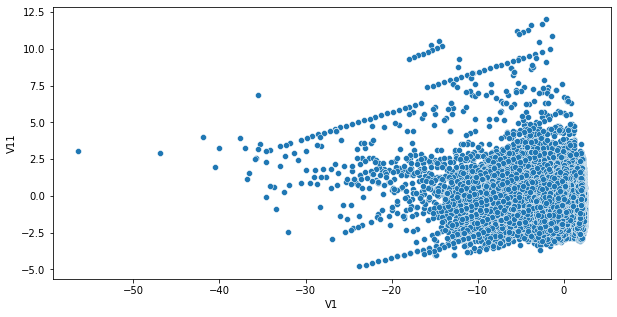

In [554]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V11"])

<AxesSubplot:xlabel='V2', ylabel='V11'>

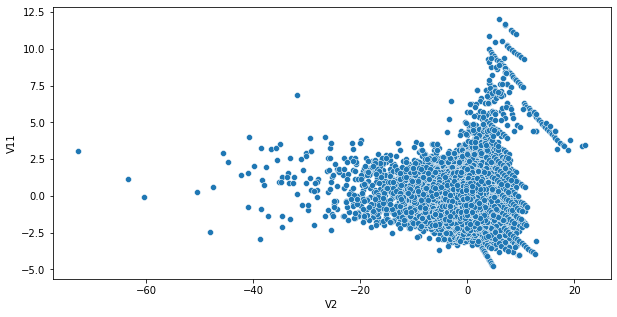

In [555]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V11"])

<AxesSubplot:xlabel='V3', ylabel='V11'>

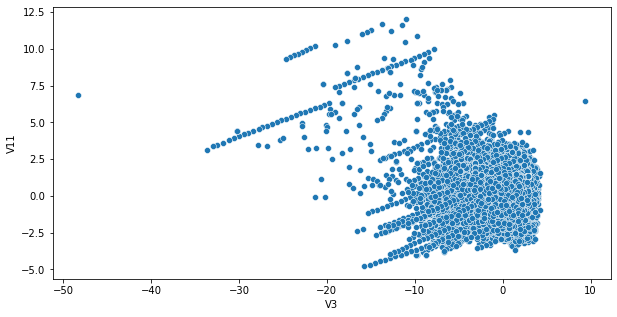

In [556]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V11"])

<AxesSubplot:xlabel='V4', ylabel='V11'>

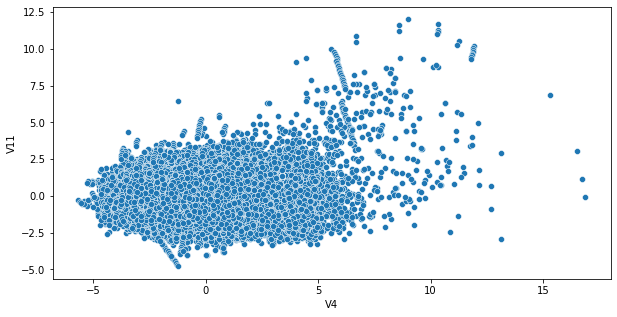

In [557]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V11"])

<AxesSubplot:xlabel='V5', ylabel='V11'>

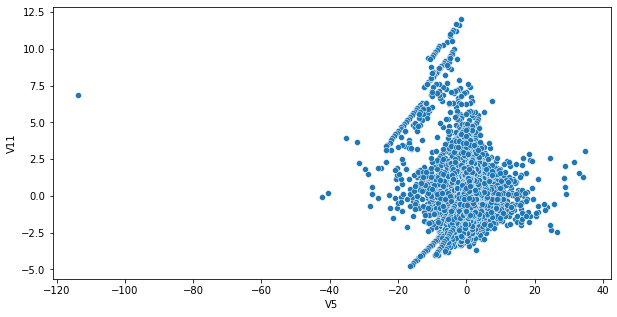

In [558]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V11"])

<AxesSubplot:xlabel='V6', ylabel='V11'>

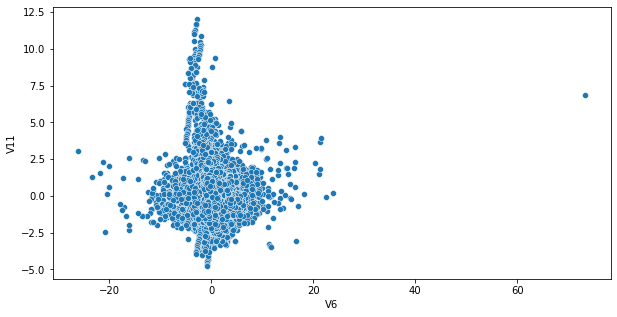

In [559]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V11"])

<AxesSubplot:xlabel='V7', ylabel='V11'>

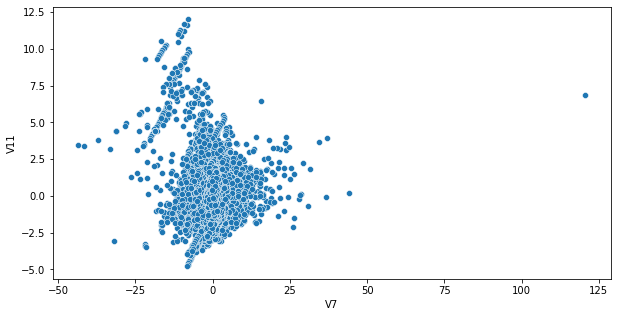

In [560]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V11"])

<AxesSubplot:xlabel='V8', ylabel='V11'>

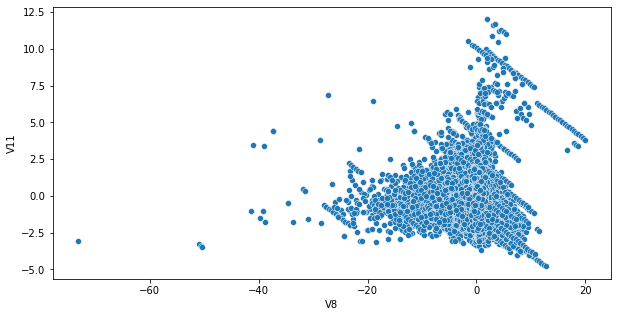

In [561]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V11"])

<AxesSubplot:xlabel='V9', ylabel='V11'>

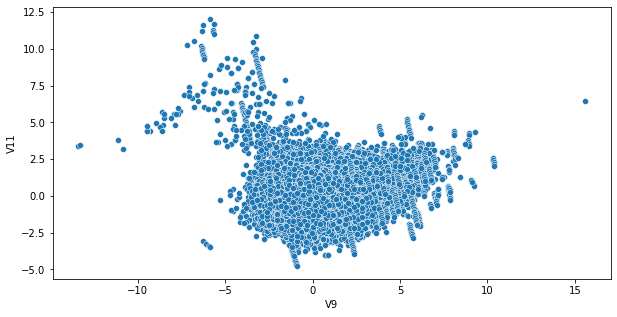

In [562]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V11"])

<AxesSubplot:xlabel='V10', ylabel='V11'>

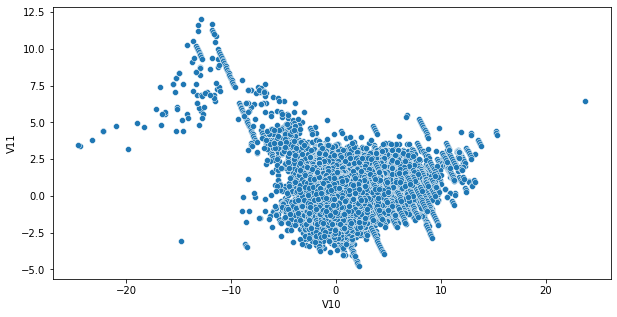

In [563]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V10"],df["V11"])

<AxesSubplot:xlabel='V1', ylabel='V10'>

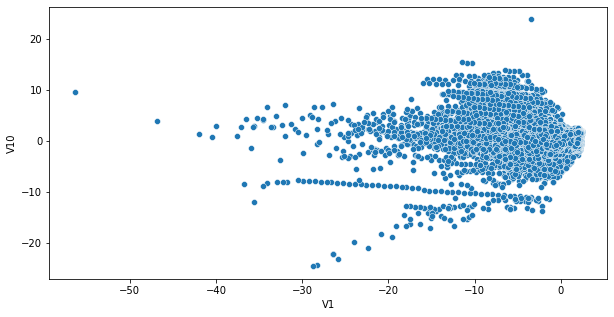

In [564]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V10"])

<AxesSubplot:xlabel='V2', ylabel='V10'>

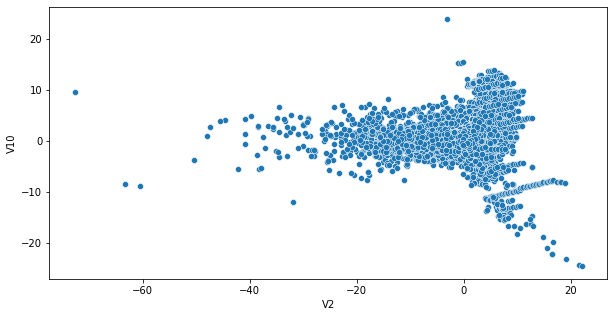

In [565]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V10"])

<AxesSubplot:xlabel='V3', ylabel='V10'>

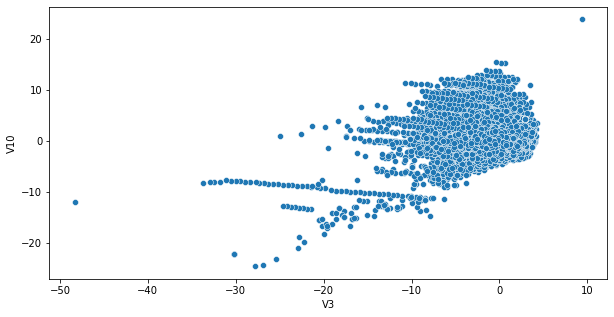

In [566]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V10"])

<AxesSubplot:xlabel='V4', ylabel='V10'>

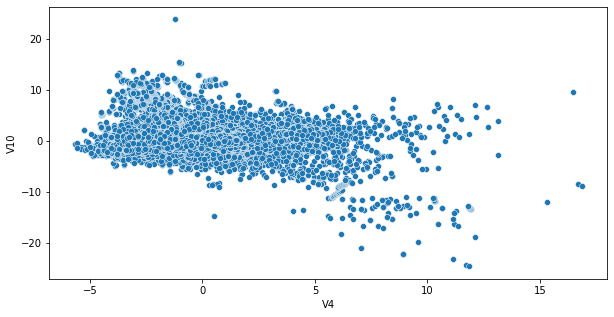

In [567]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V10"])

<AxesSubplot:xlabel='V5', ylabel='V10'>

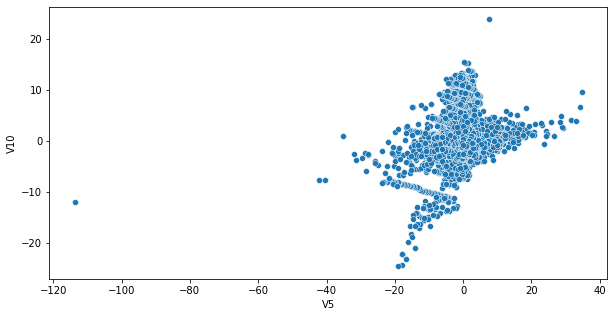

In [568]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V10"])

<AxesSubplot:xlabel='V6', ylabel='V10'>

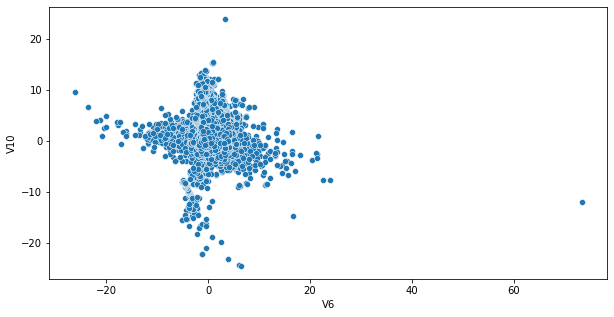

In [569]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V10"])

<AxesSubplot:xlabel='V7', ylabel='V10'>

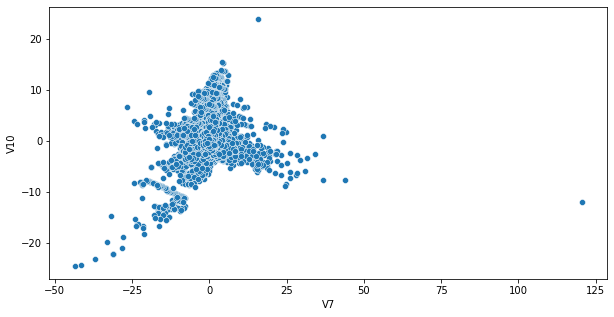

In [570]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V10"])

<AxesSubplot:xlabel='V8', ylabel='V10'>

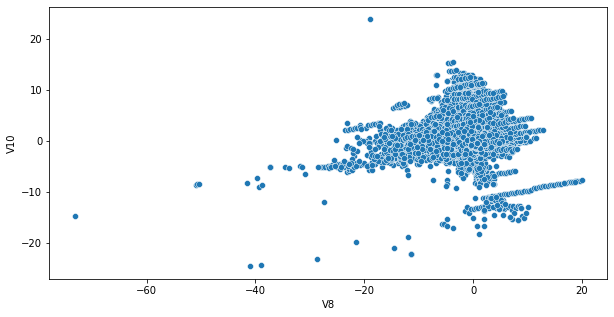

In [571]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V10"])

<AxesSubplot:xlabel='V9', ylabel='V10'>

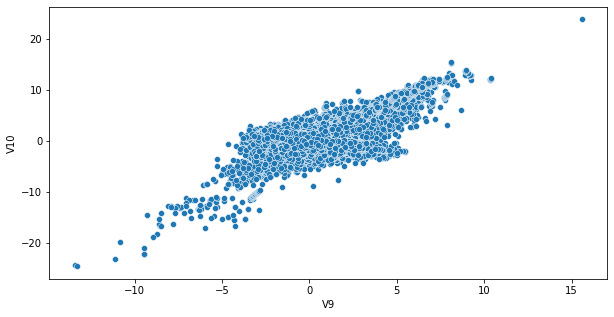

In [572]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V9"],df["V10"])

<AxesSubplot:xlabel='V1', ylabel='V9'>

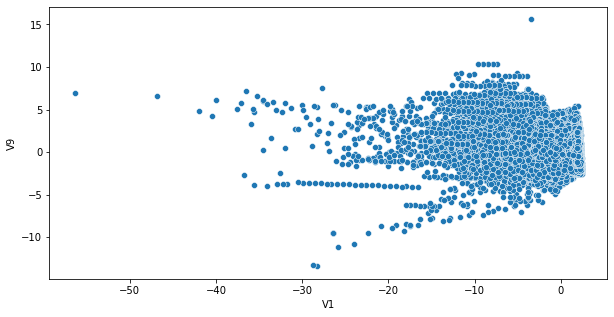

In [573]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V9"])

<AxesSubplot:xlabel='V1', ylabel='V9'>

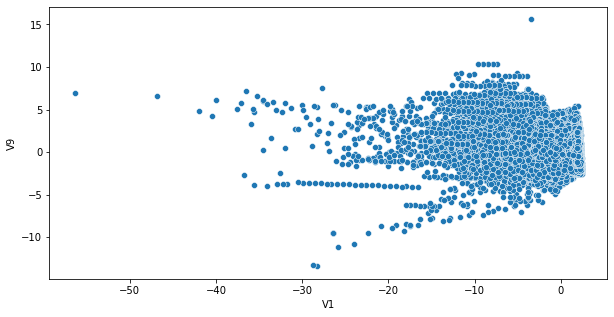

In [574]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V9"])

<AxesSubplot:xlabel='V2', ylabel='V9'>

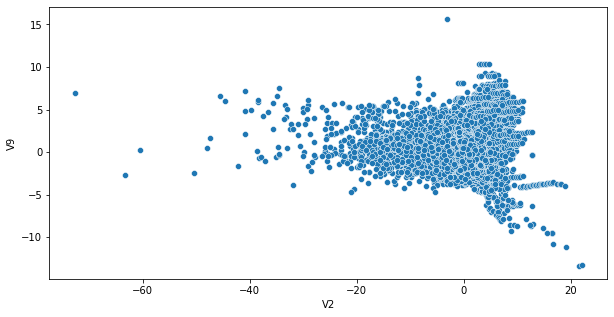

In [575]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V9"])

<AxesSubplot:xlabel='V3', ylabel='V9'>

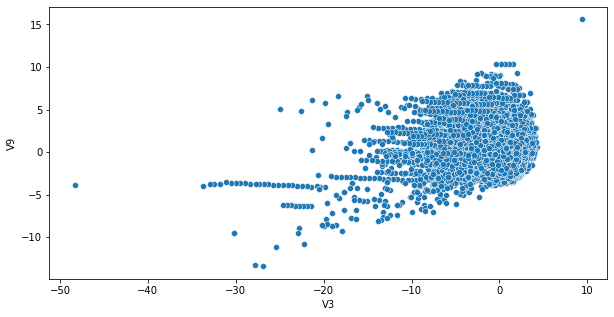

In [576]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V9"])

<AxesSubplot:xlabel='V4', ylabel='V9'>

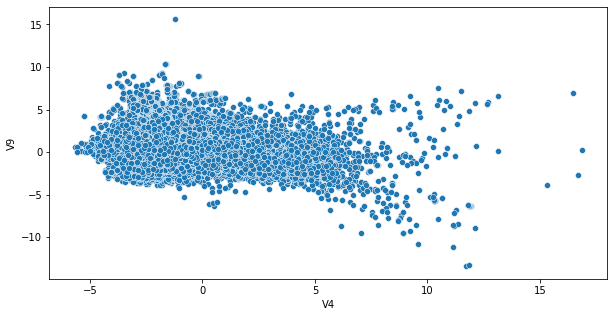

In [577]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V9"])

<AxesSubplot:xlabel='V5', ylabel='V9'>

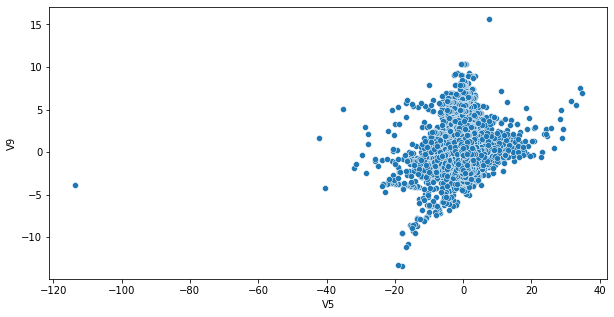

In [578]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V9"])

<AxesSubplot:xlabel='V6', ylabel='V9'>

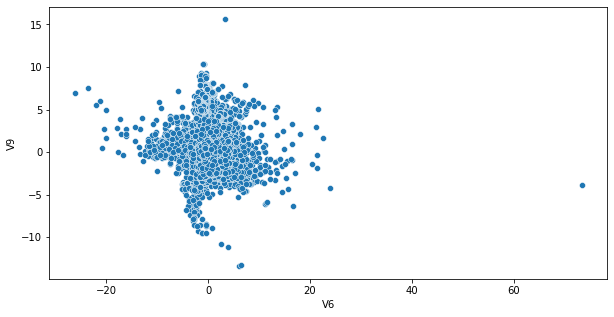

In [579]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V9"])

<AxesSubplot:xlabel='V7', ylabel='V9'>

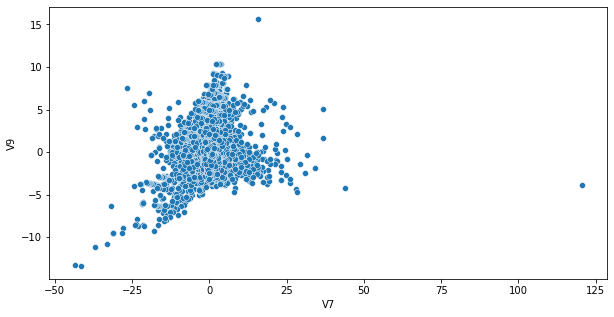

In [580]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V9"])

<AxesSubplot:xlabel='V8', ylabel='V9'>

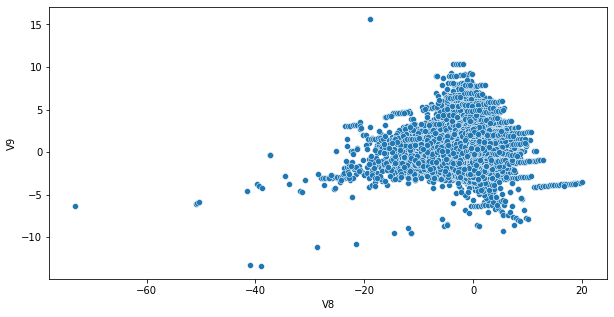

In [581]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V8"],df["V9"])

<AxesSubplot:xlabel='V1', ylabel='V8'>

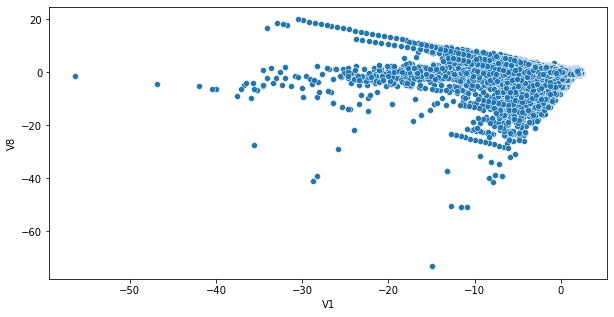

In [582]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V8"])

<AxesSubplot:xlabel='V2', ylabel='V8'>

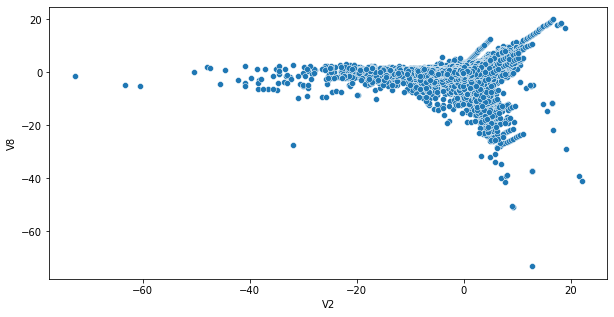

In [583]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V8"])

<AxesSubplot:xlabel='V3', ylabel='V8'>

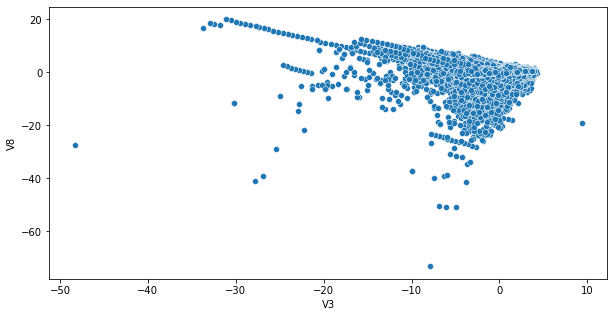

In [584]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V8"])

<AxesSubplot:xlabel='V4', ylabel='V8'>

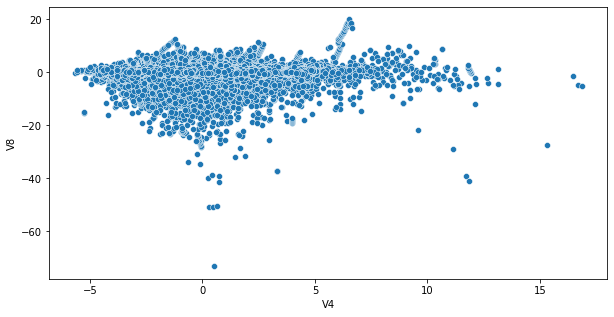

In [585]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V8"])

<AxesSubplot:xlabel='V5', ylabel='V8'>

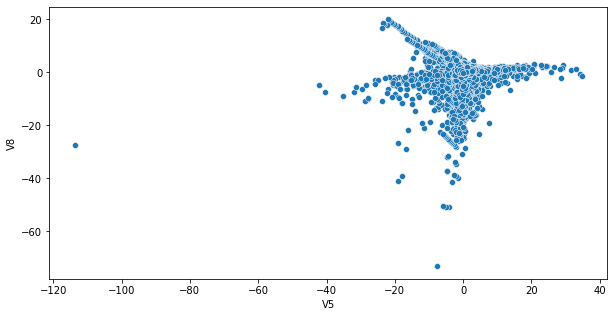

In [586]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V8"])

<AxesSubplot:xlabel='V6', ylabel='V8'>

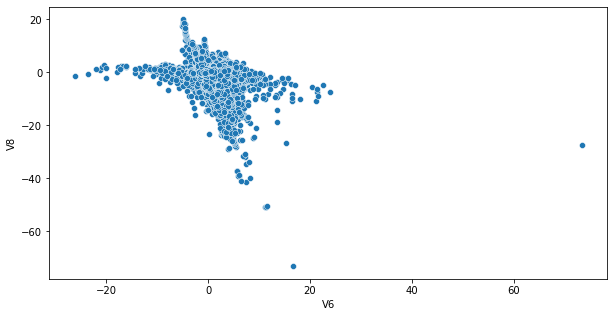

In [587]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V8"])

<AxesSubplot:xlabel='V7', ylabel='V8'>

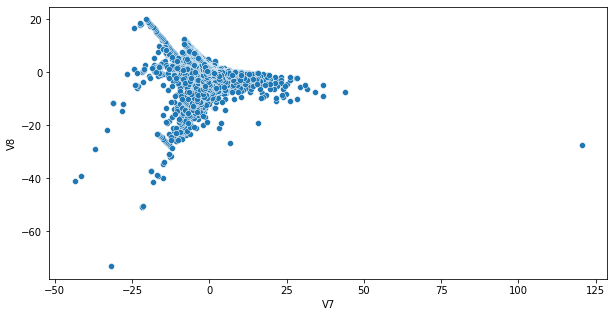

In [588]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V7"],df["V8"])

<AxesSubplot:xlabel='V1', ylabel='V7'>

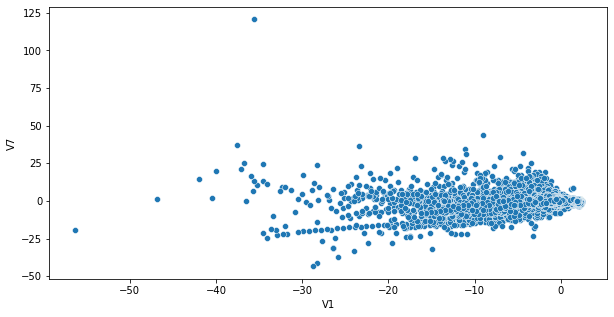

In [589]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V7"])

<AxesSubplot:xlabel='V2', ylabel='V7'>

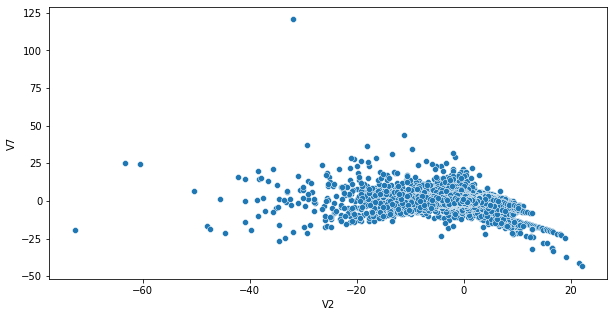

In [590]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V7"])

<AxesSubplot:xlabel='V3', ylabel='V7'>

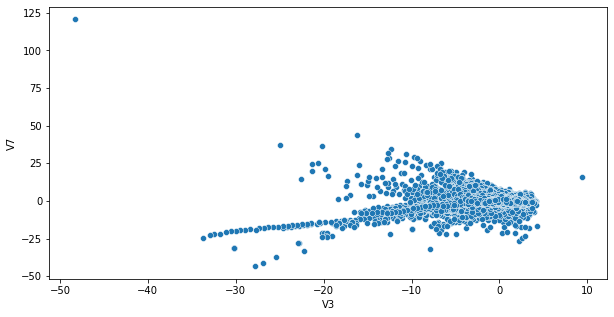

In [591]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V7"])

<AxesSubplot:xlabel='V4', ylabel='V7'>

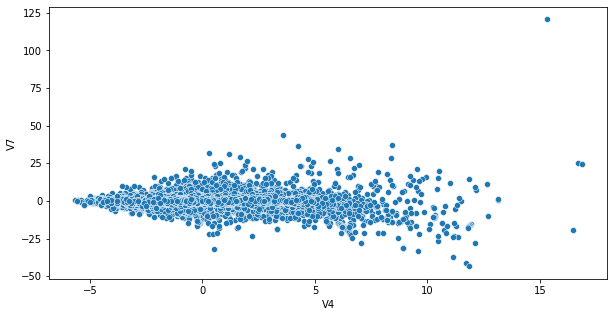

In [592]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V7"])

<AxesSubplot:xlabel='V5', ylabel='V7'>

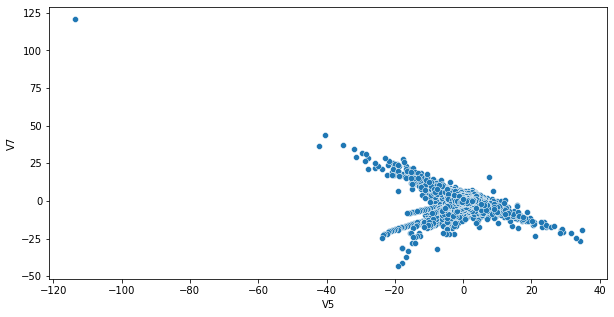

In [593]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V7"])

<AxesSubplot:xlabel='V6', ylabel='V7'>

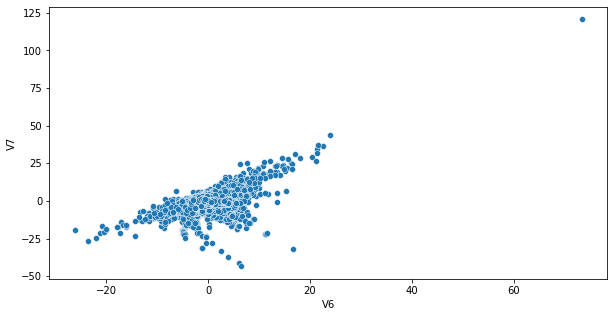

In [594]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V6"],df["V7"])

<AxesSubplot:xlabel='V1', ylabel='V6'>

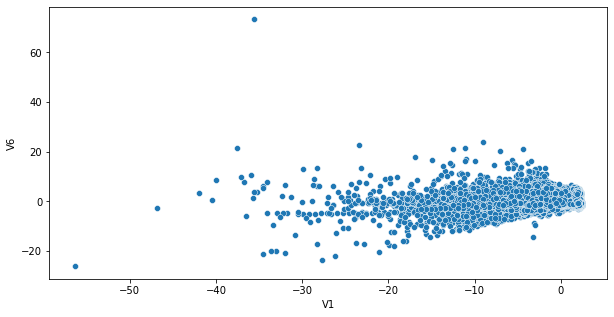

In [595]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V6"])

<AxesSubplot:xlabel='V2', ylabel='V6'>

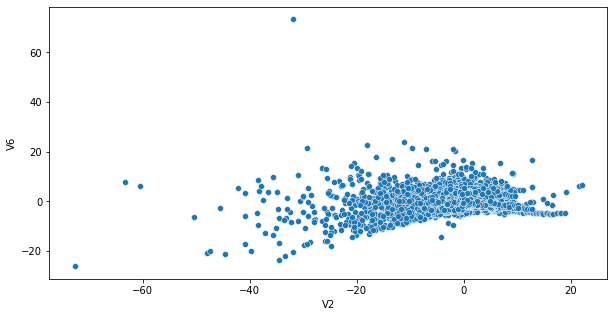

In [596]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V6"])

<AxesSubplot:xlabel='V3', ylabel='V6'>

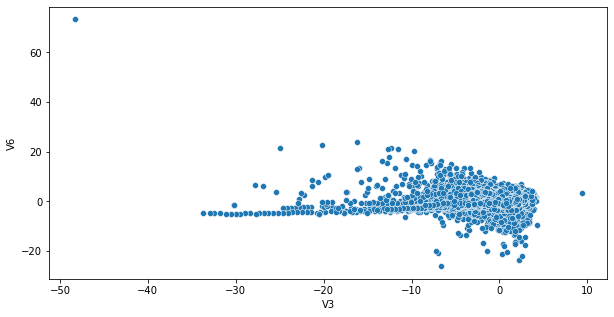

In [597]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V6"])

<AxesSubplot:xlabel='V4', ylabel='V6'>

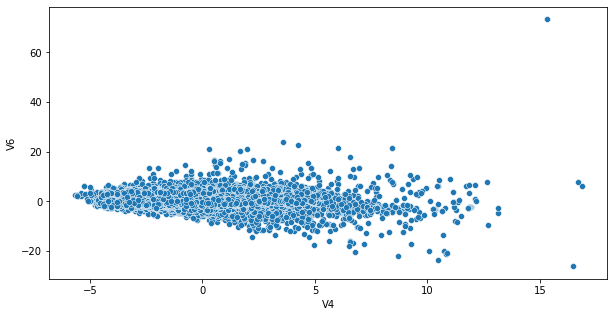

In [598]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V6"])

<AxesSubplot:xlabel='V5', ylabel='V6'>

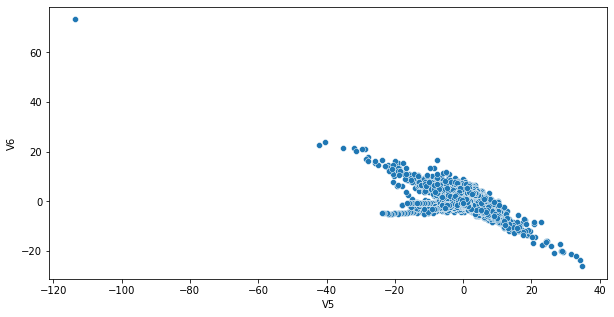

In [599]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V5"],df["V6"])

<AxesSubplot:xlabel='V1', ylabel='V5'>

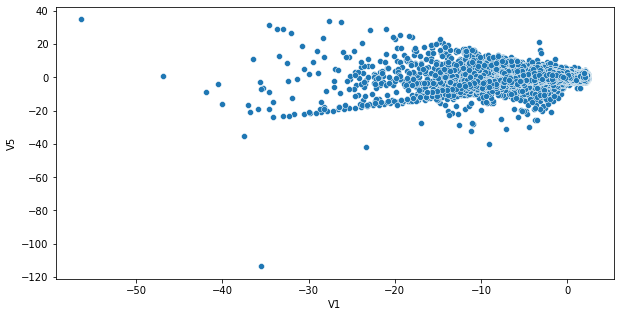

In [600]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V5"])

<AxesSubplot:xlabel='V2', ylabel='V5'>

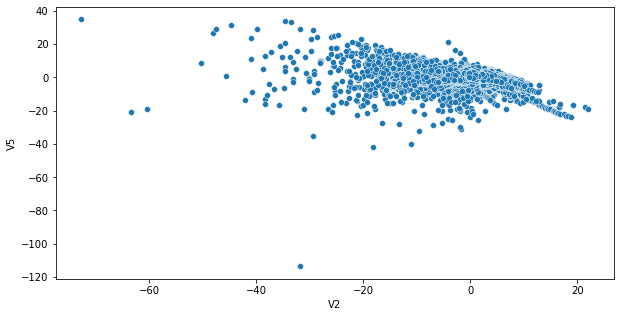

In [601]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V5"])

<AxesSubplot:xlabel='V3', ylabel='V5'>

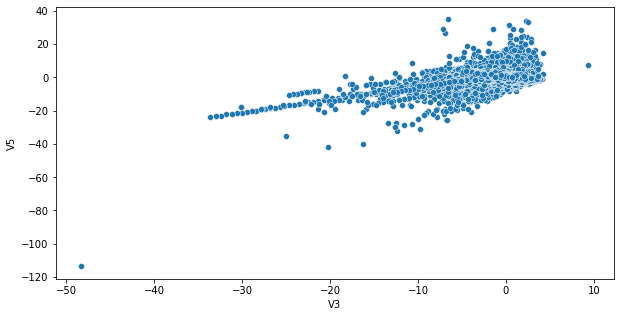

In [602]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V5"])

<AxesSubplot:xlabel='V4', ylabel='V5'>

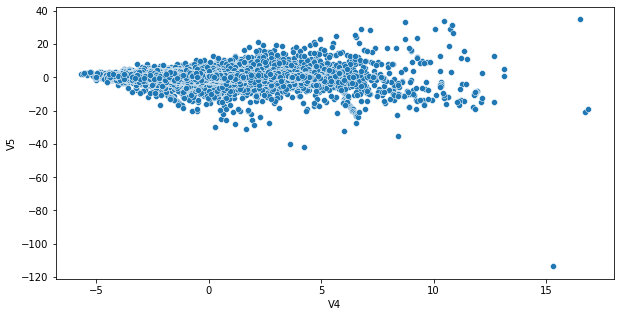

In [603]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V4"],df["V5"])

<AxesSubplot:xlabel='V1', ylabel='V4'>

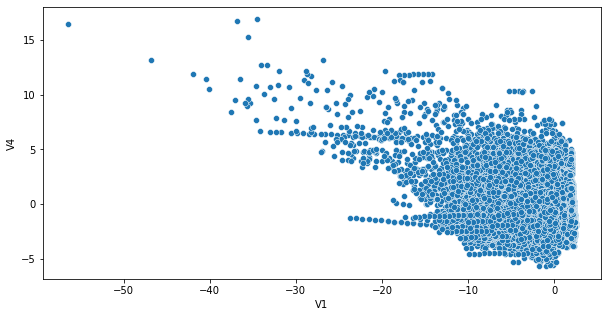

In [604]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V4"])

<AxesSubplot:xlabel='V2', ylabel='V4'>

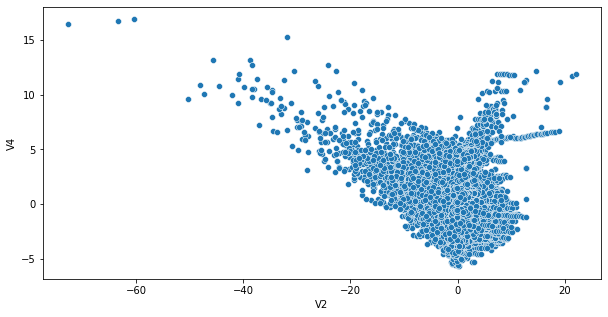

In [605]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V4"])

<AxesSubplot:xlabel='V3', ylabel='V4'>

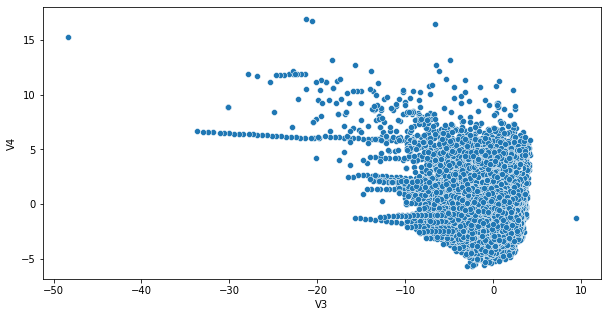

In [606]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V3"],df["V4"])

<AxesSubplot:xlabel='V1', ylabel='V3'>

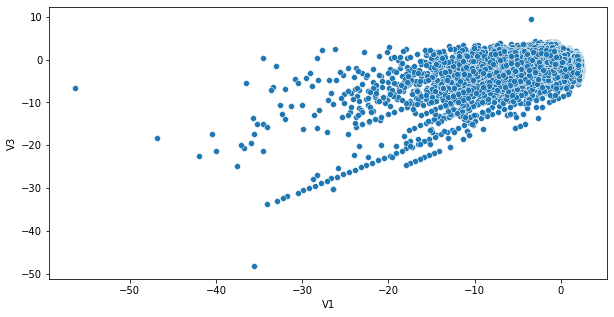

In [607]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V3"])

<AxesSubplot:xlabel='V2', ylabel='V3'>

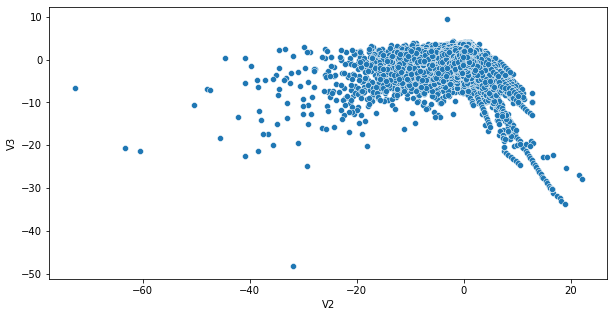

In [608]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V2"],df["V3"])

<AxesSubplot:xlabel='V1', ylabel='V2'>

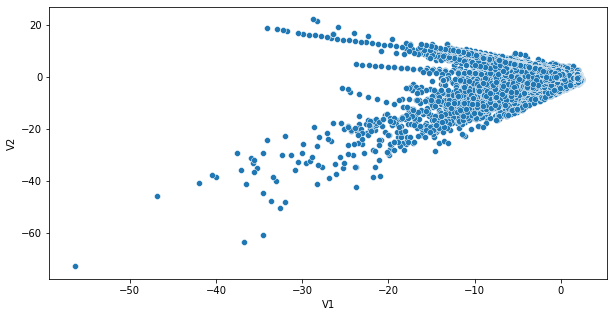

In [609]:
plt.figure(figsize=(10,5))
sns.scatterplot(df["V1"],df["V2"])

In [610]:
df.corr()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
Time,1.000000,1.173963e-01,-1.059333e-02,-4.196182e-01,-1.052602e-01,1.730721e-01,-6.301647e-02,8.471437e-02,-3.694943e-02,-8.660434e-03,3.061663e-02,-2.476894e-01,1.243481e-01,-6.590202e-02,-9.875682e-02,-1.834533e-01,1.190287e-02,-7.329721e-02,9.043813e-02,2.897530e-02,-5.086602e-02,4.473573e-02,1.440591e-01,5.114236e-02,-1.618187e-02,-2.330828e-01,-4.140710e-02,-5.134591e-03,-9.412688e-03,-0.010596,-0.012323
V1,0.117396,1.000000e+00,4.135835e-16,-1.227819e-15,-9.215150e-16,1.812612e-17,-6.506567e-16,-1.005191e-15,-2.433822e-16,-1.513678e-16,7.388135e-17,2.125498e-16,2.053457e-16,-2.425603e-17,-5.020280e-16,3.547782e-16,7.212815e-17,-3.879840e-16,3.230206e-17,1.502024e-16,4.654551e-16,-2.457409e-16,-4.290944e-16,6.168652e-16,-4.425156e-17,-9.605737e-16,-1.581290e-17,1.198124e-16,2.083082e-15,-0.227709,-0.101347
V2,-0.010593,4.135835e-16,1.000000e+00,3.243764e-16,-1.121065e-15,5.157519e-16,2.787346e-16,2.055934e-16,-5.377041e-17,1.978488e-17,-3.991394e-16,1.975426e-16,-9.568710e-17,6.295388e-16,-1.730566e-16,-4.995814e-17,1.177316e-17,-2.685296e-16,3.284605e-16,-7.118719e-18,2.506675e-16,-8.480447e-17,1.526333e-16,1.634231e-16,1.247925e-17,-4.478846e-16,2.057310e-16,-4.966953e-16,-5.093836e-16,-0.531409,0.091289
V3,-0.419618,-1.227819e-15,3.243764e-16,1.000000e+00,4.711293e-16,-6.539009e-17,1.627627e-15,4.895305e-16,-1.268779e-15,5.568367e-16,1.156587e-15,1.576830e-15,6.310231e-16,2.807652e-16,4.739859e-16,9.068793e-16,8.299445e-16,7.614712e-16,1.509897e-16,3.463522e-16,-9.316409e-16,5.706192e-17,-1.133902e-15,-4.983035e-16,2.686834e-19,-1.104734e-15,-1.238062e-16,1.045747e-15,9.775546e-16,-0.210880,-0.192961
V4,-0.105260,-9.215150e-16,-1.121065e-15,4.711293e-16,1.000000e+00,-1.719944e-15,-7.491959e-16,-4.104503e-16,5.697192e-16,6.923247e-16,2.232685e-16,3.459380e-16,-5.625518e-16,1.303306e-16,2.282280e-16,1.377649e-16,-9.614528e-16,-2.699612e-16,-5.103644e-16,-3.980557e-16,-1.857247e-16,-1.949553e-16,-6.276051e-17,9.164206e-17,1.584638e-16,6.070716e-16,-4.247268e-16,3.977061e-17,-2.761403e-18,0.098732,0.133447
V5,0.173072,1.812612e-17,5.157519e-16,-6.539009e-17,-1.719944e-15,1.000000e+00,2.408382e-16,2.715541e-16,7.437229e-16,7.391702e-16,-5.202306e-16,7.203963e-16,7.412552e-16,5.886991e-16,6.565143e-16,-8.720275e-16,2.246261e-15,1.281914e-16,5.308590e-16,-1.450421e-16,-3.554057e-16,-3.920976e-16,1.253751e-16,-8.428683e-18,-1.149255e-15,4.808532e-16,4.319541e-16,6.590482e-16,-5.613951e-18,-0.386356,-0.094974
V6,-0.063016,-6.506567e-16,2.787346e-16,1.627627e-15,-7.491959e-16,2.408382e-16,1.000000e+00,1.191668e-16,-1.104219e-16,4.131207e-16,5.932243e-17,1.980503e-15,2.375468e-16,-1.211182e-16,2.621312e-16,-1.531188e-15,2.623672e-18,2.015618e-16,1.223814e-16,-1.865597e-16,-1.858755e-16,5.833316e-17,-4.705235e-19,1.046712e-16,-1.071589e-15,4.562861e-16,-1.357067e-16,-4.452461e-16,2.594754e-16,0.215981,-0.043643
V7,0.084714,-1.005191e-15,2.055934e-16,4.895305e-16,-4.104503e-16,2.715541e-16,1.191668e-16,1.000000e+00,3.344412e-16,1.122501e-15,-7.492834e-17,1.425248e-16,-3.536655e-18,1.266462e-17,2.607772e-16,-1.690540e-16,5.869302e-17,2.177192e-16,7.604126e-17,-1.881008e-16,9.379684e-16,-2.027779e-16,-8.898922e-16,-4.387401e-16,7.434913e-18,-3.094082e-16,-9.657637e-16,-1.782106e-15,-2.776530e-16,0.397311,-0.187257
V8,-0.036949,-2.433822e-16,-5.377041e-17,-1.268779e-15,5.697192e-16,7.437229e-16,-1.104219e-16,3.344412e-16,1.000000e+00,4.356078e-16,-2.801370e-16,2.487043e-16,1.839891e-16,-2.921856e-16,-8.599156e-16,4.127777e-16,-5.254741e-16,-2.269549e-16,-3.667974e-16,-3.875186e-16,2.033737e-16,3.892798e-16,2.026927e-16,6.377260e-17,-1.047097e-16,-4.653279e-16,-1.727276e-16,1.299943e-16,-6.200930e-16,-0.103079,0.019875
V9,-0.008660,-1.513678e-16,1.978488e-17,5.568367e-16,6.923247e-16,7.391702e-16,4.131207e-16,1.122501e-15,4.356078e-16,1.000000e+00,-4.642274e-16,1.354680e-16,-1.079314e-15,2.251072e-15,3.784757e-15,

<AxesSubplot:>

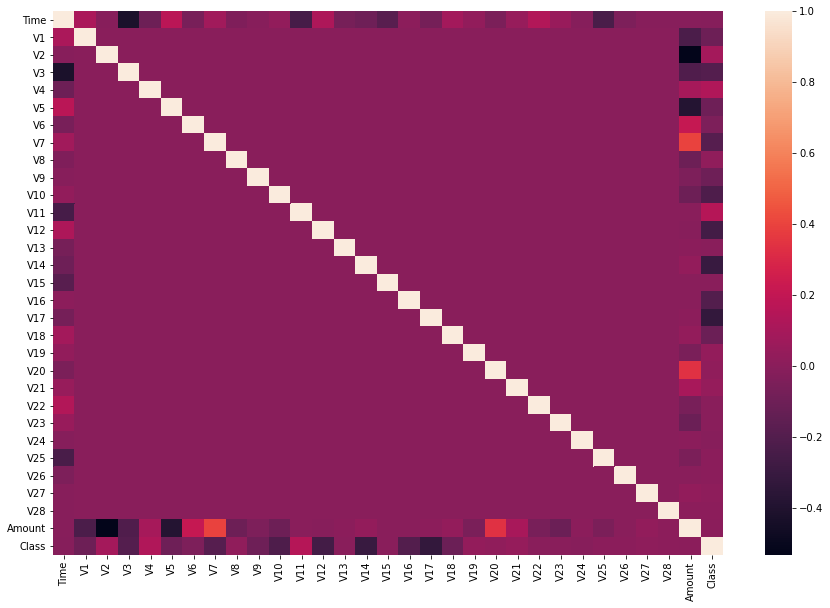

In [611]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr())

plt.figure(figsize=(10,5))
sns.pairplot(df)

In [612]:
df["Class"].value_counts()

0    284315
1       492
Name: Class, dtype: int64

In [613]:
## the datasets is not balanced 

# Model Building

In [614]:
#Dropping Time as it's non business required data
estimators=[ 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']

X = df[estimators]
y = df['Class']

In [616]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=.2,random_state=40)

In [617]:
new_features=df[['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V20','V21', 'V22', 'V23', 'V25', 'V26', 'V27','Class']]
x=new_features.iloc[:,:-1]
y=new_features.iloc[:,-1]

In [618]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.2,random_state=42)

### Decision Tree

In [619]:
# before decision tree we have to scale the data so that the value of amount which is in wide range should be
#  variable ‘Amount’ ranges from 0 to 25,691.16. To reduce its wide range, 
# we use Standardization to remove the mean and scale to unit variance, 
# so that 68% of the values lie in between (-1, 1)


In [620]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
df['NormalizedAmount'] = scale.fit_transform(df['Amount'].values.reshape(-1, 1))

In [621]:
df = df.drop(['Amount', 'Time'], axis = 1)
y = df['Class']
X = df.drop(['Class'], axis = 1)

In [622]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 10)

In [628]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report

In [629]:
decision_tree_model = DecisionTreeClassifier()
decision_tree_model.fit(x_train, y_train)
y_pred = decision_tree_model.predict(x_test)

In [630]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85302
           1       0.75      0.76      0.75       141

    accuracy                           1.00     85443
   macro avg       0.87      0.88      0.88     85443
weighted avg       1.00      1.00      1.00     85443



In [ ]:
# in decisin tree we get accuracy is 1 and f1_score we get is 1 for class 0 and .75 for class 1 
# and the roc auc score we get in decision tree is .87

In [631]:
from sklearn.metrics import confusion_matrix
c_m_d=confusion_matrix(y_test,y_pred)
print('The confusion matrix is: ', c_m_d)

The confusion matrix is:  [[85266    36]
 [   34   107]]


<AxesSubplot:>

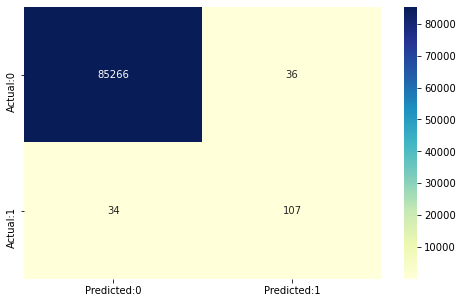

In [632]:
conf_matrix=pd.DataFrame(data=c_m_d,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [633]:
y_pred_prob=decision_tree_model.predict_proba(x_test)[:,:]
y_pred_prob_df=pd.DataFrame(data=y_pred_prob, columns=['Prob of Not Fraud (0)','Prob of Fraud (1)'])
y_pred_prob_df.head()

,Prob of Not Fraud (0),Prob of Fraud (1)
0,1.0,0.0
1,1.0,0.0
2,1.0,0.0
3,1.0,0.0
4,1.0,0.0


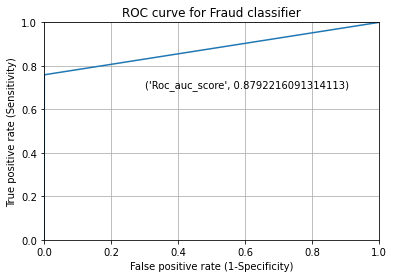

In [634]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob[:,1])
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.title('ROC curve for Fraud classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.text(x=0.3,y=.7,s=('Roc_auc_score',roc_auc_score(y_test, y_pred_prob[:,1])))
plt.grid(True)

In [635]:
# the roc_auc_score near to 1 ,it is indiacted that the model is good in decision tree the roc auc score is .87 we get it 

### RandomForest

In [636]:
from sklearn.ensemble import RandomForestClassifier

In [637]:
Random_forestmodel = RandomForestClassifier()
Random_forestmodel.fit(x_train, y_train)
y_pred = Random_forestmodel.predict(x_test)

In [638]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85302
           1       0.96      0.84      0.89       141

    accuracy                           1.00     85443
   macro avg       0.98      0.92      0.95     85443
weighted avg       1.00      1.00      1.00     85443



In [ ]:
# in random forest tree we get accuracy is 1 and f1_score we get is 1 for class 0 and .85 for class 1 
# and the roc auc score we get in decision tree is .95

In [639]:
c_m_d=confusion_matrix(y_test,y_pred)
print('The confusion matrix is: ', c_m_d)

The confusion matrix is:  [[85297     5]
 [   23   118]]


<AxesSubplot:>

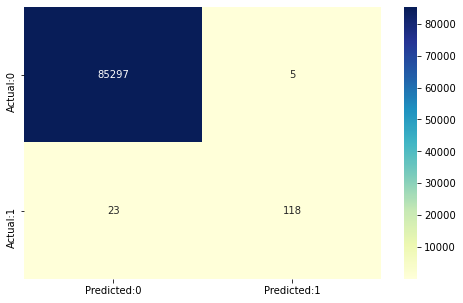

In [640]:
conf_matrix=pd.DataFrame(data=c_m_d,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [641]:
y_pred_prob=Random_forestmodel.predict_proba(x_test)[:,:]
y_pred_prob_df=pd.DataFrame(data=y_pred_prob, columns=['Prob of Not Fraud (0)','Prob of Fraud (1)'])
y_pred_prob_df.head()

,Prob of Not Fraud (0),Prob of Fraud (1)
0,1.0,0.0
1,1.0,0.0
2,1.0,0.0
3,1.0,0.0
4,1.0,0.0


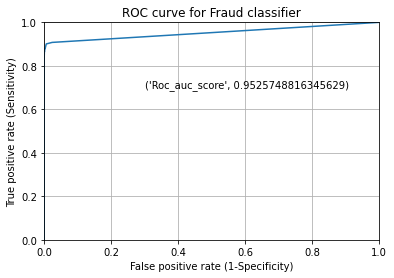

In [642]:
from sklearn.metrics import roc_curve,roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob[:,1])
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.title('ROC curve for Fraud classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.text(x=0.3,y=.7,s=('Roc_auc_score',roc_auc_score(y_test, y_pred_prob[:,1])))
plt.grid(True)

In [ ]:
## in random forest model we can do 100 decision tree because to improve model perforamnce here we get .95 auc score 
#which is better than previous

### KNeighborsClassifier Model

In [643]:
from sklearn.neighbors import KNeighborsClassifier

In [644]:
KNeighborsClassifiermodel = KNeighborsClassifier()
KNeighborsClassifiermodel.fit(x_train, y_train)
y_pred = KNeighborsClassifiermodel.predict(x_test)

In [645]:
c_m_d=confusion_matrix(y_test,y_pred)
print('The confusion matrix is: ', c_m_d)

The confusion matrix is:  [[85300     2]
 [   28   113]]


In [646]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85302
           1       0.98      0.80      0.88       141

    accuracy                           1.00     85443
   macro avg       0.99      0.90      0.94     85443
weighted avg       1.00      1.00      1.00     85443



In [ ]:
# in random forest  we get accuracy is 1 and f1_score we get is 1 for class 0 and .85 for class 1 
# and the roc auc score we get in decision tree is .95

# in KNeighborsClassifier Model we get accuracy is 1 and f1_score we get is 1 for class 0 and .88 for class 1 
# and the roc auc score we get in decision tree is .92

<AxesSubplot:>

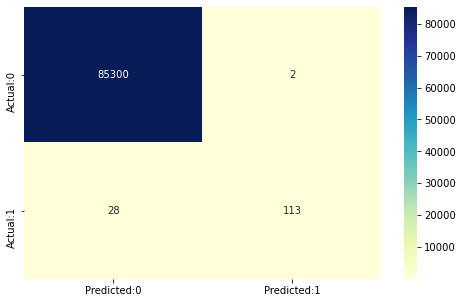

In [647]:
conf_matrix=pd.DataFrame(data=c_m_d,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [648]:
y_pred_prob=KNeighborsClassifiermodel.predict_proba(x_test)[:,:]
y_pred_prob_df=pd.DataFrame(data=y_pred_prob, columns=['Prob of Not Fraud (0)','Prob of Fraud (1)'])
y_pred_prob_df.head()

,Prob of Not Fraud (0),Prob of Fraud (1)
0,1.0,0.0
1,1.0,0.0
2,1.0,0.0
3,1.0,0.0
4,1.0,0.0


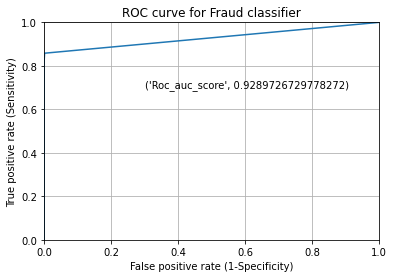

In [649]:
from sklearn.metrics import roc_curve,roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob[:,1])
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.title('ROC curve for Fraud classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.text(x=0.3,y=.7,s=('Roc_auc_score',roc_auc_score(y_test, y_pred_prob[:,1])))
plt.grid(True)

In [ ]:
## in Knn model we get accuracy score is .92

### GaussianNB Model

In [650]:
from sklearn.naive_bayes import GaussianNB

In [651]:
 GaussianNBmodel =  GaussianNB()
GaussianNBmodel.fit(x_train, y_train)
y_pred =GaussianNBmodel.predict(x_test)

In [652]:
c_m_d=confusion_matrix(y_test,y_pred)
print('The confusion matrix is: ', c_m_d)

The confusion matrix is:  [[83437  1865]
 [   21   120]]


In [653]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99     85302
           1       0.06      0.85      0.11       141

    accuracy                           0.98     85443
   macro avg       0.53      0.91      0.55     85443
weighted avg       1.00      0.98      0.99     85443



<AxesSubplot:>

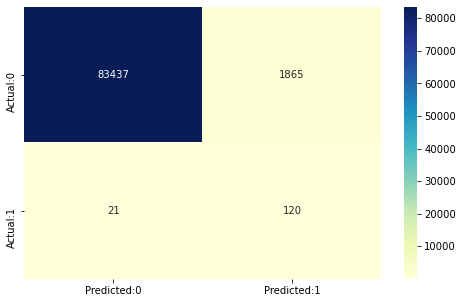

In [654]:
conf_matrix=pd.DataFrame(data=c_m_d,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [655]:
y_pred_prob=GaussianNBmodel.predict_proba(x_test)[:,:]
y_pred_prob_df=pd.DataFrame(data=y_pred_prob, columns=['Prob of Not Fraud (0)','Prob of Fraud (1)'])
y_pred_prob_df.head()

,Prob of Not Fraud (0),Prob of Fraud (1)
0,1.0,3.262144e-17
1,1.0,5.964576e-18
2,1.0,3.034243e-15
3,1.0,5.364530e-15
4,1.0,7.890744e-18


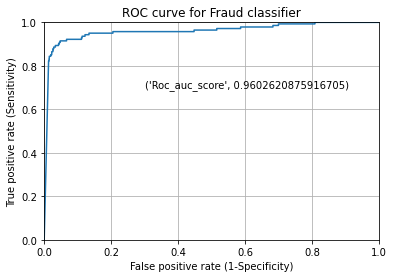

In [656]:
from sklearn.metrics import roc_curve,roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob[:,1])
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.title('ROC curve for Fraud classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.text(x=0.3,y=.7,s=('Roc_auc_score',roc_auc_score(y_test, y_pred_prob[:,1])))
plt.grid(True)

In [ ]:
## in the gaussian NB model we get roc auc score is .96

### AdaBoostClassifier Model

In [2]:
from sklearn.ensemble import AdaBoostClassifier

In [658]:
AdaBoostClasslifiermode = AdaBoostClassifier()
AdaBoostClassifiermodel.fit(x_train, y_train)
y_pred =AdaBoostClassifiermodel.predict(x_test)

In [659]:
c_m_d=confusion_matrix(y_test,y_pred)
print('The confusion matrix is: ', c_m_d)

The confusion matrix is:  [[85289    13]
 [   42    99]]


In [660]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85302
           1       0.88      0.70      0.78       141

    accuracy                           1.00     85443
   macro avg       0.94      0.85      0.89     85443
weighted avg       1.00      1.00      1.00     85443



In [ ]:
# in random forest  we get accuracy is 1 and f1_score we get is 1 for class 0 and .85 for class 1 
# and the roc auc score we get in decision tree is .9525

# in KNeighborsClassifier Model we get accuracy is 1 and f1_score we get is 1 for class 0 and .88 for class 1 
# and the roc auc score we get in decision tree is .9289

# in  GaussianNB Model we get accuracy is .98 and f1_score we get is .99 for class 0 and .11 for class 1 
# and the roc auc score we get in decision tree is .9602

# in  AdaBoostClasslifiermodel we get accuracy is 1 and f1_score we get is 1.0 for class 0 and .78 for class 1 
# and the roc auc score we get in decision tree is .9658

<AxesSubplot:>

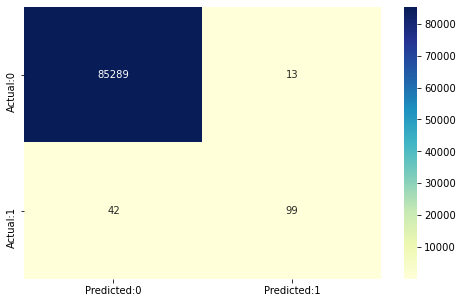

In [661]:
conf_matrix=pd.DataFrame(data=c_m_d,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [662]:
y_pred_prob=AdaBoostClassifiermodel.predict_proba(x_test)[:,:]
y_pred_prob_df=pd.DataFrame(data=y_pred_prob, columns=['Prob of Not Fraud (0)','Prob of Fraud (1)'])
y_pred_prob_df.head()

,Prob of Not Fraud (0),Prob of Fraud (1)
0,0.727496,0.272504
1,0.553433,0.446567
2,0.542329,0.457671
3,0.596362,0.403638
4,0.556581,0.443419


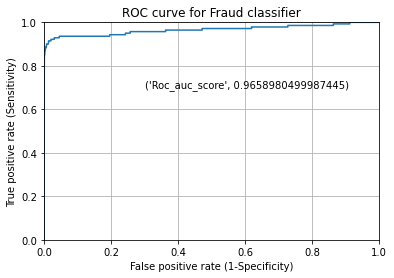

In [663]:
from sklearn.metrics import roc_curve,roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob[:,1])
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.title('ROC curve for Fraud classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.text(x=0.3,y=.7,s=('Roc_auc_score',roc_auc_score(y_test, y_pred_prob[:,1])))
plt.grid(True)

In [ ]:
# here we use addboost model which improve score as compared to bagging model and we clearly see that the roc  score 
# is too high as compard to others model so this type of problem we can use this addboost models